In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from sklearn.linear_model import LinearRegression
from datetime import date, timedelta
from scipy.optimize import leastsq
#from sklearn.linear_model import LinearRegression
from matplotlib.dates import DateFormatter
from scipy.stats import chisquare

#from datetime import date, timedelta
yesterday = date.today() - timedelta(days=1)
d1 = yesterday.strftime("%Y-%m-%d")
countriesEU = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania",\
               "Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands",\
               "Denmark","Poland","Estonia","Portugal","Finland","Romania","France",\
               "Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
#x = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
d0 = date(2020, 3, 29)
d2 = date.today()
deltaT = d2 - d0
print(deltaT.days)
dT = deltaT.days
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
RkoreaCoeffs=[ 0.36242246,  2.56241634,  1.84890887,  0.13324732]
%matplotlib inline
expPopWorld = 2.67152730e+06
def moving_average(a, n=3) :
    ret = np.cumsum(a, dtype=float)
    ret[n:] = ret[n:] - ret[:-n]
    return ret[n - 1:] / n

def linreg(dfLT,population):
    
    dfLT['date'] = pd.to_datetime(dfLT['date'])
    yy = np.log(dfLT['cases'].values*10000./population)
    xx = np.array(range(dfLT['cases'].size)).reshape((-1, 1))
    model1 = LinearRegression().fit(xx, yy)
    r_sq1 = model1.score(xx, yy)
    return model1, r_sq1, dfLT

def plotpred(dfLT1, population, dateStart, dateEnd, filename, model1, country,level):
    
    #fig, ax = plt.subplots(figsize=(12, 12))
    plt.plot(dfLT1['date'].values,dfLT1['cases']*10000./population)
    date_form = DateFormatter("%m-%d")
    ax = plt.axes()
    ax.xaxis.set_major_formatter(date_form)
    ix1 = pd.date_range(dateStart, dateEnd, freq='D')
    ss1 = pd.DataFrame({'date': ix1},index=range(len(ix1)))
    y_pred1 = np.exp(model1.intercept_ + model1.coef_ * range(len(ix1)))
    ax.plot(ss1['date'].values,y_pred1)
    plt.xticks(rotation=90)
    plt.title(country)
    plt.ylabel('Tolat COVID-19 cases per 10000')
    ax.fill_between(ss1['date'].values, 1,level, facecolor='red', alpha=0.3)
    ax.fill_between(ss1['date'].values, yc,1, facecolor='m', alpha=0.3)
    ax.fill_between(ss1['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
    plt.xlabel('Date')
    #plt.yscale('log')
    plt.yscale('log')
    plt.grid()
    plt.savefig(filename)
    plt.show()
    ss1a = pd.DataFrame({'cases': (y_pred1*population/10000).astype(int)},index=range(len(y_pred1)))
    ss1t = pd.concat([ss1,ss1a], axis=1)
    return ss1t

def forecast(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases',pMAPE=True):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))#+coeffs[0]*.25/(1 + np.exp( - coeffs[1] * (t - 3.5*coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    if pMAPE:
        print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logistic')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x

def forecast2(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'bi-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: bi-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("bi-logistic approximation splitting point: %d"%(vL))
    print(output0)
    print(output)
    return x

def forecast3(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))+coeffsUS[3]/(1 + np.exp( - coeffsUS[4] * (t - coeffsUS[5])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendS1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: tri-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('forecast rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("tri-logistic approximation splitting points: %d,%d"%(vL[0],vL[1]))
    print(output0)
    print(output1)
    print(output)
    
    return x

def trend3(dfLV,dfLT1,dfES,lLV,lLT,lES,pLV,pLT,pES):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #dfLT1 = pd.read_csv("~/Desktop/coronaLT1.csv",",")
    y = np.log(np.diff(dfLT1["cases"].values)[:]/dfLT1["cases"].values[1:]**2)
    x = np.array(range(len(dfLT1["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLT)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLT) 
    plt.plot(range(len(x)+pLT),y_pred12,label='%s tr'%(lLT))

    y = np.log(np.diff(dfES["cases"].values)[:]/dfES["cases"].values[1:]**2)
    x = np.array(range(len(dfES["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lES)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pES) 
    plt.plot(range(len(x)+pES),y_pred12,label='%s tr'%(lES))
    plt.xlabel('t, days')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s%s%s.png"%(lLV,lLT,lES))
    plt.show()
    
def trend(dfLV,lLV,pLV):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    plt.xlabel('t [days]')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s.png"%(lLV))
    plt.show()

def trendS(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendS0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend0 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x[:vL])+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL])+pLV,y_pred12, output

def trendS1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output
    
def forecastR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t, output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: Richards')
    print('coeffs: ',x)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1])) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print (output)
    return x

def forecast2R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] *coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])-coeffs2[0]/(1 + np.exp( - coeffs2[3] *coeffs2[1] * (tt - coeffs2[2])))**(1./coeffs2[3])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: bi-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print(output)
    return x

def forecast3R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] * coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7] * coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(waveform_1-model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel-6*diffStd0*np.ones(len(tt)),allmodel+6*diffStd0*np.ones(len(tt)), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model']) 
    ax2.set_xlabel('t, days')
    ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(np.diff(waveform_1)-np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)-3*diffStd*np.ones(len(tt)-1), np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t [days]')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s_R.png"%(Cntr))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    rint('model: tri-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    print('\t total death: ', int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0]))
    print(output)
    return x

def get_cases(df,threshold):    
    dfA = df[df[['Country','TotCasesper1Mpop']].TotCasesper1Mpop>=threshold]
    #y = df[df['Country','TotCasesper1Mpop'].TotCasesper1Mpop>=56.]
    dfA = dfA.sort_values(by=['TotCasesper1Mpop'], ascending=False)
    country = dfA['Country']
    #country = country.tolist()
    cases = dfA['TotCasesper1Mpop']/100
    #case = cases.tolist()
    return country, cases

def stat_picture(country, cases, high=35, picname="pictures/coronage0.png"):
# Import the necessary packages and modules


    # Prepare the data
    #x = dfA['Country']
    fig = plt.figure( figsize=(6, high))
    fig.subplots_adjust(bottom=0.2, left=0.1)
    # Plot the data
    y_pos = cases
    #barh(y_pos, performance, xerr=error, align='center')
    plt.barh(country,y_pos)
    #plt.xticks(rotation=90)
    plt.xlabel('COVID-19 cases per 10000')
    # Add a legend
    plt.legend()
    ax = plt.axes() 
    x = range(len(country))
    ax.fill_betweenx(x, 1,1000, facecolor='red', alpha=0.3)
    yc = 0.56
    ax.fill_betweenx(x, yc,1, facecolor='m', alpha=0.3)
    ax.fill_betweenx(x, 1e-4,yc, facecolor='y', alpha=0.3)
    plt.vlines(yc, 0, len(country)-1, colors='g', linestyles='solid')
    #plt.ylim([1e-2,60])
    ax.xaxis.grid() # horizontal lines
    #ax.xaxis.grid() # vertical lines

    ax.set_yticks(range(len(country)))
    ax.set_yticklabels(country)
    #ax.invert_yaxis()
    plt.xscale("log")
    # Show the plot

    plt.savefig(picname, bbox_inches='tight')
    plt.show()
    
def read_df(dfRM,lRM):
    dfRM = pd.read_csv("data/corona%s.csv"%(lRM),",")
    dfRM['date'] = pd.to_datetime(dfRM['date'])
    print("%s\n"%(lRM),dfRM.tail())
    return dfRM

75


In [2]:
from sklearn.linear_model import Ridge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

def forecastRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    locStr = 'upper left'
    if Cntr in ['New Zealand']:
        locStr = 'lower right'
    ax2.legend(['COVID-19 %s'%(Cntr), 'Richards','-3days'],loc=locStr) 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecastRRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]) )))#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2RRR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * ((t- coeffsUS[2])*(t- coeffsUS[3]))))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    24.31714688, 0.00530186**2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RRR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))+coeffsUS[4]/(1 + np.exp( - coeffsUS[5] * (t - coeffsUS[6])* (t - coeffsUS[7])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.01 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSQ1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def trendSQ(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL:], y[vL:]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSQ0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[:vL], y[:vL]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL]),y_pred12, output

def trendSQ1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL[1], np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL[1]]),y_pred12, output

def trendSS(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS0(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS1(dfLV,vL=[0,1],pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

In [3]:
def forecastQR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * coeffs[4] * ((t- coeffs[2])*(t- coeffs[3]) )))**(1./coeffs[4])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3],xcoef[4]*x[4]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3],xcoef[4]*x_1[4]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'RichardsQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_QR.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_QR.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: RichardsQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x


def forecast2RR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL,nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-Richards approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases',zoom=1.):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7]*coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop/4,  2.61212092e+01, -9.65961409e-01,  5.96529356e-03], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    if zoom != 1.:
        ax3.set_ylim([0,zoom])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL[1],nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL[0],nu=x[3])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSS1(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2QR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])+coeffsUS[0]/(1 + np.exp( - coeffsUS[4]*coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))**(1./coeffsUS[4])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

In [23]:
dfp = pd.read_csv("data/population.csv",",")
#dfp[dfp['Country (or dependency)']=='China'].Population.tolist()[0]
dfp.head()

,Country (or dependency),Population,Yearly Change,Net Change,Density (P/Km²),Land Area (Km²),Migrants (net),Fert. Rate,Med. Age,Urban Pop %,World Share
0,World,7774108745,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,European Union,445250514,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,China,1439323776,0.39 %,5540090.0,153.0,9388211.0,-348399.0,1.7,38,61 %,18.47 %
3,India,1380004385,0.99 %,13586631.0,464.0,2973190.0,-532687.0,2.2,28,35 %,17.70 %
4,United States,331002651,0.59 %,1937734.0,36.0,9147420.0,954806.0,1.8,38,83 %,4.25 %


In [24]:
popEU = sum(dfp[dfp["Country (or dependency)"].isin(countriesEU) ].Population)

In [25]:
#df = pd.read_csv("~/Desktop/coronaAllT.csv","\t")
df = pd.read_csv("data/coronaAll_%s.csv"%(d1),",")
dfAll = df#pd.read_csv("~/Desktop/coronaAll_2020-03-28.csv",",")

In [26]:
df.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,NaN,\n,NaN,NaN,1245760,North America,North America,NaN,5714.0,620.0,"+4,321",NaN,19423.0,NaN,2392187,141967.0,1004460.0,NaN,NaN
1,NaN,\n,NaN,NaN,579092,South America,South America,NaN,884.0,21.0,111,NaN,11988.0,NaN,1313866,56394.0,678380.0,NaN,NaN
2,NaN,\n,NaN,NaN,840039,Europe,Europe,NaN,683.0,16.0,826,NaN,6745.0,NaN,2156829,181474.0,1135316.0,NaN,NaN
3,NaN,\n,NaN,NaN,553822,Asia,Asia,NaN,8292.0,130.0,"+3,202",NaN,15239.0,NaN,1507628,38030.0,915776.0,NaN,NaN
4,NaN,\n,NaN,NaN,112834,Africa,Africa,NaN,148.0,12.0,76,NaN,511.0,NaN,219502,5881.0,100787.0,NaN,NaN


In [27]:
df.tail()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
225,NaN,,NaN,NaN,553822,Asia,Total:,NaN,8292.0,130.0,"+3,202",NaN,15239.0,NaN,1507628,38030.0,915776.0,NaN,NaN
226,NaN,,NaN,NaN,112834,Africa,Total:,NaN,148.0,12.0,76,NaN,511.0,NaN,219502,5881.0,100787.0,NaN,NaN
227,NaN,,NaN,NaN,407,Australia/Oceania,Total:,NaN,4.0,NaN,NaN,NaN,2.0,NaN,8900,124.0,8369.0,NaN,NaN
228,NaN,,NaN,NaN,55,NaN,Total:,NaN,NaN,NaN,NaN,NaN,4.0,NaN,721,15.0,651.0,NaN,NaN
229,NaN,NaN,NaN,NaN,164487,Europe,European Union,290.079396,0.0,0.0,NaN,NaN,3106.0,52715.954866,1207023,129158.0,565046.0,23471806.0,2710.885136


In [28]:
dfAll.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,NaN,\n,NaN,NaN,1245760,North America,North America,NaN,5714.0,620.0,"+4,321",NaN,19423.0,NaN,2392187,141967.0,1004460.0,NaN,NaN
1,NaN,\n,NaN,NaN,579092,South America,South America,NaN,884.0,21.0,111,NaN,11988.0,NaN,1313866,56394.0,678380.0,NaN,NaN
2,NaN,\n,NaN,NaN,840039,Europe,Europe,NaN,683.0,16.0,826,NaN,6745.0,NaN,2156829,181474.0,1135316.0,NaN,NaN
3,NaN,\n,NaN,NaN,553822,Asia,Asia,NaN,8292.0,130.0,"+3,202",NaN,15239.0,NaN,1507628,38030.0,915776.0,NaN,NaN
4,NaN,\n,NaN,NaN,112834,Africa,Africa,NaN,148.0,12.0,76,NaN,511.0,NaN,219502,5881.0,100787.0,NaN,NaN


In [29]:
dfAll.fillna(0, inplace=True)
dfAll[dfAll["Country"]=="Lithuania"]

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
107,101.0,"1,555","36,809",8,306,Europe,Lithuania,27.0,0.0,0.0,0,"2,723,889",17.0,128782.0,1752,74.0,1372.0,350788.0,643.0


No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


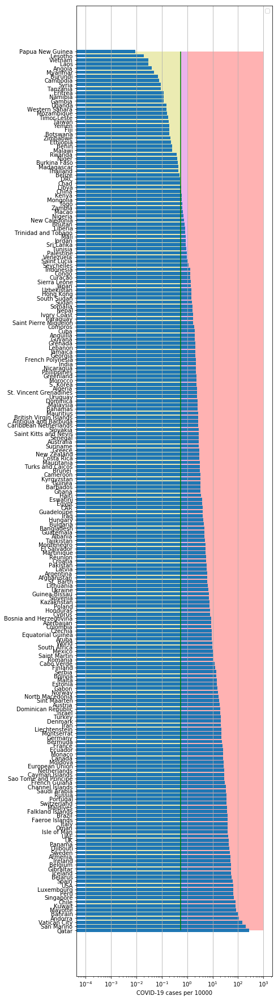

In [30]:
country, cases = get_cases(df,0.01)
country.values, cases.values
stat_picture(country.values, cases.values, high=35, picname="pictures/coronage0.png")

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


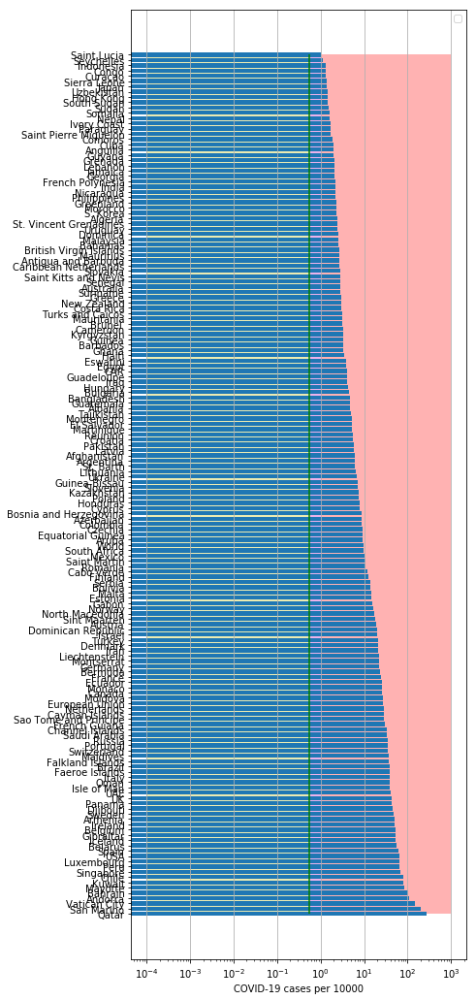

In [31]:
country, cases = get_cases(df,100.0)
stat_picture(country.values, cases.values, high=20, picname="pictures/coronage1.png")

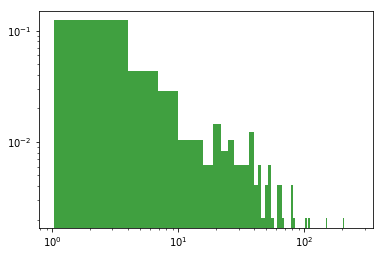

In [32]:
n, bins, patches = plt.hist(cases, 90, density=True,facecolor='g', alpha=0.75)
plt.yscale("log")
plt.xscale("log")

In [33]:
dfSP = read_df(pd.DataFrame(),"SP")
dfGB = read_df(pd.DataFrame(),"GB")
dfIT = read_df(pd.DataFrame(),"IT")
dfLT = read_df(pd.DataFrame(),"LT")
dfUkr = read_df(pd.DataFrame(),"Ukr")
dfUS = read_df(pd.DataFrame(),"US")
dfCN = read_df(pd.DataFrame(),"CN")
dfFR = read_df(pd.DataFrame(),"FR")
dfKR = read_df(pd.DataFrame(),"KR")
dfW = read_df(pd.DataFrame(),"World")
dfDK = read_df(pd.DataFrame(),"DK")
dfNG = read_df(pd.DataFrame(),"NG")
dfGR = read_df(pd.DataFrame(),"GR")
dfES = read_df(pd.DataFrame(),"ES")
dfSW = read_df(pd.DataFrame(),"SW")
dfPL = read_df(pd.DataFrame(),"PL")
dfIS = read_df(pd.DataFrame(),"IS")
dfUR = read_df(pd.DataFrame(),"Ukr")
dfSZ = read_df(pd.DataFrame(),"SZ")
dfIN = read_df(pd.DataFrame(),"IN")
#dfKRA = read_df(pd.DataFrame(),"KRA")
dfRS = read_df(pd.DataFrame(),"RS")
dfJP = read_df(pd.DataFrame(),"JP")
dfNL = read_df(pd.DataFrame(),"NL")
dfAT = read_df(pd.DataFrame(),"AT")
dfBG = read_df(pd.DataFrame(),"BG")
dfSG = read_df(pd.DataFrame(),"SG")
dfLV = read_df(pd.DataFrame(),"LV")
dfCA = read_df(pd.DataFrame(),"CA")
dfPT = read_df(pd.DataFrame(),"PT")
dfTR = read_df(pd.DataFrame(),"TR")
dfBZ = read_df(pd.DataFrame(),"BZ")
dfAS = read_df(pd.DataFrame(),"AS")
dfML = read_df(pd.DataFrame(),"ML")
dfZL = read_df(pd.DataFrame(),"ZL")
dfBR = read_df(pd.DataFrame(),"BR")
dfIR = read_df(pd.DataFrame(),"IR")
dfCL = read_df(pd.DataFrame(),"CL")
dfCH = read_df(pd.DataFrame(),"CH")
dfRM = read_df(pd.DataFrame(),"RM")
dfFI = read_df(pd.DataFrame(),"FI")
dfID = read_df(pd.DataFrame(),"ID")
dfED = read_df(pd.DataFrame(),"ED")
dfPH = read_df(pd.DataFrame(),"PH")
#dfPK = read_df(pd.DataFrame(),"PK")
dfLX = read_df(pd.DataFrame(),"LX")
dfTH = read_df(pd.DataFrame(),"TH")
dfIE = read_df(pd.DataFrame(),"IE")
dfMX = read_df(pd.DataFrame(),"MX")
dfPM = read_df(pd.DataFrame(),"PM")
dfPU = read_df(pd.DataFrame(),"PU")
dfSB = read_df(pd.DataFrame(),"SB")
dfAG = read_df(pd.DataFrame(),"AG")
dfCT = read_df(pd.DataFrame(),"CT")
dfEG = read_df(pd.DataFrame(),"EG")
dfSV = read_df(pd.DataFrame(),"SV")
dfMR = read_df(pd.DataFrame(),"MR")
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIC = read_df(pd.DataFrame(),"IC")
dfQR = read_df(pd.DataFrame(),"QR")
dfCB = read_df(pd.DataFrame(),"CB")
dfBL = read_df(pd.DataFrame(),"BL")
dfAG = read_df(pd.DataFrame(),"AR")
dfEU = read_df(pd.DataFrame(),"EU")
dfMT = read_df(pd.DataFrame(),"MT")
dfCP = read_df(pd.DataFrame(),"CP")

SP
           date   cases  active    death
103 2020-06-07  288630       0  27136.0
104 2020-06-08  288797       0  27136.0
105 2020-06-09  289046       0  27136.0
106 2020-06-10  289360       0  27136.0
107 2020-06-11  289787       0  27136.0
GB
           date   cases  active    death
102 2020-06-07  286194       0  40542.0
103 2020-06-08  287399       0  40597.0
104 2020-06-09  289140       0  40883.0
105 2020-06-10  290143       0  41128.0
106 2020-06-11  291409       0  41279.0
IT
           date   cases  active    death
105 2020-06-07  234998   35262  33899.0
106 2020-06-08  235278   34730  33964.0
107 2020-06-09  235561   32872  34043.0
108 2020-06-10  235763   31710  34114.0
109 2020-06-11  236142   30637  34167.0
LT
          date   cases  active  death     tests
90 2020-06-07  1720.0     318   71.0  335686.0
91 2020-06-08  1727.0     317   71.0  340073.0
92 2020-06-09  1733.0     280   74.0  345392.0
93 2020-06-10  1752.0     296   74.0  350788.0
94 2020-06-11  1752.0     306

          date   cases    active   death
92 2020-06-07  196515  104831.0  5465.0
93 2020-06-08  199696  104569.0  5571.0
94 2020-06-09  203736  105069.0  5738.0
95 2020-06-10  208823  104889.0  5903.0
96 2020-06-11  214788  106250.0  6109.0
SB
          date  cases  active  death
89 2020-06-07  11823   226.0  249.0
90 2020-06-08  11896   298.0  250.0
91 2020-06-09  11965   367.0  250.0
92 2020-06-10  12031   432.0  251.0
93 2020-06-11  12102   502.0  252.0
AG
          date    cases   active  death
95 2020-06-07  22794.0  15221.0  664.0
96 2020-06-08  23620.0  15622.0  693.0
97 2020-06-09  24761.0  16476.0  717.0
98 2020-06-10  25987.0  17261.0  735.0
99 2020-06-11  27373.0  18276.0  765.0
CT
           date   cases  active  death
99  2020-06-07  2247.3    17.0  104.0
100 2020-06-08  2247.4    15.0  104.0
101 2020-06-09  2247.5    11.0  106.0
102 2020-06-10  2249.0    13.0  106.0
103 2020-06-11  2249.0    11.0  106.0
EG
          date  cases  active   death
93 2020-06-07  34079   23881

In [34]:
dfBL = dfBL.fillna(0)
dfRM = dfRM.fillna(0)
dfSV = dfSV.fillna(0)
dfCT = dfCT.fillna(0)
#dfAR = dfAR.fillna(0)
dfSB = dfSB.fillna(0)
dfCP = dfCP.fillna(0)
dfID = dfID.fillna(0)
dfAG = dfAG.fillna(0)
dfMX = dfMX.fillna(0)
dfPU = dfPU.fillna(0)
dfIQ = dfIQ.fillna(0)
dfIE = dfIE.fillna(0)
dfPH = dfPH.fillna(0)
dfTH = dfTH.fillna(0)
dfMR = dfMR.fillna(0)
dfCP = dfCP.fillna(0)

In [35]:
from sklearn.linear_model import LinearRegression
populationSp = dfp[dfp['Country (or dependency)']=='Spain'].Population.tolist()[0]
y = np.log(dfSP['cases'].values*10000./populationSp)
x = np.array(range(dfSP['cases'].size)).reshape((-1, 1))
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)


coefficient of determination: 0.6390946716902528
intercept: -1.2611002893079957
slope: [0.06841514]


/usr/local/lib/python3.5/dist-packages/pandas/plotting/_converter.py:129: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


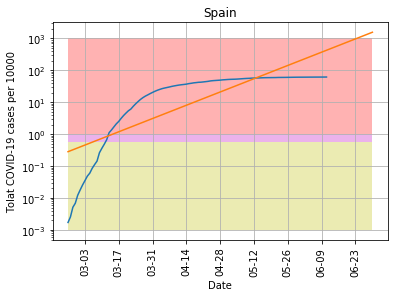

In [36]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
yc = 0.56
plt.plot(dfSP['date'].values,dfSP['cases']*10000./populationSp)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix = pd.date_range('2020-02-25', '2020-06-30', freq='D')
ss = pd.DataFrame({'date': ix})
y_pred = np.exp(model.intercept_ + model.coef_ * range(len(ix)))
ax.plot(ss['date'].values,y_pred)
plt.xticks(rotation=90)
plt.title('Spain')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaSP.png")
plt.show()

In [37]:
populationUK = dfp[dfp['Country (or dependency)']=='United Kingdom'].Population.tolist()[0]
model1, r_sql, dfGB1 = linreg(dfGB,populationUK)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.7743646396196764
intercept: -2.8879254127969016
slope: [0.08148531]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


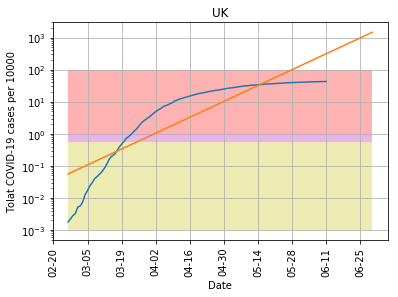

In [38]:
ss1t = plotpred(dfGB1,populationUK,'2020-02-26', '2020-06-30', "pictures/coronaGB.png", model1, 'UK',100)

In [39]:
populationIT = dfp[dfp['Country (or dependency)']=='Italy'].Population.tolist()[0]
coefIT = 4.0378751-0.3
yy1 = np.log(coefIT-np.log(dfIT['cases'].values*10000./populationIT))
xx1 = np.array(range(dfIT['cases'].size)).reshape((-1, 1))
model11 = LinearRegression().fit(xx1, yy1)
r_sq1 = model11.score(xx1, yy1)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.9749706658972693
intercept: 1.676664500753143
slope: [-0.04440414]


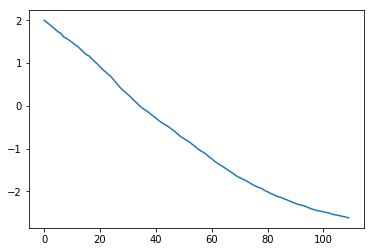

In [40]:
plt.plot(xx1,yy1)

/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


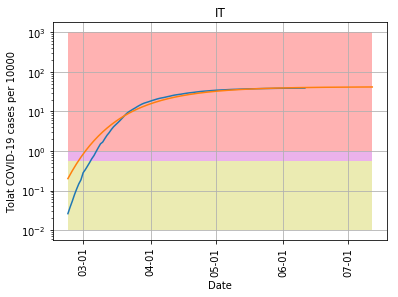

In [41]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
plt.plot(dfIT['date'].values,dfIT['cases']*10000./populationIT)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix11 = pd.date_range('2020-02-23', '2020-07-12', freq='D')
ss11 = pd.DataFrame({'date': ix11})
y_pred11 = np.exp(coefIT-np.exp(model11.intercept_ + model11.coef_ * range(len(ix11))))
ax.plot(ss11['date'].values,y_pred11)
plt.xticks(rotation=90)
plt.title('IT')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss11['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss11['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss11['date'].values, 1e-2,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
#plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaIT.png")
plt.show()

In [42]:
cs=y_pred11[-1]/10000.*populationIT

In [43]:
cs

251295.0847864125

In [44]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
model1, r_sql, dfLT1 = linreg(dfLT[1:],populationLT)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.5574855425912175
intercept: -1.3185077736648885
slope: [0.04614128]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


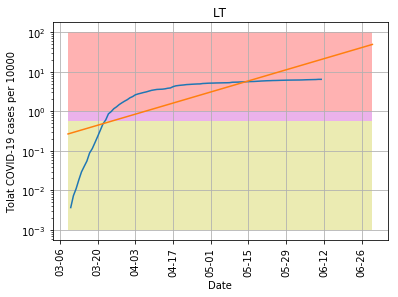

In [45]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
ss1t = plotpred(dfLT[1:],populationLT,'2020-03-09', '2020-06-30', "pictures/coronaLT.png", model1, 'LT',100)

In [46]:
populationUKr = dfp[dfp['Country (or dependency)']=='Ukraine'].Population.tolist()[0]
model11, r_sql, dfUkr1 = linreg(dfUkr, populationUKr)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.7871572895684124
intercept: -4.670356971401135
slope: [0.08869408]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


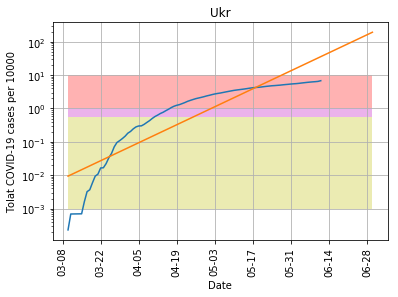

In [47]:
ss1t1 = plotpred(dfUkr1,populationUKr,'2020-03-10', '2020-06-30', "pictures/coronaUkr.png", model11, 'Ukr',10)

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


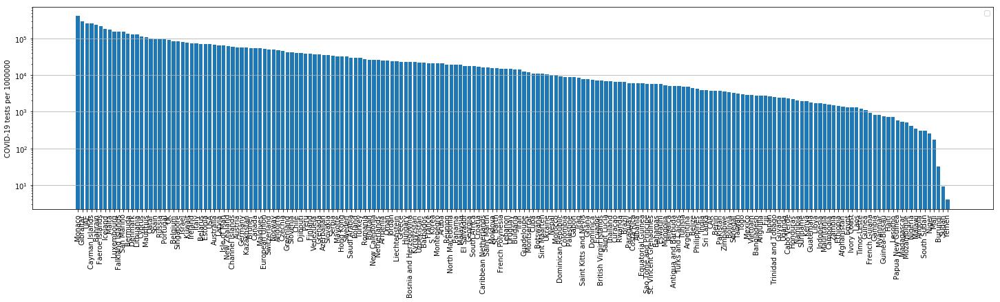

In [48]:
# Prepare the data
dfTs = dfAll
dfTs = dfTs.sort_values(by=['Testsper1Mpop'], ascending=False)
dfTs = dfTs[dfTs['Testsper1Mpop']>0]
x = dfTs['Country']
y = dfTs['Testsper1Mpop']
fig = plt.figure( figsize=(25, 6))
fig.subplots_adjust(bottom=0.2)
# Plot the data
plt.bar(x, y)

plt.xticks(rotation=90)
plt.ylabel('COVID-19 tests per 1000000')
# Add a legend
plt.legend()
ax = plt.axes() 
#ax.fill_between(x, 1,10, facecolor='red', alpha=0.3)
yc = 0.56
#ax.fill_between(x, yc,1, facecolor='m', alpha=0.3)
#ax.fill_between(x, 1e-4,yc, facecolor='y', alpha=0.3)
#plt.hlines(yc, 0, len(df)-1, colors='g', linestyles='solid')
#plt.ylim([1e-4,10])
ax.yaxis.grid() # horizontal lines
#ax.xaxis.grid() # vertical lines
plt.yscale("log")
# Show the plot
plt.savefig("pictures/coronaTests.png")
plt.show()

In [49]:
populationUS= dfp[dfp['Country (or dependency)']=='United States'].Population.tolist()[0]
model11, r_sql, dfUS1 = linreg(dfUS, populationUS)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.7354343255057982
intercept: -2.3333636322654536
slope: [0.08226903]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


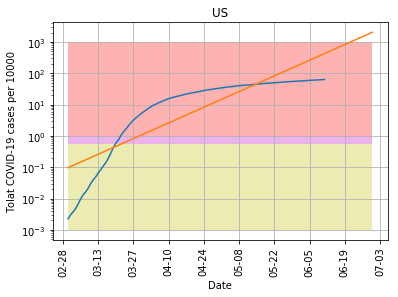

In [50]:
ss1t = plotpred(dfUS1,populationUS,'2020-03-01', '2020-06-30', "pictures/coronaUS.png", model11, 'US',1000)

In [51]:
dfAll[dfAll["Country"]=="Latvia"]
dfAll.fillna(0, inplace=True)

North America
            Country         0
229  European Union  0.107005


(0, 0.15)

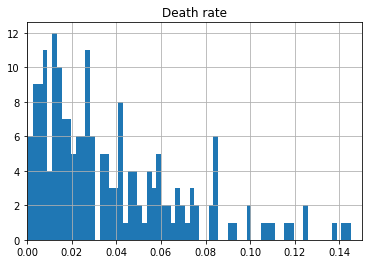

In [52]:
dfT1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
print(dfTT.Country[0])
print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
hist = dfTTh[dfTTh[0]>0].hist(bins=9*12)
plt.title("Death rate")
plt.xlim([0,0.15])

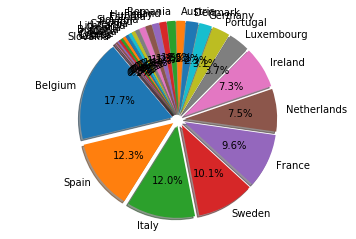

In [53]:
cLst = countriesEU
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
#dfD1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["Deathsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfTTh = dfTT.sort_values(by=["Deathsper1Mpop"], ascending=False)
dfTTh.rename(columns={0: "DeathRate"})
#hist = dfTTh.hist(bins=9*16)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])
#plt.show()
#import matplotlib.pyplot as plt

labels = dfTTh.Country.tolist()#'apple', 'banana', 'cherry', 'durian', 'elderberries', 'figs', 'grapes'
sizes = dfTTh.Deathsper1Mpop.values#[32, 20, 15, 10, 10, 8, 5]

p = plt.pie(sizes, labels=labels, explode=(.07,)*len(sizes), autopct='%1.1f%%', startangle=130, shadow=True)
plt.axis('equal')

            
plt.show()

In [54]:
dfTTh.head()

,Country,Deathsper1Mpop
26,Belgium,832.0
12,Spain,580.0
13,Italy,565.0
29,Sweden,477.0
18,France,450.0


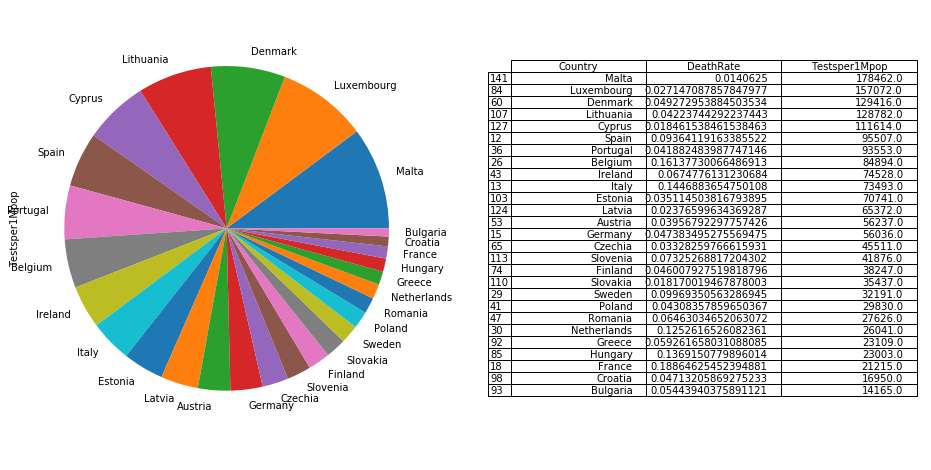

In [55]:
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=["Testsper1Mpop"], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
#import matplotlib.pyplot as plt
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfTTh.plot.pie(y=["Testsper1Mpop"],ax=ax1,labels=dfTTh['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfTTh, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate2.png")
plt.show()

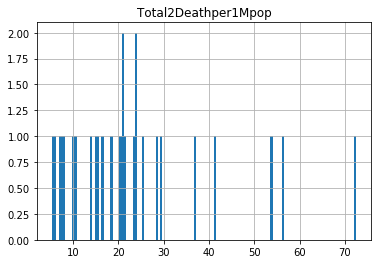

In [56]:
dfD1 = dfAll[dfAll['Country'].isin(cLst)]#[dfAll["Total Cases"]>0]
dfDD = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"],dfD1["Deathsper1Mpop"]], axis=1)
dfDD2 = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"]/dfD1["Testsper1Mpop"]], axis=1)
dfDD = dfDD[dfDD["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfDD1 = pd.concat([dfDD["Country"],dfDD["TotCasesper1Mpop"]/dfDD["Deathsper1Mpop"]], axis=1)
dfDDh = dfDD1.sort_values(by=[0], ascending=False)
dfDDh=dfDDh.rename(columns={0:"Total2Deathper1Mpop"})
dfDDh2=dfDD2.rename(columns={0:"Cases2Testsper1Mpop"})
hist = dfDDh.hist(bins=9*15)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])

In [57]:
dfDD.head()

,Country,TotCasesper1Mpop,Deathsper1Mpop
12,Spain,6198.0,580.0
13,Italy,3905.0,565.0
15,Germany,2230.0,106.0
18,France,2383.0,450.0
26,Belgium,5153.0,832.0


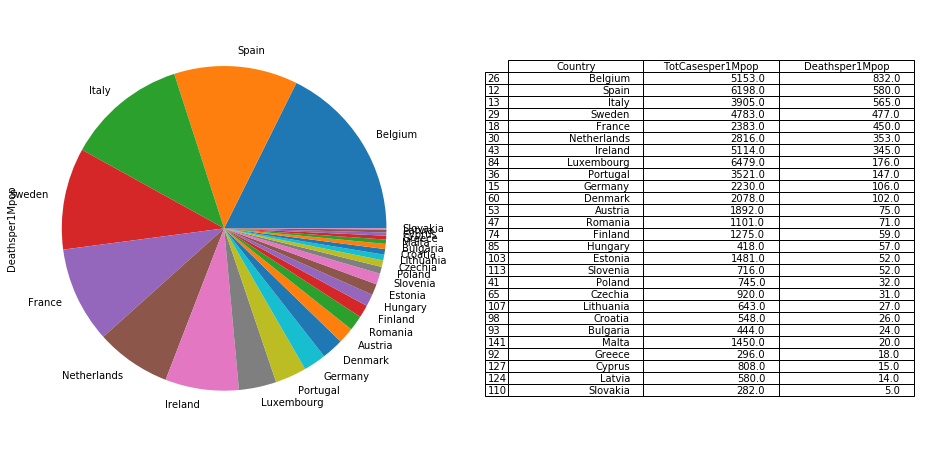

In [58]:
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDD = dfDD.sort_values(by=['Deathsper1Mpop'], ascending=False)
dfDD.plot.pie(y='Deathsper1Mpop',ax=ax1,labels=dfDD['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDD, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate1.png")
plt.show()

In [59]:
dfAll.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,0.0,\n,0,0,1245760,North America,North America,0.0,5714.0,620.0,"+4,321",0,19423.0,0.0,2392187,141967.0,1004460.0,0.0,0.0
1,0.0,\n,0,0,579092,South America,South America,0.0,884.0,21.0,111,0,11988.0,0.0,1313866,56394.0,678380.0,0.0,0.0
2,0.0,\n,0,0,840039,Europe,Europe,0.0,683.0,16.0,826,0,6745.0,0.0,2156829,181474.0,1135316.0,0.0,0.0
3,0.0,\n,0,0,553822,Asia,Asia,0.0,8292.0,130.0,"+3,202",0,15239.0,0.0,1507628,38030.0,915776.0,0.0,0.0
4,0.0,\n,0,0,112834,Africa,Africa,0.0,148.0,12.0,76,0,511.0,0.0,219502,5881.0,100787.0,0.0,0.0


In [60]:
dfDDh2.head()

,Country,Cases2Testsper1Mpop
12,Spain,0.064896
13,Italy,0.053134
15,Germany,0.039796
18,France,0.112326
26,Belgium,0.060699


In [61]:
dfDDh2 = dfDDh2.sort_values(by=["Cases2Testsper1Mpop"], ascending=False)

     Country  Cases2Testsper1Mpop
      Sweden             0.148582
      France             0.112326
 Netherlands             0.108137
     Ireland             0.068619
       Spain             0.064896
     Belgium             0.060699
       Italy             0.053134
  Luxembourg             0.041249
     Romania             0.039854
     Germany             0.039796
    Portugal             0.037636
     Austria             0.033643
     Finland             0.033336
     Croatia             0.032330
    Bulgaria             0.031345
      Poland             0.024975
     Estonia             0.020936
     Czechia             0.020215
     Hungary             0.018172
    Slovenia             0.017098
     Denmark             0.016057
      Greece             0.012809
      Latvia             0.008872
       Malta             0.008125
    Slovakia             0.007958
      Cyprus             0.007239
   Lithuania             0.004993


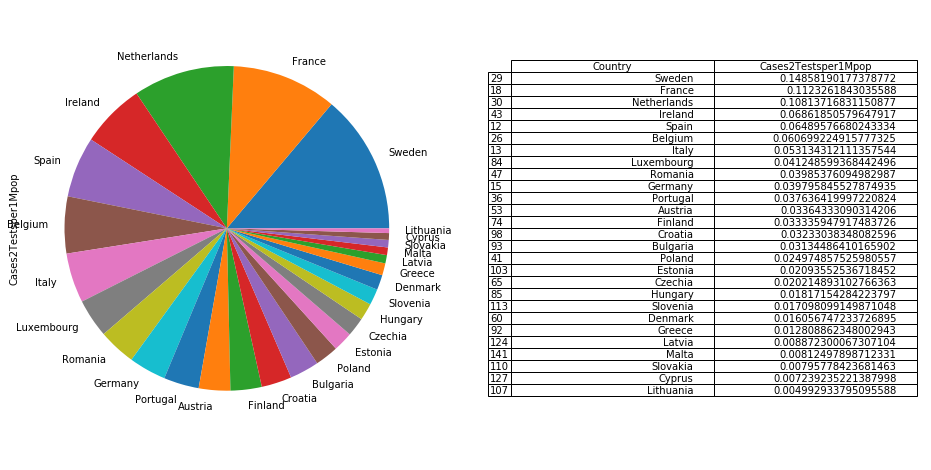

In [62]:
print (dfDDh2[dfDDh2["Cases2Testsper1Mpop"]<1000].to_string(index=False))
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDDh2.plot.pie(y='Cases2Testsper1Mpop',ax=ax1,labels=dfDDh2['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDDh2, loc='center')
#tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.show()

In [63]:
dfT1 = dfAll
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
dfTT[dfTT[0]>=0.000001].sort_values(by=[0], ascending=True)
#dfTT[dfTT.Country=="France"]

,Country,0,Testsper1Mpop
35,Singapore,0.000635,83568.000000
25,Qatar,0.000919,97868.000000
151,Réunion,0.002053,19218.000000
52,Bahrain,0.002085,237420.000000
129,French Guiana,0.002181,929.000000
104,CAR,0.002561,3764.000000
79,Nepal,0.003251,10103.000000
123,Hong Kong,0.003610,32293.000000
77,Uzbekistan,0.003943,22384.000000
102,Maldives,0.004049,53594.000000


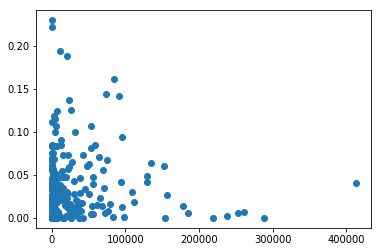

In [64]:
plt.plot(dfTTh["Testsper1Mpop"],dfTTh['DeathRate'],'o')

/usr/local/lib/python3.5/dist-packages/matplotlib/patches.py:694: RuntimeWarning: invalid value encountered in double_scalars
  self._x1 = self._x0 + self._width
/usr/local/lib/python3.5/dist-packages/matplotlib/projections/polar.py:67: RuntimeWarning: invalid value encountered in less
  mask = r < 0


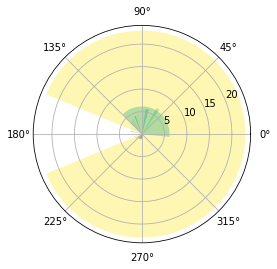

In [65]:
import numpy as np
import matplotlib.pyplot as plt


# Fixing random state for reproducibility
np.random.seed(19680801)

# Compute pie slices
N = len(dfTTh)
theta = np.linspace(0.0, 2*np.pi, N, endpoint=False)
radii = 100 * dfTTh['DeathRate']
width = 2*np.pi* 3.5/ dfTTh["Testsper1Mpop"]
colors = plt.cm.viridis(radii / 10.)

ax = plt.subplot(111, projection='polar')
ax.bar(theta, radii, width=width, bottom=0.0, color=colors, alpha=0.35)

plt.show()

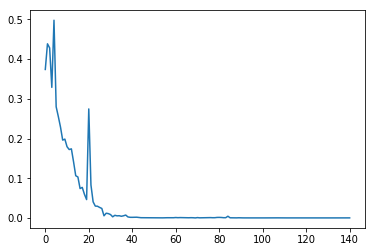

In [66]:
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)))

In [67]:
#np.diff(np.log(dfCN["cases"].values))

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: RuntimeWarning: divide by zero encountered in log
  """Entry point for launching an IPython kernel.


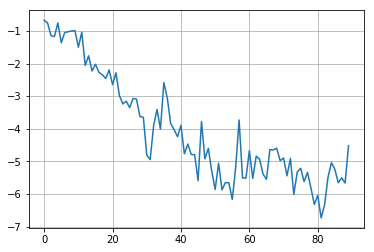

In [68]:
plt.plot(range(len(dfLT["cases"].values[3:])-1),np.log(np.diff(np.log(dfLT["cases"].values[3:]))))
plt.grid()

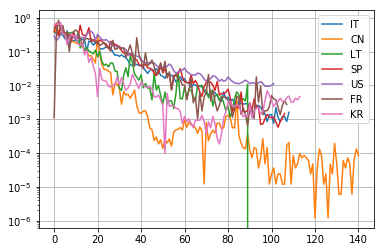

In [69]:
plt.plot(range(len(dfIT["cases"].values)-1),np.diff(np.log(dfIT["cases"].values))[:],label='IT')
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)),label='CN')
plt.plot(range(len(dfLT["cases"].values)-4),np.diff(np.log(dfLT["cases"].values))[3:],label='LT')
plt.plot(range(len(dfSP["cases"].values)-1),np.diff(np.log(dfSP["cases"].values)),label='SP')
plt.plot(range(len(dfUS["cases"].values)-1),np.diff(np.log(dfUS["cases"].values)),label='US')
plt.plot(range(len(dfFR["cases"].values)-10),np.diff(np.log(dfFR["cases"].values))[9:],label='FR')
plt.plot(range(len(dfKR["cases"].values)-4),np.diff(np.log(dfKR["cases"].values))[3:],label='KR')
plt.yscale('log')
plt.grid()
plt.legend()
plt.show()

102 102
coefficient of determination: 0.84573335461451
intercept: -9.401899088420258
slope: [-0.11914039]


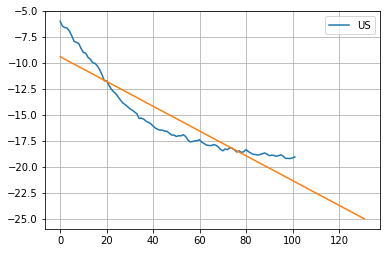

In [70]:
y = np.log(np.diff(dfUS["cases"].values)[:]/dfUS["cases"].values[1:]**2)
x = np.array(range(len(dfUS["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='US')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+30) 
plt.plot(range(len(x)+30),y_pred11)
plt.grid()
plt.legend()
plt.savefig("pictures/logdiffUS.png")
plt.show()

109 109
coefficient of determination: 0.9058564521916194
intercept: -9.885238755722323
slope: [-0.09980895]


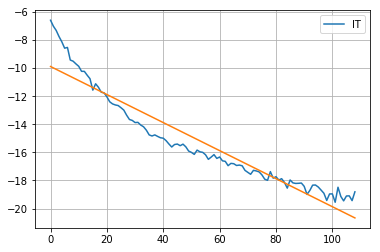

In [71]:
y = np.log(np.diff(dfIT["cases"].values)[:]/dfIT["cases"].values[1:]**2)
x = np.array(range(len(dfIT["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='IT')
y_pred12 = model.intercept_ + model.coef_ * range(len(x)) 
plt.plot(x,y_pred12)
plt.grid()
plt.legend()
plt.show()

In [72]:
#model11.coef_

In [73]:
#np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)

91 91
coefficient of determination: 0.910369994789146
intercept: -15.155593513804364
slope: [-0.06227516]


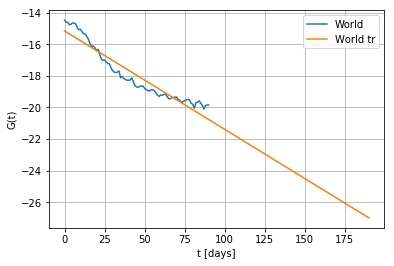

In [74]:
y = np.log(np.diff(dfW["cases"].values)[50:]/dfW["cases"].values[51:]**2)
x = np.array(range(len(dfW["cases"].values[50:])-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='World')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+100)
plt.plot(range(len(x)+100),y_pred11,label='World tr')
plt.legend()
plt.xlabel('t [days]')
plt.ylabel('G(t)')
plt.grid()
plt.savefig("pictures/logdifflogcoronaW.png")

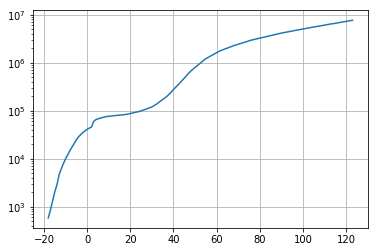

In [75]:
waveform_1 = dfW['cases'].values
waveform_A = dfW['active'].values
t = np.arange(-18,len(waveform_1)-18)
plt.plot(t, waveform_1) 
plt.yscale("log")
plt.grid()
plt.show()

In [76]:
dfW['cases'].values

array([    580,     845,    1317,    2015,    2800,    4581,    6058,
          7813,    9823,   11950,   14553,   17391,   20630,   24545,
         28266,   31439,   34876,   37552,   40553,   43099,   45134,
         59287,   64438,   67100,   69197,   71329,   73332,   75184,
         75700,   76677,   77673,   78651,   79205,   80087,   80828,
         81820,   83112,   84615,   86604,   88585,   90443,   93016,
         95314,   98425,  102050,  106099,  109991,  114381,  118948,
        126214,  134576,  145483,  156653,  169593,  182490,  198238,
        218822,  244933,  275597,  305036,  337489,  378860,  422629,
        471035,  531864,  596366,  663079,  723279,  784738,  858355,
        936237, 1016330, 1117928, 1203058, 1274578, 1347566, 1432869,
       1519195, 1605277, 1700004, 1780713, 1853505, 1925330, 2000065,
       2084633, 2183942, 2252370, 2332650, 2407467, 2482272, 2557917,
       2638909, 2725972, 2833697, 2921571, 2995209, 3065871, 3139009,
       3221029, 3308

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in true_divide
  after removing the cwd from sys.path.
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


[ 1.17013396e+07  1.53029416e+00 -8.33148163e+01  1.54761494e-02]


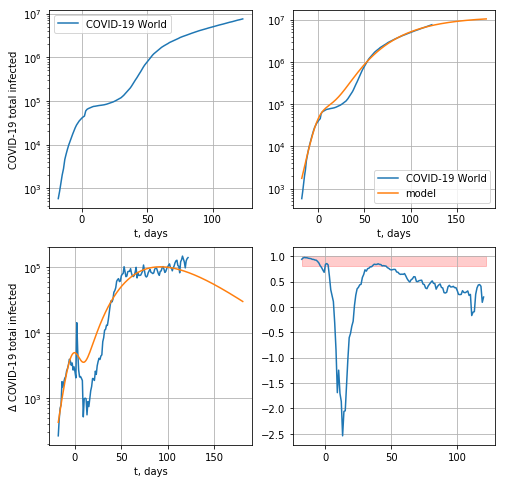

113620.53039632991


In [77]:
def model(t, coeffs):
    coeffsCN = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
    #coeffsCN = [2.06174475e+06, 1.67277852e-01, 5.36255447e+01]
    return coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]) + coeffsCN[0]/(1 + np.exp( - coeffsCN[1] * (t - coeffsCN[2])))

x0 = np.array([2.06174475e+06, 1.67277852e-01, 5.36255447e+01, 0.9 ], dtype=float)
#x0 = np.array([8.08757112e+04,  2.24114193e-01, -6.94900467e-01 ], dtype=float)
def residuals(coeffs, y, t):
    return y - model(t, coeffs)
from scipy.optimize import leastsq
x, flag = leastsq(residuals, x0, args=(waveform_1, t))
print(x)
tt = np.arange(-18,len(waveform_1)-18+59)
fig, ((ax3,ax1),(ax2,ax4)) = plt.subplots(2,2,figsize=(8,8), sharex=False, sharey=False)
ax3.plot(t, waveform_1) 
ax3.legend(['COVID-19 World']) 
ax3.set_xlabel('t, days')
ax3.set_yscale("log")
ax3.set_ylabel(r'COVID-19 total infected')
ax3.grid()
ax1.plot(t, waveform_1, tt, model(tt, x)) 
ax1.legend(['COVID-19 World', 'model']) 
ax1.set_xlabel('t, days')
ax1.set_yscale("log")
ax1.grid()
ax2.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(model(tt, x)))
ax2.set_ylabel(r'$\Delta$ COVID-19 total infected')
ax2.set_yscale("log")
ax2.grid()
ax2.set_xlabel('t, days')
z = np.diff(moving_average(waveform_A, n=3) )/np.diff(moving_average(waveform_1, n=3))
ax4.plot(t[:-3],z)
#ax4.axhline(y=2.2587741081036339/2, color='r')
ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
#ax4.set_yscale("log")
ax4.grid()
plt.savefig("pictures/covidworld.png")

plt.show()
print(np.std(residuals(x, waveform_1, t)))
#expPopWorld = x[0]
expPopWorld = 2.67152730e+06

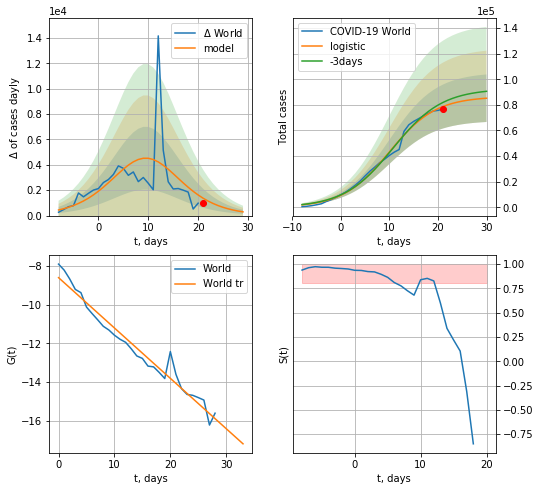

World data at: 2020-06-11
+3 day model MAPE: 0.04256770161128604
model: logistic
coeffs:  [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.2178111789766563
forecast at the end of period: +9 days
	 deltaDaycases:  293
	 total cases:  85189 ± 18555
	 total death:  4751 ± 3104
trend coefficient of determination: 0.960820
 intercept: -8.598458
 slope: -0.260482


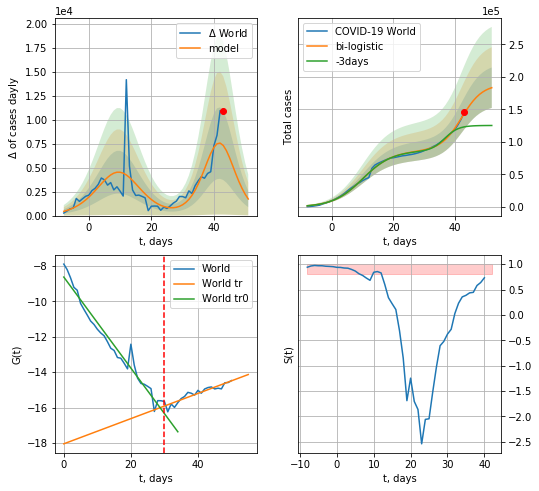

World data at: 2020-06-11
+3 day model MAPE: 0.2157297639626565
model: bi-logistic
coeffs:  [1.02227608e+05 2.95650820e-01 4.22366999e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.16992860985061978
forecast at the end of period: +9 days
	 deltaDaycases:  1731
	 total cases:  183288 ± 31145
	 total death:  10223 ± 5211
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend coefficient of determination: 0.868835
 intercept: -18.049568
 slope: 0.071157


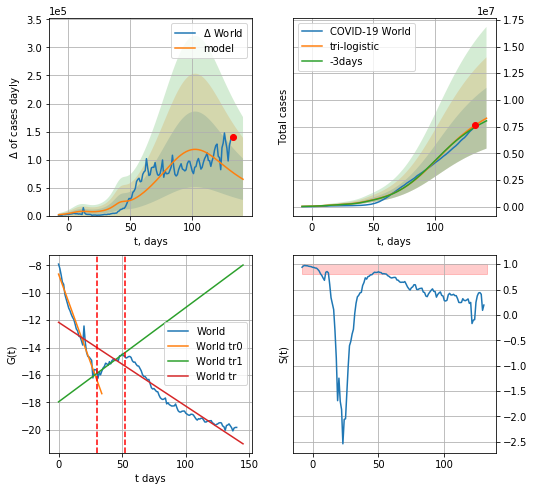

World data at: 2020-06-11
+3 day model MAPE: 0.024805750059372692
model: tri-logistic
coeffs:  [8.09805634e+06 5.52448645e-02 1.00924942e+02] [8.64735804e+04 2.09600360e-01 9.98515269e+00 1.02227608e+05
 2.95650820e-01 4.22366999e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.3441960076163793
forecast at the end of period: +9 days
	 deltaDaycases:  64829
	 total cases:  8283414 ± 2851118
	 total death:  462024 ± 477080
tri-logistic approximation splitting points: 30,52
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend1 coefficient of determination: 0.872494
 intercept: -17.970431
 slope: 0.068998
trend coefficient of determination: 0.905335
 intercept: -12.152513
 slope: -0.061274


In [78]:
vL = 30
x = forecast("World",dfW[:vL],d1,7*12-dT,1.0,False)
xx = forecast2("World",dfW[:52],d1,7*12-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("World",dfW,d1,7*12-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,52])

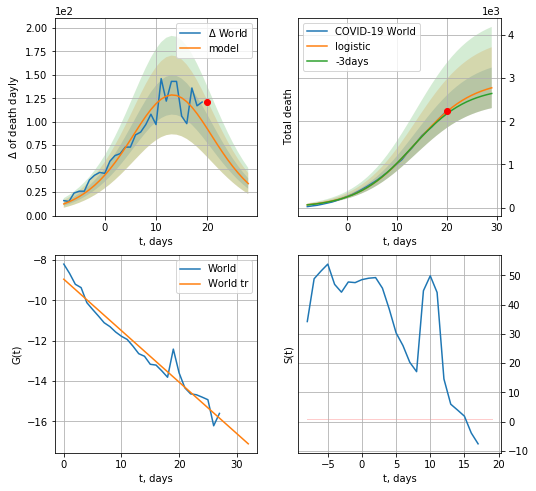

World data at: 2020-06-11
+3 day model MAPE: 0.027312192470115494
model: logistic
coeffs:  [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.16928081921473714
forecast at the end of period: +9 days
	 total death:  2774 ± 469
trend coefficient of determination: 0.959176
 intercept: -8.958870
 slope: -0.254930


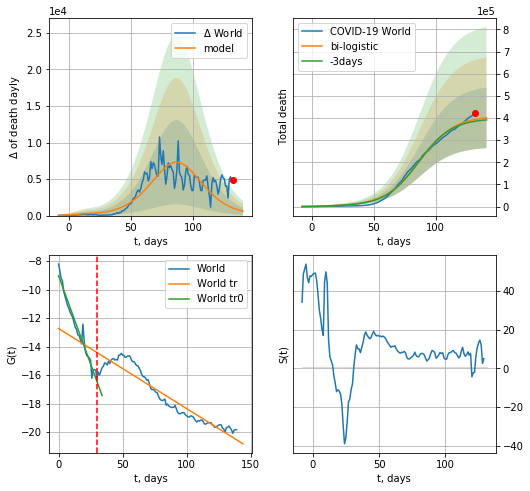

World data at: 2020-06-11
+3 day model MAPE: 0.021434857240339347
model: bi-logistic
coeffs:  [4.06111820e+05 7.19486317e-02 8.70592237e+01] [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.3412095664051355
forecast at the end of period: +9 days
	 deltaDaydeath:  599
	 total death:  400872 ± 136781
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.960969
 intercept: -9.026339
 slope: -0.247583
trend coefficient of determination: 0.900839
 intercept: -12.733038
 slope: -0.056232


In [79]:
vL = 30
vL1=52
x = forecast("World",dfW[1:vL],d1,7*12-dT,1.0,False,cases='death')
xx = forecast2("World",dfW[1:],d1,7*12-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("World",dfW,d1,7*20-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

In [80]:
#vL = 30
#x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
#xx = forecast2("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.7],vL=vL)
#trend(dfW,"W",10)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


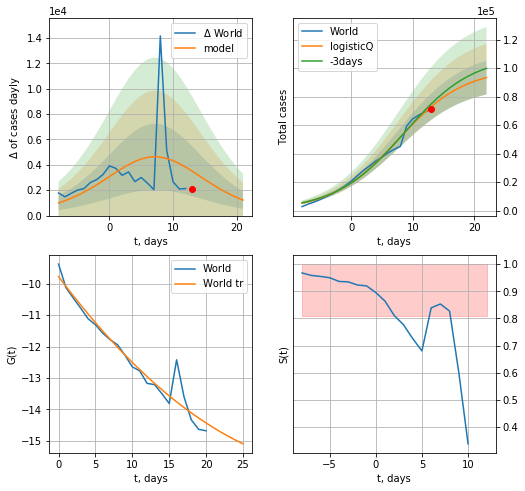

World data at: 2020-06-11
+3 day model MAPE: 0.031802
model: logisticQ
coeffs: [ 9.98643255e+04  1.79652646e-05  7.63889680e+00 -1.03375904e+04]
rational stdev: 0.126959
forecast at the end of period: +9 days
	 deltaDaycases: 1219
	 total cases: 93413 ± 11859
	 total death: 5210 ± 1984
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


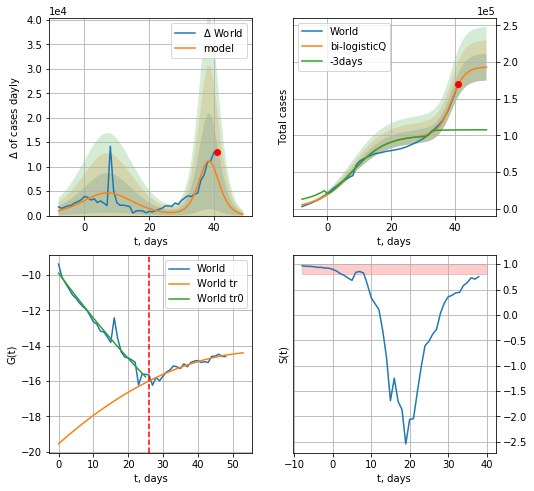

World data at: 2020-06-11
+3 day model MAPE: 0.635593
model: bi-logisticQ
coeffs: [ 9.37578627e+04  2.55228565e-05  3.89552969e+01 -1.87082152e+04]
rational stdev: 0.094698
forecast at the end of period: +9 days
	 deltaDaycases: 294
	 total cases: 193114 ± 18287
	 total death: 10771 ± 3059
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.893677
 intercept_: -19.558019139425994
 coeffs_: [ 0.          0.17538587 -0.00147405]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


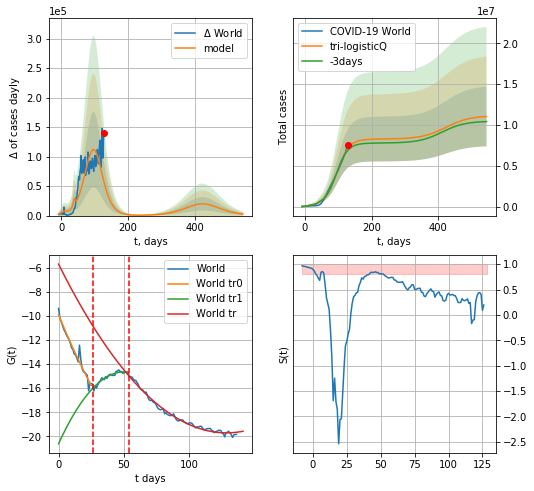

World data at: 2020-06-11
+3 day model MAPE: 0.032507
model: tri-logisticQ
coeffs: [ 8.07947203e+06  3.42682128e-07  9.68817763e+01 -1.61618711e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.331029
forecast at the end of period: +415 days
	 deltaDaycases: 2542
	 total cases: 11041526 ± 3655060
	 total death: 615863 ± 611604
tri-logisticQ approximation splitting points: 26,54
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.900515
 intercept_: -20.622215746086294
 coeffs_: [ 0.          0.23801537 -0.00236922]
trend coefficient of determination: 0.988436
 intercept_: -5.689591905789127
 coeffs_: [ 0.         -0.21847851  0.00085097]


In [81]:
vL=30 - 4
vL1=59 - 5
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
x = forecastRRR("World",dfW[4:vL],d1,7*12-dT,1.0,False)
xx = forecast2RRR("World",dfW[4:vL1],d1,7*12-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*70-dT, xx, shift=1.,addpred=True,xcoef=koreaCoeffs,vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


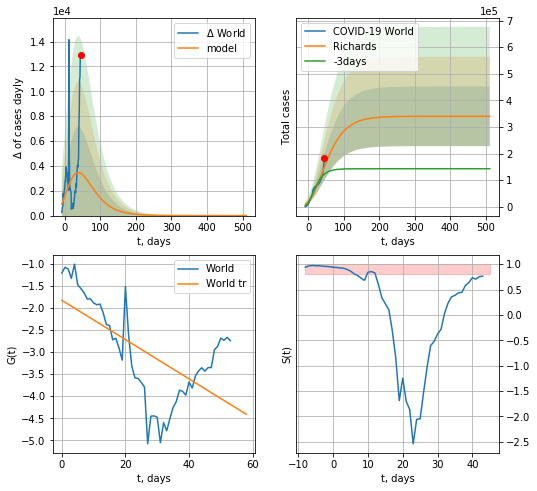

World data at: 2020-06-11
+3 day model MAPE: 0.241624
model: Richards
coeffs: [ 3.40077948e+05  3.51040118e+00 -1.35212982e+02  7.92067107e-03]
rational stdev: 0.329278
forecast at the end of period: +465 days
	 deltaDaycases: 0
	 total cases: 340077 ± 111979
	 total death: 18968 ± 18737
trend coefficient of determination: 0.389866
 intercept: -1.829818
 slope: -0.044449


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


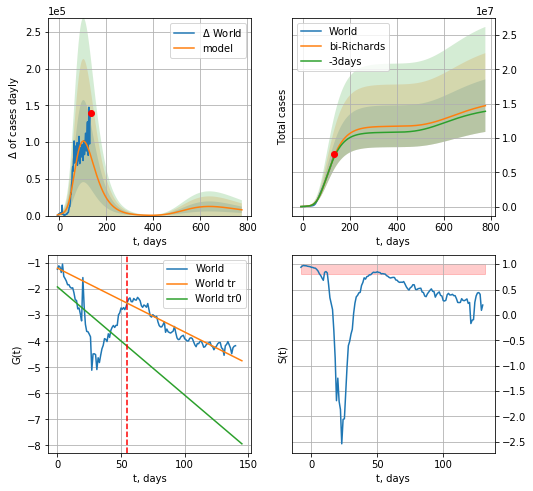

World data at: 2020-06-11
+3 day model MAPE: 0.019777
model: bi-Richards
coeffs: [ 1.13683396e+07  2.16925673e+00 -8.36244857e+01  1.10912662e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.260005
forecast at the end of period: +645 days
	 deltaDaycases: 7858
	 total cases: 14704985 ± 3823369
	 total death: 820200 ± 639768
bi-Richards approximation splitting point: 55
trend coefficient of determination: 0.357352
 intercept: -1.912822
 slope: -0.041553
trend coefficient of determination: 0.869588
 intercept: -1.192844
 slope: -0.024529


In [82]:
vL = 55
x = forecastRR("World",dfW[:vL],d1,60*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("World",dfW[:],d1,80*9-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

142


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


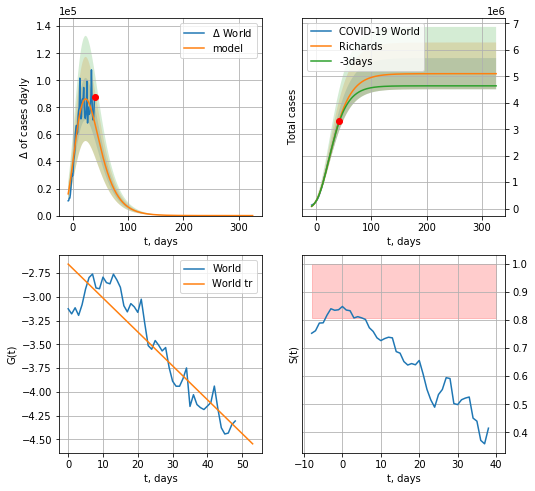

World data at: 2020-06-11
+3 day model MAPE: 0.014871
model: Richards
coeffs: [ 5.10254335e+06  1.04395582e+00 -4.20545297e+01  4.49970923e-02]
rational stdev: 0.115529
forecast at the end of period: +285 days
	 deltaDaycases: 0
	 total cases: 5102539 ± 589489
	 total death: 284604 ± 98639
trend coefficient of determination: 0.854892
 intercept: -2.655636
 slope: -0.035656


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


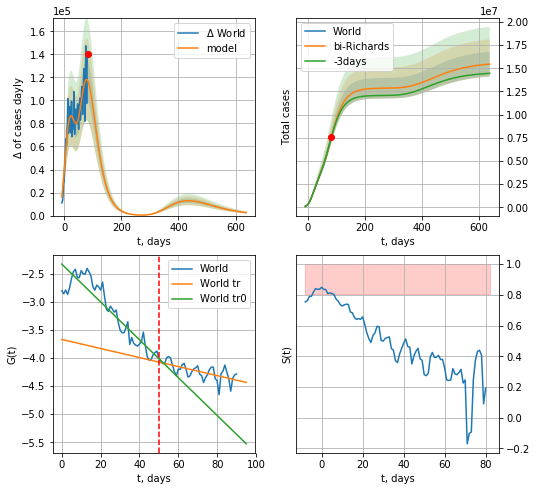

World data at: 2020-06-11
+3 day model MAPE: 0.006118
model: bi-Richards
coeffs: [ 7.75437049e+06  2.00533122e+00 -2.53833068e+01  1.82392873e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.086440
forecast at the end of period: +555 days
	 deltaDaycases: 2586
	 total cases: 15452906 ± 1335751
	 total death: 861917 ± 223512
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.842977
 intercept: -2.332538
 slope: -0.033616
trend coefficient of determination: 0.424951
 intercept: -3.671722
 slope: -0.008032


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


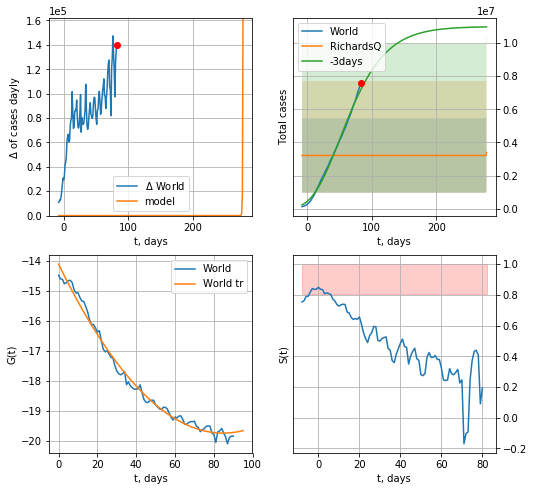

World data at: 2020-06-11
+3 day model MAPE: 0.556561
model: RichardsQ
coeffs: [ 3.21384201e+06  1.19794744e-02 -3.20494894e+02  2.79848711e+02
 -3.07047851e-01]
rational stdev: 0.697996
forecast at the end of period: +195 days
	 deltaDaycases: 162220
	 total cases: 3396095 ± 2370461
	 total death: 189424 ± 396651
trend coefficient of determination: 0.990019
 intercept_: -14.109297633149716
 coeffs_: [ 0.         -0.13281626  0.00078381]


In [83]:
print (len(dfW))
vL = 100
x = forecastRR("World",dfW[50:vL],d1,40*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("World",dfW[50:],d1,70*9-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-50)
x = forecastQR("World",dfW[50:],d1,30*9-dT,1.0,addpred=False)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


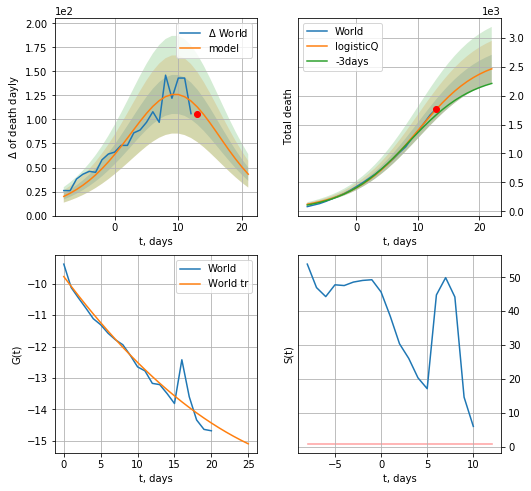

World data at: 2020-06-11
+3 day model MAPE: 0.067194
model: logisticQ
coeffs: [ 2.67019299e+03  8.28077677e-04  9.49653382e+00 -2.18469917e+02]
rational stdev: 0.098000
forecast at the end of period: +9 days
	 total death: 2465 ± 241
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


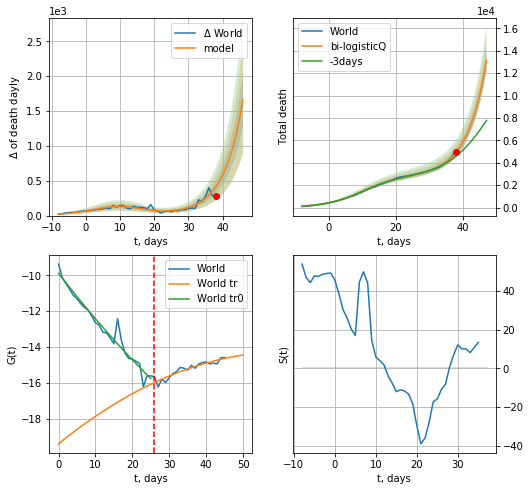

World data at: 2020-06-11
+3 day model MAPE: 0.105655
model: bi-logisticQ
coeffs: [ 6.42204134e+06  6.90051546e-04  7.95652837e+01 -2.38689793e+02]
rational stdev: 0.076590
forecast at the end of period: +9 days
	 total death: 13112 ± 1004
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.866834
 intercept_: -19.41123113056416
 coeffs_: [ 0.          0.16686573 -0.0013545 ]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp


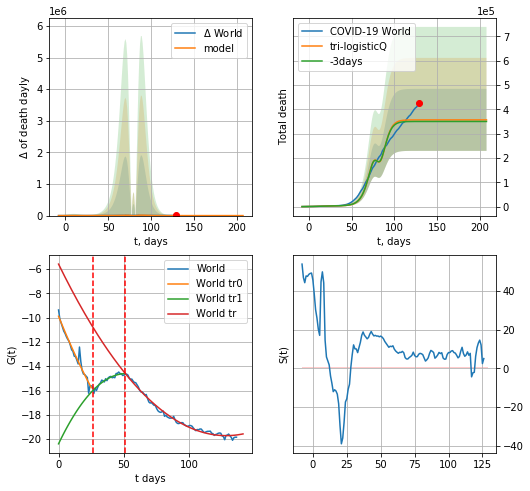

World data at: 2020-06-11
+3 day model MAPE: 0.018769
model: tri-logisticQ
coeffs: [-6.06832022e+06  7.66124658e-04 -2.26182413e+02  7.95896695e+01]
rational stdev: 0.357236
forecast at the end of period: +79 days
	 total death: 356391 ± 127315
tri-logisticQ approximation splitting points: 26,51
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.890965
 intercept_: -20.382525077358043
 coeffs_: [ 0.          0.22422642 -0.00217733]
trend coefficient of determination: 0.990359
 intercept_: -5.602026210080833
 coeffs_: [ 0.         -0.22024421  0.00085952]


In [84]:
vL=30 - 4
vL1=51
x = forecastRRR("World",dfW[4:vL],d1,7*12-dT,1.0,False,cases='death')
xx = forecast2RRR("World",dfW[4:vL1],d1,7*12-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*22-dT, xx, shift=1.,addpred=False,xcoef=[.35,.5,4.,1.],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


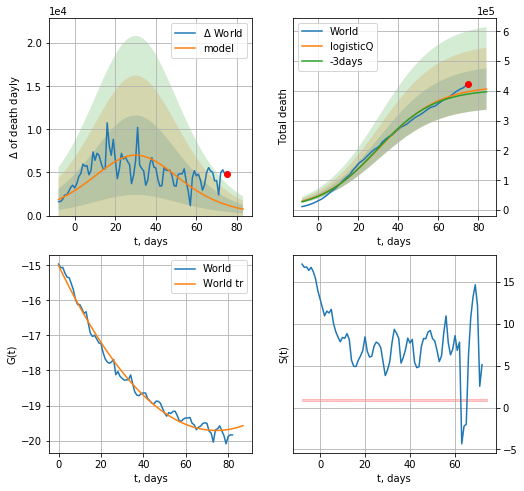

World data at: 2020-06-11
+3 day model MAPE: 0.020525
model: logisticQ
coeffs: [ 4.17404609e+05  4.58569127e-07  3.05044908e+01 -1.46505991e+05]
rational stdev: 0.171198
forecast at the end of period: +9 days
	 total death: 406260 ± 69551
trend coefficient of determination: 0.988436
 intercept_: -15.004347710372596
 coeffs_: [ 0.         -0.12669235  0.00085239]


In [85]:
x = forecastRRR("World",dfW[58:],d1,7*12-dT,1.0,False,cases='death')

In [86]:
#trend(dfSP,'SP',10)

In [87]:
#vL = len(dfSP[:])-16-dT
#x = forecast('Spain',dfSP[:vL],d1,30-dT,1.0)
#xx = forecast2('Spain',dfSP,d1,7*6-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.8],vL=vL)

SP
           date   cases  active    death
103 2020-06-07  288630       0  27136.0
104 2020-06-08  288797       0  27136.0
105 2020-06-09  289046       0  27136.0
106 2020-06-10  289360       0  27136.0
107 2020-06-11  289787       0  27136.0


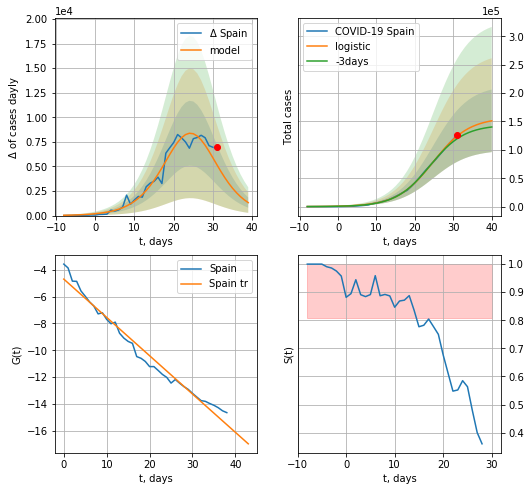

Spain data at: 2020-06-11
+3 day model MAPE: 0.04562669977631666
model: logistic
coeffs:  [1.56957534e+05 2.13812412e-01 2.47399190e+01]
rational stdev:  0.3648922799171356
forecast at the end of period: +9 days
	 deltaDaycases:  1317
	 total cases:  151170 ± 55160
	 total death:  14155 ± 15495
trend coefficient of determination: 0.974785
 intercept: -4.699916
 slope: -0.285083


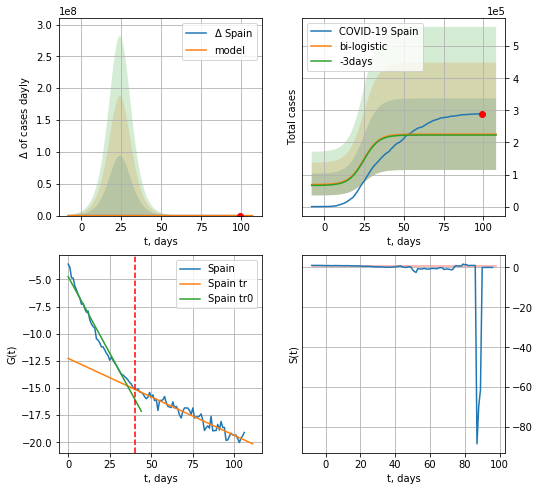

Spain data at: 2020-06-11
+3 day model MAPE: 0.012412898143067409
model: bi-logistic
coeffs:  [ 5.49683794e+04 -5.12878688e+00  1.35634804e+02] [1.56957534e+05 2.13812412e-01 2.47399190e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.49370472600188087
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  225668 ± 111413
	 total death:  21131 ± 31297
bi-logistic approximation splitting point: 40
trend0 coefficient of determination: 0.974598
 intercept: -4.739484
 slope: -0.281959
trend coefficient of determination: 0.927478
 intercept: -12.274927
 slope: -0.070911


In [88]:
dfSP = read_df(pd.DataFrame(),"SP")
vL = 40#len(dfSP[:])-7-dT
x = forecast('Spain',dfSP[:vL],d1,7*12-dT,1.0,cases='cases')
xx = forecast2('Spain',dfSP[:],d1,7*12-dT,x,1.0,addpred=True,xcoef=[.25,1.,1.6],vL=vL,cases='cases')

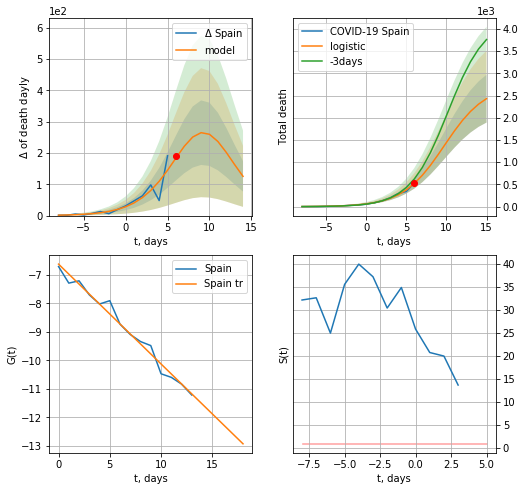

Spain data at: 2020-06-11
+3 day model MAPE: 0.1992580202993838
model: logistic
coeffs:  [2.74529349e+03 3.87912491e-01 9.73356455e+00]
rational stdev:  0.22139705331908888
forecast at the end of period: +9 days
	 total death:  2430 ± 538
trend coefficient of determination: 0.980020
 intercept: -6.621221
 slope: -0.350134


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:245: RuntimeWarning: invalid value encountered in true_divide


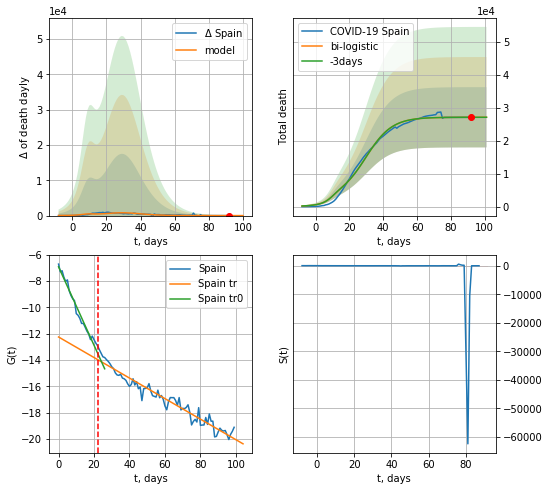

Spain data at: 2020-06-11
+3 day model MAPE: 3.8858483805534134e-05
model: bi-logistic
coeffs:  [2.44101305e+04 1.29490830e-01 2.96872612e+01] [2.74529349e+03 3.87912491e-01 9.73356455e+00]
rational stdev:  0.3372128027223797
forecast at the end of period: +9 days
	 deltaDaydeath:  0
	 total death:  27153 ± 9156
bi-logistic approximation splitting point: 22
trend0 coefficient of determination: 0.976968
 intercept: -6.910878
 slope: -0.297821
trend coefficient of determination: 0.943628
 intercept: -12.239629
 slope: -0.078005


In [89]:
vL = 22#len(dfSP[:])-7-dT
#dfSP = read_df(pd.DataFrame(),"SP")
x = forecast('Spain',dfSP[7:vL],d1,7*12-dT,1.0,cases='death')
xx = forecast2('Spain',dfSP[7:],d1,7*12-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.8],vL=vL,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


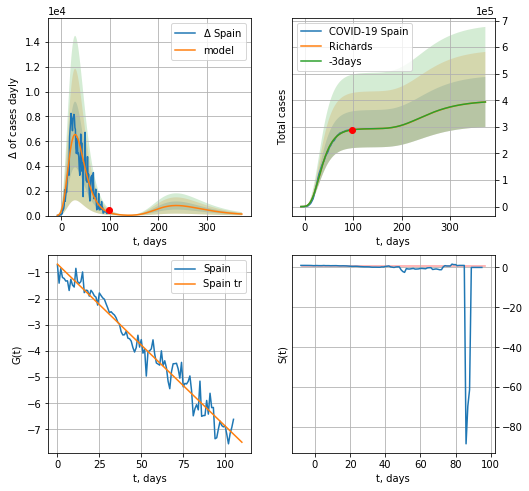

Spain data at: 2020-06-11
+3 day model MAPE: 0.000370
model: Richards
coeffs: [ 2.93360958e+05  8.16875760e+00 -5.15313474e+01  7.45429368e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.239207
forecast at the end of period: +275 days
	 deltaDaycases: 125
	 total cases: 393537 ± 94136
	 total death: 36851 ± 26444
trend coefficient of determination: 0.964718
 intercept: -0.683629
 slope: -0.061861


In [90]:
x = forecastRR('Spain',dfSP[1:],d1,7*50-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:75: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


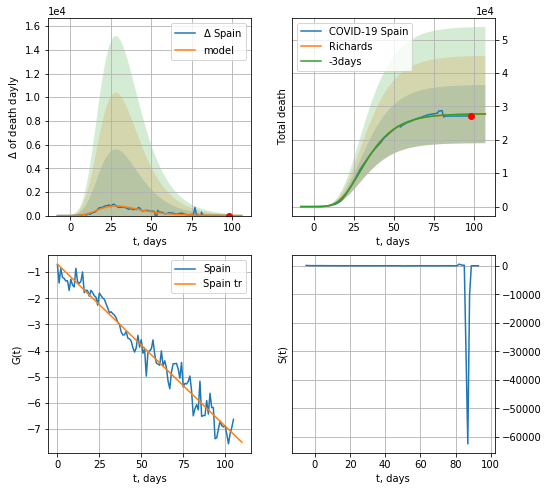

Spain data at: 2020-06-11
+3 day model MAPE: 0.002182
model: Richards
coeffs: [ 2.77533585e+04  9.24820967e+00 -3.05486461e+01  8.68486165e-03]
rational stdev: 0.314222
forecast at the end of period: +9 days
	 total death: 27702 ± 8704
trend coefficient of determination: 0.964874
 intercept: -0.693106
 slope: -0.061939


In [91]:
x = forecastRR('Spain',dfSP[1:],d1,7*12-dT,1.0,addpred=False,xcoef=[.25,1.,3.,1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


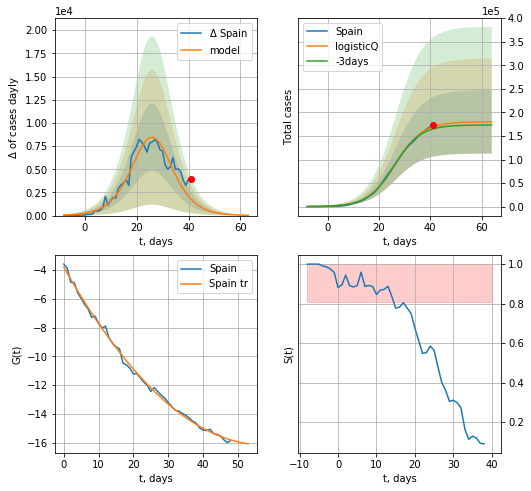

Spain data at: 2020-06-11
+3 day model MAPE: 0.028163
model: logisticQ
coeffs: [ 1.79944314e+05  4.82942779e-06  2.63952863e+01 -3.89581546e+04]
rational stdev: 0.373922
forecast at the end of period: +23 days
	 deltaDaycases: 31
	 total cases: 179793 ± 67228
	 total death: 16836 ± 18886
trend coefficient of determination: 0.997334
 intercept_: -3.7990007659330134
 coeffs_: [ 0.         -0.42831531  0.00370949]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


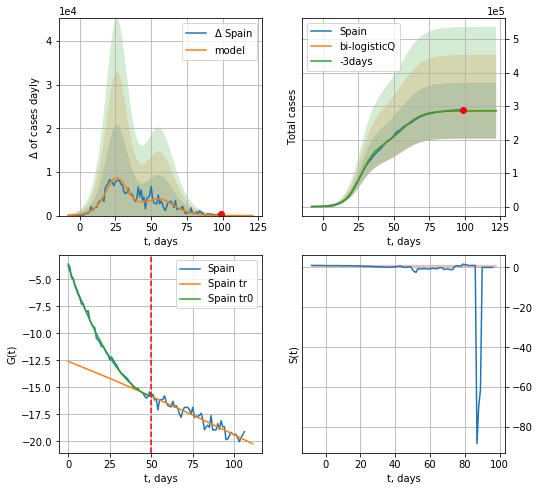

Spain data at: 2020-06-11
+3 day model MAPE: 0.002217
model: bi-logisticQ
coeffs: [ 1.06469438e+05  5.80450041e-07  5.62260049e+01 -2.42143963e+05]
rational stdev: 0.290879
forecast at the end of period: +23 days
	 deltaDaycases: 1
	 total cases: 286403 ± 83308
	 total death: 26819 ± 23403
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.997131
 intercept_: -3.7751216617675887
 coeffs_: [ 0.         -0.43240435  0.00381547]
trend coefficient of determination: 0.893893
 intercept_: -12.59071831973435
 coeffs_: [ 0.00000000e+00 -6.13698795e-02 -6.63152153e-05]


In [92]:
x = forecastRRR('Spain',dfSP[:50],d1,7*14-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[:],d1,7*14-dT,x,1.0,addpred=False,xcoef=koreaCoeffs,vL=50)#[.35,.5,3.,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


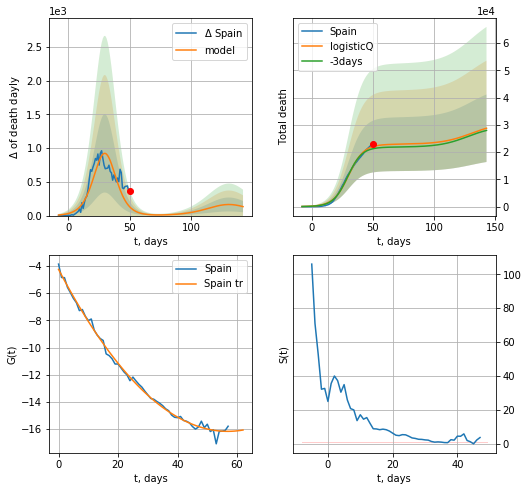

Spain data at: 2020-06-11
+3 day model MAPE: 0.037624
model: logisticQ
coeffs: [ 2.28798062e+04  1.92571131e-06  3.00460867e+01 -8.38155043e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.430820
forecast at the end of period: +93 days
	 total death: 28768 ± 12394
trend coefficient of determination: 0.995937
 intercept_: -4.2575122176431694
 coeffs_: [ 0.         -0.41856419  0.00368029]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:294: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:347: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:347: RuntimeWarning: invalid value encountered in true_divide


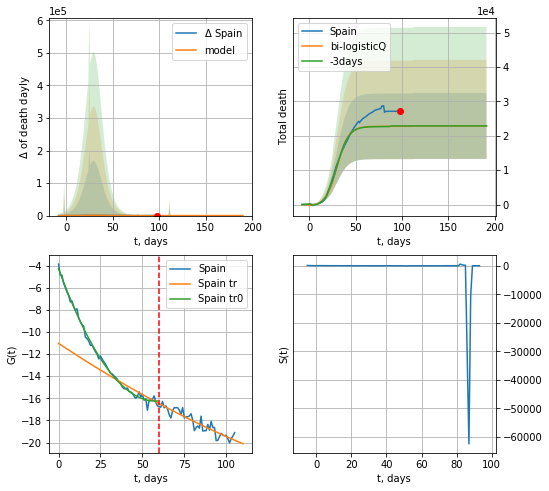

Spain data at: 2020-06-11
+3 day model MAPE: 0.004733
model: bi-logisticQ
coeffs: [-305.74643049   -2.74660736   25.64213547   -1.51806454]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.419576
forecast at the end of period: +93 days
	 total death: 22879 ± 9599
bi-logisticQ approximation splitting point: 60
trend coefficient of determination: 0.995783
 intercept_: -4.28878212009627
 coeffs_: [ 0.         -0.41413346  0.00358475]
trend coefficient of determination: 0.848287
 intercept_: -11.034777766190102
 coeffs_: [ 0.         -0.10060677  0.00016467]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [93]:
x = forecastRRR('Spain',dfSP[1:60],d1,7*24-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[1:],d1,7*24-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,cases='death',vL=60)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


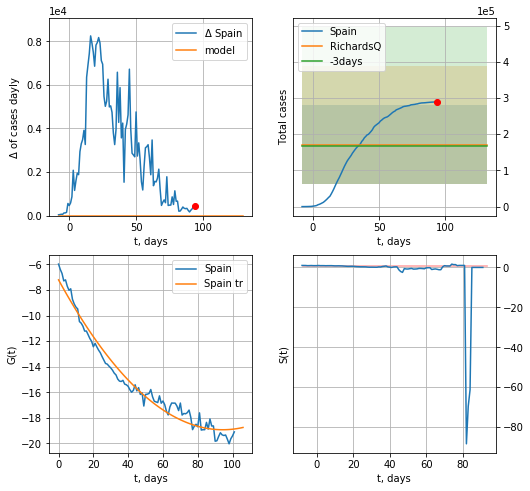

Spain data at: 2020-06-11
+3 day model MAPE: 0.021041
model: RichardsQ
coeffs: [ 1.71553495e+05  4.86635990e-01 -2.39199517e+03  1.91456627e+03
 -3.16500139e+00]
rational stdev: 0.631025
forecast at the end of period: +37 days
	 deltaDaycases: 0
	 total cases: 171553 ± 108254
	 total death: 16064 ± 30410
trend coefficient of determination: 0.970097
 intercept_: -7.206693002353603
 coeffs_: [ 0.         -0.24846847  0.00131672]


In [94]:
x = forecastQR('Spain',dfSP[5:],d1,7*16-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])

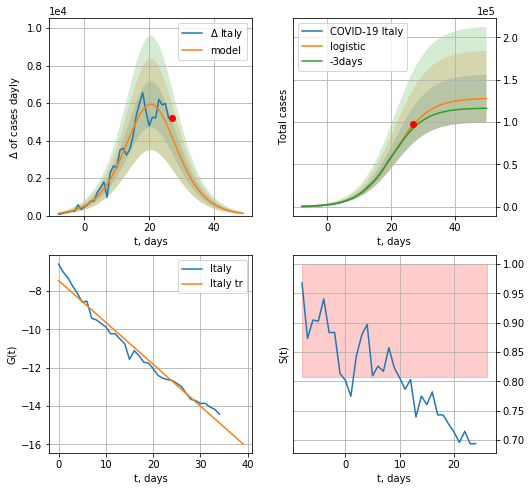

Italy data at: 2020-06-11
+3 day model MAPE: 0.04536229058229775
model: logistic
coeffs:  [1.28444604e+05 1.85121746e-01 2.10190970e+01]
rational stdev:  0.22074329651570546
forecast at the end of period: +23 days
	 deltaDaycases:  120
	 total cases:  127846 ± 28221
	 total death:  18497 ± 12249
trend coefficient of determination: 0.974900
 intercept: -7.448538
 slope: -0.218710


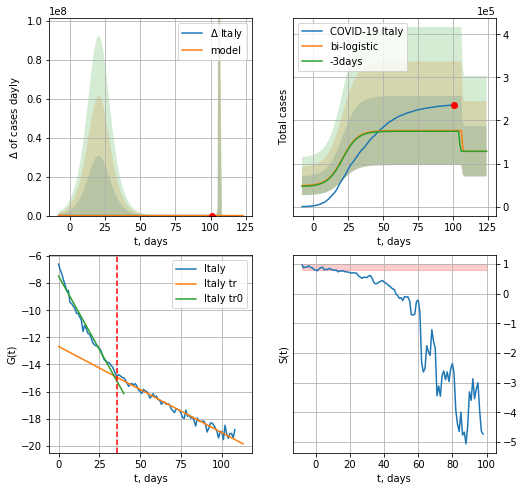

Italy data at: 2020-06-11
+3 day model MAPE: 0.00947742747485395
model: bi-logistic
coeffs:  [ 4.82203760e+04 -6.20061625e+00  1.06744333e+02] [1.28444604e+05 1.85121746e-01 2.10190970e+01]
rational stdev:  0.453696798873944
forecast at the end of period: +23 days
	 deltaDaycases:  0
	 total cases:  128444 ± 58274
	 total death:  18584 ± 25294
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975991
 intercept: -7.466382
 slope: -0.217136
trend coefficient of determination: 0.969805
 intercept: -12.671683
 slope: -0.063613


In [95]:
vL = 36#len(dfIT)-6-dT
x = forecast('Italy',dfIT[:vL],d1,14*7-dT,1.0)
xx = forecast2('Italy',dfIT,d1,14*7-dT,x,1.0,vL=vL)

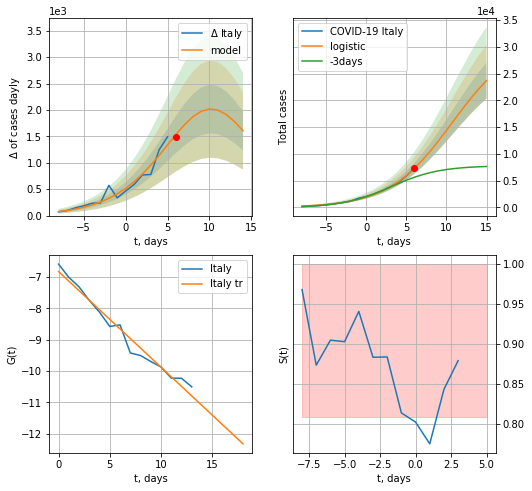

Italy data at: 2020-06-11
+3 day model MAPE: 0.4420796150765939
model: logistic
coeffs:  [3.15102860e+04 2.56561304e-01 1.06831560e+01]
rational stdev:  0.1413171221665118
forecast at the end of period: +9 days
	 deltaDaycases:  1603
	 total cases:  23685 ± 3347
	 total death:  3426 ± 1452
trend coefficient of determination: 0.972659
 intercept: -6.827339
 slope: -0.305199


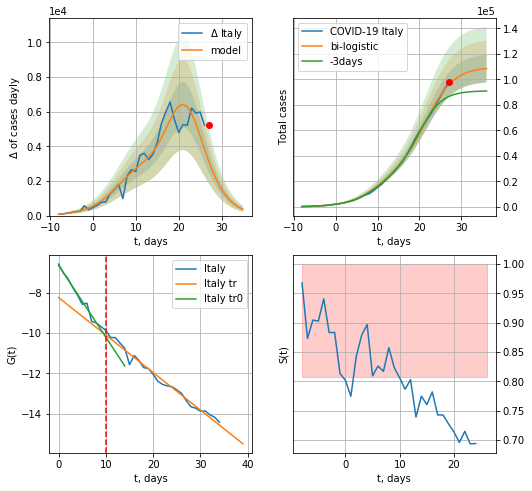

Italy data at: 2020-06-11
+3 day model MAPE: 0.12719416413980916
model: bi-logistic
coeffs:  [7.80633996e+04 3.07326084e-01 2.18190350e+01] [3.15102860e+04 2.56561304e-01 1.06831560e+01]
rational stdev:  0.10039113205484494
forecast at the end of period: +9 days
	 deltaDaycases:  362
	 total cases:  108539 ± 10896
	 total death:  15704 ± 4729
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980956
 intercept: -6.650523
 slope: -0.355965
trend coefficient of determination: 0.983136
 intercept: -8.246485
 slope: -0.185719


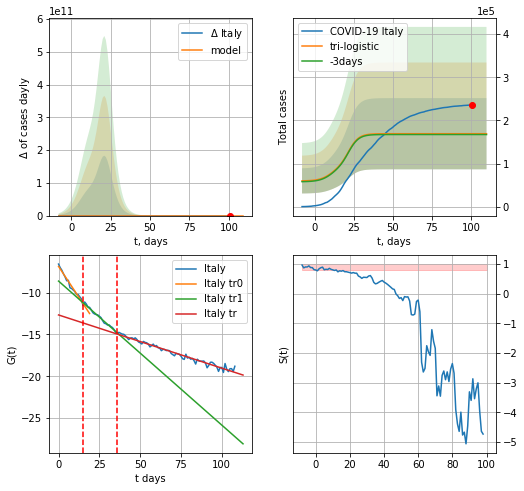

Italy data at: 2020-06-11
+3 day model MAPE: 0.011165366423950504
model: tri-logistic
coeffs:  [ 5.96157482e+04 -4.23422571e+00  1.13652238e+02] [3.15102860e+04 2.56561304e-01 1.06831560e+01 7.80633996e+04
 3.07326084e-01 2.18190350e+01]
forecast rational stdev:  0.4879727697427919
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  169189 ± 82559
	 total death:  24479 ± 35835
tri-logistic approximation splitting points: 15,36
trend0 coefficient of determination: 0.972874
 intercept: -6.864841
 slope: -0.296544
trend1 coefficient of determination: 0.980760
 intercept: -8.621359
 slope: -0.172242
trend coefficient of determination: 0.969805
 intercept: -12.671683
 slope: -0.063613


In [96]:
vL = 15#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*12-dT,1.0)
xx = forecast2('Italy',dfIT[:vL1],d1,7*12-dT,x,1.0)#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*12-dT, xx, shift=1.,addpred=False,xcoef=[.35,1.,1.5],vL=[vL,vL1])

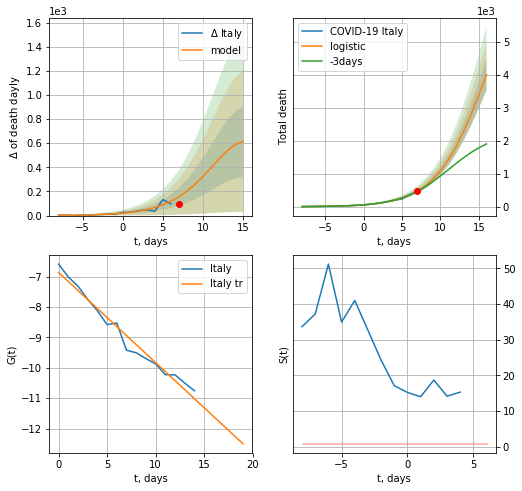

Italy data at: 2020-06-11
+3 day model MAPE: 0.04050471838994123
model: logistic
coeffs:  [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12009380059110428
forecast at the end of period: +9 days
	 total death:  4008 ± 481
trend coefficient of determination: 0.972874
 intercept: -6.864841
 slope: -0.296544


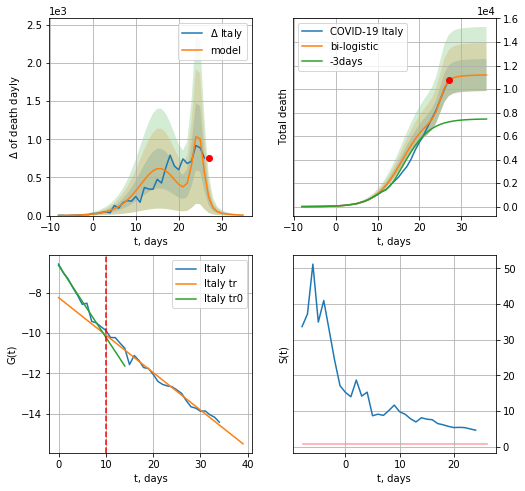

Italy data at: 2020-06-11
+3 day model MAPE: 0.5045455507817326
model: bi-logistic
coeffs:  [3.18991891e+03 1.24679374e+00 2.50159525e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12176249997037505
forecast at the end of period: +9 days
	 deltaDaydeath:  5
	 total death:  11194 ± 1363
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980956
 intercept: -6.650523
 slope: -0.355965
trend coefficient of determination: 0.983136
 intercept: -8.246485
 slope: -0.185719


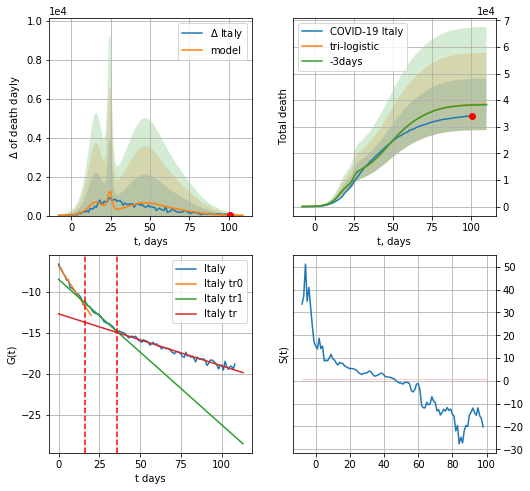

Italy data at: 2020-06-11
+3 day model MAPE: 0.005023484965228908
model: tri-logistic
coeffs:  [2.18487682e+04 1.13038219e-01 4.65554464e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01 3.18991891e+03
 1.24679374e+00 2.50159525e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.2519510992187438
forecast at the end of period: +9 days
	 deltaDaydeath:  8
	 total death:  38448 ± 9687
tri-logistic approximation splitting points: 16,36
trend0 coefficient of determination: 0.976838
 intercept: -6.838821
 slope: -0.302120
trend1 coefficient of determination: 0.986419
 intercept: -8.458056
 slope: -0.177939
trend coefficient of determination: 0.969805
 intercept: -12.671683
 slope: -0.063613


In [97]:
vL = 16#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*12-dT,1.0,cases='death')
xx = forecast2('Italy',dfIT[:vL1],d1,7*12-dT,x,1.0,cases='death')#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*12-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


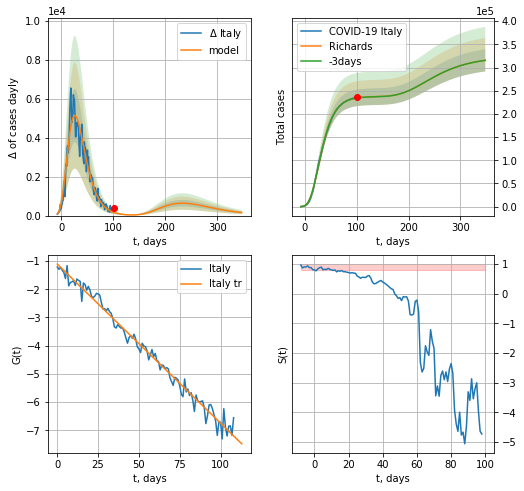

Italy data at: 2020-06-11
+3 day model MAPE: 0.000738
model: Richards
coeffs: [ 2.37571196e+05  6.13783314e+00 -5.24353991e+01  9.63117148e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.076101
forecast at the end of period: +247 days
	 deltaDaycases: 155
	 total cases: 315632 ± 24019
	 total death: 45668 ± 10426
trend coefficient of determination: 0.985278
 intercept: -1.107238
 slope: -0.056390


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


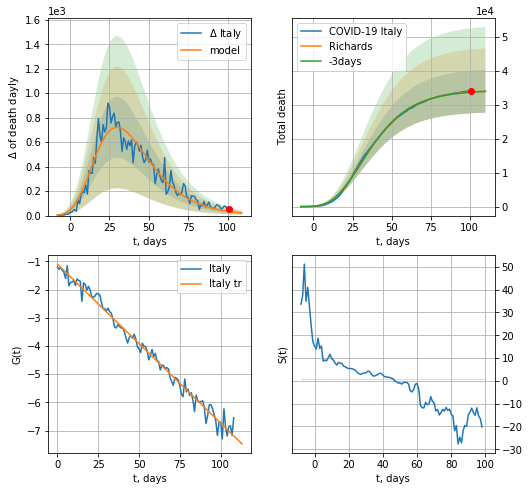

Italy data at: 2020-06-11
+3 day model MAPE: 0.001819
model: Richards
coeffs: [ 3.43552103e+04  6.54098839e+00 -5.23222647e+01  8.76071565e-03]
rational stdev: 0.185868
forecast at the end of period: +9 days
	 total death: 33999 ± 6319
trend coefficient of determination: 0.985252
 intercept: -1.099523
 slope: -0.056351


In [98]:
x = forecastRR('Italy',dfIT[:],d1,46*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRR('Italy',dfIT[:],d1,12*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


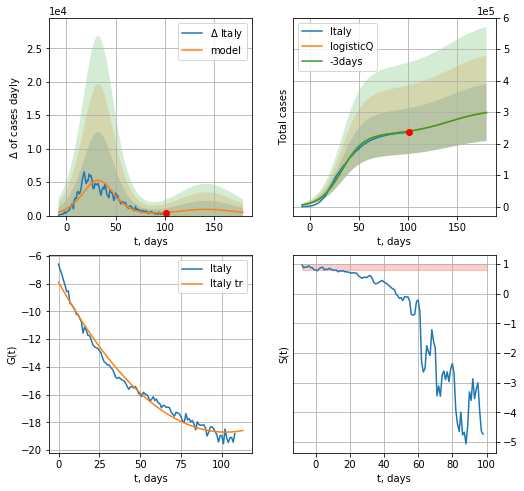

Italy data at: 2020-06-11
+3 day model MAPE: 0.002776
model: logisticQ
coeffs: [ 2.29833619e+05  3.45440049e-07  3.26141866e+01 -2.64679506e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.302415
forecast at the end of period: +79 days
	 deltaDaycases: 483
	 total cases: 299090 ± 90449
	 total death: 43274 ± 39260
trend coefficient of determination: 0.982867
 intercept_: -7.893982658992961
 coeffs_: [ 0.         -0.21147214  0.00103394]


In [99]:
x = forecastRRR('Italy',dfIT[:],d1,7*22-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


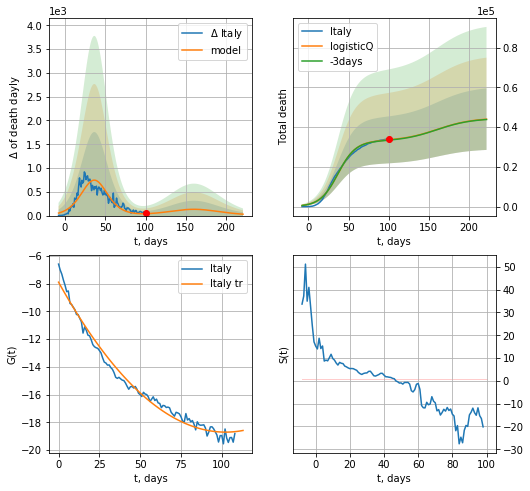

Italy data at: 2020-06-11
+3 day model MAPE: 0.004626
model: logisticQ
coeffs: [ 3.30135309e+04  3.29761385e-07  3.68311502e+01 -2.73295811e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.351695
forecast at the end of period: +121 days
	 total death: 44027 ± 15484
trend coefficient of determination: 0.982867
 intercept_: -7.893982658992961
 coeffs_: [ 0.         -0.21147214  0.00103394]


In [100]:
x = forecastRRR('Italy',dfIT[:],d1,7*28-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

In [101]:
dT

75

FR
           date     cases  active    death
113 2020-06-07  153977.0   53980  29155.0
114 2020-06-08  154188.0   53917  29209.0
115 2020-06-09  154591.0   53789  29296.0
116 2020-06-10  155136.0   53985  29319.0
117 2020-06-11  155561.0   54066  29346.0


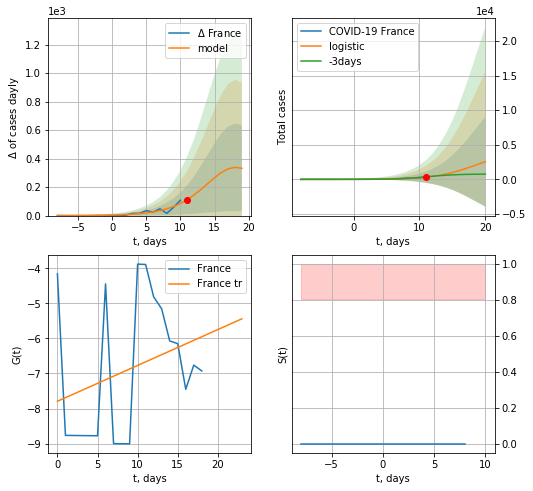

France data at: 2020-06-11
+3 day model MAPE: 0.04053337370546569
model: logistic
coeffs:  [4.17383165e+03 3.25568771e-01 1.85949028e+01]
rational stdev:  2.5390562100826064
forecast at the end of period: +9 days
	 deltaDaycases:  331
	 total cases:  2556 ± 6490
	 total death:  482 ± 3671
trend coefficient of determination: 0.083417
 intercept: -7.793073
 slope: 0.102246


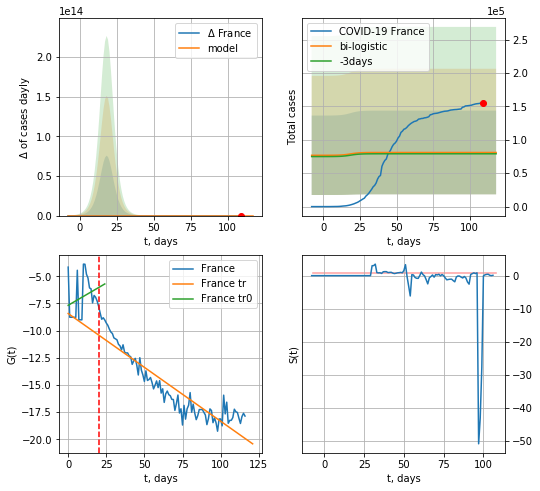

France data at: 2020-06-11
+3 day model MAPE: 0.024466728988086814
model: bi-logistic
coeffs:  [ 7.67954366e+04 -4.86304728e+00  1.28995871e+02] [4.17383165e+03 3.25568771e-01 1.85949028e+01]
rational stdev:  0.7735339813622916
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  80969 ± 62632
	 total death:  15274 ± 35444
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.062178
 intercept: -7.670498
 slope: 0.081817
trend coefficient of determination: 0.849134
 intercept: -8.426127
 slope: -0.099044


In [102]:
# prideta 1990 2020-04-17
# prideta 3824 2020-04-18
dfFR = read_df(pd.DataFrame(),"FR")
vL=20
x = forecast('France',dfFR[:vL],d1,12*7-dT,1.0)
xx = forecast2('France',dfFR,d1,12*7-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.5],vL=vL)

In [103]:
#vL=len(dfFR)-9-5-dT
#x = forecast('France',dfFR[10:-9-dT],d1,7*5-dT-4,1.0)
#xx = forecast2('France',dfFR[10:],d1,7*7-dT-4,x,1.0,addpred=True,xcoef=[.25,1.,1.4],vL=vL)

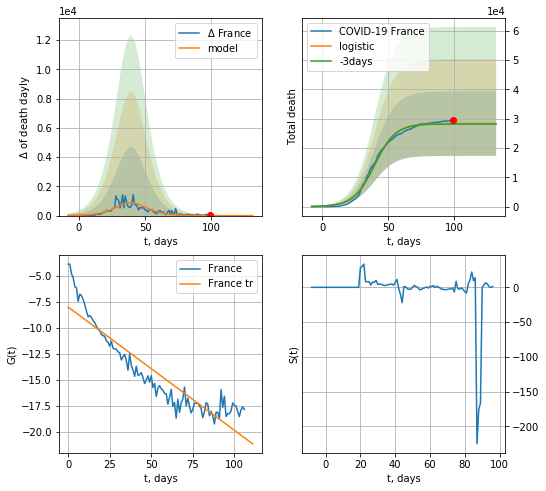

France data at: 2020-06-11
+3 day model MAPE: 0.004265699436137813
model: logistic
coeffs:  [2.82803470e+04 1.25636217e-01 3.97459046e+01]
rational stdev:  0.3884401698421283
forecast at the end of period: +33 days
	 total death:  28280 ± 10985
trend coefficient of determination: 0.850803
 intercept: -8.013890
 slope: -0.118415


In [104]:
#dfFR = read_df(pd.DataFrame(),"FR")
x = forecast('France',dfFR[10:],d1,7*16-dT-4,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


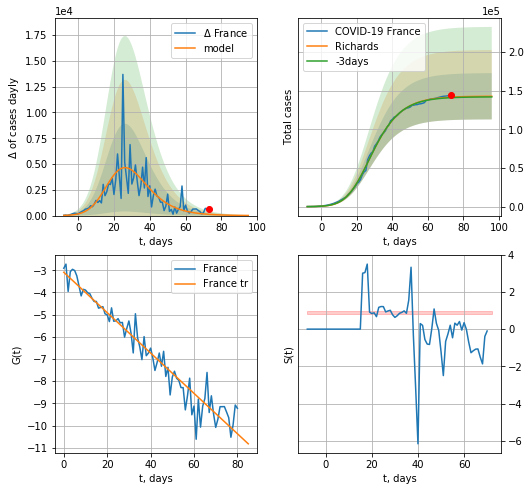

France data at: 2020-06-11
+3 day model MAPE: 0.005147
model: Richards
coeffs: [1.42848528e+05 3.23749564e-01 1.53796567e+01 3.15810253e-01]
rational stdev: 0.209496
forecast at the end of period: +23 days
	 deltaDaycases: 12
	 total cases: 142729 ± 29901
	 total death: 26925 ± 16922
trend coefficient of determination: 0.939070
 intercept: -3.090514
 slope: -0.090951


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


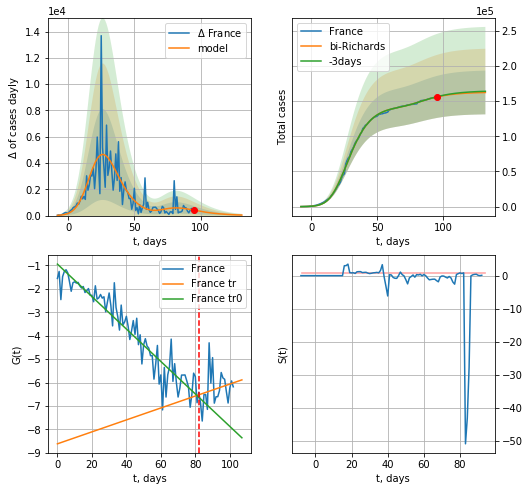

France data at: 2020-06-11
+3 day model MAPE: 0.002568
model: bi-Richards
coeffs: [1.98086879e+04 3.23649844e+00 3.33558716e+01 2.31797727e-02]
rational stdev: 0.191512
forecast at the end of period: +37 days
	 deltaDaycases: 39
	 total cases: 162139 ± 31051
	 total death: 30586 ± 17572
bi-Richards approximation splitting point: 82
trend coefficient of determination: 0.897017
 intercept: -0.943106
 slope: -0.069267
trend coefficient of determination: 0.046218
 intercept: -8.612313
 slope: 0.025502


In [105]:
vL = 82+14
x = forecastRR('France',dfFR[14:vL],d1,14*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('France',dfFR[14:],d1,16*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-14)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


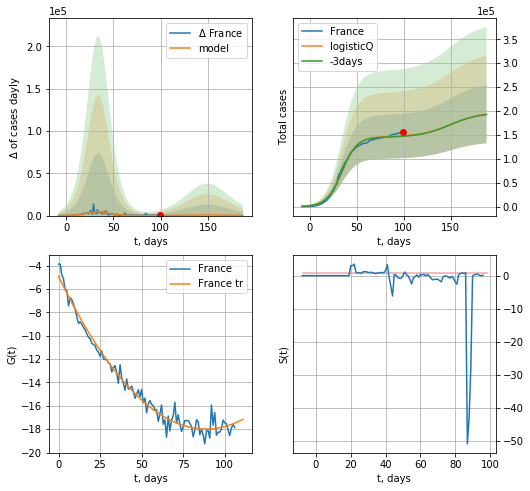

France data at: 2020-06-11
+3 day model MAPE: 0.006196
model: logisticQ
coeffs: [ 1.46001397e+05  4.45938683e-07  3.43492131e+01 -2.77283455e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.314846
forecast at the end of period: +89 days
	 deltaDaycases: 255
	 total cases: 193338 ± 60871
	 total death: 36472 ± 34449
trend coefficient of determination: 0.978642
 intercept_: -4.9322569271689005
 coeffs_: [ 0.         -0.29451436  0.00166134]


In [106]:
x = forecastRRR('France',dfFR[10:],d1,24*7-dT-4,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


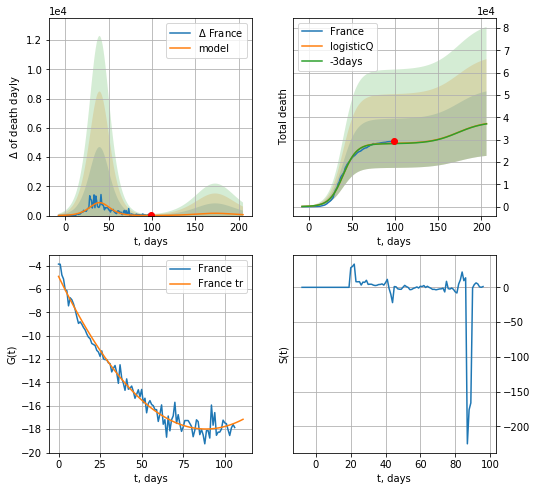

France data at: 2020-06-11
+3 day model MAPE: 0.004326
model: logisticQ
coeffs: [ 2.82801224e+04  5.04792935e-07  3.97461106e+01 -2.48761075e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.388519
forecast at the end of period: +107 days
	 total death: 37173 ± 14442
trend coefficient of determination: 0.978642
 intercept_: -4.9322569271689005
 coeffs_: [ 0.         -0.29451436  0.00166134]


In [107]:
x = forecastRRR('France',dfFR[10:],d1,26*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1.])

In [108]:
#x = forecastR('France',dfFR[:],d1,8*7-dT-4,1.0,addpred=True,xcoef=[0.25,1.,20.,1])

In [109]:
#trend3(dfGR,dfUS,dfGB[:],'GR','US','GB',40,40,40)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:183: RuntimeWarning: invalid value encountered in reduce
  arrmean = umr_sum(arr, axis, dtype, keepdims=True)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: invalid value encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

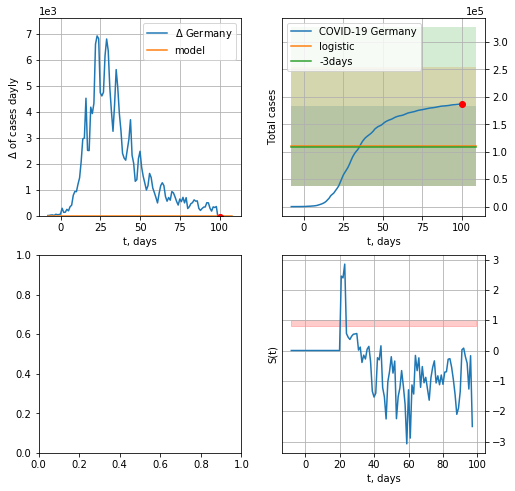

In [110]:
x = forecast('Germany',dfGR[:],d1,7*12-dT,1.0)
#xx = forecast2('Germany',dfGR,d1,7*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


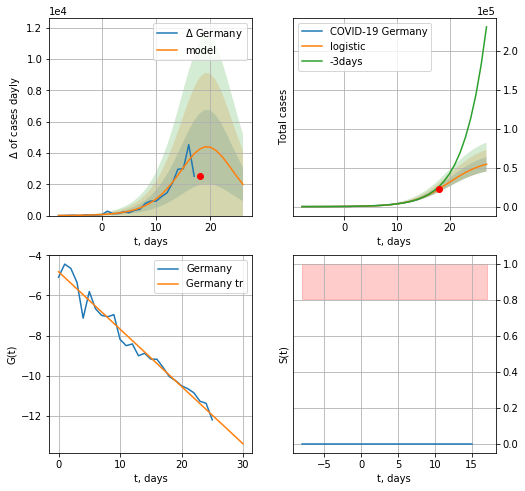

Germany data at: 2020-06-11
+3 day model MAPE: 0.18319320379671997
model: logistic
coeffs:  [6.16394025e+04 2.86275294e-01 1.98444846e+01]
rational stdev:  0.17054836328949527
forecast at the end of period: +9 days
	 deltaDaycases:  1991
	 total cases:  54599 ± 9311
	 total death:  2587 ± 1323
trend coefficient of determination: 0.966826
 intercept: -4.817840
 slope: -0.285777


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: invalid value encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

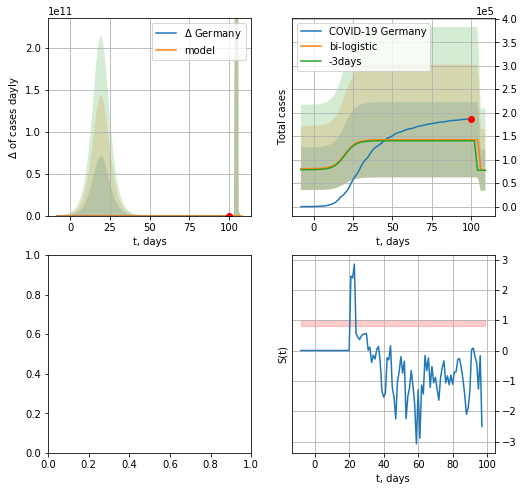

In [111]:
vL = 27
x = forecast('Germany',dfGR[:vL],d1,12*7-dT,1.0)#,addpred=True,xcoef=[0.25,1.,2.0,1])
xx = forecast2('Germany',dfGR,d1,7*12-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.6],vL=vL)

GR
           date   cases  active   death
104 2020-06-07  185869    7493  8776.0
105 2020-06-08  186205    7822  8783.0
106 2020-06-09  186516    6985  8831.0
107 2020-06-10  186866    7322  8844.0
108 2020-06-11  186795    6344  8851.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: invalid value encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

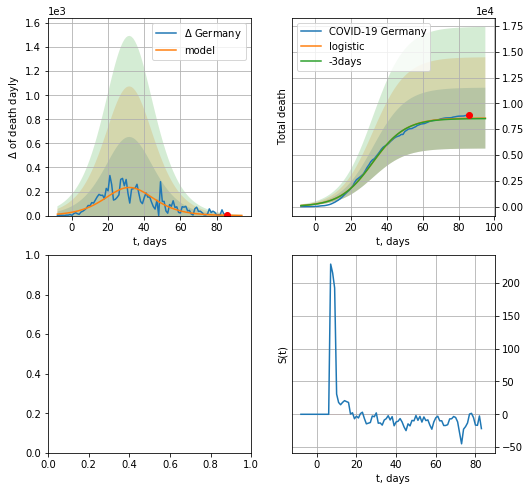

In [112]:
dfGR = read_df(pd.DataFrame(),"GR")
x = forecast('Germany',dfGR[14:],d1,12*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:647: RuntimeWarning: invalid value encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

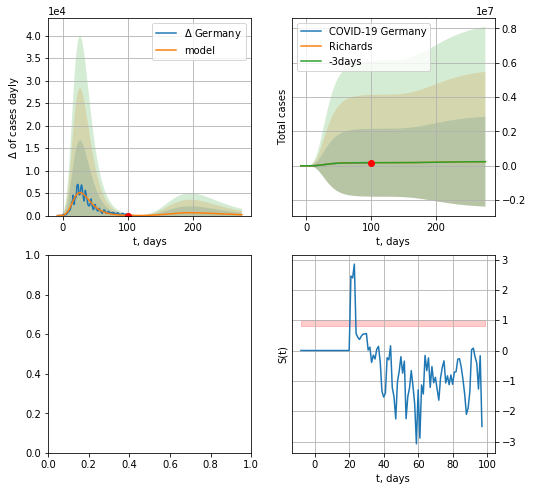

In [117]:
x = forecastRR('Germany',dfGR[:],d1,36*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


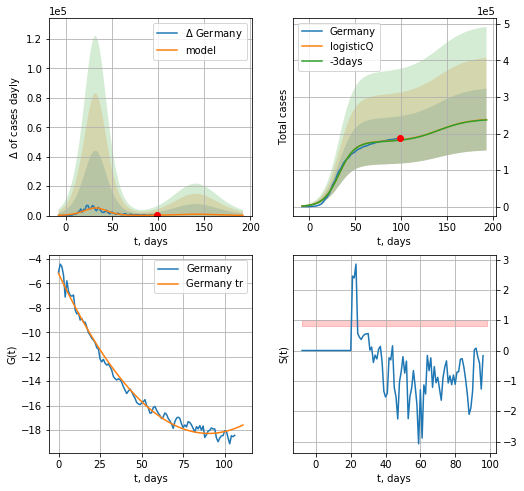

Germany data at: 2020-06-10
+3 day model MAPE: 0.004591
model: logisticQ
coeffs: [ 1.77968683e+05  3.46323244e-07  3.23808056e+01 -3.39620045e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.355029
forecast at the end of period: +94 days
	 deltaDaycases: 162
	 total cases: 238201 ± 84568
	 total death: 11273 ± 12006
trend coefficient of determination: 0.987871
 intercept_: -5.20036432010385
 coeffs_: [ 0.         -0.28945236  0.00160353]


In [115]:
x = forecastRRR('Germany',dfGR[:],d1,24*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.0,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


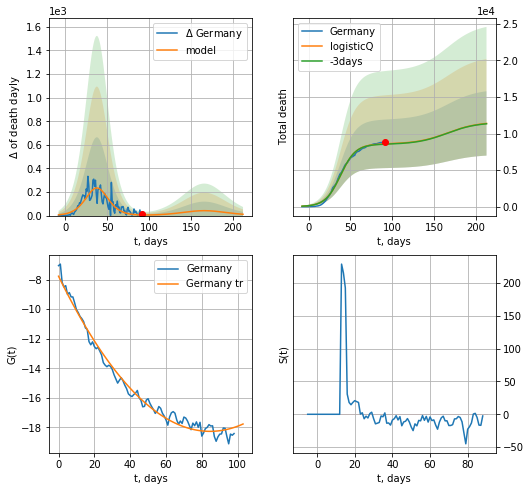

Germany data at: 2020-06-10
+3 day model MAPE: 0.005308
model: logisticQ
coeffs: [ 8.56565433e+03  6.12302069e-07  3.81382632e+01 -1.78689580e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.386770
forecast at the end of period: +122 days
	 total death: 11384 ± 4403
trend coefficient of determination: 0.985531
 intercept_: -7.776610309439295
 coeffs_: [ 0.         -0.24805725  0.00146614]


In [116]:
x = forecastRRR('Germany',dfGR[8:],d1,28*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.0,1])

US
           date    cases   active     death
98  2020-06-07  2007449  1133272  112469.0
99  2020-06-08  2026493  1139958  113055.0
100 2020-06-09  2045715  1142683  114151.0
101 2020-06-10  2066401  1142777  115130.0
102 2020-06-11  2089825  1157616  116035.0


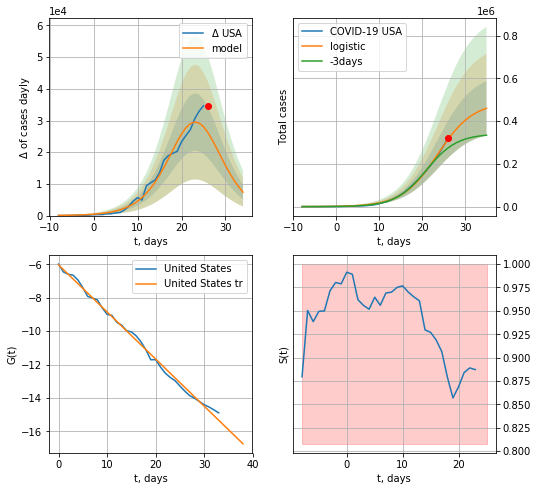

USA data at: 2020-06-11
+3 day model MAPE: 0.17962965715206392
model: logistic
coeffs:  [4.89025783e+05 2.41973857e-01 2.36121759e+01]
rational stdev:  0.2760702577358041
forecast at the end of period: +9 days
	 deltaDaycases:  7402
	 total cases:  459794 ± 126935
	 total death:  25529 ± 21143
trend coefficient of determination: 0.995387
 intercept: -6.036925
 slope: -0.281840


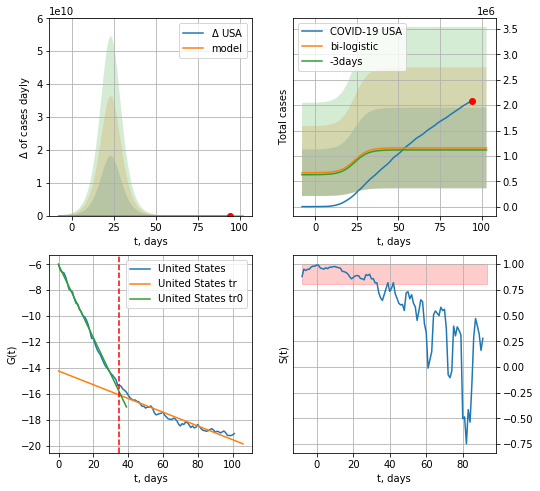

USA data at: 2020-06-11
+3 day model MAPE: 0.03503568969605118
model: bi-logistic
coeffs:  [ 5.34159126e+05 -7.27750693e+00  1.85532895e+02] [4.89025783e+05 2.41973857e-01 2.36121759e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
rational stdev:  0.6876983960504823
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  1156724 ± 795477
	 total death:  64225 ± 132502
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.995488
 intercept: -6.051468
 slope: -0.280518
trend coefficient of determination: 0.931623
 intercept: -14.222724
 slope: -0.052909


In [118]:
vL=35
dfUS = read_df(pd.DataFrame(),"US")
x = forecast('USA',dfUS[:vL],d1,12*7-dT,1.0,addpred=False,xcoef=[0.25,1.,2.])
xx = forecast2('USA',dfUS[:],d1,12*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.5],vL=vL)

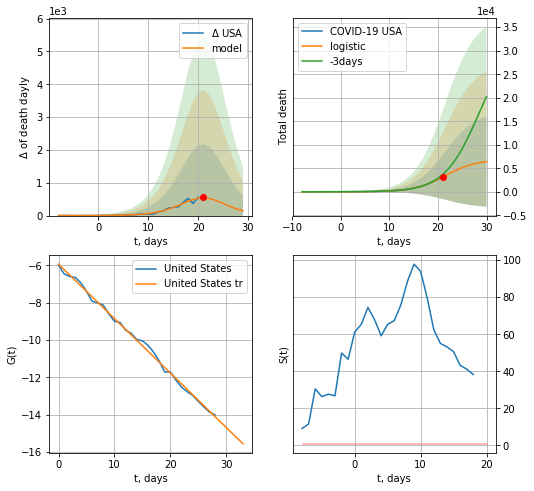

USA data at: 2020-06-11
+3 day model MAPE: 0.214213224760407
model: logistic
coeffs:  [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  1.4929056707100332
forecast at the end of period: +9 days
	 total death:  6400 ± 9554
trend coefficient of determination: 0.996549
 intercept: -5.938291
 slope: -0.291586


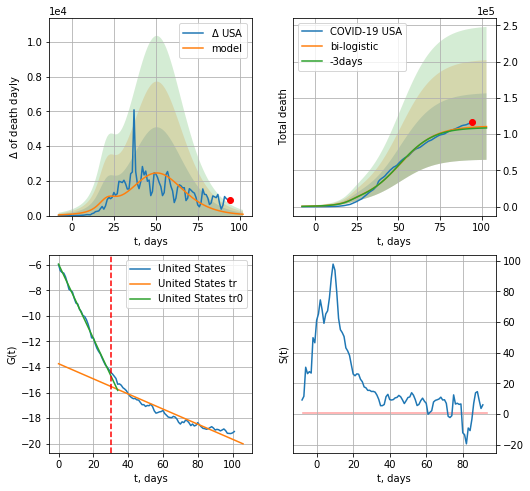

USA data at: 2020-06-11
+3 day model MAPE: 0.015861573193029777
model: bi-logistic
coeffs:  [1.04243755e+05 9.42098316e-02 5.10720917e+01] [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  0.4153279234519681
forecast at the end of period: +9 days
	 deltaDaydeath:  76
	 total death:  110301 ± 45811
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.996707
 intercept: -5.949158
 slope: -0.290421
trend coefficient of determination: 0.913452
 intercept: -13.739724
 slope: -0.059079


In [119]:
vL=30
x = forecast('USA',dfUS[:vL],d1,7*12-dT,1.0,cases='death')
xx = forecast2('USA',dfUS,d1,7*12-dT,x,1.0,cases='death',vL=vL)
#x = forecast('USA',dfUS[:],d1,28*3-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


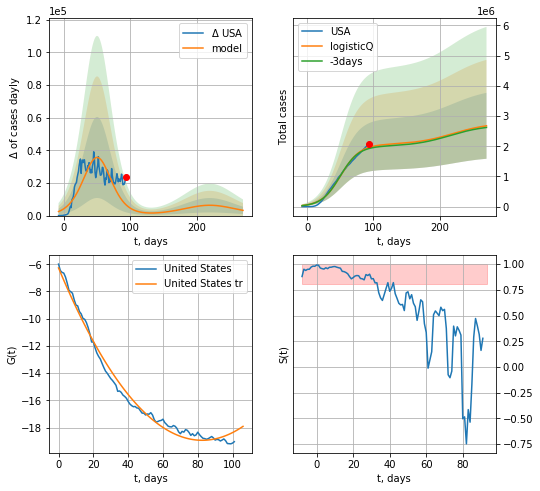

USA data at: 2020-06-11
+3 day model MAPE: 0.020588
model: logisticQ
coeffs: [ 2.05521225e+06  3.03368677e-07  5.05461900e+01 -2.28000148e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.407943
forecast at the end of period: +177 days
	 deltaDaycases: 3202
	 total cases: 2676633 ± 1091913
	 total death: 148616 ± 181880
trend coefficient of determination: 0.988569
 intercept_: -6.272817589643438
 coeffs_: [ 0.         -0.30689232  0.00185896]


In [120]:
x = forecastRRR('USA',dfUS[:],d1,7*36-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


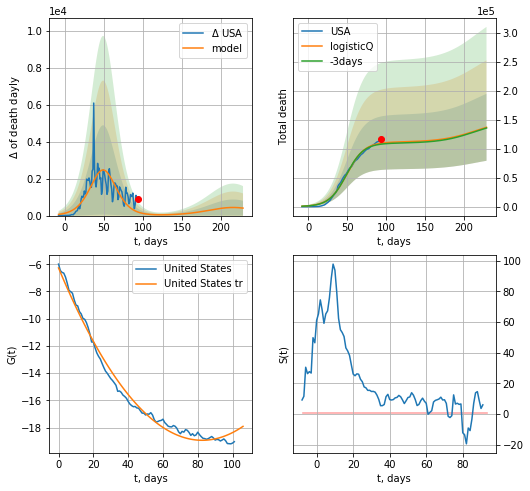

USA data at: 2020-06-11
+3 day model MAPE: 0.015179
model: logisticQ
coeffs: [ 1.11522448e+05  4.72249150e-07  4.94775413e+01 -1.87326109e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.421919
forecast at the end of period: +135 days
	 total death: 136971 ± 57790
trend coefficient of determination: 0.988569
 intercept_: -6.272817589643438
 coeffs_: [ 0.         -0.30689232  0.00185896]


In [121]:
x = forecastRRR('USA',dfUS[:],d1,7*30-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


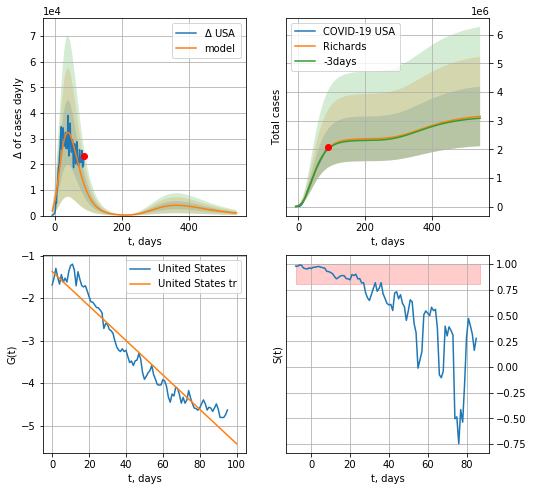

USA data at: 2020-06-11
+3 day model MAPE: 0.011613
model: Richards
coeffs: [ 2.37027554e+06  3.84095940e+00 -8.47759343e+01  9.72953648e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.330364
forecast at the end of period: +457 days
	 deltaDaycases: 994
	 total cases: 3147829 ± 1039927
	 total death: 174779 ± 173221
trend coefficient of determination: 0.940670
 intercept: -1.375695
 slope: -0.040523


In [122]:
x = forecastRR('USA',dfUS[6:],d1,7*76-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


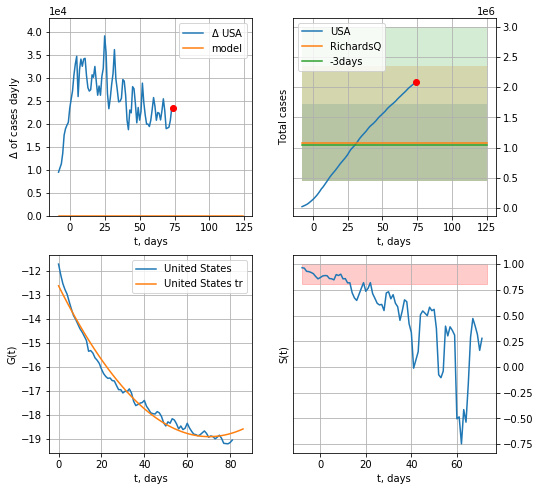

USA data at: 2020-06-11
+3 day model MAPE: 0.035521
model: RichardsQ
coeffs: [ 1.07969287e+06  6.01460982e-01 -2.08801376e+01 -3.70207547e+01
  1.18526704e-01]
rational stdev: 0.592063
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 1079692 ± 639246
	 total death: 59948 ± 106479
trend coefficient of determination: 0.981086
 intercept_: -12.614429499167594
 coeffs_: [ 0.         -0.17912645  0.0012763 ]


In [123]:
x = forecastQR('USA',dfUS[20:],d1,7*18-dT,1.0,addpred=False,xcoef=[0.35,.5,3.,1.,1.])

GB
           date   cases  active    death
102 2020-06-07  286194       0  40542.0
103 2020-06-08  287399       0  40597.0
104 2020-06-09  289140       0  40883.0
105 2020-06-10  290143       0  41128.0
106 2020-06-11  291409       0  41279.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


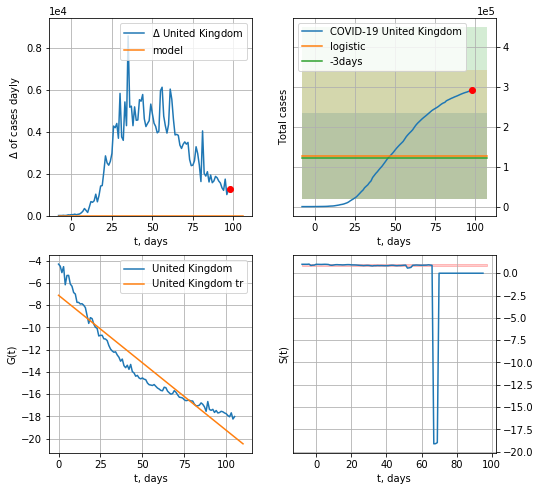

United Kingdom data at: 2020-06-11
+3 day model MAPE: 0.039052075320731586
model: logistic
coeffs:  [ 1.26027056e+05 -7.69182610e+00  2.02551195e+02]
rational stdev:  0.8577960386445663
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  126027 ± 108105
	 total death:  17852 ± 45940
trend coefficient of determination: 0.906271
 intercept: -7.120334
 slope: -0.121389


In [124]:
dfGB = read_df(pd.DataFrame(),"GB")
x = forecast('United Kingdom',dfGB[:],d1,7*12-dT,1.)
#x = forecast('United Kingdom',dfGB[:-8-dT],d1,4*7-dT,1.)
#xx = forecast2('United Kingdom',dfGB[:],d1,4*7-dT,x,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


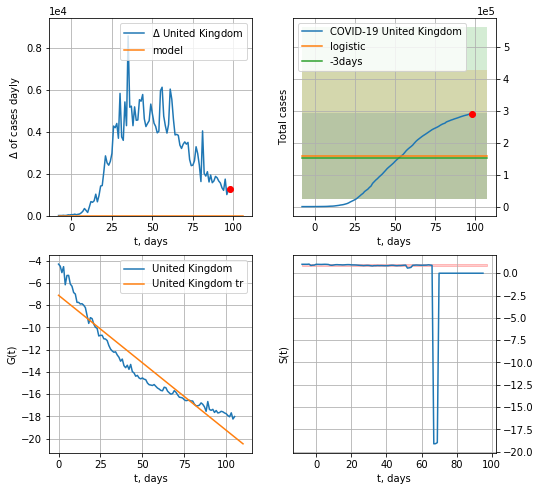

United Kingdom data at: 2020-06-11
+3 day model MAPE: 0.039052075320731704
model: logistic
coeffs:  [ 1.26027056e+05 -7.69182610e+00  2.02551195e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.8577960386445663
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  157533 ± 135131
	 total death:  22315 ± 57425
trend coefficient of determination: 0.906271
 intercept: -7.120334
 slope: -0.121389


In [125]:
x = forecast('United Kingdom',dfGB[:],d1,12*7-dT,1.,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: divide by zero encountered in true_divide


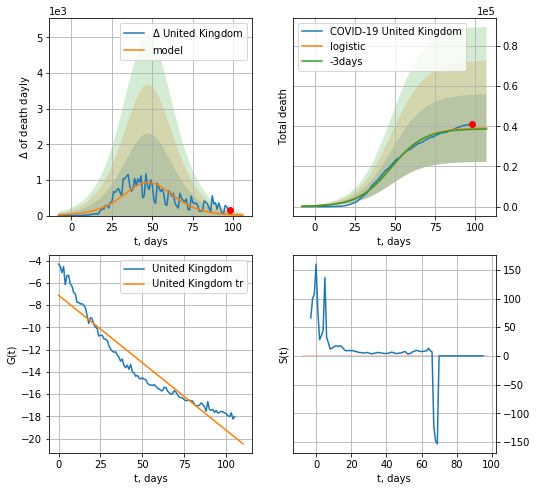

United Kingdom data at: 2020-06-11
+3 day model MAPE: 0.011897432181046635
model: logistic
coeffs:  [3.92321065e+04 9.50786416e-02 4.78330281e+01]
rational stdev:  0.4300334302746969
forecast at the end of period: +9 days
	 total death:  39091 ± 16810
trend coefficient of determination: 0.906271
 intercept: -7.120334
 slope: -0.121389


In [126]:
x = forecast('United Kingdom',dfGB[:],d1,12*7-dT,1.,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


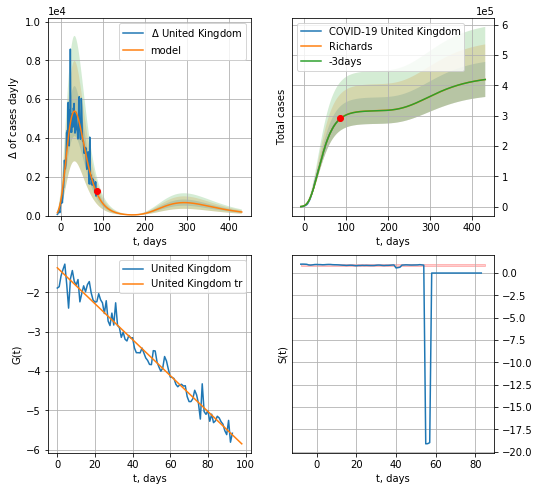

United Kingdom data at: 2020-06-11
+3 day model MAPE: 0.000755
model: Richards
coeffs: [ 3.17164609e+05  4.11973175e+00 -6.33225883e+01  1.12614899e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.137698
forecast at the end of period: +345 days
	 deltaDaycases: 185
	 total cases: 419826 ± 57809
	 total death: 59469 ± 24566
trend coefficient of determination: 0.972242
 intercept: -1.375626
 slope: -0.045650


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


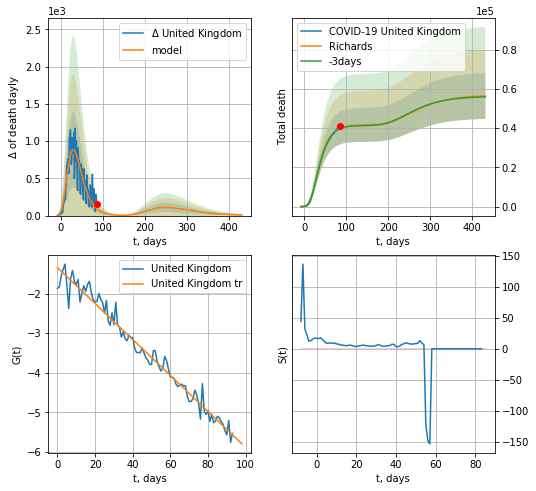

United Kingdom data at: 2020-06-11
+3 day model MAPE: 0.007017
model: Richards
coeffs: [ 4.17247907e+04  7.69043485e+00 -5.46282682e+01  7.50554212e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.207728
forecast at the end of period: +345 days
	 total death: 56429 ± 11722
trend coefficient of determination: 0.971829
 intercept: -1.343974
 slope: -0.045434


In [127]:
x = forecastRR('United Kingdom',dfGB[12:],d1,60*7-dT,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRR('United Kingdom',dfGB[12:],d1,60*7-dT,1.,addpred=True,xcoef=RkoreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


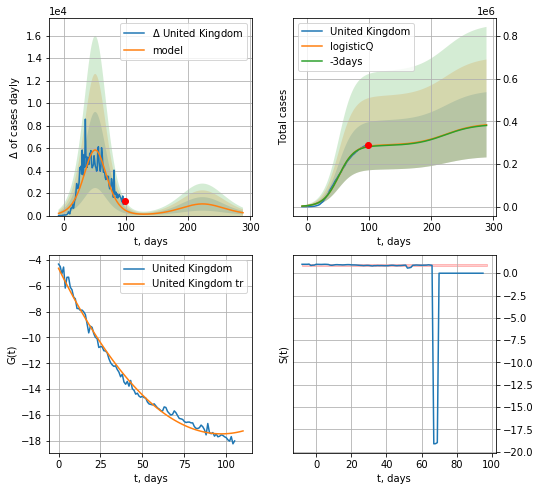

United Kingdom data at: 2020-06-11
+3 day model MAPE: 0.008206
model: logisticQ
coeffs: [ 2.88410055e+05  4.75482773e-07  5.12663706e+01 -1.70121222e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.398714
forecast at the end of period: +191 days
	 deltaDaycases: 256
	 total cases: 383928 ± 153077
	 total death: 54384 ± 65051
trend coefficient of determination: 0.991683
 intercept_: -4.6426005543314055
 coeffs_: [ 0.         -0.26434093  0.00136147]


In [128]:
x = forecastRRR('United Kingdom',dfGB[:],d1,38*7-dT,1.,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


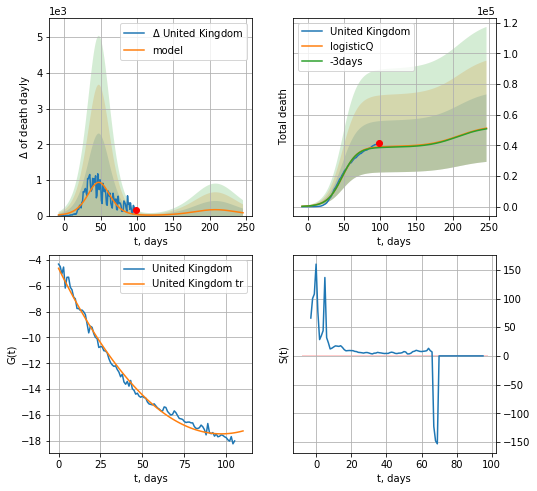

United Kingdom data at: 2020-06-11
+3 day model MAPE: 0.011979
model: logisticQ
coeffs: [ 3.92311880e+04  3.86337294e-07  4.78333330e+01 -2.45994087e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.430061
forecast at the end of period: +149 days
	 total death: 51224 ± 22029
trend coefficient of determination: 0.991683
 intercept_: -4.6426005543314055
 coeffs_: [ 0.         -0.26434093  0.00136147]


In [129]:
x = forecastRRR('United Kingdom',dfGB[:],d1,32*7-dT,1.,addpred=True,xcoef=koreaCoeffs,cases='death')

In [129]:
#x = forecastQR('United Kingdom',dfGB[:],d1,18*7-dT,1.,addpred=True,xcoef=[0.35,.5,3,1,1])

In [130]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,2.4,1])

In [131]:
#trend3(dfDK,dfNG,dfSW[:],'DK','NG','SW',40,40,40)

In [132]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,4.,1])

In [133]:
#x = forecast('Denmark',dfDK[:15],d1,2*7-dT,1.0)
#xx = forecast2('Denmark',dfDK[:],d1,4*7-dT, x,1.0)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3('Denmark',dfDK[:],d1,14-dT, xx)

In [130]:
dT

75

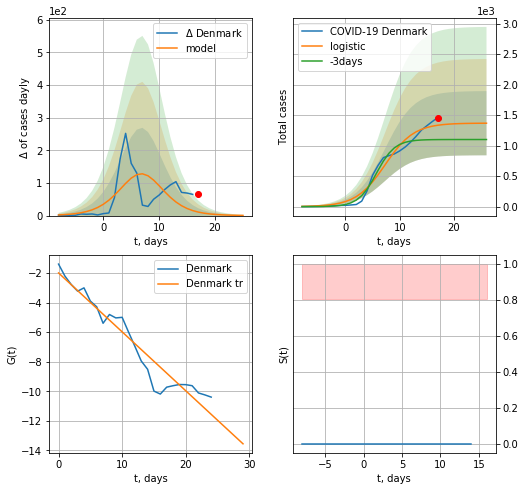

Denmark data at: 2020-06-11
+3 day model MAPE: 0.22309164372685597
model: logistic
coeffs:  [1.36966073e+03 3.75718860e-01 7.30059729e+00]
rational stdev:  0.38476605910227335
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  1368 ± 526
	 total death:  67 ± 77
trend coefficient of determination: 0.928037
 intercept: -1.984791
 slope: -0.399221


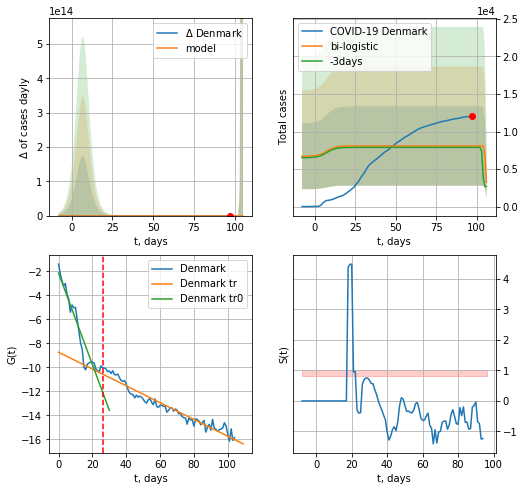

Denmark data at: 2020-06-11
+3 day model MAPE: 0.024403050341209074
model: bi-logistic
coeffs:  [ 5.36421678e+03 -3.65727206e+00  1.05388696e+02] [1.36966073e+03 3.75718860e-01 7.30059729e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.6543948226209328
forecast at the end of period: +9 days
	 deltaDaycases:  -3803
	 total cases:  3228 ± 2112
	 total death:  159 ± 312
bi-logistic approximation splitting point: 26
trend0 coefficient of determination: 0.914728
 intercept: -2.128126
 slope: -0.381304
trend coefficient of determination: 0.943395
 intercept: -8.732542
 slope: -0.070022


In [131]:
vL = 26
x = forecast('Denmark',dfDK[:vL],d1,7*12-dT,1.0)
xx = forecast2('Denmark',dfDK[:],d1,12*7-dT, x,1.0,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


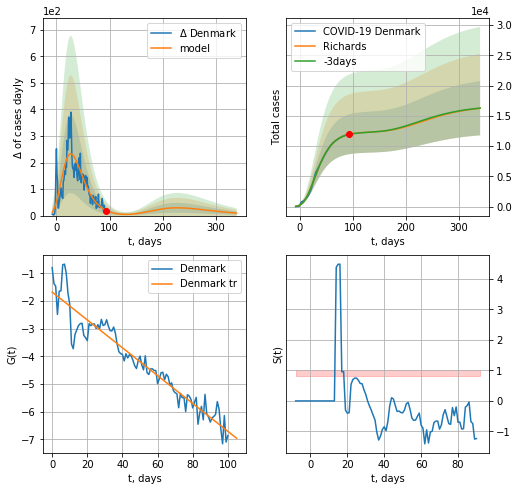

Denmark data at: 2020-06-11
+3 day model MAPE: 0.001831
model: Richards
coeffs: [ 1.23495696e+04  1.18555608e+00 -3.21284143e+01  4.41609956e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.275514
forecast at the end of period: +247 days
	 deltaDaycases: 9
	 total cases: 16261 ± 4480
	 total death: 801 ± 662
trend coefficient of determination: 0.916878
 intercept: -1.678795
 slope: -0.050343


In [132]:
x = forecastRR('Denmark',dfDK[4:],d1,46*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
#x2 = forecast2R('Denmark',dfDK[:],d1,16*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


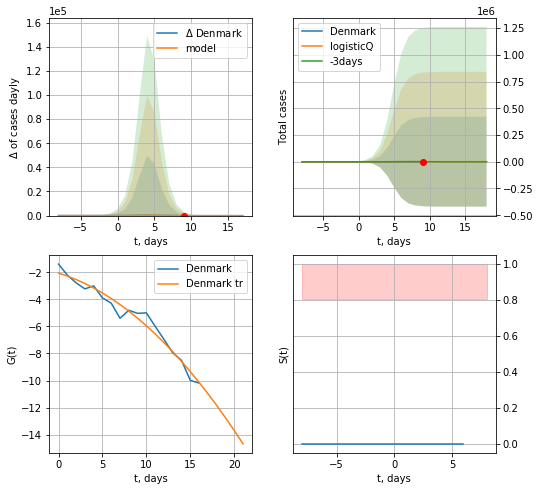

Denmark data at: 2020-06-11
+3 day model MAPE: 2.879608
model: logisticQ
coeffs: [ 8.62480490e+02  2.49401516e-04  4.73670538e+00 -4.50088701e+03]
rational stdev: 487.269302
forecast at the end of period: +9 days
	 deltaDaycases: 0
	 total cases: 862 ± 420260
	 total death: 42 ± 61395
trend coefficient of determination: 0.965266
 intercept_: -2.0557034713075613
 coeffs_: [ 0.         -0.1970759  -0.01925246]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


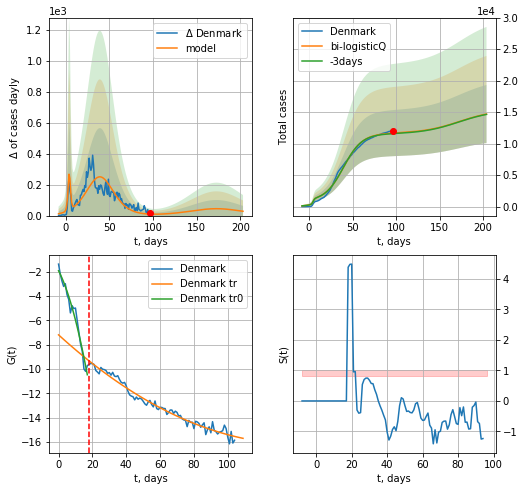

Denmark data at: 2020-06-11
+3 day model MAPE: 0.006458
model: bi-logisticQ
coeffs: [ 1.07486978e+04  2.97196366e-07  3.96999801e+01 -3.13048093e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.313706
forecast at the end of period: +107 days
	 deltaDaycases: 27
	 total cases: 14694 ± 4609
	 total death: 724 ± 681
bi-logisticQ approximation splitting point: 18
trend coefficient of determination: 0.963211
 intercept_: -1.9308894789691964
 coeffs_: [ 0.         -0.26605777 -0.01390014]
trend coefficient of determination: 0.974155
 intercept_: -7.193347856213363
 coeffs_: [ 0.         -0.12646505  0.00044521]


In [133]:
x = forecastRRR('Denmark',dfDK[:18],d1,12*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[0.35,0.5,4.5,1.])
x = forecast2RRR('Denmark',dfDK[:],d1,26*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=18)

NG
           date  cases  active  death
102 2020-06-07   8547     171  238.0
103 2020-06-08   8561     184  239.0
104 2020-06-09   8576     199  239.0
105 2020-06-10   8594     217  239.0
106 2020-06-11   8608     228  242.0


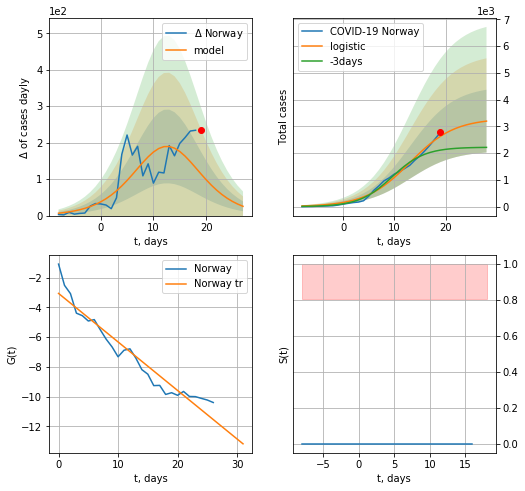

Norway data at: 2020-06-11
+3 day model MAPE: 0.2814819001616187
model: logistic
coeffs:  [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.3674391911615601
forecast at the end of period: +9 days
	 deltaDaycases:  25
	 total cases:  3195 ± 1174
	 total death:  89 ± 98
trend coefficient of determination: 0.927855
 intercept: -3.067798
 slope: -0.326083


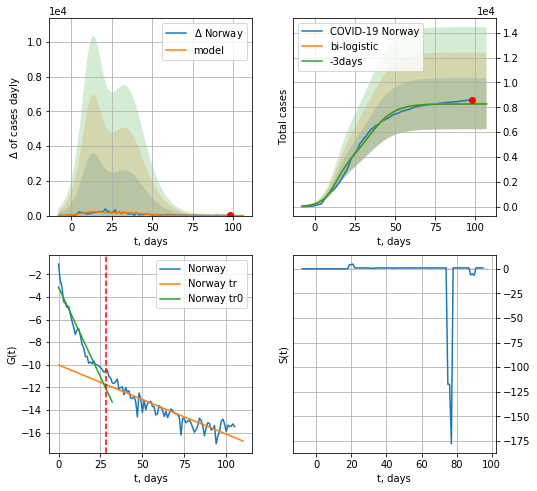

Norway data at: 2020-06-11
+3 day model MAPE: 0.0036742072143463823
model: bi-logistic
coeffs:  [4.99673672e+03 1.27804467e-01 3.43551250e+01] [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.2484136475756933
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  8294 ± 2060
	 total death:  233 ± 173
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.827508
 intercept: -10.013389
 slope: -0.061149


In [134]:
dfNG = read_df(pd.DataFrame(),"NG")
vL=28
x = forecast('Norway',dfNG[:vL],d1,7*12-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,12*7-dT,x,1.0,vL=vL)
#xx = np.concatenate((x, xx), axis=0)

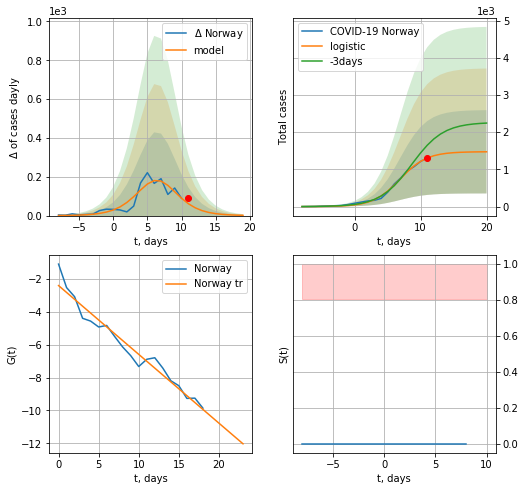

Norway data at: 2020-06-11
+3 day model MAPE: 0.247655347933597
model: logistic
coeffs:  [1.47478891e+03 4.95866797e-01 6.87524749e+00]
rational stdev:  0.7596156049961639
forecast at the end of period: +9 days
	 deltaDaycases:  1
	 total cases:  1472 ± 1118
	 total death:  41 ± 93
trend coefficient of determination: 0.956890
 intercept: -2.403448
 slope: -0.418410


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


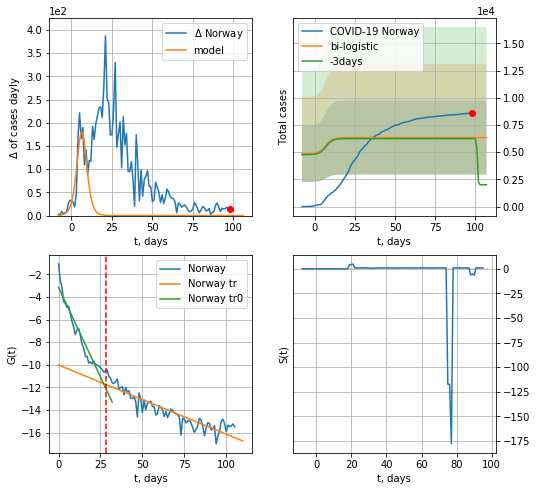

Norway data at: 2020-06-11
+3 day model MAPE: 0.014586763180849175
model: bi-logistic
coeffs:  [ 4.32013335e+03 -3.68844806e+00  1.13464770e+02] [1.47478891e+03 4.95866797e-01 6.87524749e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.5352078915641653
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  6334 ± 3390
	 total death:  178 ± 285
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.827508
 intercept: -10.013389
 slope: -0.061149


In [135]:
vL = 28#len(dfNG)-13-dT
x = forecast('Norway',dfNG[:-12-dT],d1,7*12-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,12*7-dT,x,1.0,addpred=True,xcoef=[0.25/2,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


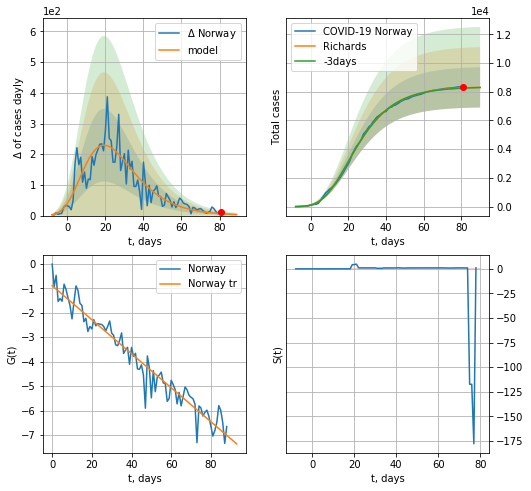

Norway data at: 2020-06-11
+3 day model MAPE: 0.001938
model: Richards
coeffs: [ 8.35144256e+03  6.60312441e+00 -3.98482814e+01  1.13741644e-02]
rational stdev: 0.168871
forecast at the end of period: +9 days
	 deltaDaycases: 3
	 total cases: 8308 ± 1403
	 total death: 233 ± 118
trend coefficient of determination: 0.941185
 intercept: -0.895025
 slope: -0.069489


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


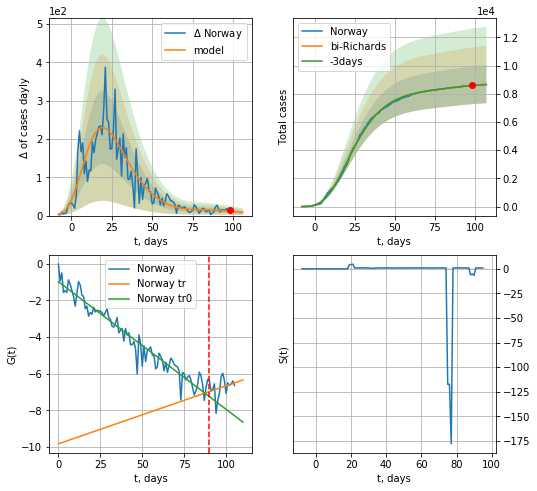

Norway data at: 2020-06-11
+3 day model MAPE: 0.002593
model: bi-Richards
coeffs: [4.95101845e+02 2.33929863e+00 2.63848834e+01 2.48567566e-02]
rational stdev: 0.155681
forecast at the end of period: +9 days
	 deltaDaycases: 8
	 total cases: 8681 ± 1351
	 total death: 244 ± 113
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.940030
 intercept: -0.986635
 slope: -0.069590
trend coefficient of determination: 0.079642
 intercept: -9.826263
 slope: 0.031651


In [136]:
vL = 90
x = forecastRR('Norway',dfNG[:vL],d1,12*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Norway',dfNG[:],d1,12*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Norway',dfNG[:],d1,8*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


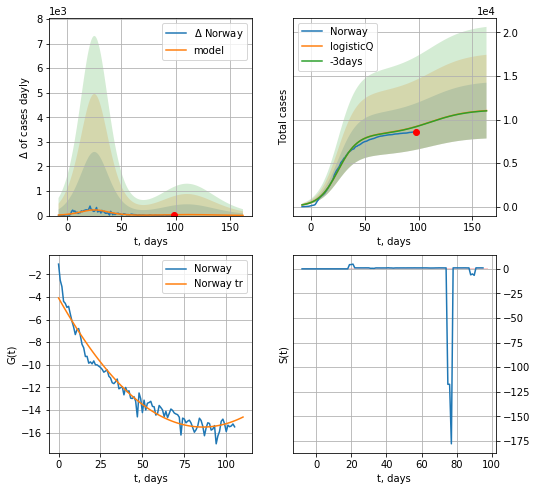

Norway data at: 2020-06-11
+3 day model MAPE: 0.002133
model: logisticQ
coeffs: [ 8.25594803e+03  3.81667500e-07  2.54384976e+01 -2.91570269e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.290483
forecast at the end of period: +65 days
	 deltaDaycases: 8
	 total cases: 11030 ± 3204
	 total death: 310 ± 270
trend coefficient of determination: 0.960080
 intercept_: -4.088927575772269
 coeffs_: [ 0.         -0.26520296  0.00154091]


In [137]:
x = forecastRRR('Norway',dfNG[:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


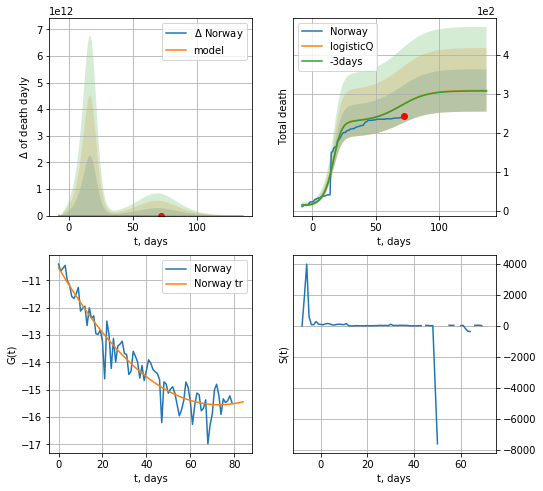

Norway data at: 2020-06-11
+3 day model MAPE: 0.002665
model: logisticQ
coeffs: [ 2.28026474e+02  5.85157610e-03  1.57654761e+01 -2.72238618e+01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.175836
forecast at the end of period: +65 days
	 total death: 308 ± 54
trend coefficient of determination: 0.916736
 intercept_: -10.529254034738456
 coeffs_: [ 0.         -0.13750748  0.00094093]


In [138]:
x = forecastRRR('Norway',dfNG[26:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

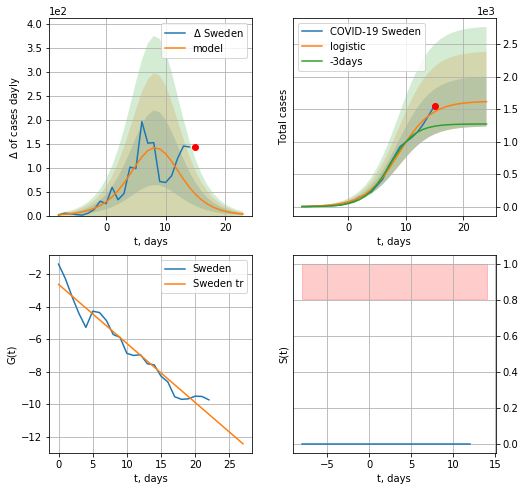

Sweden data at: 2020-06-11
+3 day model MAPE: 0.2037446768613992
model: logistic
coeffs:  [1.62331286e+03 3.49719159e-01 8.72648648e+00]
rational stdev:  0.23715803800431418
forecast at the end of period: +9 days
	 deltaDaycases:  3
	 total cases:  1615 ± 383
	 total death:  161 ± 114
trend coefficient of determination: 0.947996
 intercept: -2.632493
 slope: -0.363132


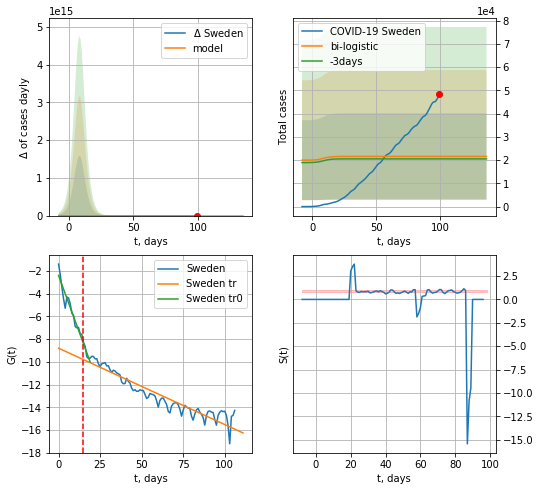

Sweden data at: 2020-06-11
+3 day model MAPE: 0.051166341002230595
model: bi-logistic
coeffs:  [ 1.59683643e+04 -6.67298110e+00  1.75504783e+02] [1.62331286e+03 3.49719159e-01 8.72648648e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.8604726205191318
forecast at the end of period: +37 days
	 deltaDaycases:  0
	 total cases:  21583 ± 18572
	 total death:  2151 ± 5552
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.908377
 intercept: -2.385275
 slope: -0.400494
trend coefficient of determination: 0.892256
 intercept: -8.790704
 slope: -0.067275


In [139]:
vL = 15#len(dfSW)-12-dT
x = forecast('Sweden',dfSW[:-9-dT],d1,7*12-dT,1.0)
xx = forecast2('Sweden',dfSW[:],d1,7*16-dT,x,1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

SW
           date  cases  active   death
103 2020-06-07  45065       0  4659.0
104 2020-06-08  45133       0  4694.0
105 2020-06-09  45924       0  4717.0
106 2020-06-10  46814       0  4795.0
107 2020-06-11  48288       0  4814.0


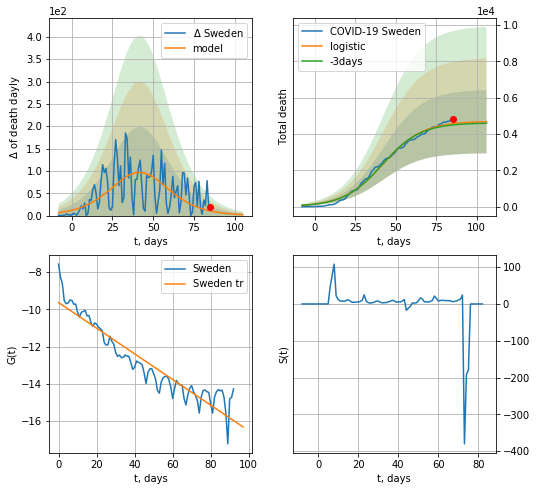

Sweden data at: 2020-06-11
+3 day model MAPE: 0.0152885433546616
model: logistic
coeffs:  [4.70358741e+03 8.21497355e-02 4.21054321e+01]
rational stdev:  0.3723855881767884
forecast at the end of period: +21 days
	 total death:  4679 ± 1742
trend coefficient of determination: 0.888160
 intercept: -9.641505
 slope: -0.068751


In [140]:
dfSW = read_df(pd.DataFrame(),"SW")
x = forecast('Sweden',dfSW[14:],d1,3*7,shift=1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


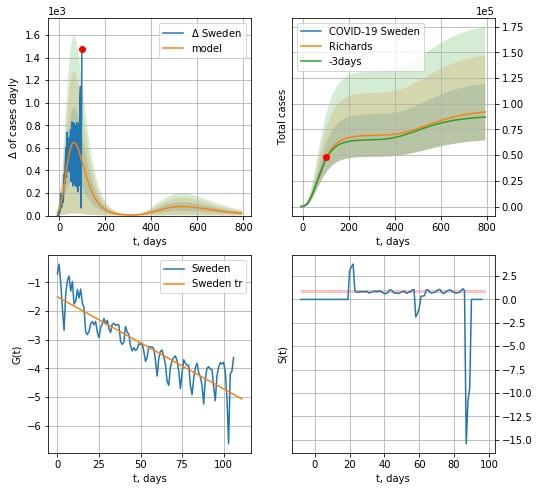

Sweden data at: 2020-06-11
+3 day model MAPE: 0.017925
model: Richards
coeffs: [ 6.92670494e+04  1.97904972e+00 -1.05263783e+02  1.29439256e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.299842
forecast at the end of period: +695 days
	 deltaDaycases: 20
	 total cases: 91940 ± 27567
	 total death: 9165 ± 8244
trend coefficient of determination: 0.794843
 intercept: -1.502485
 slope: -0.032145


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


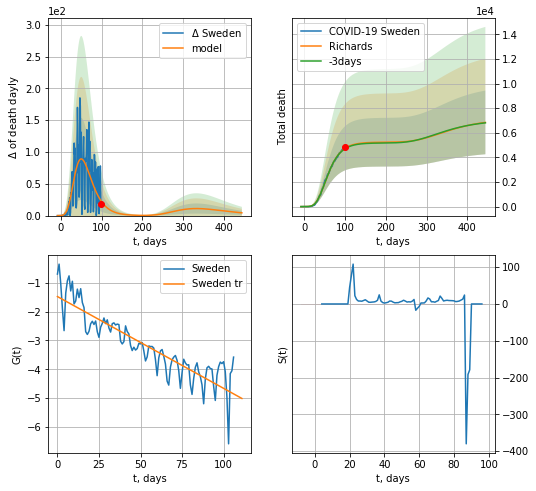

Sweden data at: 2020-06-11
+3 day model MAPE: 0.006861
model: Richards
coeffs: [ 5.23930263e+03  5.54875505e+00 -5.23885097e+01  8.36532756e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.378185
forecast at the end of period: +345 days
	 total death: 6841 ± 2587
trend coefficient of determination: 0.793079
 intercept: -1.478319
 slope: -0.031850


In [141]:
x = forecastRR('Sweden',dfSW[:],d1,110*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRR('Sweden',dfSW[:],d1,60*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs,cases='death')
#x = forecastQR('Sweden',dfSW[:],d1,16*7-dT,1.0)
#xx = forecast2R('Sweden',dfSW[:],d1,12*7-dT,x,1.0)#,addpred=True,xcoef=[0.25,1.,2.3,1]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


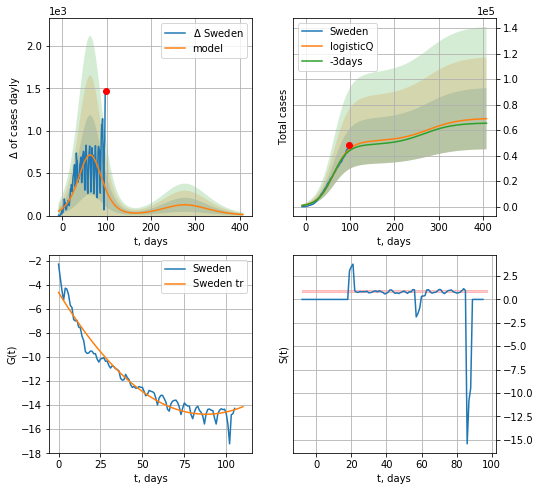

Sweden data at: 2020-06-11
+3 day model MAPE: 0.030118
model: logisticQ
coeffs: [ 5.12529802e+04  3.91220576e-07  6.34584495e+01 -1.42578153e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.347900
forecast at the end of period: +310 days
	 deltaDaycases: 12
	 total cases: 68962 ± 23992
	 total death: 6875 ± 7175
trend coefficient of determination: 0.955311
 intercept_: -4.63014451513896
 coeffs_: [ 0.         -0.23008672  0.00130705]


In [142]:
x = forecastRRR('Sweden',dfSW[1:],d1,55*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


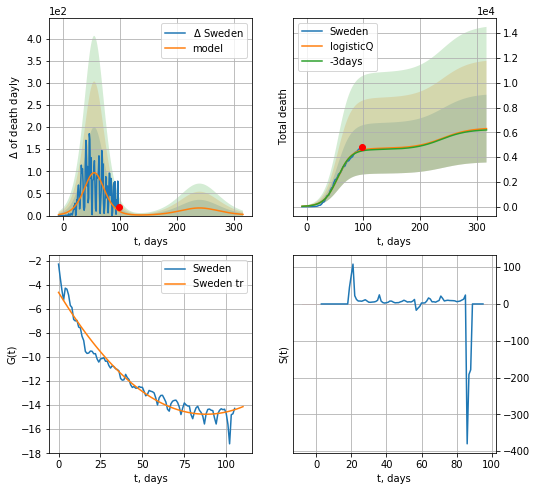

Sweden data at: 2020-06-11
+3 day model MAPE: 0.015396
model: logisticQ
coeffs: [ 4.69777226e+03  4.17491694e-07  5.50672824e+01 -1.97493165e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.434689
forecast at the end of period: +219 days
	 total death: 6296 ± 2736
trend coefficient of determination: 0.955311
 intercept_: -4.63014451513896
 coeffs_: [ 0.         -0.23008672  0.00130705]


In [143]:
x = forecastRRR('Sweden',dfSW[1:],d1,42*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')

CN
           date    cases  active   death
137 2020-06-07  83040.0      65  4634.0
138 2020-06-08  83040.5      65  4634.0
139 2020-06-09  83046.0      55  4634.0
140 2020-06-10  83057.0      62  4634.0
141 2020-06-11  83064.0      65  4634.0


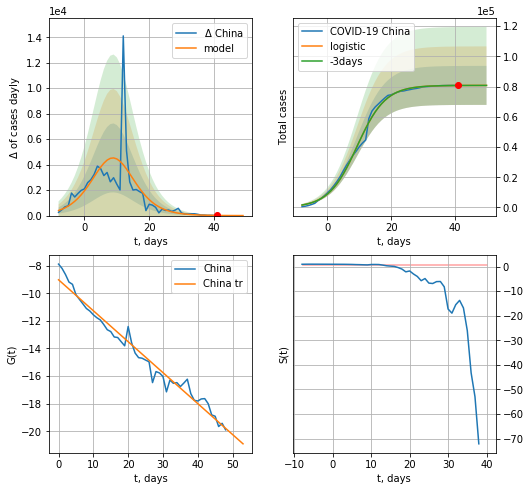

China data at: 2020-06-11
+3 day model MAPE: 0.00012785692335583266
model: logistic
coeffs:  [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.15971316009002232
forecast at the end of period: +9 days
	 deltaDaycases:  2
	 total cases:  80801 ± 12905
	 total death:  4507 ± 2159
trend coefficient of determination: 0.972183
 intercept: -9.021396
 slope: -0.224243


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


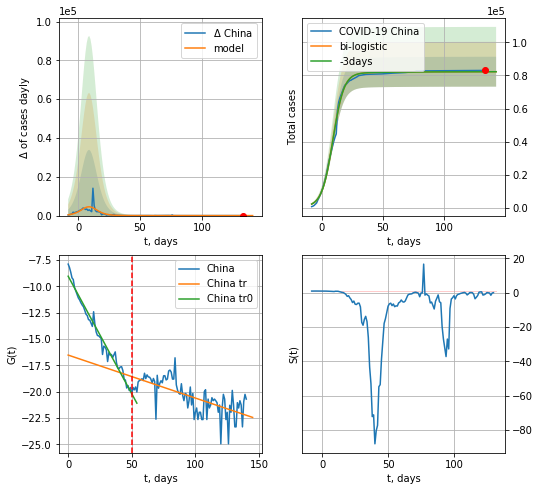

China data at: 2020-06-11
+3 day model MAPE: 0.00036320878195749383
model: bi-logistic
coeffs:  [1.51306282e+03 3.32953503e-02 1.48722231e+01] [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.10989736867812107
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  82301 ± 9044
	 total death:  4591 ± 1513
bi-logistic approximation splitting point: 50
trend0 coefficient of determination: 0.973282
 intercept: -9.036652
 slope: -0.223289
trend coefficient of determination: 0.452946
 intercept: -16.526876
 slope: -0.040828


In [144]:
dfCN = read_df(pd.DataFrame(),"CN")
try:
    x = forecast('China',dfCN[:50],d1,7*12-dT,1.0)
    #xx = forecast('China',dfCN[21:-32],d1,17)
    #xx = np.concatenate((x, xx), axis=0)
    xx = forecast2('China',dfCN[:],d1,12*7-dT,x,1.0,vL=50)
except:
    print ("Exception occurs")

In [145]:
#dfTT[dfTT.Country=='%s'%('China')][0].values[0]

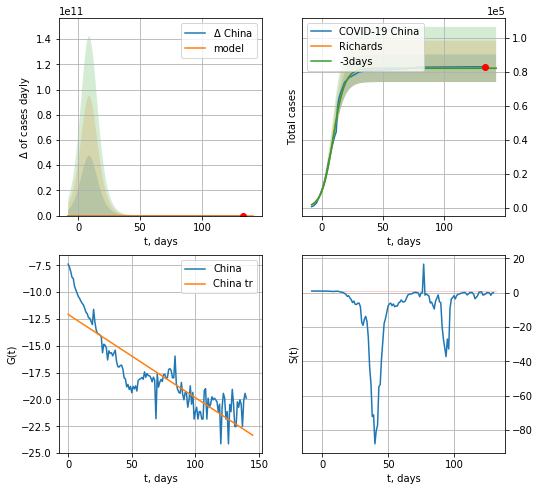

China data at: 2020-06-11
+3 day model MAPE: 0.000337
model: Richards
coeffs: [8.21617236e+04 2.27089230e-01 8.98510139e+00 9.27078050e-01]
rational stdev: 0.098869
forecast at the end of period: +9 days
	 deltaDaycases: 0
	 total cases: 82161 ± 8123
	 total death: 4583 ± 1359
trend coefficient of determination: 0.763781
 intercept: -12.081773
 slope: -0.077548


In [146]:
x = forecastRR('China',dfCN[:],d1,12*7-dT,1.0)
#x = forecastQR('China',dfCN[:],d1,6*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
#xx = forecast2R('China',dfCN[:],d1,6*7-dT,x,1.0)

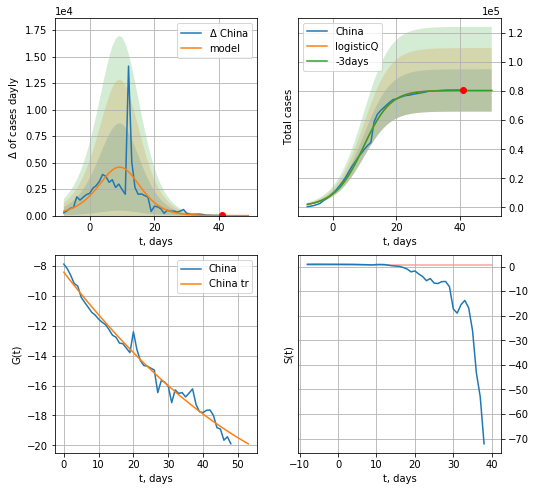

China data at: 2020-06-11
+3 day model MAPE: 0.001323
model: logisticQ
coeffs: [ 8.04175259e+04  1.07650457e-03  9.35257488e+00 -2.02425652e+02]
rational stdev: 0.181019
forecast at the end of period: +9 days
	 deltaDaycases: 0
	 total cases: 80416 ± 14556
	 total death: 4486 ± 2436
trend coefficient of determination: 0.979964
 intercept_: -8.428864441790822
 coeffs_: [ 0.         -0.29994819  0.00157784]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


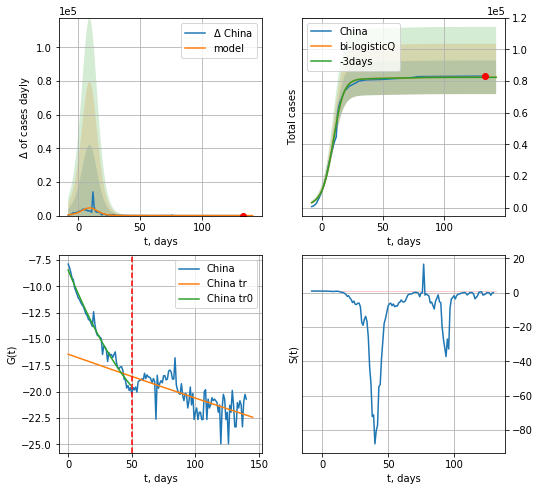

China data at: 2020-06-11
+3 day model MAPE: 0.000379
model: bi-logisticQ
coeffs: [ 1.91162633e+03  5.17444281e-04  2.47926414e+01 -3.18240560e-02]
rational stdev: 0.128948
forecast at the end of period: +9 days
	 deltaDaycases: 0
	 total cases: 82328 ± 10616
	 total death: 4592 ± 1776
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.980847
 intercept_: -8.442415731989867
 coeffs_: [ 0.         -0.29762768  0.00151769]
trend coefficient of determination: 0.452961
 intercept_: -16.446098766489985
 coeffs_: [ 0.00000000e+00 -4.26702271e-02  9.69903657e-06]


In [147]:
x = forecastRRR('China',dfCN[:50],d1,7*12-dT,1.0)
xx=forecast2RRR('China',dfCN[:],d1,12*7-dT,x,1.0,vL=50)

In [148]:
#x = forecastQR('China',dfCN[50:],d1,6*7-dT,1.0)

KR
           date  cases  active  death
113 2020-06-07  11814   978.0  273.0
114 2020-06-08  11852   989.0  274.0
115 2020-06-09  11902  1015.0  276.0
116 2020-06-10  11947  1017.0  276.0
117 2020-06-11  12003  1057.0  277.0


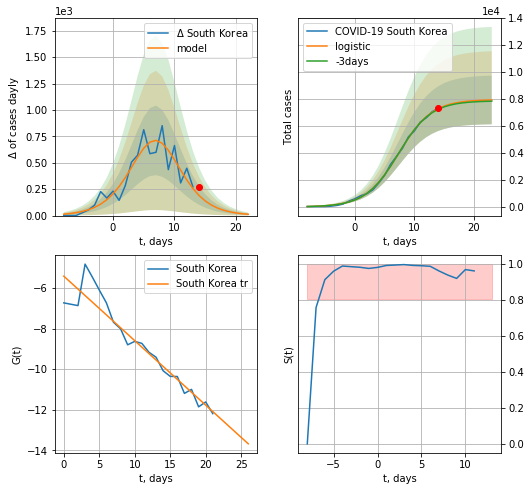

South Korea data at: 2020-06-11
model: logistic
coeffs:  [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.2275932520547523
forecast at the end of period: +9 days
	 deltaDaycases:  12
	 total cases:  7912 ± 1800
	 total death:  182 ± 124
trend coefficient of determination: 0.904554
 intercept: -5.419235
 slope: -0.317547


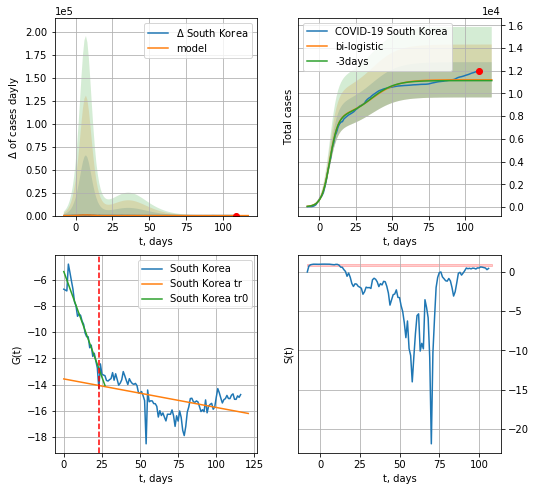

South Korea data at: 2020-06-11
+3 day model MAPE: 0.00654370283111483
model: bi-logistic
coeffs:  [3.26027352e+03 1.13503956e-01 3.62409895e+01] [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.13868102109474756
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  11201 ± 1553
	 total death:  258 ± 107
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.916463
 intercept: -5.394262
 slope: -0.321115
trend coefficient of determination: 0.249663
 intercept: -13.567441
 slope: -0.021727


In [149]:
dfKR = read_df(pd.DataFrame(),"KR")
x = forecast('South Korea',dfKR[:23],d1,7*12-dT,1.0,pMAPE=False)
xx=forecast2('South Korea',dfKR[:],d1,12*7-dT,x,1.0,vL=23)

In [150]:
#vL = 30
#x = forecastRRR('South Korea',dfKR[:vL],d1,8*7-dT,1.0)
#x1 = forecastRRR('South Korea',dfKR[39:],d1,12*7-dT,1.0)
#xx = np.concatenate((x, x1), axis=0)
#xx=forecast2RRR('South Korea',dfKR[:],d1,8*7-dT,x,1.0,vL=vL)

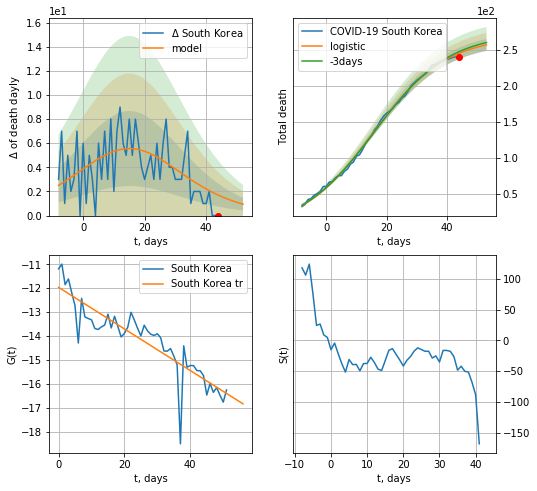

South Korea data at: 2020-06-11
model: logistic
coeffs:  [2.68513907e+02 8.28168908e-02 1.55065021e+01]
rational stdev:  0.03241893689547546
forecast at the end of period: +9 days
	 total death:  256 ± 8
trend coefficient of determination: 0.782213
 intercept: -11.965009
 slope: -0.087016


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:245: RuntimeWarning: divide by zero encountered in true_divide


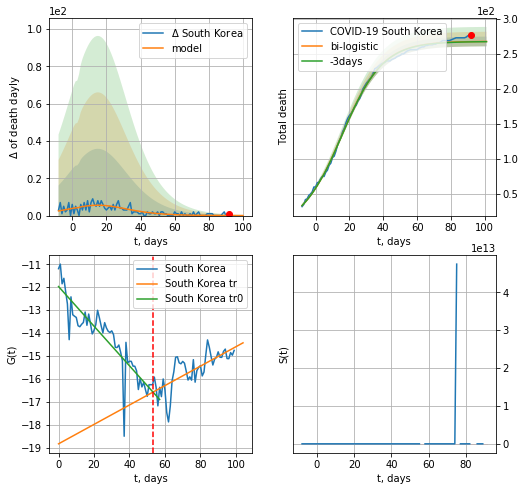

South Korea data at: 2020-06-11
+3 day model MAPE: 0.0011690916899177387
model: bi-logistic
coeffs:  [-0.50243096  1.99575591  3.90116444] [2.68513907e+02 8.28168908e-02 1.55065021e+01]
rational stdev:  0.02587013628542736
forecast at the end of period: +9 days
	 deltaDaydeath:  0
	 total death:  267 ± 6
bi-logistic approximation splitting point: 53
trend0 coefficient of determination: 0.789613
 intercept: -11.973248
 slope: -0.086531
trend coefficient of determination: 0.539155
 intercept: -18.839113
 slope: 0.042385


In [151]:
x = forecast('South Korea',dfKR[17:70],d1,12*7-dT,1.0,cases='death',pMAPE=False)
xx=forecast2('South Korea',dfKR[17:],d1,12*7-dT,x,1.0,vL=70-17,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


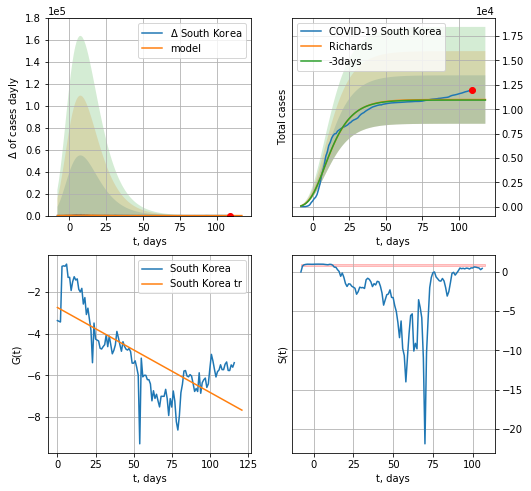

South Korea data at: 2020-06-11
+3 day model MAPE: 0.004922
model: Richards
coeffs: [ 1.09971219e+04  3.04614284e+01 -5.19109672e+01  3.15250836e-03]
rational stdev: 0.225546
forecast at the end of period: +9 days
	 deltaDaycases: 0
	 total cases: 10996 ± 2480
	 total death: 253 ± 171
trend coefficient of determination: 0.540280
 intercept: -2.752005
 slope: -0.040643


In [152]:
x = forecastRR('South Korea',dfKR[:],d1,12*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


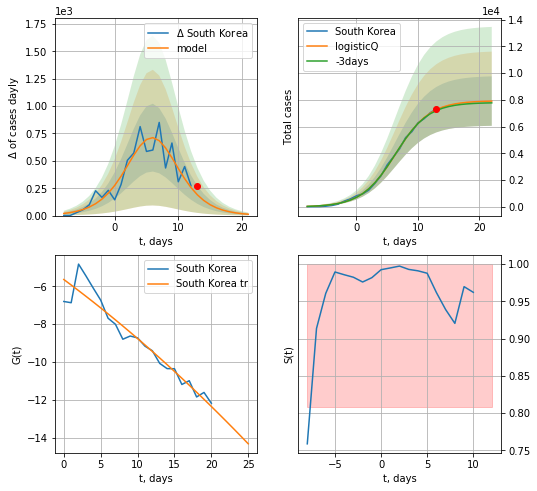

South Korea data at: 2020-06-11
+3 day model MAPE: 0.011158
model: logisticQ
coeffs: [ 7.93644801e+03  5.70813767e-05  6.37140978e+00 -6.30171017e+03]
rational stdev: 0.233522
forecast at the end of period: +9 days
	 deltaDaycases: 12
	 total cases: 7908 ± 1846
	 total death: 182 ± 127
trend coefficient of determination: 0.923340
 intercept_: -5.639271391154587
 coeffs_: [ 0.         -0.28882126 -0.00235709]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:333: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


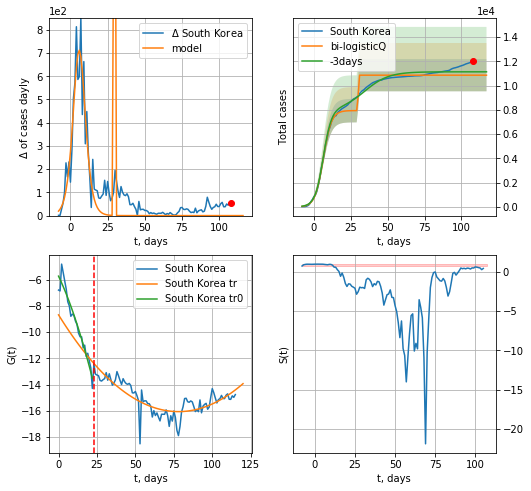

South Korea data at: 2020-06-11
+3 day model MAPE: 0.024917
model: bi-logisticQ
coeffs: [2914.16153269    3.16221692   30.00288538   -8.75663586]
rational stdev: 0.122144
forecast at the end of period: +9 days
	 deltaDaycases: 0
	 total cases: 10850 ± 1325
	 total death: 250 ± 91
bi-logisticQ approximation splitting point: 23
trend coefficient of determination: 0.939645
 intercept_: -5.742054822567119
 coeffs_: [ 0.         -0.24685696 -0.00483449]
trend coefficient of determination: 0.680650
 intercept_: -8.690369322064537
 coeffs_: [ 0.         -0.18875386  0.00120921]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [153]:
vL=23
x = forecastRRR('South Korea',dfKR[1:vL],d1,12*7-dT,1.0)
xx=forecast2RRR('South Korea',dfKR[1:],d1,12*7-dT,x,1.0,vL=vL)

In [154]:
#x = forecastRR('South Korea',dfKR[68:],d1,10*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


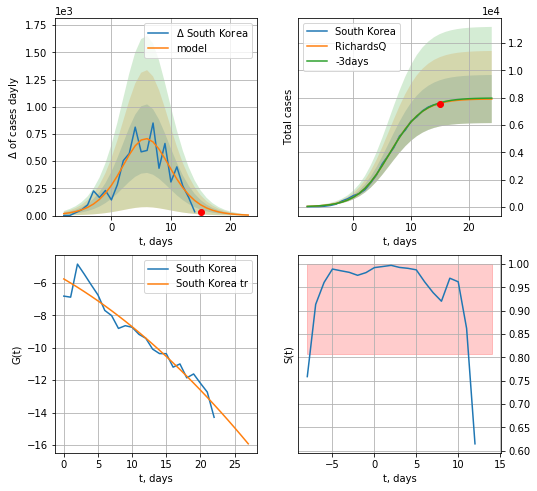

South Korea data at: 2020-06-11
+3 day model MAPE: 0.006079
model: RichardsQ
coeffs: [ 7.90607495e+03  3.14377481e-03 -1.32150046e+02  5.22462480e+00
  7.59593205e-01]
rational stdev: 0.222738
forecast at the end of period: +9 days
	 deltaDaycases: 4
	 total cases: 7896 ± 1758
	 total death: 182 ± 121
trend coefficient of determination: 0.939645
 intercept_: -5.742054822567119
 coeffs_: [ 0.         -0.24685696 -0.00483449]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:444: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:444: RuntimeWarning: overflow encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


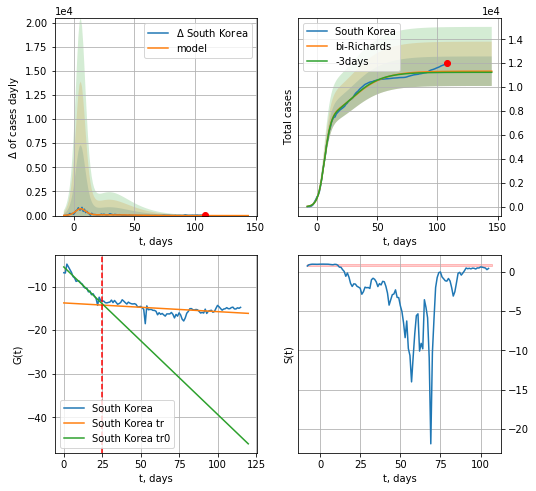

South Korea data at: 2020-06-11
+3 day model MAPE: 0.007672
model: bi-Richards
coeffs: [ 3.42662001e+03  1.40556731e-01 -1.03655464e+02 -2.09129586e+03
  2.12042607e-04]
rational stdev: 0.108780
forecast at the end of period: +37 days
	 deltaDaycases: 0
	 total cases: 11331 ± 1232
	 total death: 261 ± 85
bi-logisticQ approximation splitting point: 25
trend coefficient of determination: 0.936460
 intercept: -5.478818
 slope: -0.338423
trend coefficient of determination: 0.210169
 intercept: -13.736534
 slope: -0.019990


In [155]:
vL=25
x = forecastQR('South Korea',dfKR[1:vL],d1,12*7-dT,1.0)
xx=forecast2QR('South Korea',dfKR[1:],d1,16*7-dT,x,1.0,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


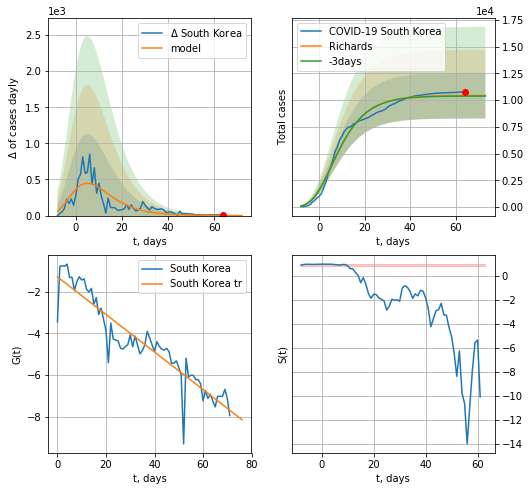

South Korea data at: 2020-06-11
+3 day model MAPE: 0.004451
model: Richards
coeffs: [ 1.04318163e+04  3.06447185e+01 -4.21690973e+01  3.81700530e-03]
rational stdev: 0.205493
forecast at the end of period: +9 days
	 deltaDaycases: 0
	 total cases: 10427 ± 2142
	 total death: 240 ± 147
trend coefficient of determination: 0.863609
 intercept: -1.289365
 slope: -0.090003


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


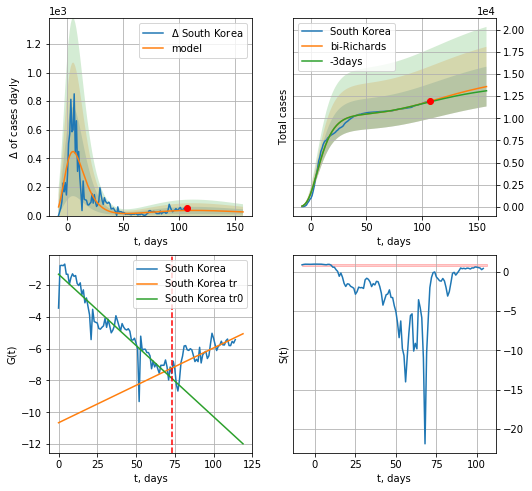

South Korea data at: 2020-06-11
+3 day model MAPE: 0.005955
model: bi-Richards
coeffs: [ 4.58999407e+03  2.74322533e+00 -1.12322085e+02  7.84510398e-03]
rational stdev: 0.165373
forecast at the end of period: +51 days
	 deltaDaycases: 25
	 total cases: 13575 ± 2244
	 total death: 313 ± 155
bi-Richards approximation splitting point: 73
trend coefficient of determination: 0.865701
 intercept: -1.335117
 slope: -0.089451
trend coefficient of determination: 0.527628
 intercept: -10.656621
 slope: 0.046938


In [156]:
vL = 2
vL1 = 75
x = forecastRR('South Korea',dfKR[vL:vL1],d1,12*7-dT,1.0)
xx=forecast2RR('South Korea',dfKR[vL:],d1,18*7-dT,x,1.0,vL=vL1-vL)
#xx = np.concatenate((x, xx), axis=0)
#print (xx)
#xxx=forecast3RR('South Korea',dfKR[1:],d1,12*7-dT,xx,1.0,vL=[vL,vL1],zoom=1e3)

In [157]:
a = np.array([ 7.90607495e+03,  3.14377481e-03, -1.32150046e+02,  5.22462480e+00, 7.59593205e-01])
b = np.array([ 2.91876181e+03,  1.43325056e-01, -3.99886263e+01, -3.39427361e+02, 1.77367535e-03])
QRkoreaCoeffs=b/a
QRkoreaCoeffs,RkoreaCoeffs,koreaCoeffs

(array([ 3.69179628e-01,  4.55901153e+01,  3.02600169e-01, -6.49668395e+01,
         2.33503320e-03]),
 [0.36242246, 2.56241634, 1.84890887, 0.13324732],
 [0.35416971, 0.02606324, 4.35859408, 19.30413219])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


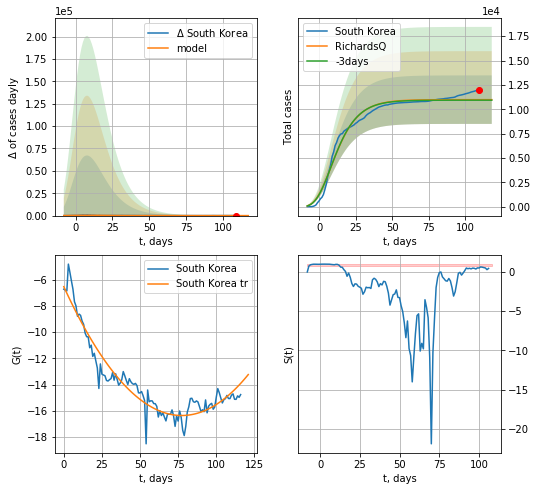

South Korea data at: 2020-06-11
+3 day model MAPE: 0.004963
model: RichardsQ
coeffs: [ 1.09919249e+04  1.22691406e-01 -8.11058124e+01 -3.03902077e+03
  2.48913105e-04]
rational stdev: 0.226125
forecast at the end of period: +9 days
	 deltaDaycases: 0
	 total cases: 10991 ± 2485
	 total death: 253 ± 171
trend coefficient of determination: 0.917056
 intercept_: -6.5408999208140495
 coeffs_: [ 0.         -0.25359796  0.00163858]


In [158]:
x = forecastQR('South Korea',dfKR[:],d1,12*7-dT,1.0)

SG
           date  cases  active  death
136 2020-06-07  38296   13385   25.0
137 2020-06-08  38514   13121   25.0
138 2020-06-09  38965   13063   25.0
139 2020-06-10  39387   12830   25.0
140 2020-06-11  39387   12076   25.0


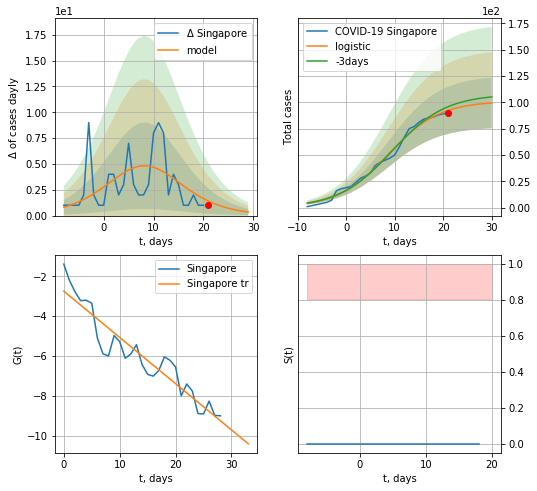

Singapore data at: 2020-06-11
+3 day model MAPE: 0.03963437966370839
model: logistic
coeffs:  [101.02990869   0.19128696   8.67555654]
rational stdev:  0.24212715882466435
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  99 ± 24
	 total death:  0 ± 0
trend coefficient of determination: 0.887345
 intercept: -2.744831
 slope: -0.232145


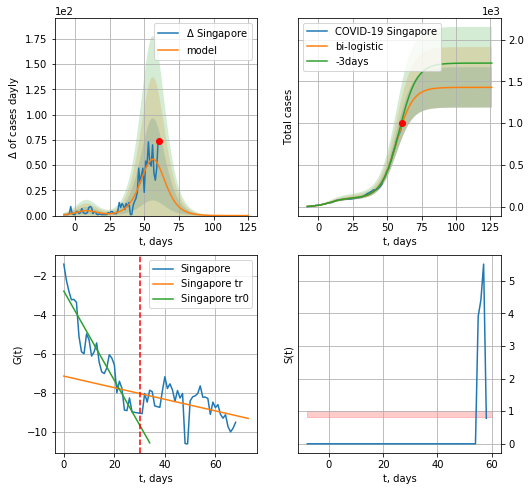

Singapore data at: 2020-06-11
+3 day model MAPE: 0.06119828055586902
model: bi-logistic
coeffs:  [1.32695355e+03 1.68329223e-01 5.66911530e+01] [101.02990869   0.19128696   8.67555654]
rational stdev:  0.16894112354758975
forecast at the end of period: +65 days
	 deltaDaycases:  0
	 total cases:  1427 ± 241
	 total death:  0 ± 0
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend coefficient of determination: 0.177815
 intercept: -7.138791
 slope: -0.029776
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


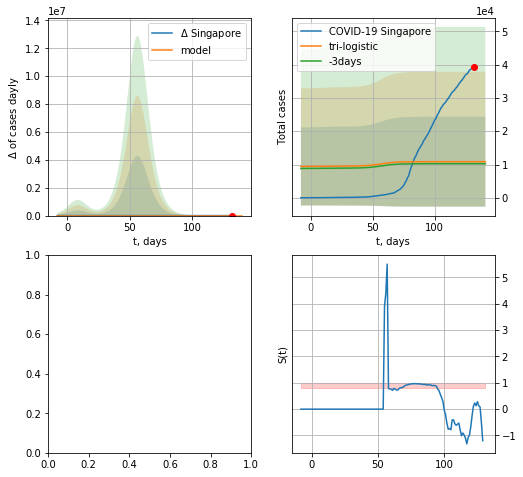

In [159]:
vL = 30
vL1 = 70
try:
    dfSG = read_df(pd.DataFrame(),"SG")
    x = forecast('Singapore',dfSG[:vL],d1,7*12-dT,1.0)
    xx = forecast2('Singapore',dfSG[:vL1],d1,20*7-dT,x,1.0,vL=vL)
    xx = np.concatenate((x, xx), axis=0)
    xxx = forecast3("Singapore",dfSG,d1,12*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


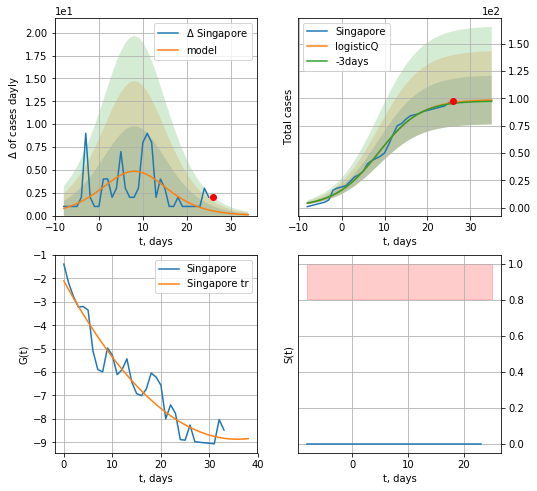

Singapore data at: 2020-06-11
+3 day model MAPE: 0.008158
model: logisticQ
coeffs: [ 9.88556757e+01  2.70682558e-04  8.43151542e+00 -7.17677228e+02]
rational stdev: 0.226599
forecast at the end of period: +9 days
	 deltaDaycases: 0
	 total cases: 98 ± 22
	 total death: 0 ± 0
trend coefficient of determination: 0.918167
 intercept_: -2.103369555726971
 coeffs_: [ 0.         -0.37832792  0.00528917]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:571: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

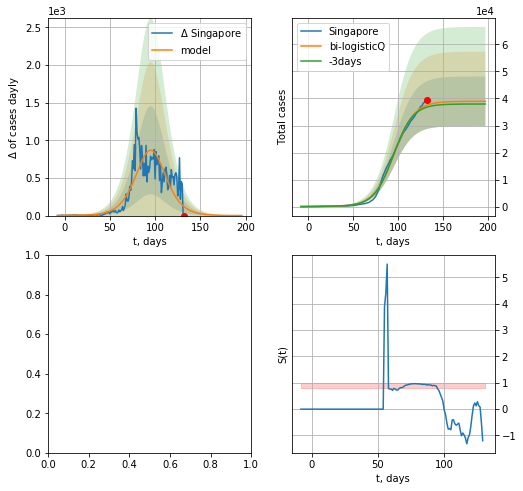

In [160]:
vL = 35
x = forecastRRR('Singapore',dfSG[:vL],d1,7*12-dT,1.0)
xx = forecast2RRR('Singapore',dfSG[:],d1,20*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

In [53]:
#vL = 31
#x = forecast('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
#xx = forecast2('Singapore',dfSG[:],d1,12*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

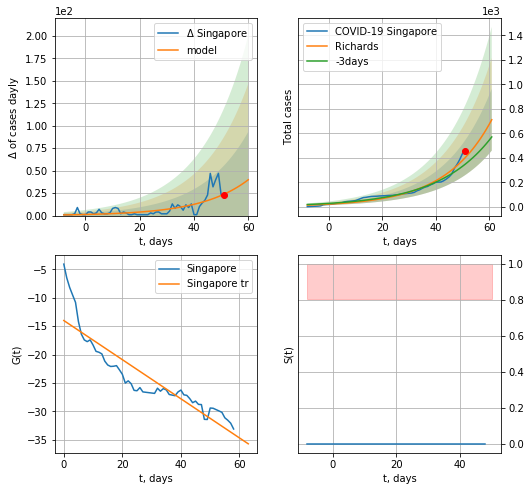

Singapore data at: 2020-06-10
+3 day model MAPE: 0.162175
model: Richards
coeffs: [9.30440928e+03 5.77261259e-02 1.05546035e+02 4.91744477e+00]
rational stdev: 0.355378
forecast at the end of period: +10 days
	 deltaDaycases: 39
	 total cases: 711 ± 252
	 total death: 0 ± 0
trend coefficient of determination: 0.813965
 intercept: -14.017324
 slope: -0.343928


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


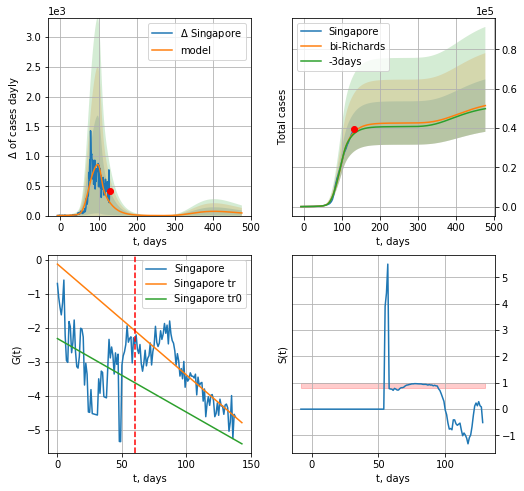

Singapore data at: 2020-06-10
+3 day model MAPE: 0.020956
model: bi-Richards
coeffs: [ 3.32555006e+04  5.56200512e+00 -8.79478294e+00  8.50462786e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.259612
forecast at the end of period: +346 days
	 deltaDaycases: 44
	 total cases: 51434 ± 13353
	 total death: 33 ± 25
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.125660
 intercept: -2.320500
 slope: -0.021656
trend coefficient of determination: 0.742699
 intercept: -0.129567
 slope: -0.032624


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


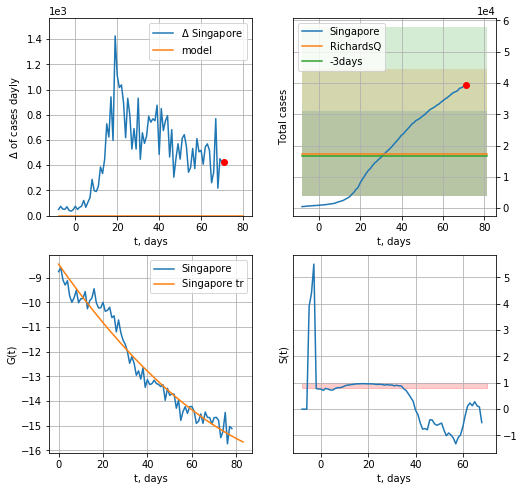

Singapore data at: 2020-06-10
+3 day model MAPE: 0.050526
model: RichardsQ
coeffs: [ 1.74338125e+04  1.24101977e+01 -2.89326500e+03  2.57466151e+03
 -5.30795648e+00]
rational stdev: 0.774130
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 17433 ± 13496
	 total death: 11 ± 25
trend coefficient of determination: 0.960171
 intercept_: -8.453118856633658
 coeffs_: [ 0.         -0.12854236  0.00050303]


In [54]:
vL = 60
x = forecastRR('Singapore',dfSG[:vL],d1,12*7-dT,1.0)
x = forecast2RR('Singapore',dfSG[:],d1,60*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
#xx = forecast2R('Singapore',dfSG[:],d1,28*7-dT,x,1.0)
x = forecastQR('Singapore',dfSG[60:],d1,12*7-dT,1.0)

ES
          date   cases  active  death
87 2020-06-07  1940.0     188   69.0
88 2020-06-08  1947.0     194   69.0
89 2020-06-09  1958.0     199   69.0
90 2020-06-10  1965.0     199   69.0
91 2020-06-11  1965.0     199   69.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


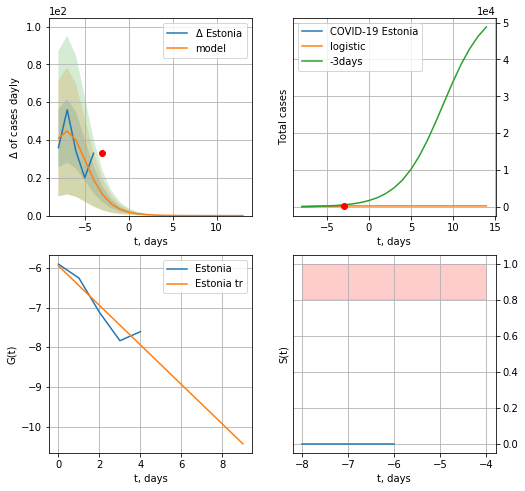

Estonia data at: 2020-06-11
+3 day model MAPE: 0.6707560476295664
model: logistic
coeffs:  [277.64023436   0.65084323  -6.57074778]
rational stdev:  0.028784635346108894
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  277 ± 7
	 total death:  9 ± 0
trend coefficient of determination: 0.881874
 intercept: -5.949047
 slope: -0.498463
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


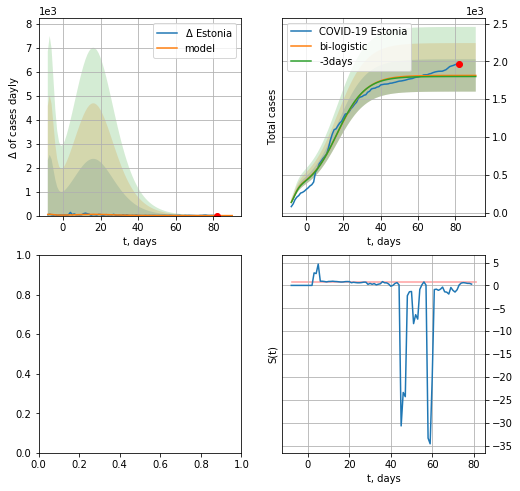

In [161]:
shift = 1.0
try:
    dfES = read_df(pd.DataFrame(),"ES")
    x = forecast('Estonia',dfES[1:7],d1,17,1.)
    xx = forecast2('Estonia',dfES[1:],d1,12*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.5],vL=7)
except:
    print ("Exception occurs")

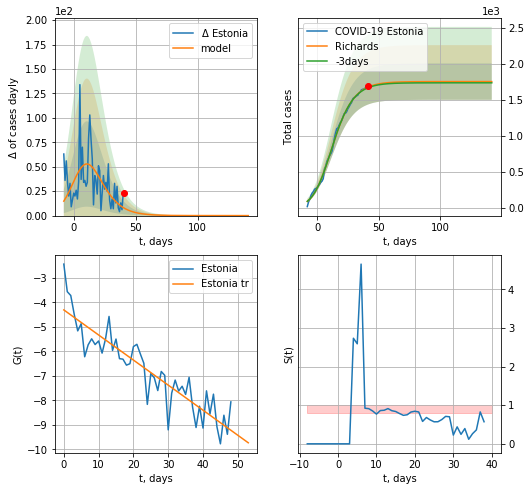

Estonia data at: 2020-06-10
+3 day model MAPE: 0.005500
model: Richards
coeffs: [1.74994618e+03 2.01777902e-01 4.40550518e+00 5.06367091e-01]
rational stdev: 0.144467
forecast at the end of period: +101 days
	 deltaDaycases: 0
	 total cases: 1749 ± 252
	 total death: 61 ± 26
trend coefficient of determination: 0.813896
 intercept: -4.307388
 slope: -0.102288


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


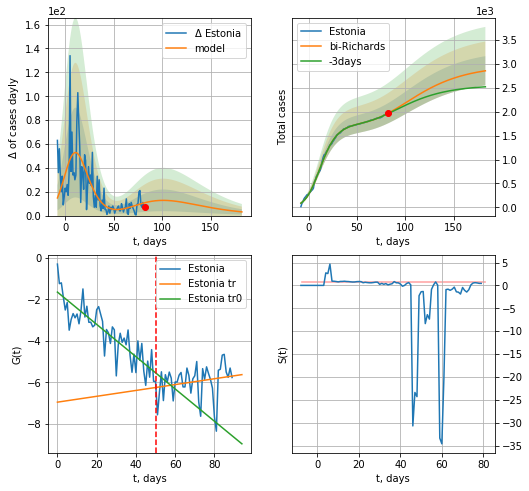

Estonia data at: 2020-06-10
+3 day model MAPE: 0.004587
model: bi-Richards
coeffs: [ 1.21575059e+03  1.69883478e+00 -4.03767647e+01  1.69127172e-02]
rational stdev: 0.107133
forecast at the end of period: +101 days
	 deltaDaycases: 3
	 total cases: 2853 ± 305
	 total death: 100 ± 32
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.742895
 intercept: -1.648920
 slope: -0.077806
trend coefficient of determination: 0.041449
 intercept: -6.954785
 slope: 0.014116


In [49]:
vL=50
x = forecastRR('Estonia',dfES[:vL],d1,7*25-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
#x = forecastQR('Estonia',dfES[10:],d1,7*10-dT,1.)
xx = forecast2RR('Estonia',dfES[:],d1,7*25-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


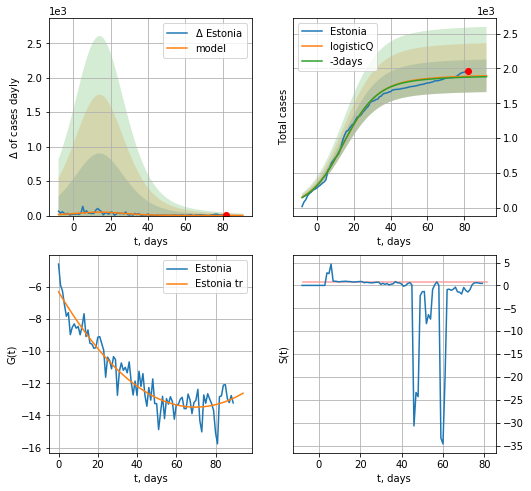

Estonia data at: 2020-06-10
+3 day model MAPE: 0.006915
model: logisticQ
coeffs: [ 1.82537376e+03  4.54990471e-07  1.44484361e+01 -2.37354420e+05]
S.Korea scenario coeffs: [0.04375, 0.5, 4.0, 1]
rational stdev: 0.123500
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 1893 ± 233
	 total death: 66 ± 24
trend coefficient of determination: 0.891107
 intercept_: -6.317826629317239
 coeffs_: [ 0.         -0.20543721  0.00147276]


In [50]:
x = forecastRRR('Estonia',dfES[:],d1,7*12-dT,1.,addpred=True,xcoef=[0.35/8,.5,4.,1])

LV
          date   cases  active  death
92 2020-06-07  1088.3     281   26.0
93 2020-06-08  1088.6     281   26.0
94 2020-06-09  1089.0     269   26.0
95 2020-06-10  1092.0     272   26.0
96 2020-06-11  1096.0     251   27.0


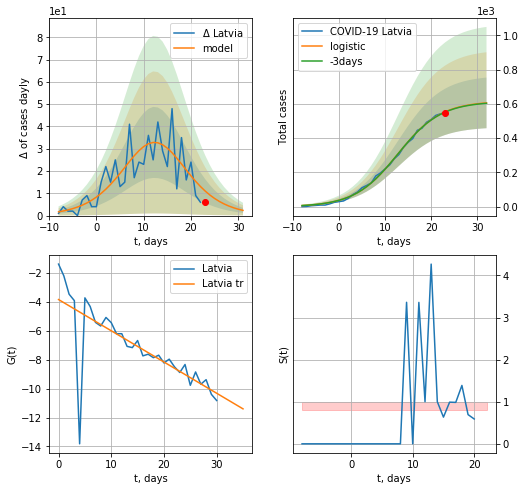

Latvia data at: 2020-06-11
+3 day model MAPE: 0.0032633377916749073
model: logistic
coeffs:  [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.24373797630646024
forecast at the end of period: +9 days
	 deltaDaycases:  2
	 total cases:  606 ± 147
	 total death:  14 ± 10
trend coefficient of determination: 0.538666
 intercept: -3.837099
 slope: -0.216023


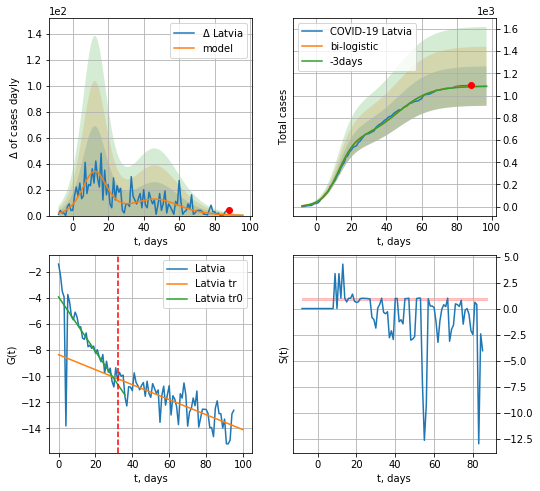

Latvia data at: 2020-06-11
+3 day model MAPE: 0.0028470981885969733
model: bi-logistic
coeffs:  [4.71052541e+02 1.07332357e-01 4.68021790e+01] [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.16340189740478278
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  1084 ± 177
	 total death:  25 ± 12
bi-logistic approximation splitting point: 32
trend0 coefficient of determination: 0.543521
 intercept: -3.904452
 slope: -0.209287
trend coefficient of determination: 0.605529
 intercept: -8.344498
 slope: -0.057591


In [361]:
vL=32
dfLV = read_df(pd.DataFrame(),"LV")
try:
    x = forecast('Latvia',dfLV[:vL],d1,12*7-dT,1.)
    xx=forecast2('Latvia',dfLV[:],d1,12*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.],vL=vL)
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


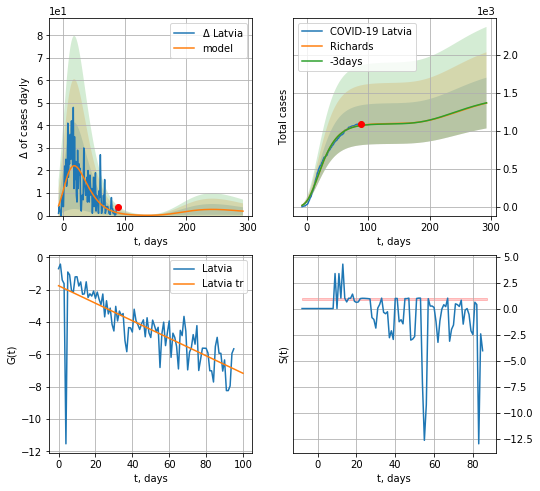

Latvia data at: 2020-06-11
+3 day model MAPE: 0.003363
model: Richards
coeffs: [ 1.09661420e+03  9.75951354e+00 -7.62403123e+01  5.63279320e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.244838
forecast at the end of period: +205 days
	 deltaDaycases: 1
	 total cases: 1366 ± 334
	 total death: 32 ± 23
trend coefficient of determination: 0.581187
 intercept: -1.752548
 slope: -0.054128


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


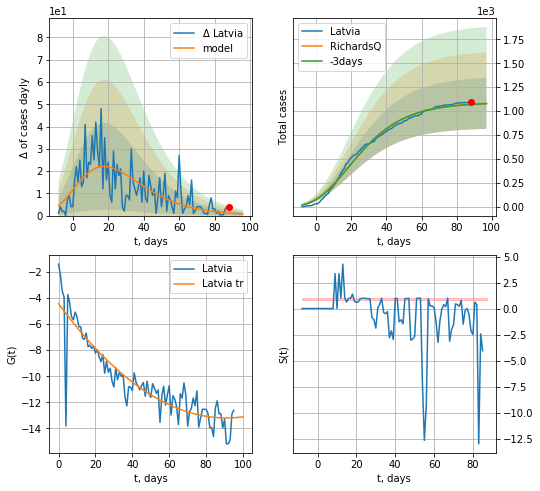

Latvia data at: 2020-06-11
+3 day model MAPE: 0.003359
model: RichardsQ
coeffs: [ 1.09279683e+03  3.16894599e-02 -1.21706564e+02 -2.17826021e+03
  7.41657246e-04]
rational stdev: 0.246644
forecast at the end of period: +9 days
	 deltaDaycases: 0
	 total cases: 1080 ± 266
	 total death: 25 ± 18
trend coefficient of determination: 0.805240
 intercept_: -4.424114255816825
 coeffs_: [ 0.         -0.19303269  0.00106123]


In [362]:
x = forecastRR('Latvia',dfLV[:],d1,7*40-dT,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Latvia',dfLV[:],d1,7*12-dT,1.)
#xx=forecast2R('Latvia',dfLV[:],d1,10*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


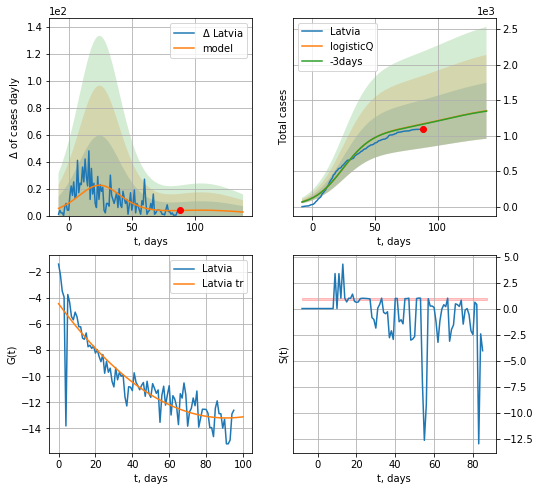

Latvia data at: 2020-06-11
+3 day model MAPE: 0.003937
model: logisticQ
coeffs: [ 1.05509374e+03  2.43320277e-07  2.47181160e+01 -3.44200792e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.291573
forecast at the end of period: +51 days
	 deltaDaycases: 2
	 total cases: 1349 ± 393
	 total death: 32 ± 27
trend coefficient of determination: 0.805240
 intercept_: -4.424114255816825
 coeffs_: [ 0.         -0.19303269  0.00106123]


In [363]:
#trend3(dfCA[12:],dfPT,dfTR[4:],'CA','PT','TR',40,40,40)
x = forecastRRR('Latvia',dfLV[:],d1,7*18-dT,1.,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


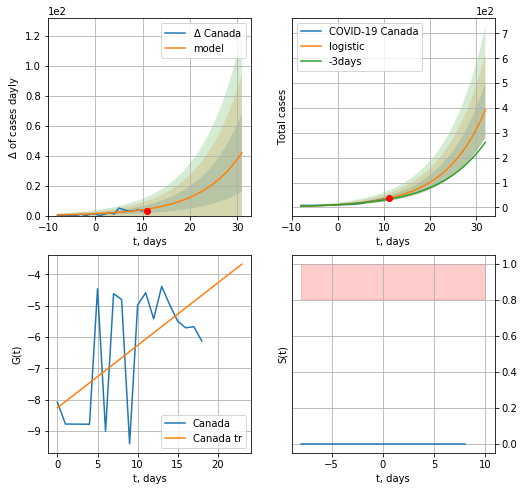

Canada data at: 2020-06-11
+3 day model MAPE: 0.14132705134128837
model: logistic
coeffs:  [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2833741000964234
forecast at the end of period: +21 days
	 deltaDaycases:  41
	 total cases:  392 ± 111
	 total death:  32 ± 27
trend coefficient of determination: 0.348503
 intercept: -8.254919
 slope: 0.199271


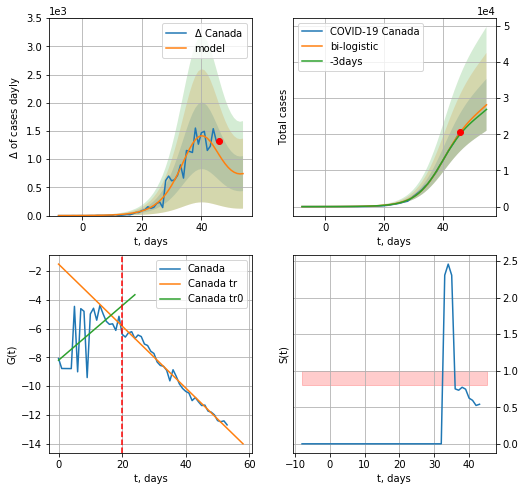

Canada data at: 2020-06-11
+3 day model MAPE: 0.02936701556145869
model: bi-logistic
coeffs:  [2.40154010e+04 2.16961372e-01 4.02658693e+01] [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2549294046309869
forecast at the end of period: +9 days
	 deltaDaycases:  744
	 total cases:  28177 ± 7183
	 total death:  2309 ± 1765
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend coefficient of determination: 0.982767
 intercept: -1.518979
 slope: -0.215271


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:305: RuntimeWarning: overflow encountered in exp


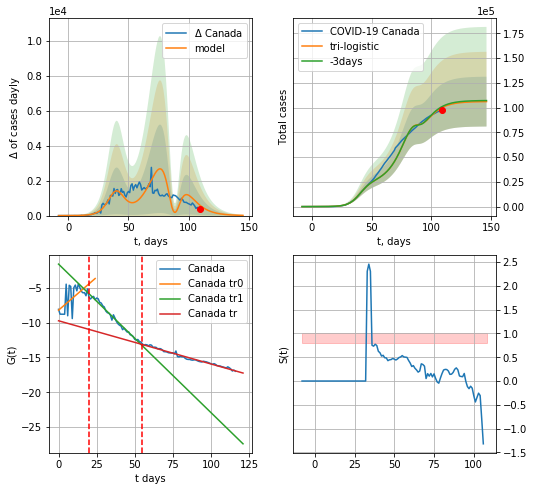

Canada data at: 2020-06-11
+3 day model MAPE: 0.010251143079613289
model: tri-logistic
coeffs:  [-4.31630566e+04  2.82231349e-01  8.79887269e+01] [1.25340432e+05 1.13222117e-01 8.29016731e+01 2.40154010e+04
 2.16961372e-01 4.02658693e+01]
forecast rational stdev:  0.23720302541519583
forecast at the end of period: +37 days
	 deltaDaycases:  11
	 total cases:  106093 ± 25165
	 total death:  8695 ± 6187
tri-logistic approximation splitting points: 20,55
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend1 coefficient of determination: 0.983223
 intercept: -1.572806
 slope: -0.213535
trend coefficient of determination: 0.981767
 intercept: -9.719158
 slope: -0.062114


In [165]:
vL=20
vL1=55
x = forecast('Canada',dfCA[:vL],d1,3*7,1.)
xx=forecast2('Canada',dfCA[:vL1],d1,12*7-dT,x,1.,vL=vL)#,addpred=True,xcoef=[0.25,1.,2.]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Canada",dfCA[:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

CA
           date    cases  active   death
113 2020-06-07  95699.0   33666  7800.0
114 2020-06-08  96244.0   33576  7835.0
115 2020-06-09  96653.0   33184  7897.0
116 2020-06-10  97125.0   32526  7960.0
117 2020-06-11  97530.0   31878  7994.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


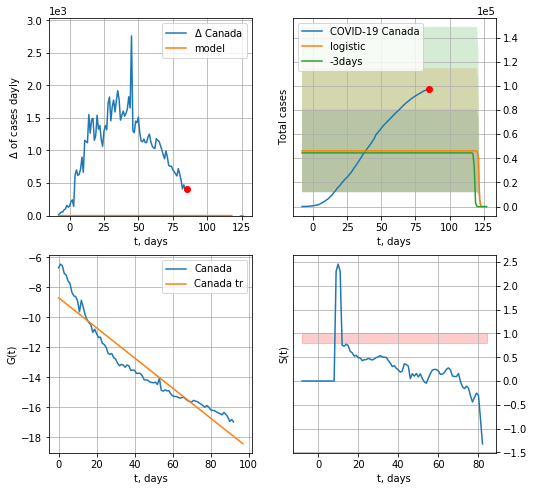

Canada data at: 2020-06-11
+3 day model MAPE: 0.03772453780406281
model: logistic
coeffs:  [ 4.61797340e+04 -3.90626882e+00  1.21511891e+02]
rational stdev:  0.7413420938664369
forecast at the end of period: +42 days
	 deltaDaycases:  0
	 total cases:  0 ± 0
	 total death:  0 ± 0
trend coefficient of determination: 0.902704
 intercept: -8.689262
 slope: -0.100476


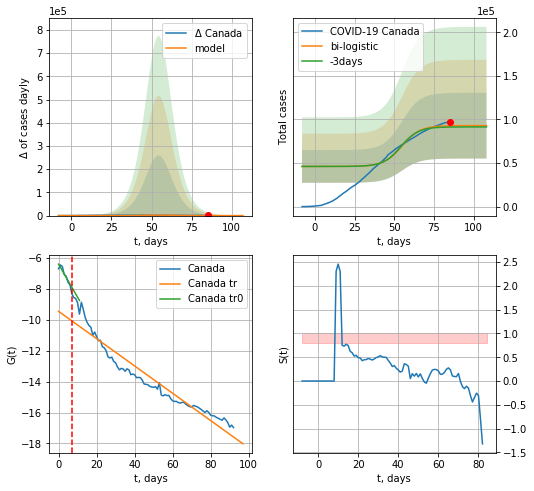

Canada data at: 2020-06-11
+3 day model MAPE: 0.015596124213521193
model: bi-logistic
coeffs:  [4.67821289e+04 1.75593553e-01 5.48091496e+01] [ 4.61797340e+04 -3.90626882e+00  1.21511891e+02]
rational stdev:  0.4059113952100603
forecast at the end of period: +23 days
	 deltaDaycases:  0
	 total cases:  92957 ± 37732
	 total death:  7619 ± 9277
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.859073
 intercept: -6.392122
 slope: -0.214001
trend coefficient of determination: 0.920745
 intercept: -9.446319
 slope: -0.088399


In [166]:
dfCA = read_df(pd.DataFrame(),"CA")
x = forecast('Canada',dfCA[24:],d1,6*7,1.,cases='cases')
xx=forecast2('Canada',dfCA[24:],d1,14*7-dT,x,1.,vL=31-24,cases='cases')

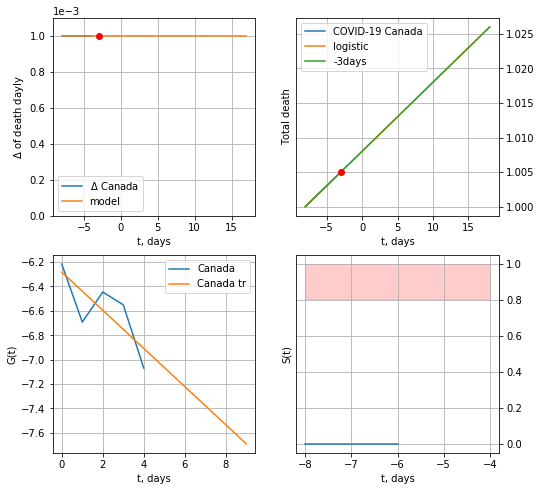

Canada data at: 2020-06-11
+3 day model MAPE: 5.06934136593531e-07
model: logistic
coeffs:  [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  1.4705534785239981e-08
forecast at the end of period: +21 days
	 total death:  1 ± 0
trend coefficient of determination: 0.608158
 intercept: -6.282802
 slope: -0.156326


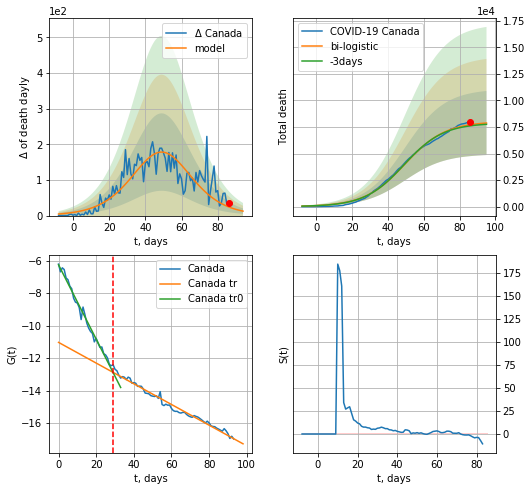

Canada data at: 2020-06-11
+3 day model MAPE: 0.013865730824360137
model: bi-logistic
coeffs:  [8.00776296e+03 8.89978111e-02 4.94641495e+01] [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  0.3831539747288666
forecast at the end of period: +9 days
	 deltaDaydeath:  12
	 total death:  7872 ± 3016
bi-logistic approximation splitting point: 29
trend0 coefficient of determination: 0.986075
 intercept: -6.260314
 slope: -0.228750
trend coefficient of determination: 0.980711
 intercept: -11.034049
 slope: -0.063687


In [167]:
vL=29
vL1=50
x = forecast('Canada',dfCA[23:vL],d1,3*7,1.,cases='death')
xx=forecast2('Canada',dfCA[23:],d1,12*7-dT,x,1.,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,2.]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Canada",dfCA[24:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


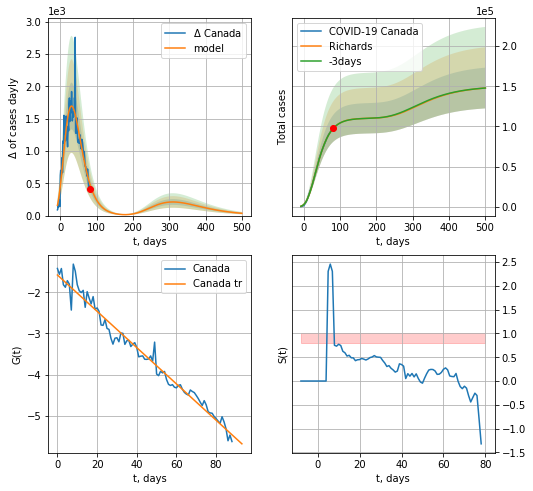

Canada data at: 2020-06-11
+3 day model MAPE: 0.000418
model: Richards
coeffs: [ 1.10369574e+05  3.30011079e+00 -7.24920322e+01  1.27386774e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.171502
forecast at the end of period: +420 days
	 deltaDaycases: 35
	 total cases: 147859 ± 25358
	 total death: 12119 ± 6235
trend coefficient of determination: 0.974423
 intercept: -1.576382
 slope: -0.044186


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


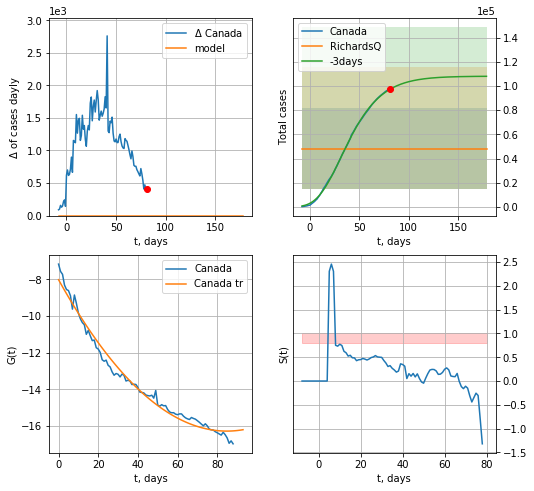

Canada data at: 2020-06-11
+3 day model MAPE: 0.506374
model: RichardsQ
coeffs: [ 4.82261111e+04 -2.83140842e+00 -1.56438862e+02 -2.32049045e+01
 -2.03933927e-02]
rational stdev: 0.695716
forecast at the end of period: +98 days
	 deltaDaycases: 0
	 total cases: 48226 ± 33551
	 total death: 3952 ± 8248
trend coefficient of determination: 0.982369
 intercept_: -8.025347602526958
 coeffs_: [ 0.         -0.19450623  0.00114595]


In [168]:
x = forecastRR('Canada',dfCA[28:],d1,60*7,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Canada',dfCA[28:],d1,14*7,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


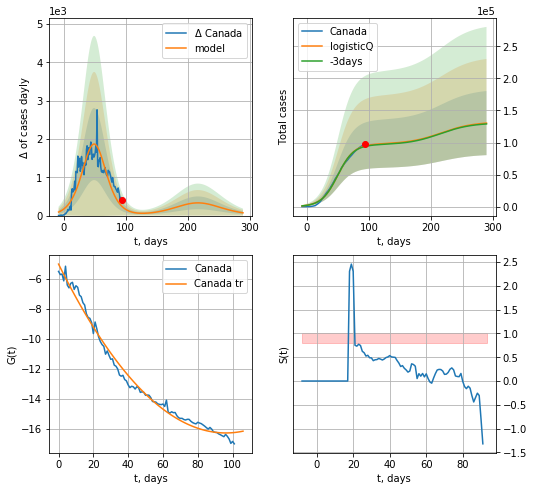

Canada data at: 2020-06-11
+3 day model MAPE: 0.009246
model: logisticQ
coeffs: [ 9.76973207e+04  4.63563681e-07  4.97484699e+01 -1.64692209e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.383803
forecast at the end of period: +196 days
	 deltaDaycases: 72
	 total cases: 130335 ± 50023
	 total death: 10682 ± 12299
trend coefficient of determination: 0.988324
 intercept_: -5.005734483819351
 coeffs_: [ 0.         -0.23400616  0.00121758]


In [169]:
x = forecastRRR('Canada',dfCA[15:],d1,7*28,1.,addpred=True,xcoef=koreaCoeffs)

PT
           date  cases  active   death
97  2020-06-07  34693   12219  1479.0
98  2020-06-08  34885   12244  1485.0
99  2020-06-09  35306   12475  1492.0
100 2020-06-10  35600   12361  1497.0
101 2020-06-11  35910   12404  1504.0


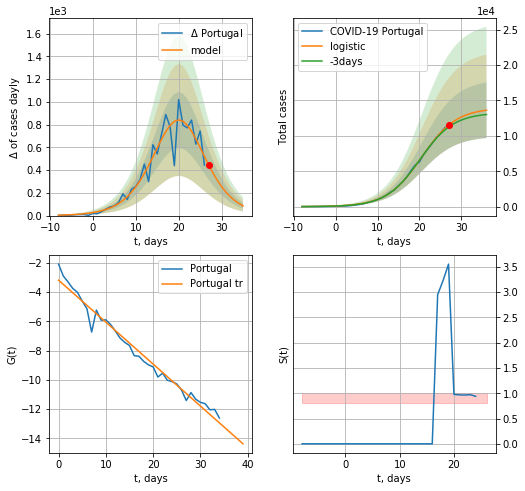

Portugal data at: 2020-06-11
+3 day model MAPE: 0.028768813359110825
model: logistic
coeffs:  [1.39435560e+04 2.41732854e-01 2.05234131e+01]
rational stdev:  0.2880659201380634
forecast at the end of period: +9 days
	 deltaDaycases:  85
	 total cases:  13620 ± 3923
	 total death:  570 ± 492
trend coefficient of determination: 0.976552
 intercept: -3.178197
 slope: -0.287215


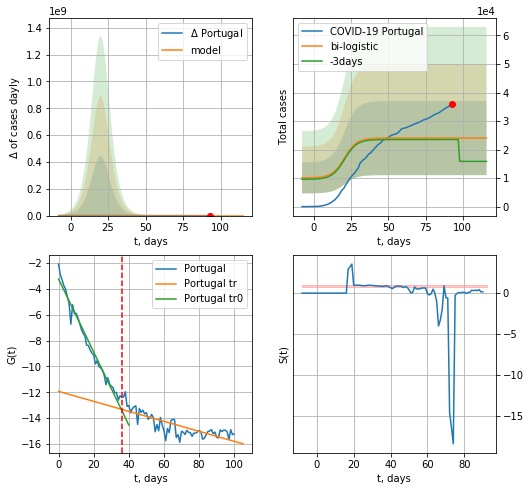

Portugal data at: 2020-06-11
+3 day model MAPE: 0.021905118979427488
model: bi-logistic
coeffs:  [8065.68127965  -31.32354685  144.4384015 ] [1.39435560e+04 2.41732854e-01 2.05234131e+01]
scenario coeffs:  [0.25, 1.0, 1.2]
rational stdev:  0.5406352584206859
forecast at the end of period: +23 days
	 deltaDaycases:  0
	 total cases:  24025 ± 12989
	 total death:  1006 ± 1631
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975262
 intercept: -3.226992
 slope: -0.282910
trend coefficient of determination: 0.629362
 intercept: -11.931909
 slope: -0.038685


In [170]:
vL = 36
dfPT = read_df(pd.DataFrame(),"PT")
x = forecast('Portugal',dfPT[:vL],d1,12*7-dT,1.)
xx=forecast2('Portugal',dfPT[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,1.2],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


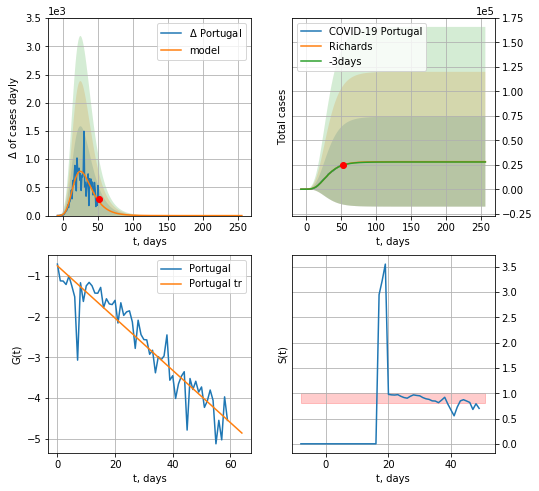

Portugal data at: 2020-06-11
+3 day model MAPE: 0.005985
model: Richards
coeffs: [ 2.81684838e+04  5.82693578e+00 -3.14773431e+01  1.30834824e-02]
rational stdev: 1.629434
forecast at the end of period: +205 days
	 deltaDaycases: 0
	 total cases: 28168 ± 45898
	 total death: 1179 ± 5763
trend coefficient of determination: 0.876328
 intercept: -0.753757
 slope: -0.064134


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


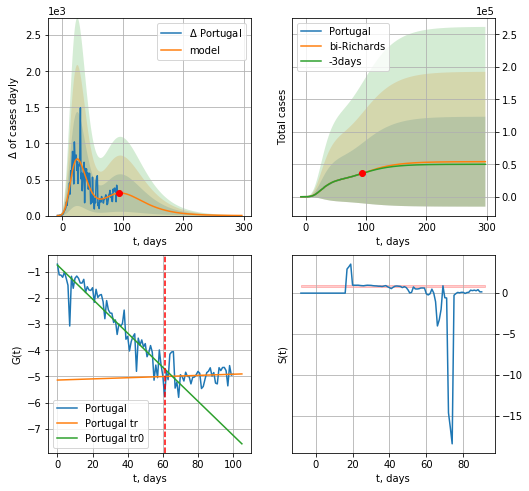

Portugal data at: 2020-06-11
+3 day model MAPE: 0.005298
model: bi-Richards
coeffs: [ 2.58072424e+04  2.15896525e+00 -3.13458584e+01  1.49593960e-02]
rational stdev: 1.281396
forecast at the end of period: +205 days
	 deltaDaycases: 1
	 total cases: 53934 ± 69111
	 total death: 2258 ± 8680
bi-Richards approximation splitting point: 61
trend coefficient of determination: 0.883402
 intercept: -0.749900
 slope: -0.064948
trend coefficient of determination: 0.004695
 intercept: -5.137030
 slope: 0.002223


In [171]:
vL=61
x = forecastRR('Portugal',dfPT[:vL],d1,40*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Portugal',dfPT[:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


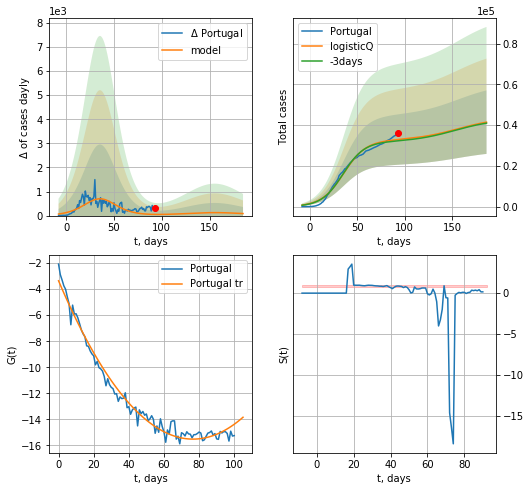

Portugal data at: 2020-06-11
+3 day model MAPE: 0.019150
model: logisticQ
coeffs: [ 3.24311444e+04  2.51358554e-07  3.57456657e+01 -3.41081292e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.375878
forecast at the end of period: +93 days
	 deltaDaycases: 84
	 total cases: 41462 ± 15584
	 total death: 1736 ± 1957
trend coefficient of determination: 0.980730
 intercept_: -3.3590018445761753
 coeffs_: [ 0.         -0.31750047  0.0020738 ]


In [172]:
x = forecastRRR('Portugal',dfPT[:],d1,24*7-dT,1.,addpred=True,xcoef=koreaCoeffs)

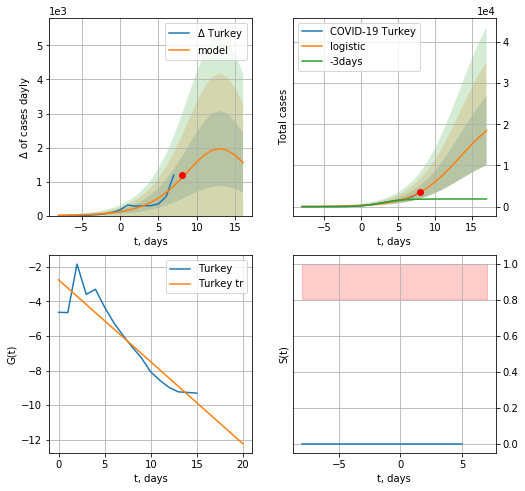

Turkey data at: 2020-06-11
+3 day model MAPE: 1.5246814929812549
model: logistic
coeffs:  [2.42672036e+04 3.25610640e-01 1.34529779e+01]
rational stdev:  0.45520286558776807
forecast at the end of period: +9 days
	 deltaDaycases:  1557
	 total cases:  18453 ± 8399
	 total death:  505 ± 689
trend coefficient of determination: 0.850665
 intercept: -2.746555
 slope: -0.474541


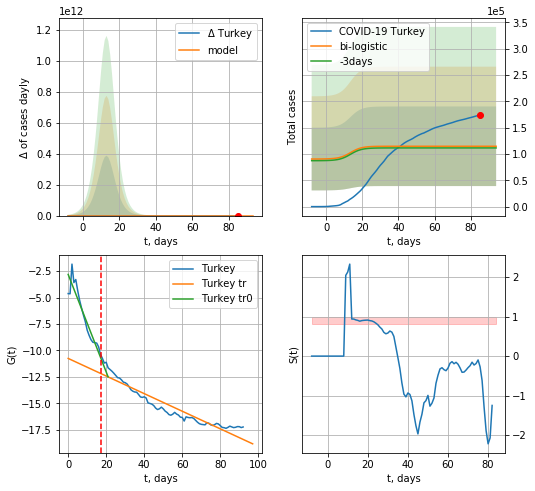

Turkey data at: 2020-06-11
+3 day model MAPE: 0.028292656279919615
model: bi-logistic
coeffs:  [ 7.22707724e+04 -3.30282370e+00  9.97368845e+01] [2.42672036e+04 3.25610640e-01 1.34529779e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.659339535547748
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  114605 ± 75564
	 total death:  3136 ± 6203
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.862807
 intercept: -2.813054
 slope: -0.461241
trend coefficient of determination: 0.891047
 intercept: -10.757221
 slope: -0.083252


In [173]:
vL=17
x = forecast('Turkey',dfTR[:vL],d1,7*12-dT,1.)
xx=forecast2('Turkey',dfTR[:],d1,12*7-dT,x,1.,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


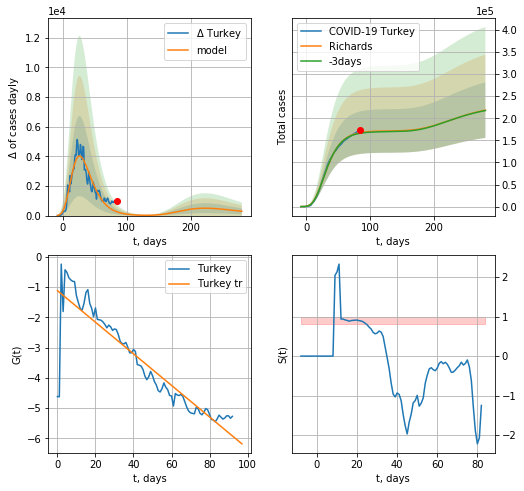

Turkey data at: 2020-06-11
+3 day model MAPE: 0.007831
model: Richards
coeffs: [ 1.71528564e+05  7.81229272e+00 -4.80157547e+01  8.19761592e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.287652
forecast at the end of period: +196 days
	 deltaDaycases: 291
	 total cases: 218424 ± 62830
	 total death: 5978 ± 5158
trend coefficient of determination: 0.830922
 intercept: -1.117829
 slope: -0.052167


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


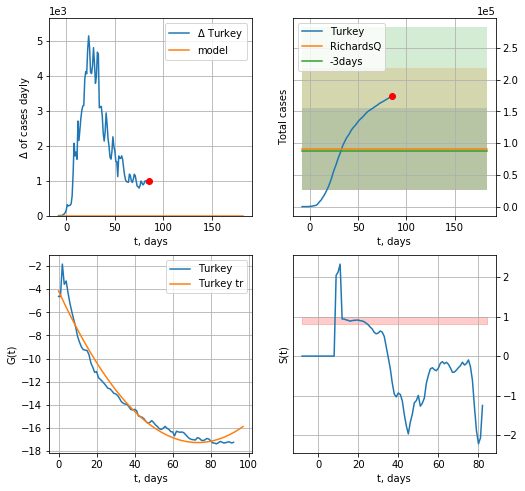

Turkey data at: 2020-06-11
+3 day model MAPE: 0.030734
model: RichardsQ
coeffs: [ 9.08699364e+04  2.63368382e+00 -8.98101616e+02  7.48596924e+02
 -1.51640757e+00]
rational stdev: 0.704019
forecast at the end of period: +98 days
	 deltaDaycases: 0
	 total cases: 90869 ± 63974
	 total death: 2487 ± 5252
trend coefficient of determination: 0.970492
 intercept_: -4.1622746574790686
 coeffs_: [ 0.         -0.35770266  0.00244273]


In [174]:
x = forecastRR('Turkey',dfTR[:],d1,28*7,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Turkey',dfTR[:],d1,14*7,1.,addpred=False,xcoef=[0.35,.5,3,1,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


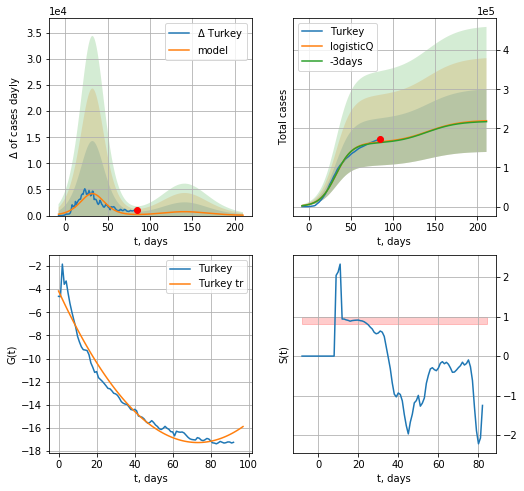

Turkey data at: 2020-06-11
+3 day model MAPE: 0.011410
model: logisticQ
coeffs: [ 1.63310109e+05  3.49004828e-07  3.24527330e+01 -2.94997446e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.363998
forecast at the end of period: +126 days
	 deltaDaycases: 79
	 total cases: 219615 ± 79939
	 total death: 6010 ± 6562
trend coefficient of determination: 0.970492
 intercept_: -4.1622746574790686
 coeffs_: [ 0.         -0.35770266  0.00244273]


In [175]:
x = forecastRRR('Turkey',dfTR[:],d1,18*7,1.,addpred=True,xcoef=koreaCoeffs)

#xx=forecast2R('Turkey',dfTR[:],d1,14*7-dT,x,1.)

In [176]:
dfTT[dfTT.Country=='%s'%("Latvia")][0].values[0]

0.02376599634369287

In [177]:
#trend3(dfPL[1:],dfIS[7:],dfSW,'PL','IS','SW',40,40,40)

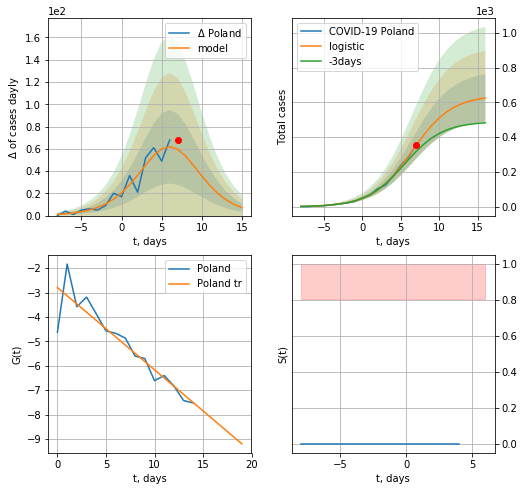

Poland data at: 2020-06-11
+3 day model MAPE: 0.14646234511665837
model: logistic
coeffs:  [6.41107567e+02 3.87606719e-01 6.46563498e+00]
rational stdev:  0.21770687952847212
forecast at the end of period: +9 days
	 deltaDaycases:  7
	 total cases:  625 ± 136
	 total death:  26 ± 16
trend coefficient of determination: 0.843228
 intercept: -2.795749
 slope: -0.337043


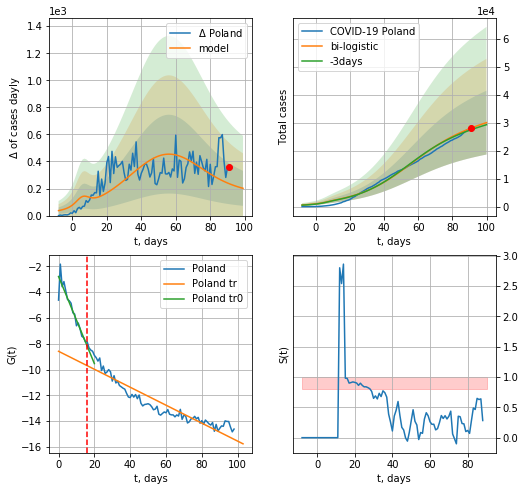

Poland data at: 2020-06-11
+3 day model MAPE: 0.021779909512061563
model: bi-logistic
coeffs:  [2.87147554e+04 6.13106868e-02 5.55108230e+01] [6.41107567e+02 3.87606719e-01 6.46563498e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.37985054289095205
forecast at the end of period: +9 days
	 deltaDaycases:  201
	 total cases:  30014 ± 11401
	 total death:  1293 ± 1473
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.867285
 intercept: -2.795308
 slope: -0.337138
trend coefficient of determination: 0.867908
 intercept: -8.587444
 slope: -0.069569


In [178]:
vL=16
vL1=38
x =  forecast('Poland',dfPL[:vL],d1,7*12-dT,1.)
xx = forecast2('Poland',dfPL[:],d1,12*7-dT,x,1.,vL=vL,addpred=True,xcoef=[0.25,1.,2.])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Poland",dfPL,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.5,1.,1.3],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


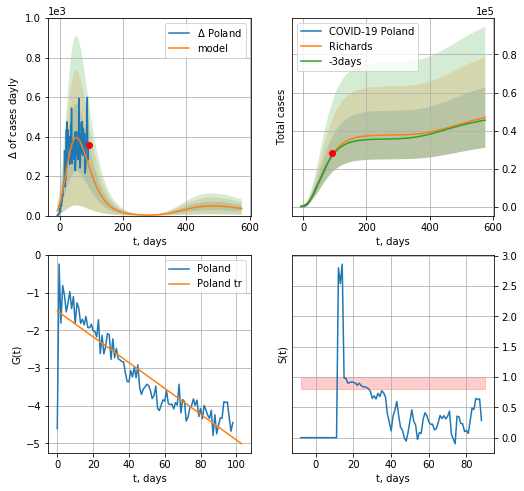

Poland data at: 2020-06-11
+3 day model MAPE: 0.018742
model: Richards
coeffs: [ 3.76987444e+04  3.30895520e+00 -1.13553372e+02  8.64986661e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.339013
forecast at the end of period: +485 days
	 deltaDaycases: 35
	 total cases: 46853 ± 15883
	 total death: 2018 ± 2052
trend coefficient of determination: 0.798491
 intercept: -1.487025
 slope: -0.034259


In [179]:
x =  forecastRR('Poland',dfPL[:],d1,80*7-dT,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2R('Poland',dfPL[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


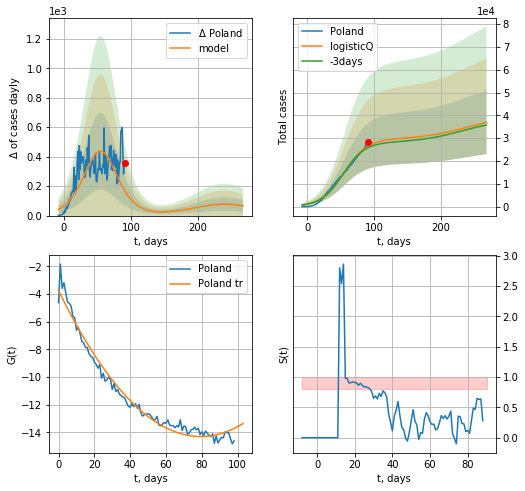

Poland data at: 2020-06-11
+3 day model MAPE: 0.029539
model: logisticQ
coeffs: [ 2.96065317e+04  3.34187694e-07  5.49315447e+01 -1.76203296e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.377424
forecast at the end of period: +177 days
	 deltaDaycases: 65
	 total cases: 36945 ± 13943
	 total death: 1591 ± 1801
trend coefficient of determination: 0.975153
 intercept_: -3.740978285528109
 coeffs_: [ 0.         -0.26609201  0.00167666]


In [180]:
x =  forecastRRR('Poland',dfPL[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

IS
           date    cases  active  death
106 2020-06-07  17915.0    2515  298.0
107 2020-06-08  18089.0    2654  298.0
108 2020-06-09  18268.0    2801  299.0
109 2020-06-10  18355.0    2888  299.0
110 2020-06-11  18701.0    3113  300.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


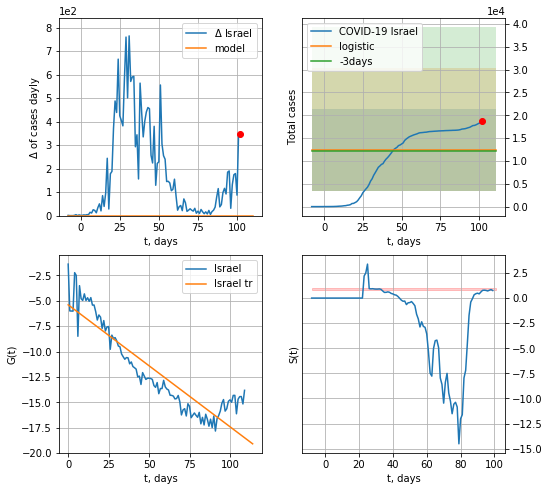

Israel data at: 2020-06-11
+3 day model MAPE: 0.024109979189975636
model: logistic
coeffs:  [ 9.98164028e+03 -4.45296495e+00  1.25591971e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.7183480779150769
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  12477 ± 8962
	 total death:  200 ± 431
trend coefficient of determination: 0.825666
 intercept: -5.399037
 slope: -0.120163


In [181]:
dfIS = read_df(pd.DataFrame(),"IS")
try:
    x = forecast('Israel',dfIS[:],d1,12*7-dT,addpred=True,xcoef=[0.25,1.,1.8])
except:
    print ("Exception occurs")
#xx = forecast2('Israel',dfIS[:],d1,20-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


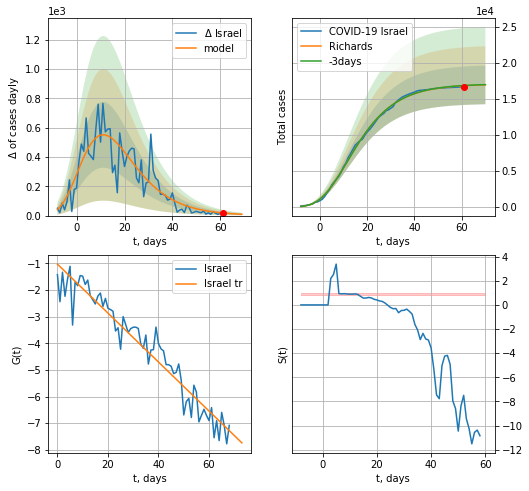

Israel data at: 2020-06-11
+3 day model MAPE: 0.001944
model: Richards
coeffs: [ 1.70515699e+04  6.43111297e+00 -3.67763089e+01  1.37701544e-02]
rational stdev: 0.158199
forecast at the end of period: +9 days
	 deltaDaycases: 8
	 total cases: 16954 ± 2682
	 total death: 271 ± 128
trend coefficient of determination: 0.925544
 intercept: -1.027514
 slope: -0.091953


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


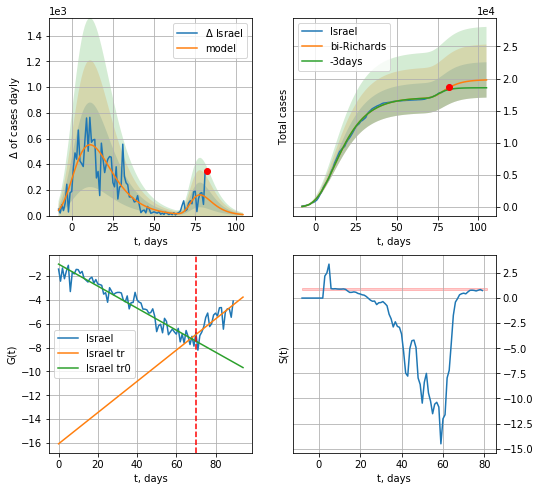

Israel data at: 2020-06-11
+3 day model MAPE: 0.020741
model: bi-Richards
coeffs: [2.78413955e+03 1.51384699e+01 4.87506562e+01 1.02089699e-02]
rational stdev: 0.139099
forecast at the end of period: +23 days
	 deltaDaycases: 7
	 total cases: 19785 ± 2752
	 total death: 317 ± 132
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.927874
 intercept: -0.987240
 slope: -0.092426
trend coefficient of determination: 0.584700
 intercept: -16.076771
 slope: 0.131072


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power


In [183]:
x = forecastRR('Israel',dfIS[20:90],d1,12*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Israel',dfIS[20:],d1,14*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=90-20)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


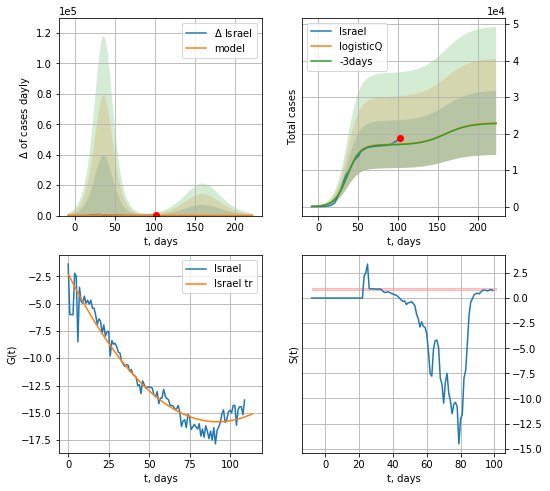

Israel data at: 2020-06-11
+3 day model MAPE: 0.007897
model: logisticQ
coeffs: [ 1.69888741e+04  5.18914471e-07  3.66935083e+01 -2.46383001e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.382709
forecast at the end of period: +121 days
	 deltaDaycases: 6
	 total cases: 22903 ± 8765
	 total death: 367 ± 421
trend coefficient of determination: 0.941707
 intercept_: -2.2874536907743117
 coeffs_: [ 0.        -0.2930341  0.001586 ]


In [184]:
x = forecastRRR('Israel',dfIS[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


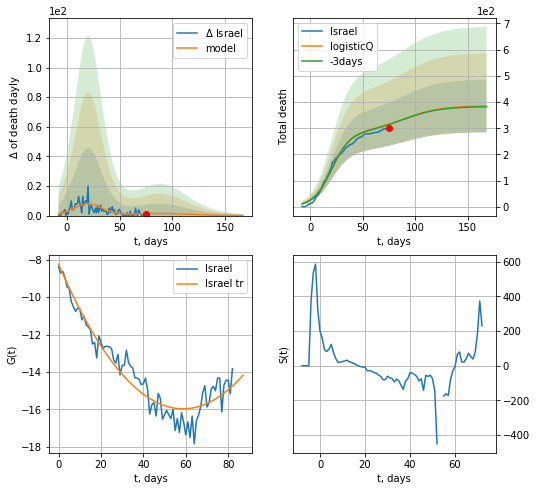

Israel data at: 2020-06-11
+3 day model MAPE: 0.004913
model: logisticQ
coeffs: [ 2.85216568e+02  4.56916087e-07  2.04676141e+01 -2.45572760e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.261086
forecast at the end of period: +93 days
	 total death: 385 ± 100
trend coefficient of determination: 0.917974
 intercept_: -8.240246615847038
 coeffs_: [ 0.         -0.26330038  0.00224245]


In [185]:
x = forecastRRR('Israel',dfIS[27:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


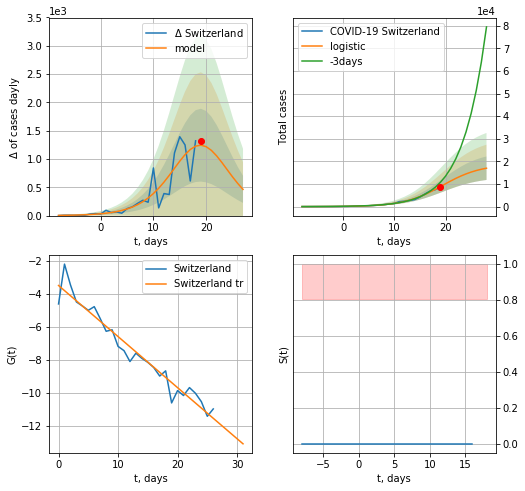

Switzerland data at: 2020-06-11
+3 day model MAPE: 0.24949892382467553
model: logistic
coeffs:  [1.87061213e+04 2.66466230e-01 1.93986309e+01]
rational stdev:  0.30604789910568747
forecast at the end of period: +9 days
	 deltaDaycases:  463
	 total cases:  16989 ± 5199
	 total death:  1060 ± 973
trend coefficient of determination: 0.944448
 intercept: -3.508672
 slope: -0.309041


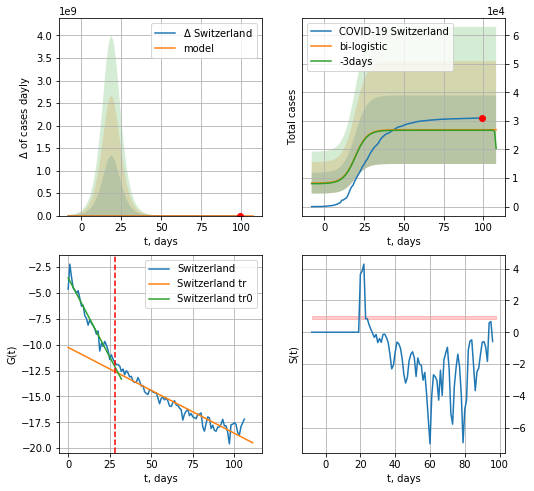

Switzerland data at: 2020-06-11
+3 day model MAPE: 0.007659047996967061
model: bi-logistic
coeffs:  [ 6.57734652e+03 -1.76076180e+00  1.15506617e+02] [1.87061213e+04 2.66466230e-01 1.93986309e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.44556044180562665
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  26927 ± 11997
	 total death:  1680 ± 2245
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.947988
 intercept: -3.537068
 slope: -0.305765
trend coefficient of determination: 0.911356
 intercept: -10.264596
 slope: -0.082952


In [186]:
vL= 28
x = forecast('Switzerland',dfSZ[:vL],d1,7*12-dT)
xx = forecast2('Switzerland',dfSZ[:],d1,7*12-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,2.])#,addpred=False,xcoef=[0.25,1.,2.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


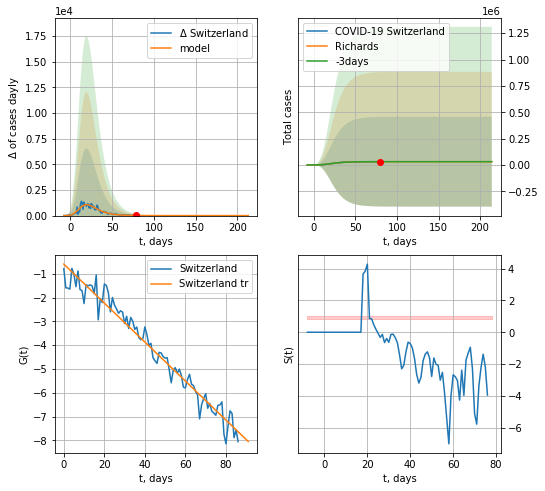

Switzerland data at: 2020-06-11
+3 day model MAPE: 0.000772
model: Richards
coeffs: [ 3.06769246e+04  8.46142050e+00 -2.74515948e+01  1.12531672e-02]
rational stdev: 13.897646
forecast at the end of period: +135 days
	 deltaDaycases: 0
	 total cases: 30676 ± 426337
	 total death: 1914 ± 79800
trend coefficient of determination: 0.961019
 intercept: -0.597072
 slope: -0.081842


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


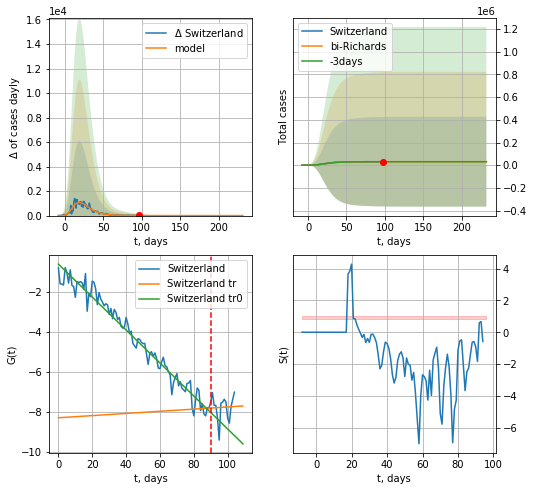

Switzerland data at: 2020-06-11
+3 day model MAPE: 0.010156
model: bi-Richards
coeffs: [4.57598832e+02 4.60184966e+00 2.01862330e+01 1.53726132e-02]
rational stdev: 12.707253
forecast at the end of period: +135 days
	 deltaDaycases: 0
	 total cases: 31134 ± 395634
	 total death: 1942 ± 74032
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.964895
 intercept: -0.618628
 slope: -0.082255
trend coefficient of determination: 0.001460
 intercept: -8.284870
 slope: 0.005392


In [187]:
iL = 2
vL = 90 + iL
x = forecastRR('Switzerland',dfSZ[iL:vL-iL],d1,7*30-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Switzerland',dfSZ[iL:],d1,7*30-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#xx = forecastR('Switzerland',dfSZ[:],d1,7*5-dT,x,vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


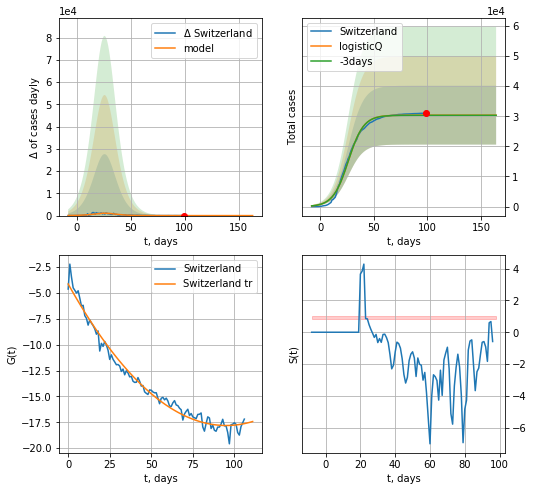

Switzerland data at: 2020-06-11
+3 day model MAPE: 0.001546
model: logisticQ
coeffs: [ 3.03527939e+04  5.90014935e-07  2.62028402e+01 -2.38025678e+05]
rational stdev: 0.321667
forecast at the end of period: +65 days
	 deltaDaycases: 0
	 total cases: 30352 ± 9763
	 total death: 1893 ± 1826
trend coefficient of determination: 0.981191
 intercept_: -4.138496582184251
 coeffs_: [ 0.         -0.28755806  0.00151245]


In [188]:
x = forecastRRR('Switzerland',dfSZ[:],d1,7*20-dT,addpred=False,xcoef=koreaCoeffs)

In [189]:
#trend3(dfUR[5:],dfIN[7:],dfRS[5:],'UR','IN','RS',40,40,40)

Ukr
          date    cases  active  death
89 2020-06-07  26999.0   14470  797.0
90 2020-06-08  27462.0   14634  810.0
91 2020-06-09  27856.0   14634  810.0
92 2020-06-10  28381.0   14779  833.0
93 2020-06-11  29070.0   15316  870.0


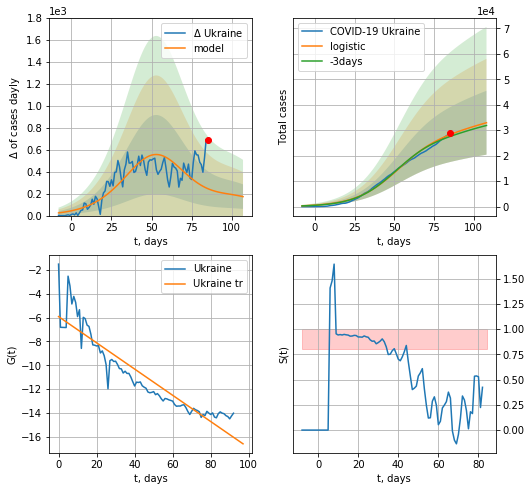

Ukraine data at: 2020-06-11
+3 day model MAPE: 0.027101742031938988
model: logistic
coeffs:  [2.94263807e+04 7.40263152e-02 5.28283429e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.38083903366763383
forecast at the end of period: +23 days
	 deltaDaycases:  172
	 total cases:  32935 ± 12543
	 total death:  963 ± 1100
trend coefficient of determination: 0.856375
 intercept: -5.908759
 slope: -0.110123


In [193]:
dfUR = read_df(pd.DataFrame(),"Ukr")
try:
    x=forecast('Ukraine',dfUR[:],d1,14*7-dT,addpred=True,xcoef=[0.25,1.,2.])
except:
      print("Exaption occurs") 

#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


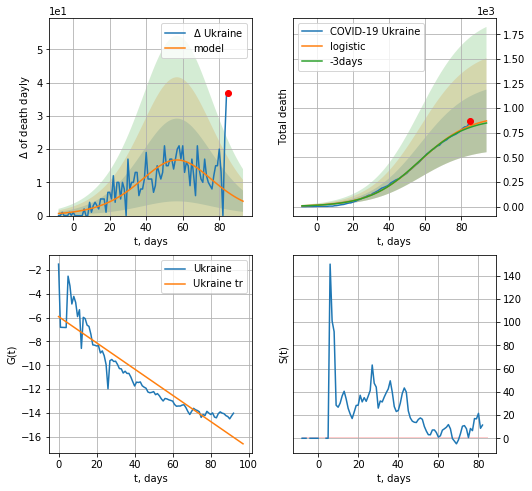

Ukraine data at: 2020-06-11
+3 day model MAPE: 0.019800962364995765
model: logistic
coeffs:  [9.32945518e+02 7.17327784e-02 5.73121922e+01]
rational stdev:  0.365505638902375
forecast at the end of period: +9 days
	 total death:  870 ± 318
trend coefficient of determination: 0.856375
 intercept: -5.908759
 slope: -0.110123


In [194]:
x=forecast('Ukraine',dfUR[:],d1,12*7-dT,addpred=False,xcoef=[0.25,1.,2.],cases='death')
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


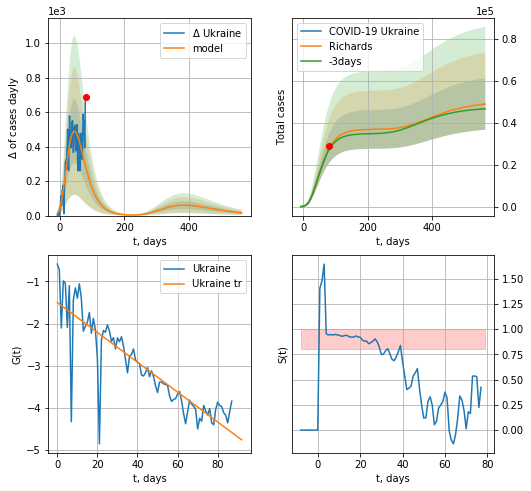

Ukraine data at: 2020-06-11
+3 day model MAPE: 0.020584
model: Richards
coeffs: [ 3.69324503e+04  3.70808393e+00 -8.24665227e+01  9.76087661e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.250747
forecast at the end of period: +485 days
	 deltaDaycases: 16
	 total cases: 48942 ± 12272
	 total death: 1431 ± 1076
trend coefficient of determination: 0.755745
 intercept: -1.501053
 slope: -0.035459


In [195]:
x=forecastRR('Ukraine',dfUR[5:],d1,7*80-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


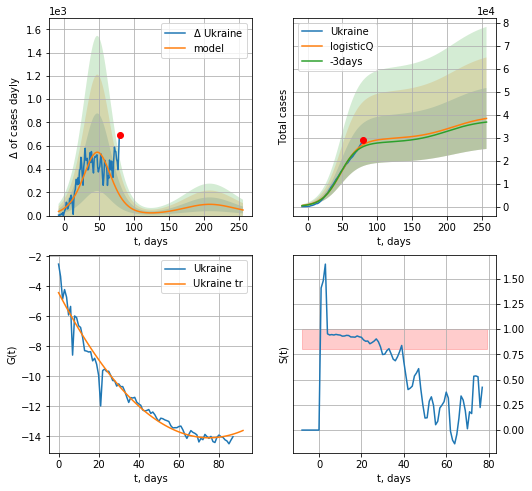

Ukraine data at: 2020-06-11
+3 day model MAPE: 0.034482
model: logisticQ
coeffs: [ 2.94702963e+04  5.10320185e-07  4.78812900e+01 -1.44520489e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.346070
forecast at the end of period: +177 days
	 deltaDaycases: 48
	 total cases: 38417 ± 13295
	 total death: 1123 ± 1165
trend coefficient of determination: 0.962980
 intercept_: -4.4181615264141945
 coeffs_: [ 0.         -0.25747215  0.00171321]


In [196]:
x=forecastRRR('Ukraine',dfUR[5:],d1,7*36-dT,addpred=True,xcoef=koreaCoeffs)

In [197]:
#np.log(np.diff(dfIS["cases"].values)[:]/dfIS["cases"].values[1:]**2)

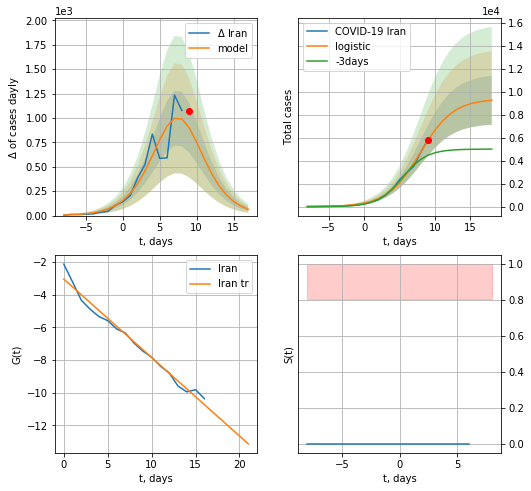

Iran data at: 2020-06-11
+3 day model MAPE: 0.41768987892528675
model: logistic
coeffs:  [9.38566037e+03 4.29600563e-01 7.92981697e+00]
rational stdev:  0.2297342175744371
forecast at the end of period: +9 days
	 deltaDaycases:  64
	 total cases:  9263 ± 2128
	 total death:  441 ± 303
trend coefficient of determination: 0.980602
 intercept: -3.037586
 slope: -0.480406


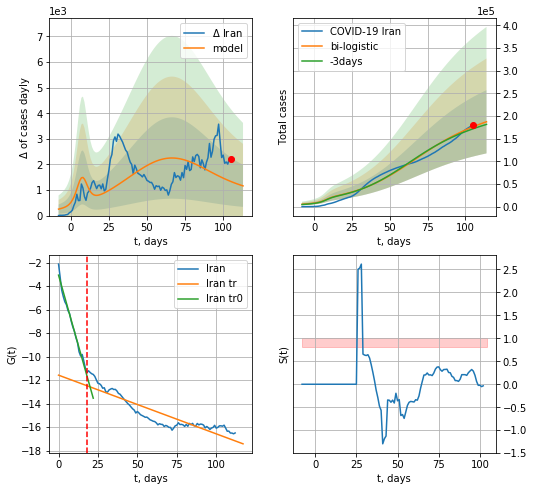

Iran data at: 2020-06-11
+3 day model MAPE: 0.026508619854489407
model: bi-logistic
coeffs:  [1.79514167e+05 4.81805322e-02 6.52418293e+01] [9.38566037e+03 4.29600563e-01 7.92981697e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.37273766018008225
forecast at the end of period: +9 days
	 deltaDaycases:  1161
	 total cases:  187228 ± 69786
	 total death:  8920 ± 9974
bi-logistic approximation splitting point: 18
trend0 coefficient of determination: 0.982944
 intercept: -3.059655
 slope: -0.476268
trend coefficient of determination: 0.811889
 intercept: -11.577713
 slope: -0.049972


In [198]:
x = forecast('Iran',dfIN[:18],d1,7*12-dT)
xx = forecast2('Iran',dfIN[:],d1,12*7-dT,x,vL=18,addpred=True,xcoef=[0.25,1.,2.0])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


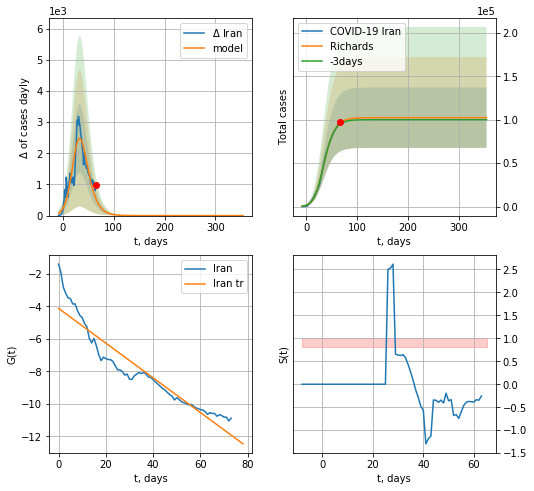

Iran data at: 2020-06-11
+3 day model MAPE: 0.012009
model: Richards
coeffs: [1.02478153e+05 1.52216321e-01 2.65523922e+01 5.45962709e-01]
rational stdev: 0.339941
forecast at the end of period: +289 days
	 deltaDaycases: 0
	 total cases: 102478 ± 34836
	 total death: 4882 ± 4978
trend coefficient of determination: 0.893485
 intercept: -4.118017
 slope: -0.106957


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


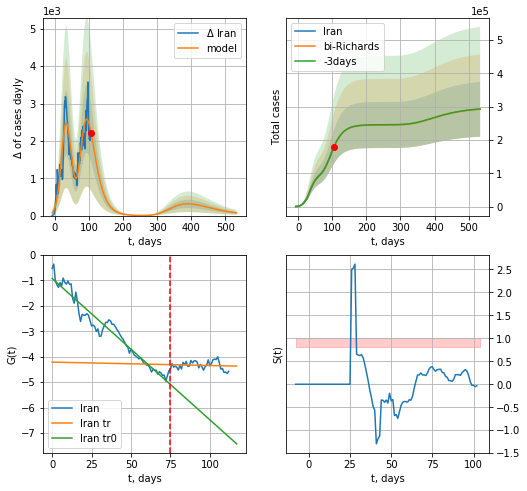

Iran data at: 2020-06-11
+3 day model MAPE: 0.000572
model: bi-Richards
coeffs: [1.42581873e+05 3.36249100e+00 7.22247375e+00 1.44269869e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.282241
forecast at the end of period: +429 days
	 deltaDaycases: 73
	 total cases: 292120 ± 82448
	 total death: 13918 ± 11784
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.949243
 intercept: -0.932714
 slope: -0.055419
trend coefficient of determination: 0.008305
 intercept: -4.210785
 slope: -0.001340


In [199]:
vL = 75
x = forecastRR('Iran',dfIN[:vL],d1,52*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Iran',dfIN[:],d1,72*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


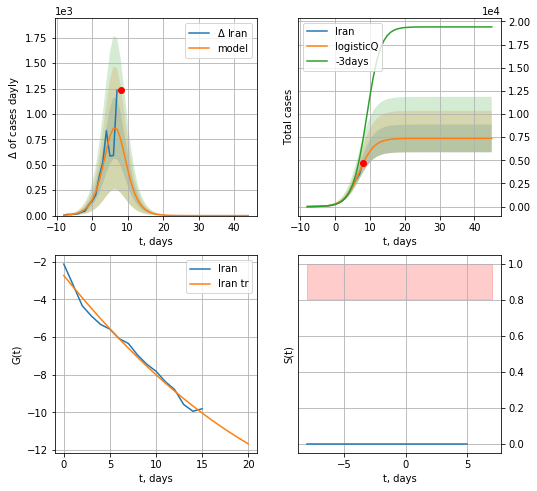

Iran data at: 2020-06-11
+3 day model MAPE: 0.437963
model: logisticQ
coeffs: [ 7.36885538e+03  7.42900276e-05 -6.37012173e+03  6.90117085e+00]
rational stdev: 0.203007
forecast at the end of period: +37 days
	 deltaDaycases: 0
	 total cases: 7368 ± 1495
	 total death: 351 ± 213
trend coefficient of determination: 0.985826
 intercept_: -2.7244557798652984
 coeffs_: [ 0.         -0.60810956  0.00802289]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


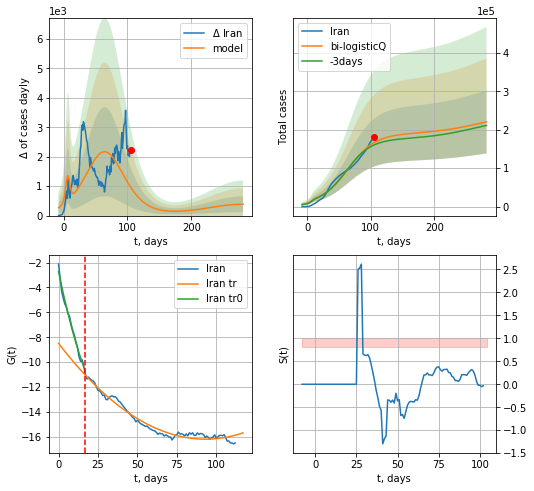

Iran data at: 2020-06-11
+3 day model MAPE: 0.038818
model: bi-logisticQ
coeffs: [ 1.81163629e+05  1.67189775e-07  6.45457528e+01 -2.85256961e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.373148
forecast at the end of period: +177 days
	 deltaDaycases: 385
	 total cases: 220866 ± 82416
	 total death: 10523 ± 11779
bi-logisticQ approximation splitting point: 17
trend coefficient of determination: 0.987745
 intercept_: -2.720144864989817
 coeffs_: [ 0.         -0.61067547  0.00823538]
trend coefficient of determination: 0.967081
 intercept_: -8.493119729756964
 coeffs_: [ 0.         -0.1653295   0.00088698]


In [200]:
x = forecastRRR('Iran',dfIN[:17],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Iran',dfIN[:],d1,36*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=17)

RS
           date     cases  active   death
99  2020-06-07  467673.0  239999  5971.0
100 2020-06-08  476658.0  239999  5971.0
101 2020-06-09  485253.0  236714  6142.0
102 2020-06-10  493657.0  234516  6358.0
103 2020-06-11  502436.0  234754  6532.0


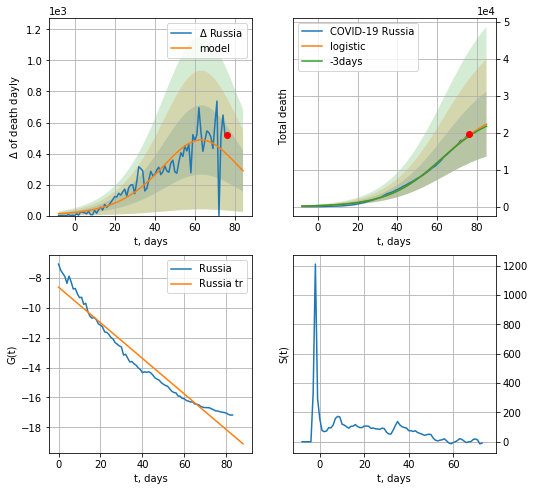

Russia data at: 2020-06-11
+3 day model MAPE: 0.016678778617666118
model: logistic
coeffs:  [2.70455219e+04 7.20800391e-02 6.35176432e+01]
rational stdev:  0.3932005534871819
forecast at the end of period: +9 days
	 total death:  22304 ± 8770
trend coefficient of determination: 0.949122
 intercept: -8.621208
 slope: -0.119092


In [201]:
dfRS = read_df(pd.DataFrame(),"RS")
x = forecast('Russia',dfRS[19:],d1,12*7-dT,shift=3.,cases='death')
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


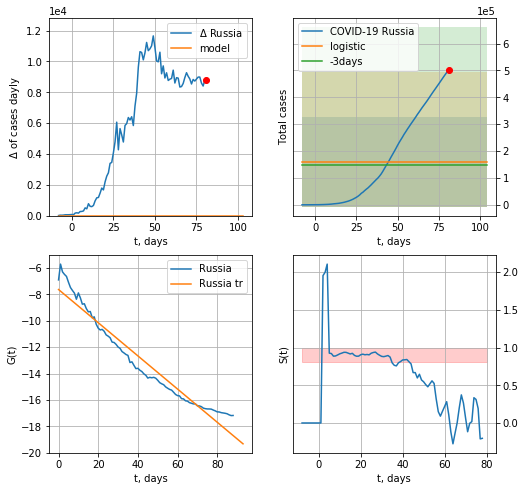

Russia data at: 2020-06-11
+3 day model MAPE: 0.07712913403850427
model: logistic
coeffs:  [ 1.60497045e+05 -4.83691117e+00  1.31300193e+02]
rational stdev:  1.0414496566647111
forecast at the end of period: +23 days
	 deltaDaycases:  0
	 total cases:  160497 ± 167149
	 total death:  2086 ± 6517
trend coefficient of determination: 0.946790
 intercept: -7.629295
 slope: -0.125727


In [202]:
x = forecast('Russia',dfRS[14:],d1,14*7-dT,shift=1.)
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14,shift=1.)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


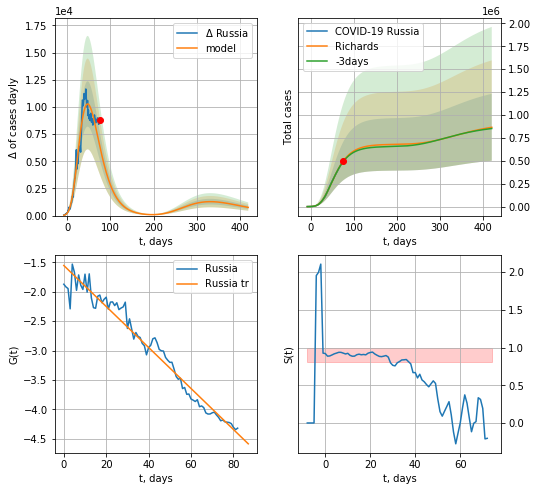

Russia data at: 2020-06-11
+3 day model MAPE: 0.010680
model: Richards
coeffs: [ 6.80622939e+05  2.01055774e+00 -4.59783928e+01  2.06210320e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.421818
forecast at the end of period: +345 days
	 deltaDaycases: 753
	 total cases: 865963 ± 365279
	 total death: 11258 ± 14246
trend coefficient of determination: 0.963345
 intercept: -1.552839
 slope: -0.034842


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


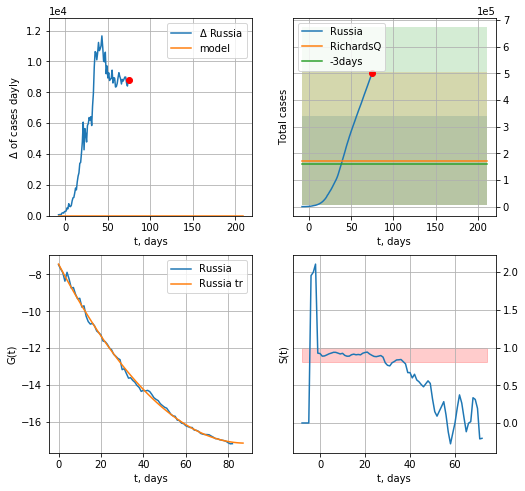

Russia data at: 2020-06-11
+3 day model MAPE: 0.074482
model: RichardsQ
coeffs: [ 1.71953118e+05  9.90336593e+00 -1.73462021e+03  1.46900339e+03
 -3.75941832e+00]
rational stdev: 0.972535
forecast at the end of period: +135 days
	 deltaDaycases: 0
	 total cases: 171953 ± 167230
	 total death: 2235 ± 6520
trend coefficient of determination: 0.998103
 intercept_: -7.440966578993789
 coeffs_: [ 0.         -0.21949756  0.00124111]


In [203]:
x = forecastRR('Russia',dfRS[20:],d1,60*7-dT,addpred=True,xcoef=RkoreaCoeffs)#,addpred=True,xcoef=[0.25,1.,1.5,1]
x = forecastQR('Russia',dfRS[20:],d1,30*7-dT)#,addpred=True,xcoef=[0.25,1.,1.5,1]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


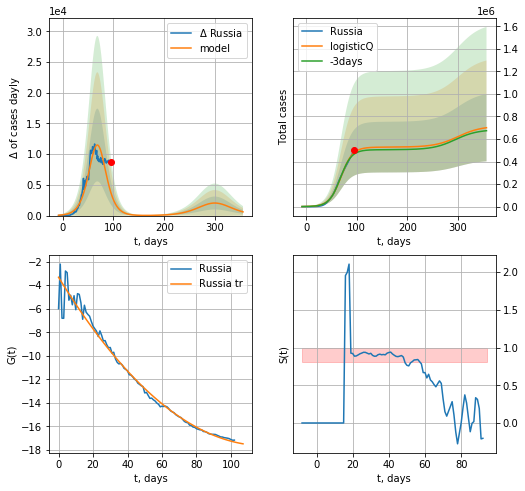

Russia data at: 2020-06-11
+3 day model MAPE: 0.028087
model: logisticQ
coeffs: [ 5.27872267e+05  9.16107216e-07  6.87870928e+01 -9.49567953e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.425946
forecast at the end of period: +261 days
	 deltaDaycases: 604
	 total cases: 700107 ± 298207
	 total death: 9101 ± 11629
trend coefficient of determination: 0.978026
 intercept_: -3.325204238260385
 coeffs_: [ 0.         -0.23925857  0.00099905]


In [204]:
x = forecastRRR('Russia',dfRS[:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

JP
           date    cases  active  death
137 2020-06-07  17141.0    1086  916.0
138 2020-06-08  17174.0    1110  916.0
139 2020-06-09  17210.0    1081  916.0
140 2020-06-10  17251.0    1034  919.0
141 2020-06-11  17292.0     989  920.0


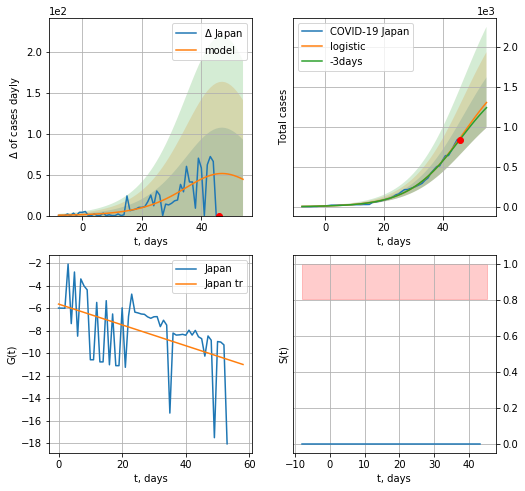

Japan data at: 2020-06-11
+3 day model MAPE: 0.0244139001087548
model: logistic
coeffs:  [1.86668601e+03 1.09971339e-01 4.74124632e+01]
rational stdev:  0.24188431663406776
forecast at the end of period: +9 days
	 deltaDaycases:  44
	 total cases:  1301 ± 314
	 total death:  69 ± 50
trend coefficient of determination: 0.226001
 intercept: -5.646499
 slope: -0.092589


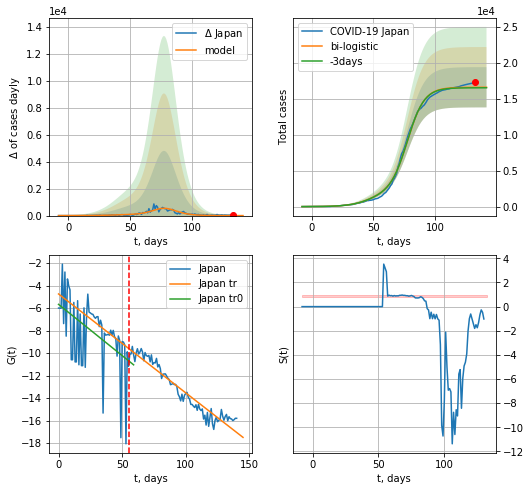

Japan data at: 2020-06-11
+3 day model MAPE: 0.004336076220481349
model: bi-logistic
coeffs:  [1.47573272e+04 1.44689492e-01 7.77625269e+01] [1.86668601e+03 1.09971339e-01 4.74124632e+01]
rational stdev:  0.168553085350741
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  16622 ± 2801
	 total death:  884 ± 447
bi-logistic approximation splitting point: 55
trend0 coefficient of determination: 0.229818
 intercept: -5.672459
 slope: -0.091119
trend coefficient of determination: 0.919196
 intercept: -4.748243
 slope: -0.087923


In [205]:
dfJP = read_df(pd.DataFrame(),"JP")
try:
    x = forecast('Japan',dfJP[:55],d1,7*12-dT)
    xx = forecast2('Japan',dfJP[:],d1,12*7-dT,x,addpred=False,xcoef=[0.25,1.,1.25],vL=55)
except:
    print ("Exception occurs")

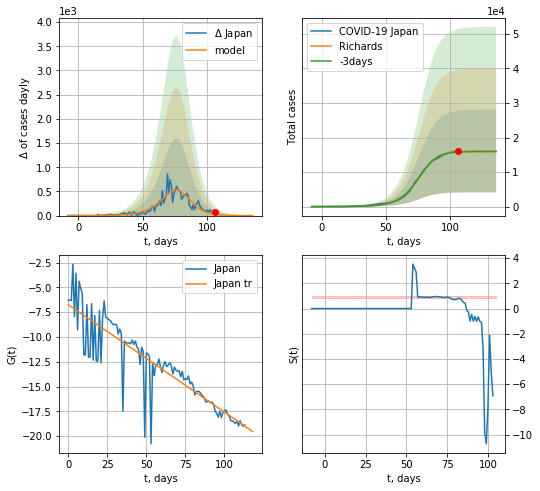

Japan data at: 2020-06-11
+3 day model MAPE: 0.009396
model: Richards
coeffs: [1.61043526e+04 1.05070375e-01 7.85362634e+01 1.40112813e+00]
rational stdev: 0.743333
forecast at the end of period: +30 days
	 deltaDaycases: 0
	 total cases: 16101 ± 11969
	 total death: 856 ± 1908
trend coefficient of determination: 0.778576
 intercept: -6.726919
 slope: -0.108522


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


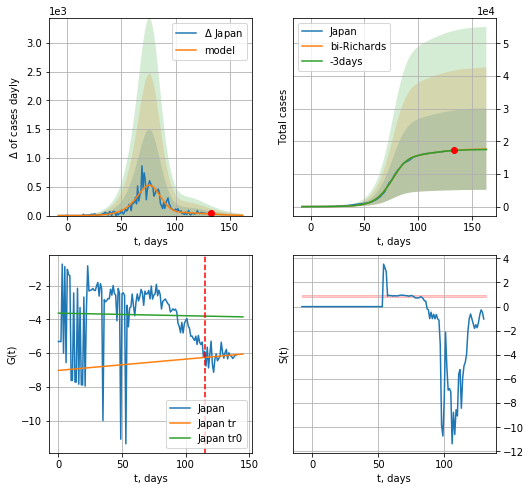

Japan data at: 2020-06-11
+3 day model MAPE: 0.003030
model: bi-Richards
coeffs: [1.58112331e+03 1.02939991e+01 4.45938658e+01 6.73229845e-03]
rational stdev: 0.708315
forecast at the end of period: +30 days
	 deltaDaycases: 4
	 total cases: 17622 ± 12482
	 total death: 937 ± 1991
bi-Richards approximation splitting point: 115
trend coefficient of determination: 0.000612
 intercept: -3.628584
 slope: -0.001515
trend coefficient of determination: 0.015029
 intercept: -7.025409
 slope: 0.006680


In [206]:
vL = 115
x = forecastRR('Japan',dfJP[:vL],d1,15*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Japan',dfJP[:],d1,15*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


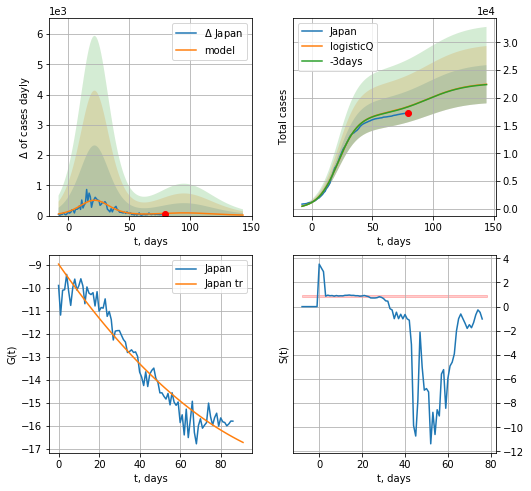

Japan data at: 2020-06-11
+3 day model MAPE: 0.002437
model: logisticQ
coeffs: [ 1.67976554e+04  1.90040759e-06  2.18696765e+01 -6.31922445e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.153531
forecast at the end of period: +65 days
	 deltaDaycases: 17
	 total cases: 22448 ± 3446
	 total death: 1194 ± 549
trend coefficient of determination: 0.933368
 intercept_: -8.962013196028126
 coeffs_: [ 0.         -0.12658079  0.00045314]


In [207]:
x = forecastRRR('Japan',dfJP[54:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


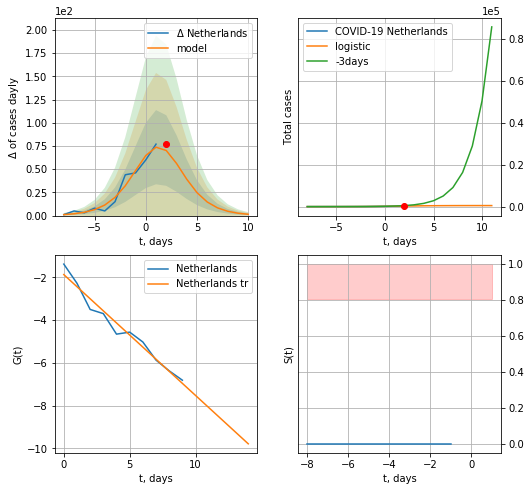

Netherlands data at: 2020-06-11
model: logistic
coeffs:  [487.74708253   0.61204074   1.72557629]
rational stdev:  0.23761280835096962
forecast at the end of period: +9 days
	 deltaDaycases:  1
	 total cases:  486 ± 115
	 total death:  60 ± 42
trend coefficient of determination: 0.966773
 intercept: -1.876651
 slope: -0.565279


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


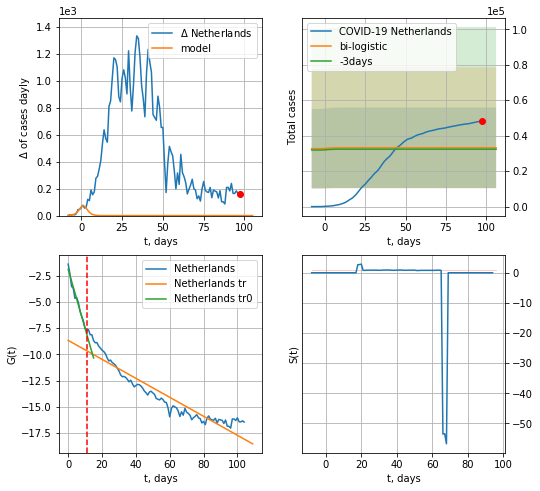

Netherlands data at: 2020-06-11
+3 day model MAPE: 0.024144093595546222
model: bi-logistic
coeffs:  [ 2.61283472e+04 -5.32857272e+00  1.58431755e+02] [487.74708253   0.61204074   1.72557629]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.6855142531441777
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  33148 ± 22723
	 total death:  4152 ± 8538
bi-logistic approximation splitting point: 11
trend0 coefficient of determination: 0.974821
 intercept: -1.878275
 slope: -0.564738
trend coefficient of determination: 0.889672
 intercept: -8.666222
 slope: -0.090638


In [208]:
vL=11
vL1=32
x = forecast('Netherlands',dfNL[:vL],d1,12*7-dT,pMAPE=False)
xx = forecast2('Netherlands',dfNL[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

NL
           date  cases  active   death
101 2020-06-07  47574       0  6013.0
102 2020-06-08  47739       0  6016.0
103 2020-06-09  47903       0  6031.0
104 2020-06-10  48087       0  6042.0
105 2020-06-11  48251       0  6044.0


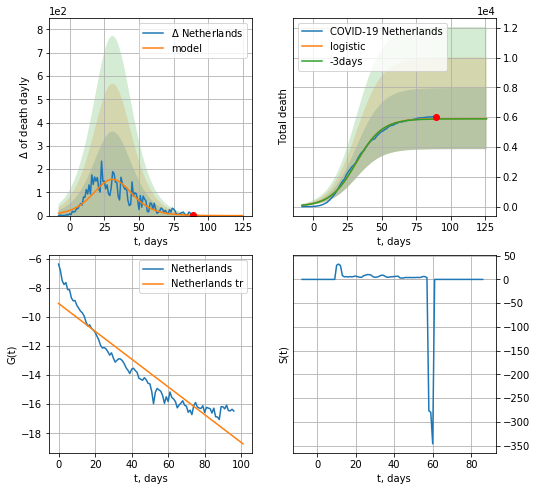

Netherlands data at: 2020-06-11
+3 day model MAPE: 0.0034199724897427
model: logistic
coeffs:  [5.90622934e+03 1.05488209e-01 3.14112451e+01]
rational stdev:  0.34699776782940683
forecast at the end of period: +37 days
	 total death:  5905 ± 2049
trend coefficient of determination: 0.886634
 intercept: -9.081549
 slope: -0.095430


In [209]:
dfNL = read_df(pd.DataFrame(),"NL")
x = forecast('Netherlands',dfNL[8:],d1,16*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


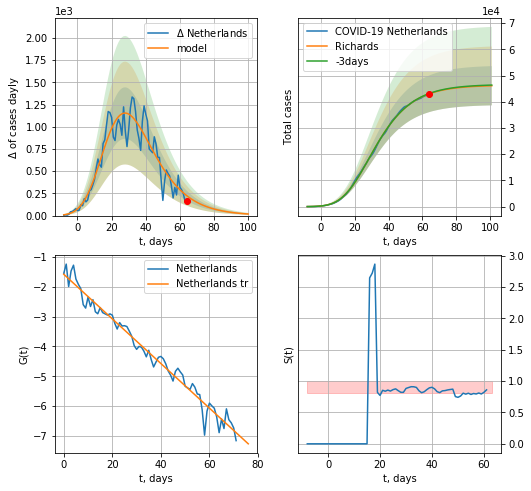

Netherlands data at: 2020-06-11
+3 day model MAPE: 0.002842
model: Richards
coeffs: [4.63365786e+04 4.92236139e-01 2.02382698e+00 1.47660483e-01]
rational stdev: 0.162270
forecast at the end of period: +37 days
	 deltaDaycases: 17
	 total cases: 46101 ± 7480
	 total death: 5774 ± 2810
trend coefficient of determination: 0.973735
 intercept: -1.579499
 slope: -0.074799


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power


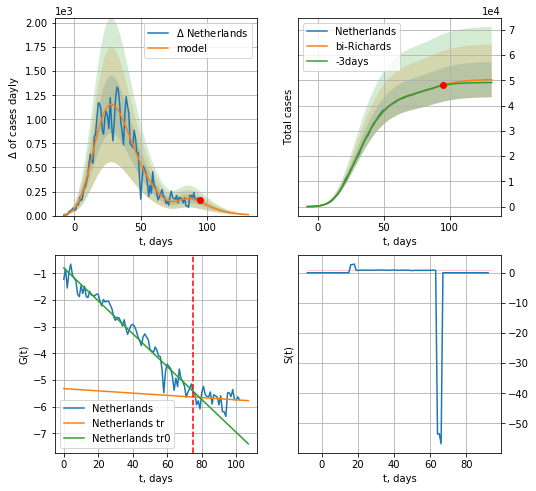

Netherlands data at: 2020-06-11
+3 day model MAPE: 0.005347
model: bi-Richards
coeffs: [4.00804523e+03 1.53485325e+01 3.18607408e+01 5.84269522e-03]
rational stdev: 0.138640
forecast at the end of period: +37 days
	 deltaDaycases: 9
	 total cases: 50234 ± 6964
	 total death: 6292 ± 2616
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.959521
 intercept: -0.795591
 slope: -0.061626
trend coefficient of determination: 0.016630
 intercept: -5.319229
 slope: -0.004208


In [210]:
vL = 75
x = forecastRR('Netherlands',dfNL[2:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Netherlands',dfNL[2:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


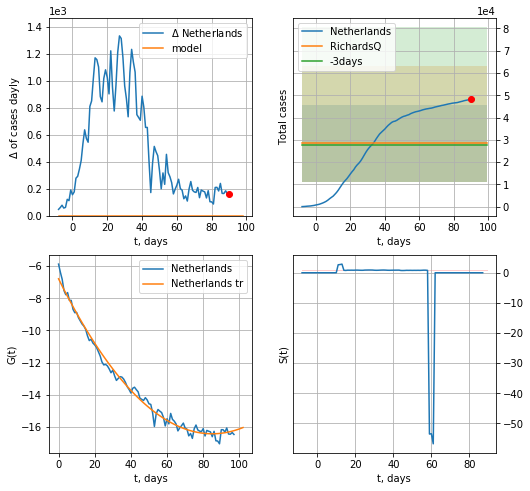

Netherlands data at: 2020-06-11
+3 day model MAPE: 0.022044
model: RichardsQ
coeffs: [ 2.84466465e+04  2.00438594e-01 -1.20485949e+03  1.00795227e+03
 -1.44621469e+00]
rational stdev: 0.611982
forecast at the end of period: +9 days
	 deltaDaycases: 0
	 total cases: 28446 ± 17408
	 total death: 3563 ± 6541
trend coefficient of determination: 0.990146
 intercept_: -6.788836548213837
 coeffs_: [ 0.         -0.22687496  0.0013353 ]


In [211]:
x = forecastQR('Netherlands',dfNL[7:],d1,12*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


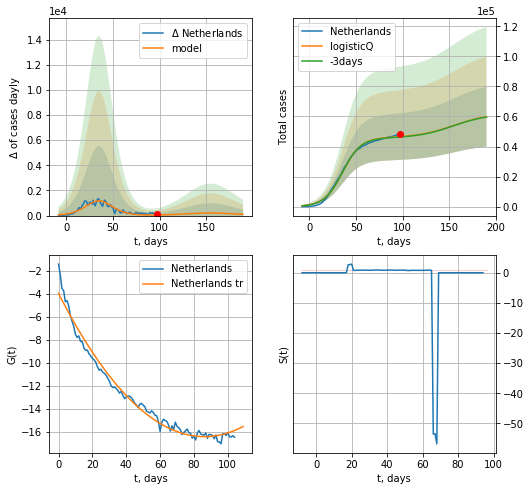

Netherlands data at: 2020-06-11
+3 day model MAPE: 0.006097
model: logisticQ
coeffs: [ 4.58951292e+04  4.63624754e-07  3.55167169e+01 -2.20018058e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.332941
forecast at the end of period: +93 days
	 deltaDaycases: 102
	 total cases: 59856 ± 19928
	 total death: 7497 ± 7488
trend coefficient of determination: 0.979222
 intercept_: -3.942361771548665
 coeffs_: [ 0.         -0.28972288  0.00168145]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


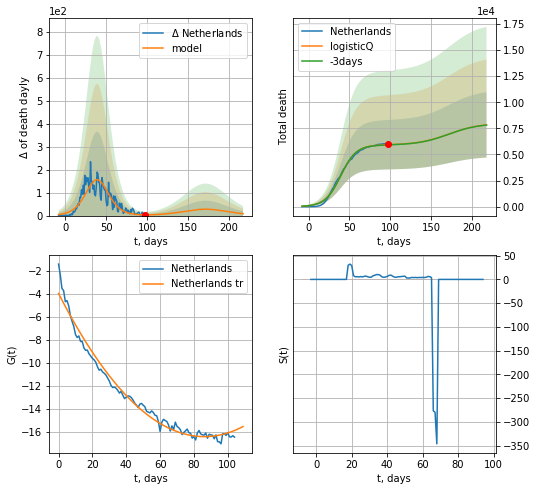

Netherlands data at: 2020-06-11
+3 day model MAPE: 0.003471
model: logisticQ
coeffs: [ 5.90441486e+03  5.21462994e-07  3.94063551e+01 -2.02669590e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.399453
forecast at the end of period: +121 days
	 total death: 7830 ± 3128
trend coefficient of determination: 0.979222
 intercept_: -3.942361771548665
 coeffs_: [ 0.         -0.28972288  0.00168145]


In [212]:
x = forecastRRR('Netherlands',dfNL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Netherlands',dfNL[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

In [213]:
#trend3(dfAT[1:],dfSG[:],dfBG[:],'AT','SG','BG',40,35,35)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


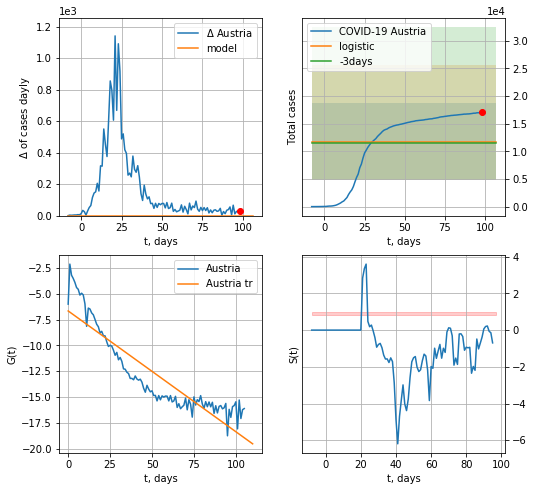

Austria data at: 2020-06-11
+3 day model MAPE: 0.01582843605565168
model: logistic
coeffs:  [ 1.10416450e+04 -3.39688715e+00  1.19455320e+02]
scenario coeffs:  [0.0625, 1.0, 2.0]
rational stdev:  0.5902638360140782
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  11731 ± 6924
	 total death:  464 ± 821
trend coefficient of determination: 0.813810
 intercept: -6.660768
 slope: -0.117022


In [214]:
x = forecast('Austria',dfAT[:],d1,7*12-dT,addpred=True,xcoef=[0.25/4,1.,2.0])
#xx = forecast2('Austria',dfAT[:],d1,7*7-dT,x,addpred=True,xcoef=[0.35*2,1.,1.5],vL=36)

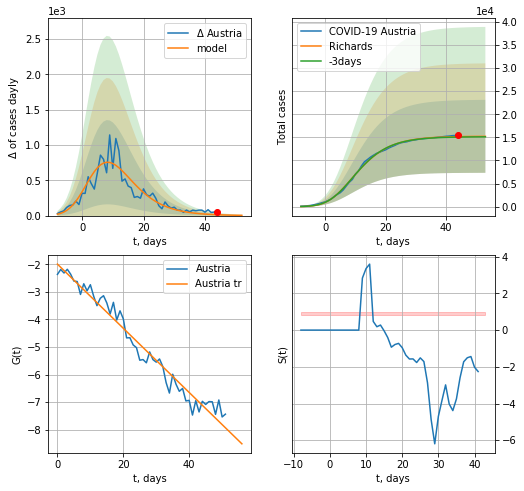

Austria data at: 2020-06-11
+3 day model MAPE: 0.006824
model: Richards
coeffs: [ 1.52413256e+04  8.30508829e-01 -3.03588001e+00  1.76502169e-01]
rational stdev: 0.518621
forecast at the end of period: +9 days
	 deltaDaycases: 3
	 total cases: 15217 ± 7892
	 total death: 602 ± 936
trend coefficient of determination: 0.965129
 intercept: -1.995756
 slope: -0.116348


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


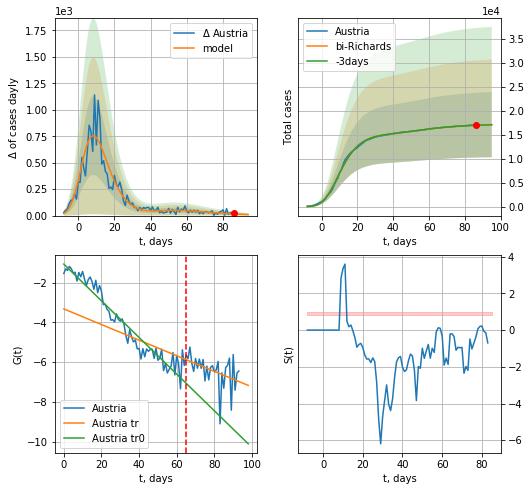

Austria data at: 2020-06-11
+3 day model MAPE: 0.001887
model: bi-Richards
coeffs: [ 1.98925062e+03  9.04338127e+00 -2.05469021e+01  7.17035093e-03]
rational stdev: 0.397125
forecast at the end of period: +9 days
	 deltaDaycases: 9
	 total cases: 17081 ± 6783
	 total death: 675 ± 804
bi-Richards approximation splitting point: 65
trend coefficient of determination: 0.933104
 intercept: -1.070640
 slope: -0.092218
trend coefficient of determination: 0.169268
 intercept: -3.324894
 slope: -0.039249


In [215]:
vL=65+12
x = forecastRR('Austria',dfAT[12:vL-12],d1,12*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Austria',dfAT[12:],d1,12*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)
#xx = forecast2R('Austria',dfAT[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


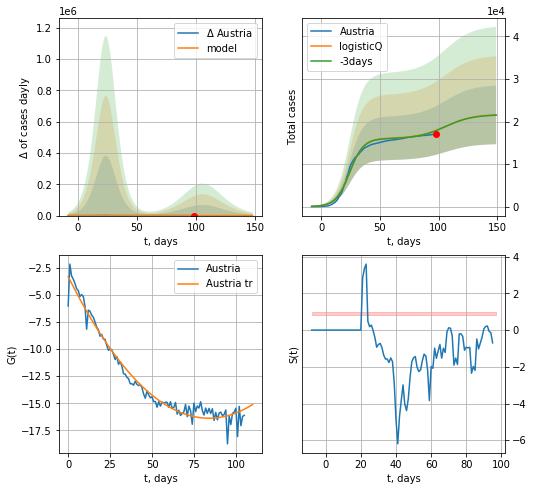

Austria data at: 2020-06-11
+3 day model MAPE: 0.002268
model: logisticQ
coeffs: [ 1.60308339e+04  4.69447762e-07  2.43275830e+01 -3.63245959e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.319557
forecast at the end of period: +51 days
	 deltaDaycases: 12
	 total cases: 21569 ± 6892
	 total death: 853 ± 817
trend coefficient of determination: 0.968410
 intercept_: -3.2693865267938733
 coeffs_: [ 0.         -0.31268534  0.00186349]


In [216]:
vL = 68
x = forecastRRR('Austria',dfAT[:],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
#xx = forecast2RRR('Austria',dfAT[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


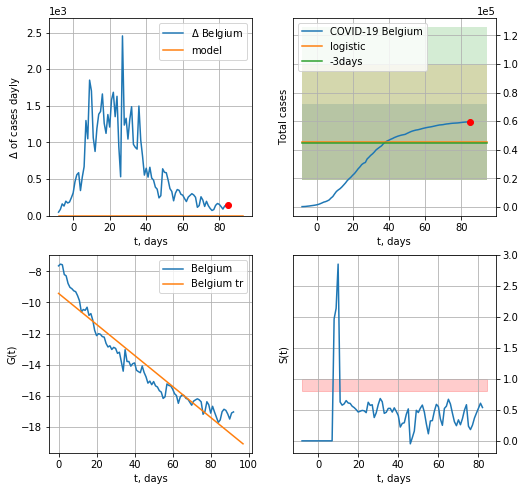

Belgium data at: 2020-06-11
+3 day model MAPE: 0.021461067662444103
model: logistic
coeffs:  [ 3.63843085e+04 -7.44146328e+00  2.46320591e+02]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.5895173686271448
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  45480 ± 26811
	 total death:  7339 ± 12979
trend coefficient of determination: 0.914631
 intercept: -9.417788
 slope: -0.099699


In [217]:
vL=9
x = forecast('Belgium',dfBG[vL:],d1,12*7-dT,addpred=True,xcoef=[0.25,1.,3.])
#xx = forecast2('Belgium',dfBG[vL:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

BG
           date  cases  active   death
98  2020-06-07  59226   33340  9595.0
99  2020-06-08  59348   33427  9606.0
100 2020-06-09  59437   33494  9619.0
101 2020-06-10  59569   33548  9629.0
102 2020-06-11  59711   33622  9636.0


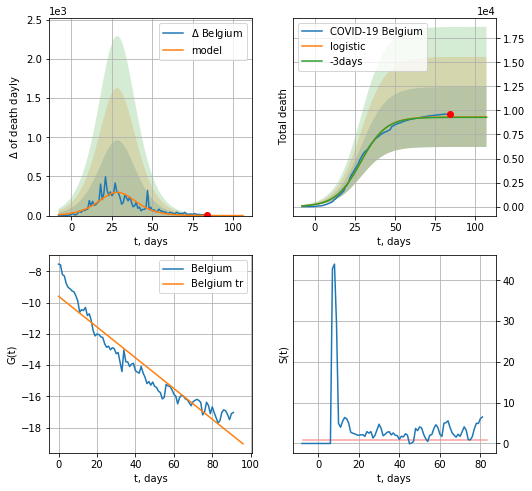

Belgium data at: 2020-06-11
+3 day model MAPE: 0.00426382798108018
model: logistic
coeffs:  [9.32648146e+03 1.27475317e-01 2.87210571e+01]
rational stdev:  0.334544816498445
forecast at the end of period: +23 days
	 total death:  9326 ± 3119
trend coefficient of determination: 0.914315
 intercept: -9.594406
 slope: -0.098431


In [218]:
dfBG = read_df(pd.DataFrame(),"BG")
x = forecast('Belgium',dfBG[10:],d1,14*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


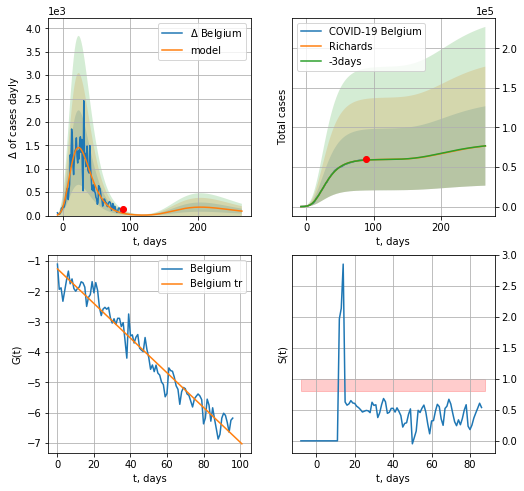

Belgium data at: 2020-06-11
+3 day model MAPE: 0.001977
model: Richards
coeffs: [ 5.97101610e+04  5.52260106e+00 -4.25042677e+01  1.20603361e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.654136
forecast at the end of period: +177 days
	 deltaDaycases: 95
	 total cases: 76633 ± 50129
	 total death: 12366 ± 24267
trend coefficient of determination: 0.956334
 intercept: -1.254553
 slope: -0.057101


In [219]:
x = forecastRR('Belgium',dfBG[5:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


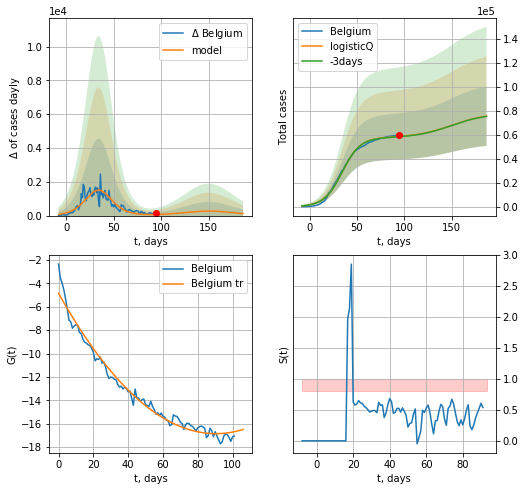

Belgium data at: 2020-06-11
+3 day model MAPE: 0.004726
model: logisticQ
coeffs: [ 5.75821109e+04  4.35358498e-07  3.44718079e+01 -2.40446755e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.328610
forecast at the end of period: +93 days
	 deltaDaycases: 120
	 total cases: 75403 ± 24778
	 total death: 12168 ± 11995
trend coefficient of determination: 0.978562
 intercept_: -4.863098060775769
 coeffs_: [ 0.         -0.2651496   0.00146695]


In [220]:
x = forecastRRR('Belgium',dfBG[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

In [221]:
dfBZ.tail()

,date,cases,active,death
103,2020-06-07,691962.0,352566,37312.0
104,2020-06-08,710887.0,347973,37312.0
105,2020-06-09,742084.0,377985,38497.0
106,2020-06-10,775184.0,338695,39797.0
107,2020-06-11,805649.0,367899,41058.0


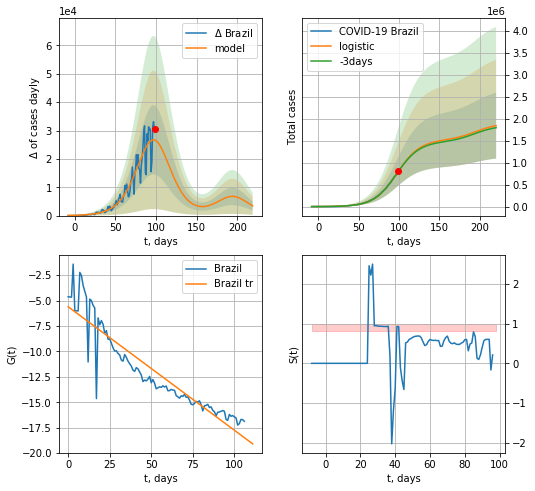

Brazil data at: 2020-06-11
+3 day model MAPE: 0.005919758094095409
model: logistic
coeffs:  [1.51660166e+06 7.04123789e-02 9.74593929e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.4067171693622169
forecast at the end of period: +121 days
	 deltaDaycases:  3432
	 total cases:  1840110 ± 748404
	 total death:  93776 ± 114420
trend coefficient of determination: 0.860603
 intercept: -5.611165
 slope: -0.121412


In [222]:
x = forecast('Brazil',dfBZ[:],d1,28*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx = forecast2('Brazil',dfBZ[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


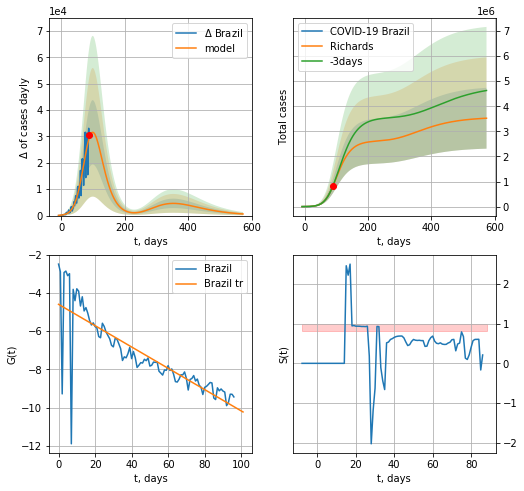

Brazil data at: 2020-06-11
+3 day model MAPE: 0.010471
model: Richards
coeffs: [2.61979038e+06 8.81076101e-02 8.03221455e+01 4.53533693e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.344325
forecast at the end of period: +485 days
	 deltaDaycases: 616
	 total cases: 3523171 ± 1213117
	 total death: 179550 ± 185470
trend coefficient of determination: 0.682158
 intercept: -4.594570
 slope: -0.055795


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


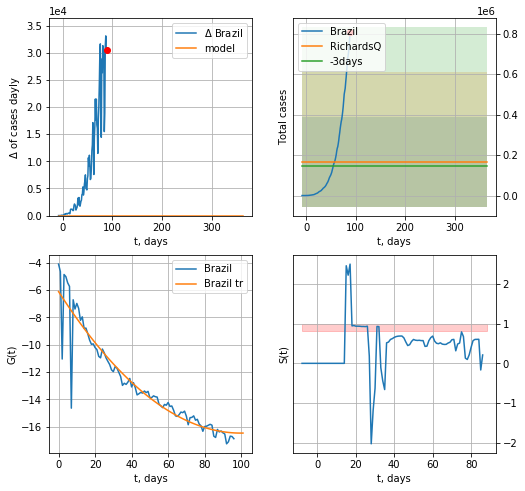

Brazil data at: 2020-06-11
+3 day model MAPE: 0.129428
model: RichardsQ
coeffs: [ 1.67277163e+05  9.62313024e+00 -1.39163982e+03  1.19256531e+03
 -3.24678554e+00]
rational stdev: 1.326685
forecast at the end of period: +275 days
	 deltaDaycases: 0
	 total cases: 167277 ± 221924
	 total death: 8524 ± 33925
trend coefficient of determination: 0.898911
 intercept_: -6.1091565917629485
 coeffs_: [ 0.         -0.20745594  0.00103915]


In [223]:
x = forecastRR('Brazil',dfBZ[10:],d1,80*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Brazil',dfBZ[10:],d1,50*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


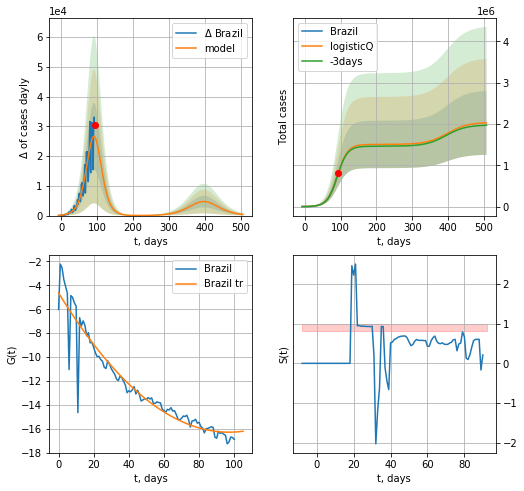

Brazil data at: 2020-06-11
+3 day model MAPE: 0.006253
model: logisticQ
coeffs: [ 1.50591647e+06  5.42272002e-06  9.12612199e+01 -1.29606353e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.381649
forecast at the end of period: +415 days
	 deltaDaycases: 371
	 total cases: 2028743 ± 774267
	 total death: 103390 ± 118375
trend coefficient of determination: 0.907854
 intercept_: -4.632255216337652
 coeffs_: [ 0.         -0.2400916   0.00123766]


In [224]:
x = forecastRRR('Brazil',dfBZ[6:],d1,70*7-dT,addpred=True,xcoef=koreaCoeffs)

In [225]:
#x = forecastRRR('Brazil',dfBZ[5:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

AS
           date   cases  active  death
113 2020-06-07  7265.0     457  102.0
114 2020-06-08  7267.0     446  102.0
115 2020-06-09  7274.0     432  102.0
116 2020-06-10  7285.0     436  102.0
117 2020-06-11  7289.0     406  102.0


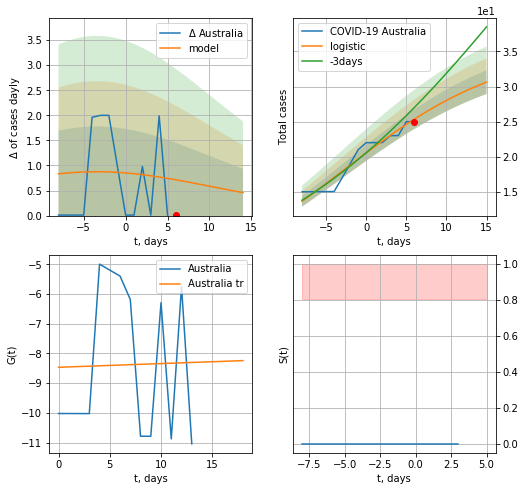

Australia data at: 2020-06-11
model: logistic
coeffs:  [35.98153551  0.09728993 -2.93367767]
rational stdev:  0.0551816162827012
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  30 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.000431
 intercept: -8.467221
 slope: 0.012491


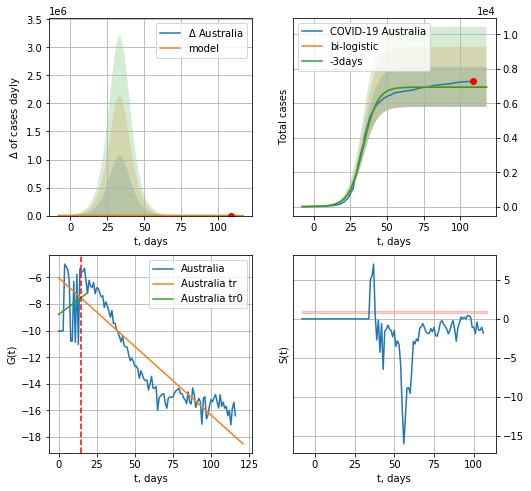

Australia data at: 2020-06-11
+3 day model MAPE: 0.002710721919055431
model: bi-logistic
coeffs:  [6.91729599e+03 2.05552312e-01 3.38393673e+01] [35.98153551  0.09728993 -2.93367767]
rational stdev:  0.16676232576878872
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  6953 ± 1159
	 total death:  97 ± 48
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.022779
 intercept: -8.785888
 slope: 0.086030
trend coefficient of determination: 0.825069
 intercept: -6.018396
 slope: -0.103253


In [226]:
dfAS = read_df(pd.DataFrame(),"AS")
try:
    x = forecast('Australia',dfAS[:15],d1,12*7-dT,pMAPE=False)
    xx = forecast2('Australia',dfAS[:],d1,12*7-dT,x,vL=15,addpred=False,xcoef=[0.25/4,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


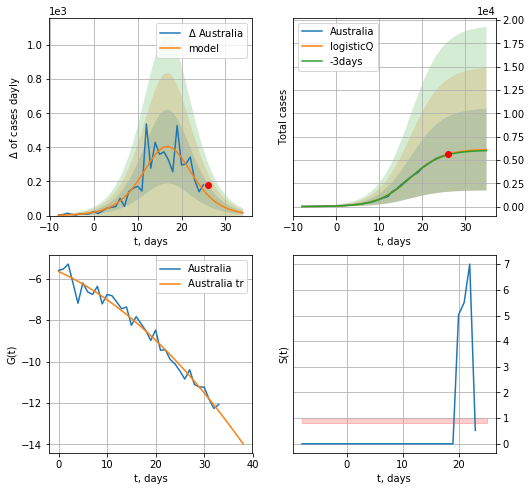

Australia data at: 2020-06-11
+3 day model MAPE: 0.012936
model: logisticQ
coeffs: [ 6.16825959e+03  4.63202537e-05  1.72354346e+01 -5.67168730e+03]
rational stdev: 0.716728
forecast at the end of period: +9 days
	 deltaDaycases: 16
	 total cases: 6112 ± 4380
	 total death: 85 ± 182
trend coefficient of determination: 0.975101
 intercept_: -5.657250296853678
 coeffs_: [ 0.         -0.10702975 -0.00294069]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


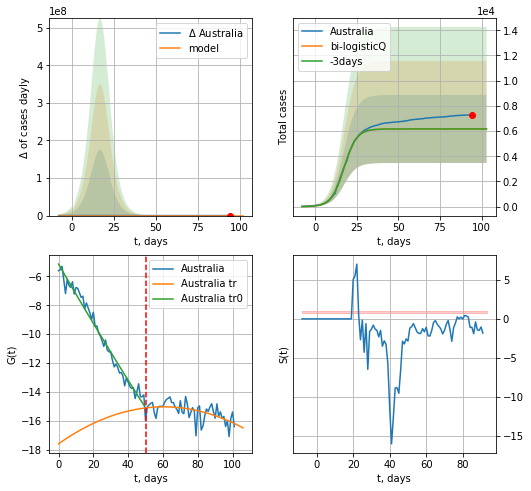

Australia data at: 2020-06-11
+3 day model MAPE: 0.000000
model: bi-logisticQ
coeffs: [-7.58851394 -0.92203334 22.50755911  1.47781876]
rational stdev: 0.437795
forecast at the end of period: +9 days
	 deltaDaycases: 0
	 total cases: 6168 ± 2700
	 total death: 86 ± 112
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.978786
 intercept_: -5.1508340728883
 coeffs_: [ 0.00000000e+00 -2.09278795e-01  2.06303704e-04]
trend coefficient of determination: 0.296208
 intercept_: -17.591580683791786
 coeffs_: [ 0.          0.08471874 -0.00070096]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [227]:
#axcoef = [koreaCoeffs[0],koreaCoeffs[1],koreaCoeffs[2],koreaCoeffs[3]]
vL = 50
x = forecastRRR('Australia',dfAS[15:vL],d1,12*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Australia',dfAS[15:],d1,12*7-dT,x,addpred=False,xcoef=koreaCoeffs,vL=vL)

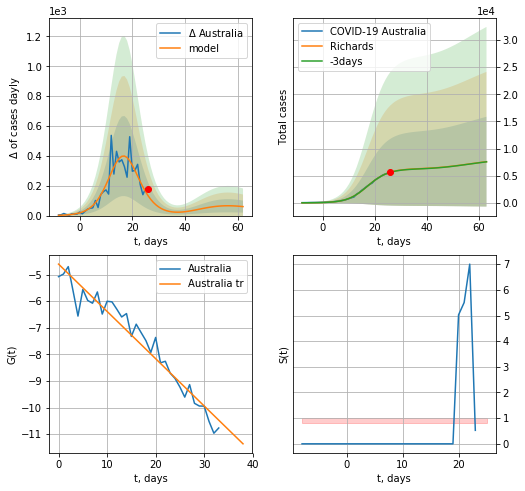

Australia data at: 2020-06-11
+3 day model MAPE: 0.004122
model: Richards
coeffs: [6.29844024e+03 2.85463605e-01 1.64695760e+01 8.48736456e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 1.092498
forecast at the end of period: +37 days
	 deltaDaycases: 60
	 total cases: 7577 ± 8278
	 total death: 106 ± 347
trend coefficient of determination: 0.945167
 intercept: -4.606318
 slope: -0.177832


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


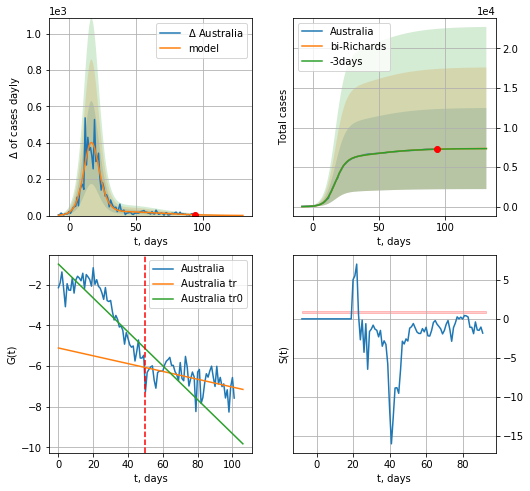

Australia data at: 2020-06-11
+3 day model MAPE: 0.001032
model: bi-Richards
coeffs: [ 1.06293394e+03  6.58771734e+00 -4.88927088e+01  7.69461007e-03]
rational stdev: 0.697816
forecast at the end of period: +37 days
	 deltaDaycases: 0
	 total cases: 7346 ± 5126
	 total death: 102 ± 213
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.755567
 intercept: -0.975693
 slope: -0.083533
trend coefficient of determination: 0.213122
 intercept: -5.108310
 slope: -0.019256


In [228]:
x = forecastRR('Australia',dfAS[15:50],d1,16*7-dT,addpred=True,xcoef=RkoreaCoeffs)
xx = forecast2RR('Australia',dfAS[15:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=50)

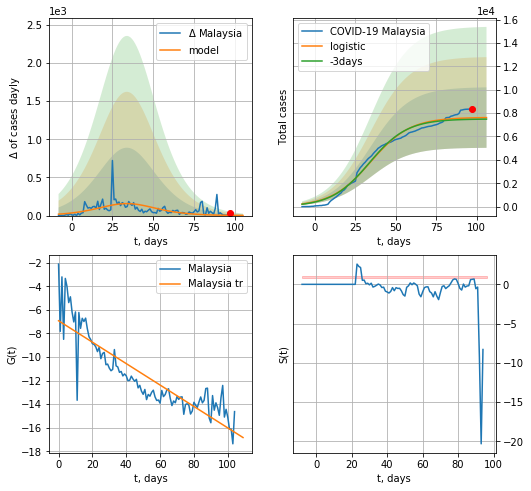

Malaysia data at: 2020-06-11
+3 day model MAPE: 0.016897988493926163
model: logistic
coeffs:  [7.63362213e+03 8.23297387e-02 3.43276255e+01]
rational stdev:  0.33953934284719367
forecast at the end of period: +9 days
	 deltaDaycases:  1
	 total cases:  7612 ± 2584
	 total death:  107 ± 108
trend coefficient of determination: 0.775205
 intercept: -6.924410
 slope: -0.090887


In [229]:
x = forecast('Malaysia',dfML[:],d1,12*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

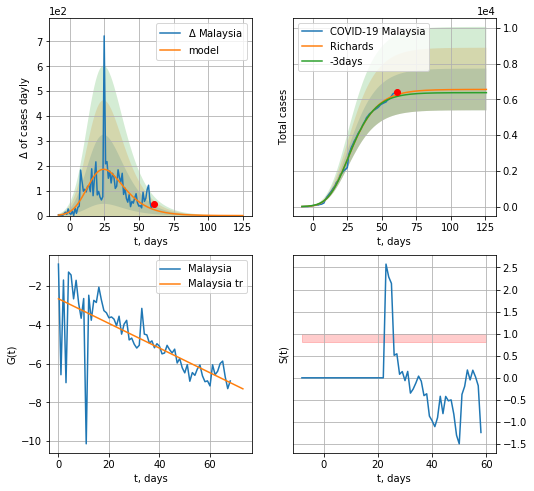

Malaysia data at: 2020-06-11
+3 day model MAPE: 0.016662
model: Richards
coeffs: [6.55738118e+03 3.88579492e-01 7.38231986e+00 2.20014246e-01]
rational stdev: 0.177891
forecast at the end of period: +65 days
	 deltaDaycases: 0
	 total cases: 6556 ± 1166
	 total death: 92 ± 49
trend coefficient of determination: 0.508698
 intercept: -2.652901
 slope: -0.063638


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


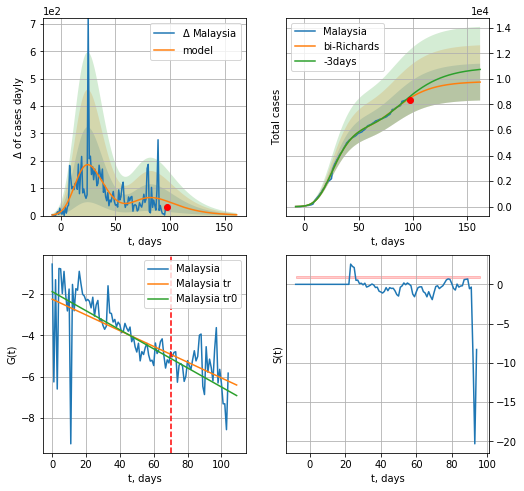

Malaysia data at: 2020-06-11
+3 day model MAPE: 0.016333
model: bi-Richards
coeffs: [3.24908886e+03 2.02442453e+00 1.53892944e+01 2.60451512e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.147703
forecast at the end of period: +65 days
	 deltaDaycases: 2
	 total cases: 9752 ± 1440
	 total death: 137 ± 60
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.346110
 intercept: -1.887368
 slope: -0.046164
trend coefficient of determination: 0.149592
 intercept: -2.251219
 slope: -0.038139


In [231]:
vL = 70
x = forecastRR('Malaysia',dfML[:vL],d1,20*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Malaysia',dfML[:],d1,20*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


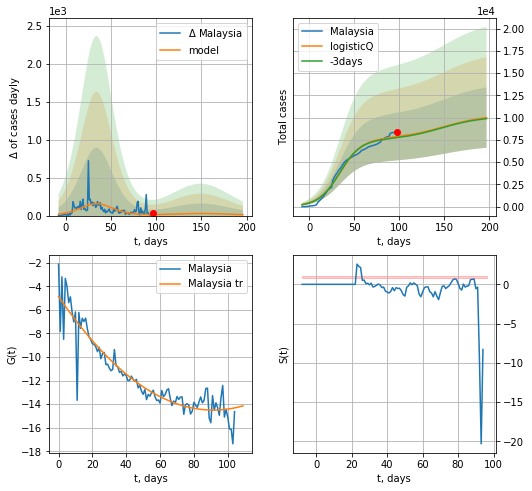

Malaysia data at: 2020-06-11
+3 day model MAPE: 0.015562
model: logisticQ
coeffs: [ 7.63360882e+03  2.02653895e-07  3.43287915e+01 -4.06091279e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.339590
forecast at the end of period: +100 days
	 deltaDaycases: 12
	 total cases: 10003 ± 3397
	 total death: 141 ± 143
trend coefficient of determination: 0.866962
 intercept_: -4.865548159334695
 coeffs_: [ 0.         -0.21082495  0.00115327]


In [232]:
x = forecastRRR('Malaysia',dfML[:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs)

ZL
           date   cases  active  death
100 2020-06-07  1504.0       0   22.0
101 2020-06-08  1504.0       0   22.0
102 2020-06-09  1504.0       0   22.0
103 2020-06-10  1504.0       0   22.0
104 2020-06-11  1504.0       0   22.0


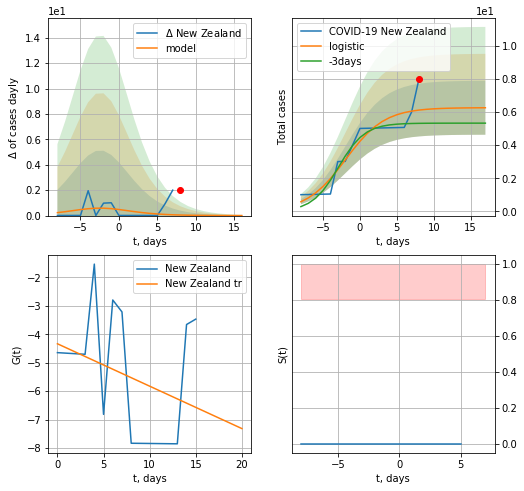

New Zealand data at: 2020-06-11
model: logistic
coeffs:  [ 6.26235961  0.37662733 -1.95315921]
rational stdev:  0.26005250078288755
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  6 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.103357
 intercept: -4.332661
 slope: -0.149156
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:245: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:245: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: invalid value encountered in log


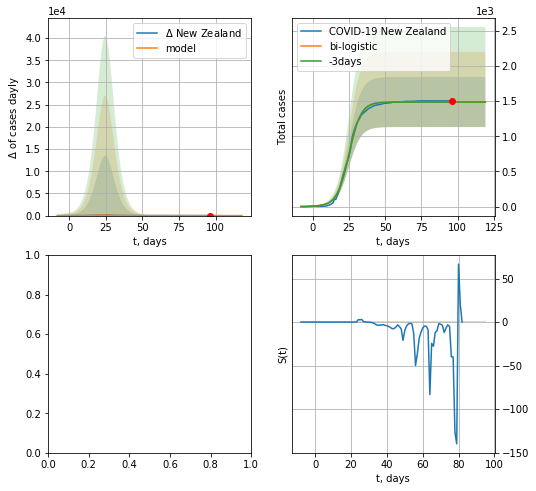

In [233]:
vL=17
dfZL = read_df(pd.DataFrame(),"ZL")
try:
    x = forecast('New Zealand',dfZL[:vL],d1,12*7-dT,pMAPE=False)
    xx = forecast2('New Zealand',dfZL[:],d1,14*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)#
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:75: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:647: RuntimeWarning: divide by zero encountered in log
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:647: RuntimeWarning: invalid value encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

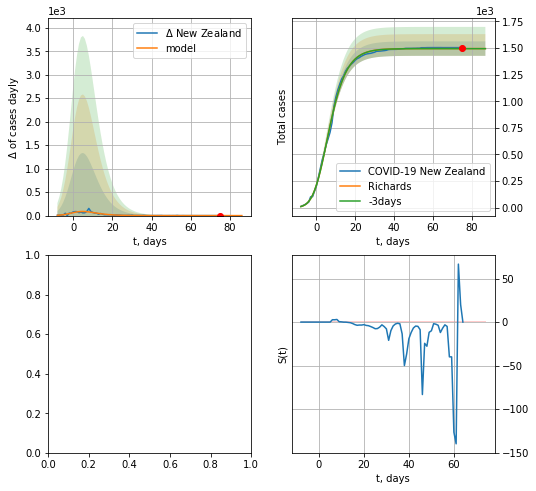

In [222]:
x = forecastRR('New Zealand',dfZL[18:],d1,12*7-dT,addpred=False,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:571: RuntimeWarning: invalid value encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

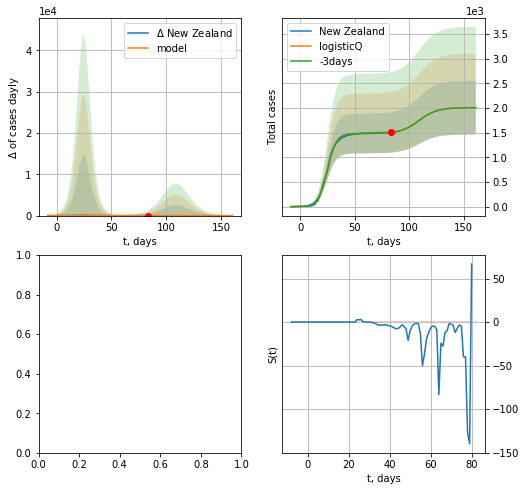

In [253]:
x = forecastRRR('New Zealand',dfZL[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

BR
           date    cases  active  death
100 2020-06-07  48630.0   24714  269.0
101 2020-06-08  49453.0   25297  276.0
102 2020-06-09  50265.0   25477  282.0
103 2020-06-10  51066.0   25111  288.0
104 2020-06-11  51816.0   24880  293.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


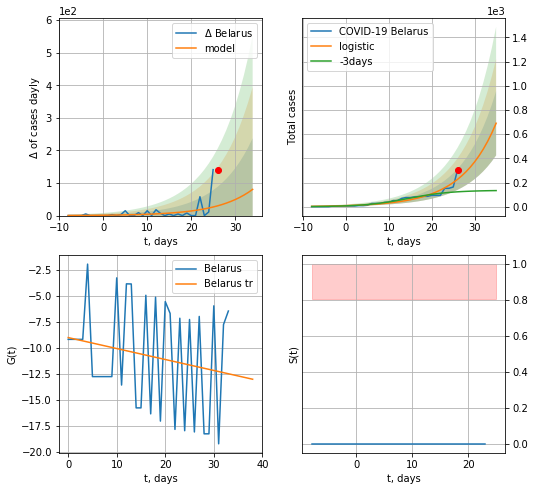

Belarus data at: 2020-06-11
+3 day model MAPE: 1.0426298586333318
model: logistic
coeffs:  [1.42197961e+06 1.24002034e-01 9.65329254e+01]
rational stdev:  0.38452901172178605
forecast at the end of period: +9 days
	 deltaDaycases:  80
	 total cases:  690 ± 265
	 total death:  3 ± 3
trend coefficient of determination: 0.039182
 intercept: -9.040329
 slope: -0.105417


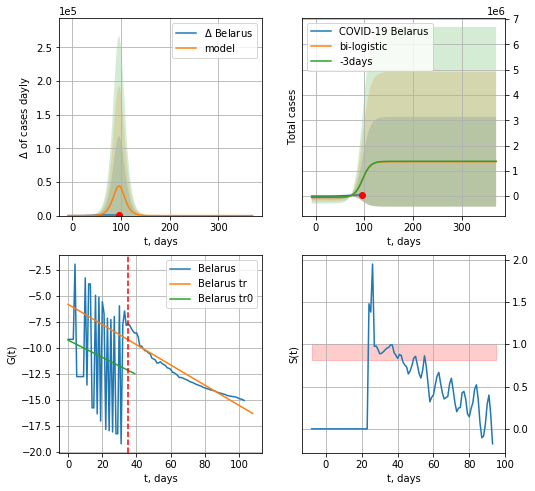

Belarus data at: 2020-06-11
+3 day model MAPE: 0.022794763759511436
model: bi-logistic
coeffs:  [-6.05521374e+04  3.02404419e+01 -6.98228874e+02] [1.42197961e+06 1.24002034e-01 9.65329254e+01]
rational stdev:  1.3059886021040357
forecast at the end of period: +275 days
	 deltaDaycases:  0
	 total cases:  1361427 ± 1778008
	 total death:  7698 ± 30160
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.026128
 intercept: -9.289300
 slope: -0.082783
trend coefficient of determination: 0.922779
 intercept: -5.844184
 slope: -0.097146


In [234]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:35],d1,7*12-dT)
xx = forecast2('Belarus',dfBR[:],d1,50*7-dT,x,addpred=False,xcoef=[0.25,1.,1.8],vL=35)

BR
           date    cases  active  death
100 2020-06-07  48630.0   24714  269.0
101 2020-06-08  49453.0   25297  276.0
102 2020-06-09  50265.0   25477  282.0
103 2020-06-10  51066.0   25111  288.0
104 2020-06-11  51816.0   24880  293.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


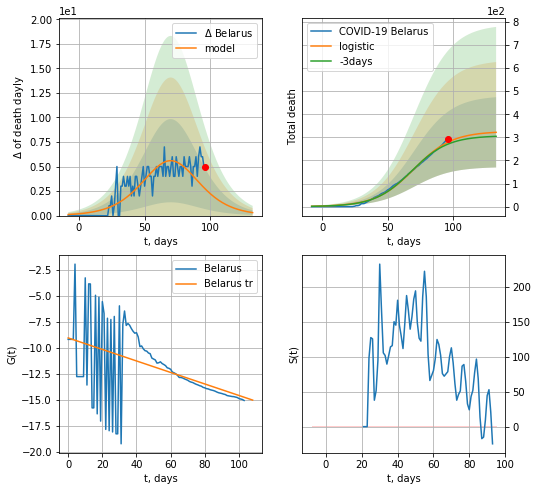

Belarus data at: 2020-06-11
+3 day model MAPE: 0.03162580364702267
model: logistic
coeffs:  [3.25933740e+02 6.86709577e-02 7.02470110e+01]
rational stdev:  0.47309623503303383
forecast at the end of period: +37 days
	 total death:  321 ± 152
trend coefficient of determination: 0.221700
 intercept: -9.073304
 slope: -0.055362


In [235]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:],d1,16*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


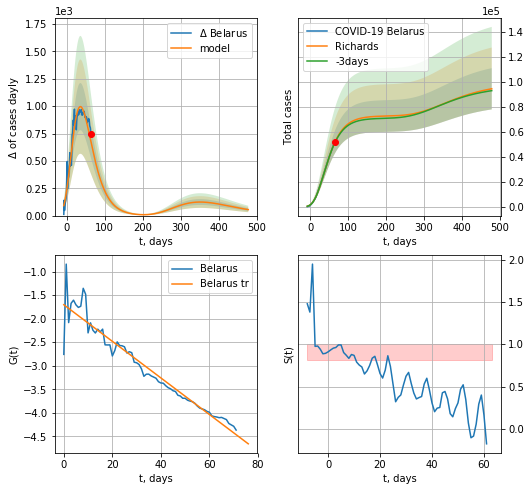

Belarus data at: 2020-06-11
+3 day model MAPE: 0.007777
model: Richards
coeffs: [ 7.28226442e+04  3.03943484e+00 -8.13439337e+01  1.23092321e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.174751
forecast at the end of period: +415 days
	 deltaDaycases: 54
	 total cases: 94507 ± 16515
	 total death: 534 ± 279
trend coefficient of determination: 0.927658
 intercept: -1.702540
 slope: -0.038931


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


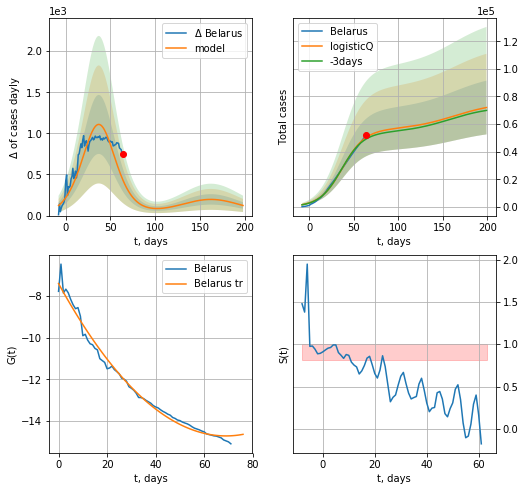

Belarus data at: 2020-06-11
+3 day model MAPE: 0.022923
model: logisticQ
coeffs: [ 5.59325123e+04  8.58108860e-07  3.73142812e+01 -9.19539703e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.270648
forecast at the end of period: +135 days
	 deltaDaycases: 123
	 total cases: 71958 ± 19475
	 total death: 406 ± 329
trend coefficient of determination: 0.987284
 intercept_: -7.415965097597326
 coeffs_: [ 0.         -0.21160481  0.00153406]


In [236]:
x = forecastRR('Belarus',dfBR[32:],d1,70*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRRR('Belarus',dfBR[32:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


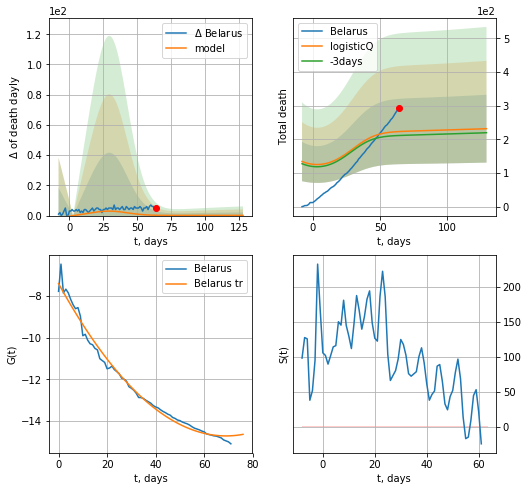

Belarus data at: 2020-06-11
+3 day model MAPE: 0.055371
model: logisticQ
coeffs: [ 1.88994159e+02  1.49813670e-03  7.98826137e+00 -1.51164517e+00]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.433483
forecast at the end of period: +65 days
	 total death: 231 ± 100
trend coefficient of determination: 0.987284
 intercept_: -7.415965097597326
 coeffs_: [ 0.         -0.21160481  0.00153406]


In [237]:
x = forecastRRR('Belarus',dfBR[32:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

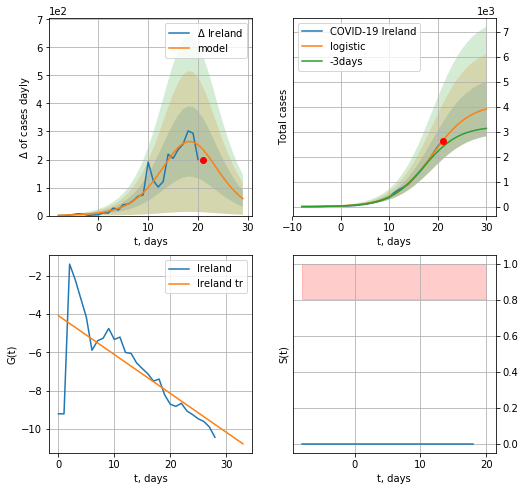

Ireland data at: 2020-06-11
+3 day model MAPE: 0.12282208812559416
model: logistic
coeffs:  [4.12730398e+03 2.56984382e-01 1.88154165e+01]
rational stdev:  0.27980533262906077
forecast at the end of period: +9 days
	 deltaDaycases:  60
	 total cases:  3906 ± 1093
	 total death:  263 ± 220
trend coefficient of determination: 0.521820
 intercept: -4.083344
 slope: -0.202899


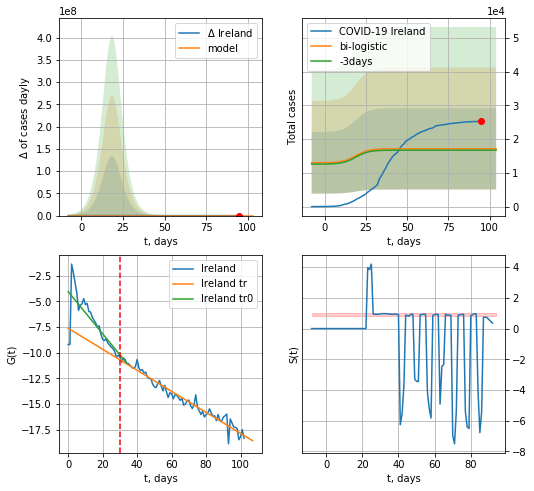

Ireland data at: 2020-06-11
+3 day model MAPE: 0.02379246081069586
model: bi-logistic
coeffs:  [ 1.03890070e+04 -9.34042080e+00  2.37180062e+02] [4.12730398e+03 2.56984382e-01 1.88154165e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.70343371711103
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  17113 ± 12038
	 total death:  1154 ± 2435
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.551550
 intercept: -4.065434
 slope: -0.204818
trend coefficient of determination: 0.957096
 intercept: -7.627951
 slope: -0.102281


In [238]:
vL=30
x = forecast('Ireland',dfIR[:vL],d1,12*7-dT)
xx = forecast2('Ireland',dfIR[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


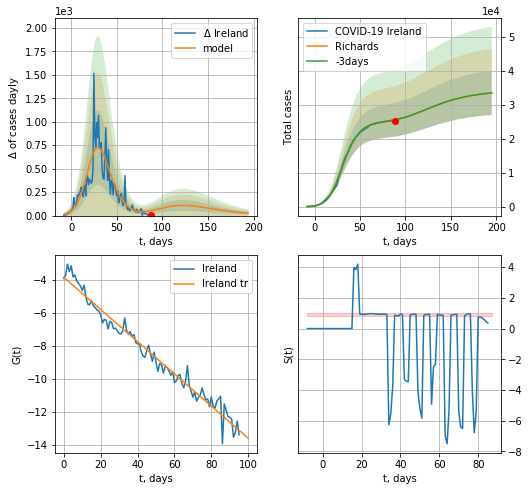

Ireland data at: 2020-06-11
+3 day model MAPE: 0.000364
model: Richards
coeffs: [2.51351536e+04 1.90852294e-01 2.30795153e+01 5.12758739e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.193341
forecast at the end of period: +107 days
	 deltaDaycases: 25
	 total cases: 33461 ± 6469
	 total death: 2257 ± 1309
trend coefficient of determination: 0.971158
 intercept: -3.833194
 slope: -0.097688


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


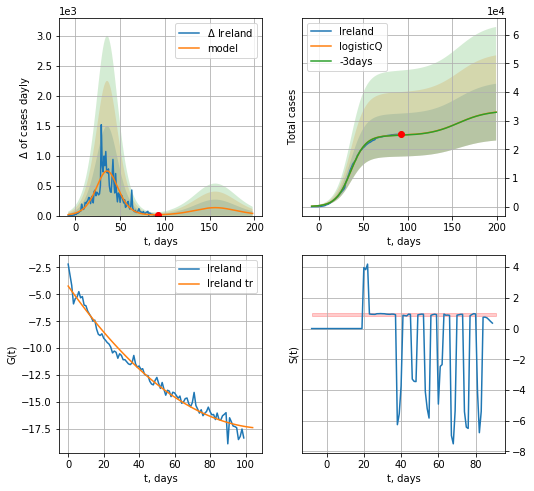

Ireland data at: 2020-06-11
+3 day model MAPE: 0.002278
model: logisticQ
coeffs: [ 2.48223314e+04  1.03959734e-06  3.59478220e+01 -1.15208285e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.300667
forecast at the end of period: +107 days
	 deltaDaycases: 36
	 total cases: 32977 ± 9915
	 total death: 2225 ± 2006
trend coefficient of determination: 0.977987
 intercept_: -4.233464579570727
 coeffs_: [ 0.         -0.23360997  0.00103193]


In [239]:
x = forecastRR('Ireland',dfIR[7:],d1,26*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRRR('Ireland',dfIR[3:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

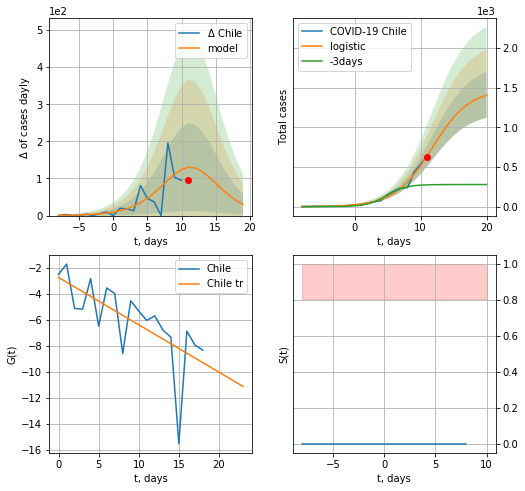

Chile data at: 2020-06-11
+3 day model MAPE: 1.792944169915196
model: logistic
coeffs:  [1.48337612e+03 3.52807696e-01 1.17654757e+01]
rational stdev:  0.20396784879776983
forecast at the end of period: +9 days
	 deltaDaycases:  30
	 total cases:  1406 ± 286
	 total death:  24 ± 14
trend coefficient of determination: 0.458420
 intercept: -2.731631
 slope: -0.364960


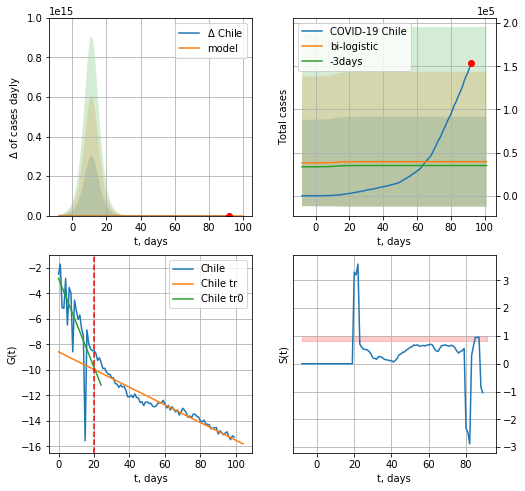

Chile data at: 2020-06-11
+3 day model MAPE: 0.12726599166980995
model: bi-logistic
coeffs:  [ 3.04157646e+04 -7.06536220e+00  1.82159952e+02] [1.48337612e+03 3.52807696e-01 1.17654757e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.316432878303264
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  39503 ± 52003
	 total death:  678 ± 2677
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.470301
 intercept: -2.832141
 slope: -0.348208
trend coefficient of determination: 0.927152
 intercept: -8.584981
 slope: -0.069296


In [240]:
vL=20
x = forecast('Chile',dfCL[:vL],d1,7*12-dT)
xx = forecast2('Chile',dfCL[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

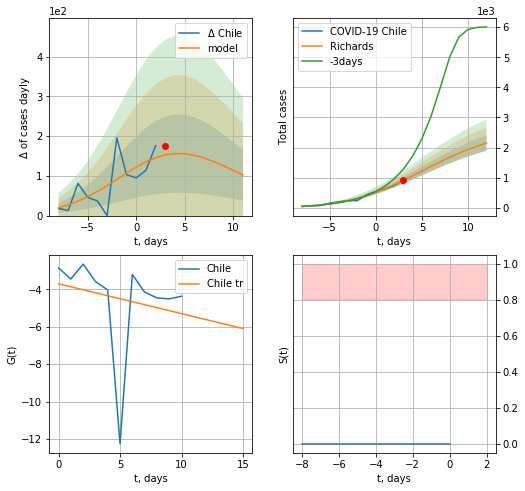

Chile data at: 2020-06-11
+3 day model MAPE: 0.379523
model: Richards
coeffs: [ 2.78778316e+03  4.58057700e-01 -1.87938726e-01  3.98125904e-01]
rational stdev: 0.120260
forecast at the end of period: +9 days
	 deltaDaycases: 102
	 total cases: 2153 ± 258
	 total death: 37 ± 13
trend coefficient of determination: 0.039875
 intercept: -3.708259
 slope: -0.159512


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


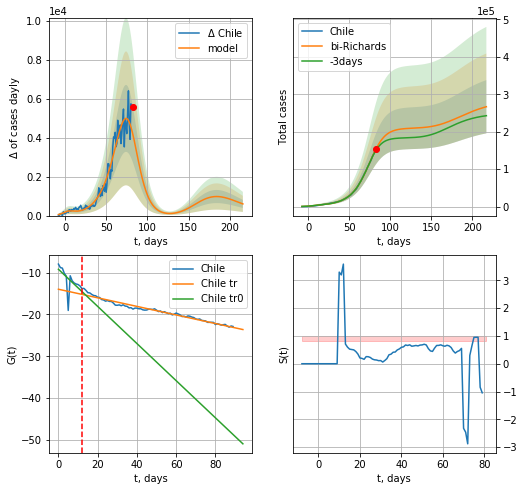

Chile data at: 2020-06-11
+3 day model MAPE: 0.026917
model: bi-Richards
coeffs: [2.06803705e+05 7.03017234e-02 7.88744934e+01 1.63810841e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.266366
forecast at the end of period: +135 days
	 deltaDaycases: 599
	 total cases: 266756 ± 71054
	 total death: 4584 ± 3663
bi-Richards approximation splitting point: 12
trend coefficient of determination: 0.302640
 intercept: -9.186387
 slope: -0.444411
trend coefficient of determination: 0.964390
 intercept: -13.966853
 slope: -0.102605


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


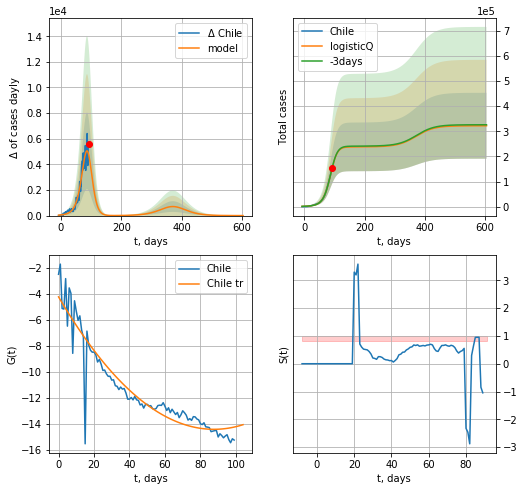

Chile data at: 2020-06-11
+3 day model MAPE: 0.003098
model: logisticQ
coeffs: [ 2.37900902e+05  2.71470493e-04  8.50600284e+01 -2.26258375e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.407537
forecast at the end of period: +513 days
	 deltaDaycases: 0
	 total cases: 322136 ± 131282
	 total death: 5535 ± 6767
trend coefficient of determination: 0.880714
 intercept_: -4.230406746672803
 coeffs_: [ 0.         -0.23289147  0.00132908]


In [241]:
vL = 22
x = forecastRR('Chile',dfCL[10:vL],d1,12*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Chile',dfCL[10:],d1,30*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL-10)
x = forecastRRR('Chile',dfCL[:],d1,84*7-dT,addpred=True,xcoef=koreaCoeffs)

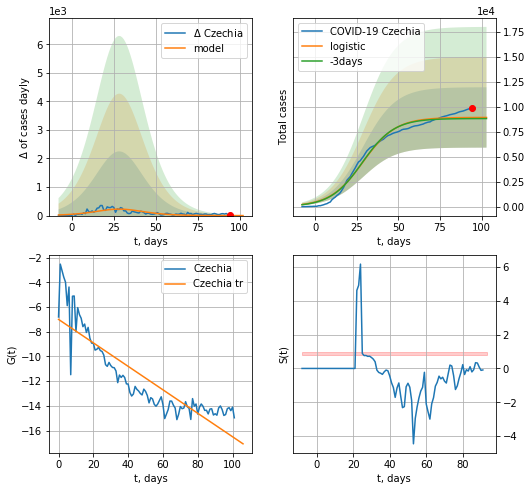

Czechia data at: 2020-06-11
+3 day model MAPE: 0.0124589551077948
model: logistic
coeffs:  [8.92449463e+03 1.01361412e-01 2.86682979e+01]
rational stdev:  0.33838627370151486
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  8919 ± 3018
	 total death:  296 ± 300
trend coefficient of determination: 0.769108
 intercept: -7.001851
 slope: -0.094915


In [242]:
x = forecast('Czechia',dfCH[:],d1,12*7-dT,shift=1.,addpred=False,xcoef=[0.25,1.,2.4])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


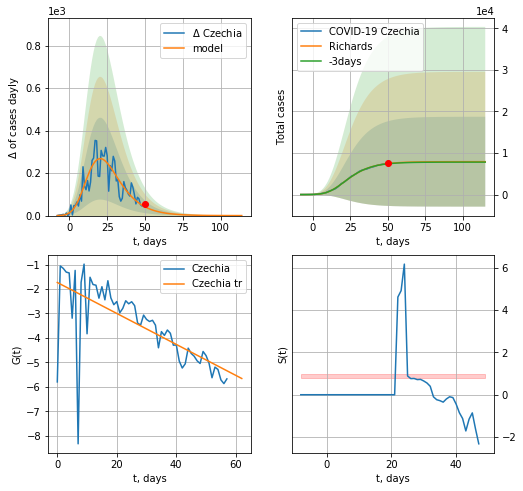

Czechia data at: 2020-06-11
+3 day model MAPE: 0.007369
model: Richards
coeffs: [ 7.90689533e+03  1.12645119e+00 -4.69210858e+00  8.53971991e-02]
rational stdev: 1.366945
forecast at the end of period: +65 days
	 deltaDaycases: 0
	 total cases: 7905 ± 10807
	 total death: 263 ± 1078
trend coefficient of determination: 0.470375
 intercept: -1.735202
 slope: -0.063324


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


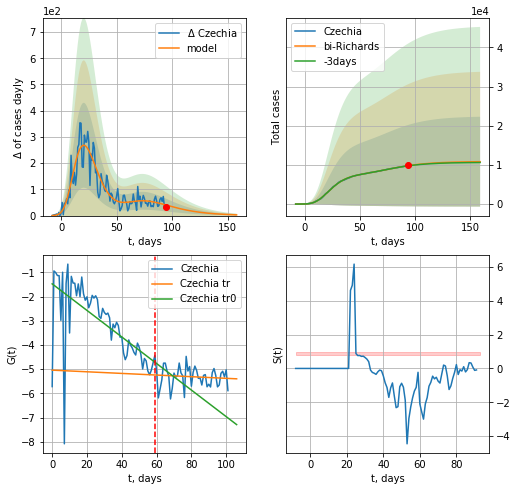

Czechia data at: 2020-06-11
+3 day model MAPE: 0.004367
model: bi-Richards
coeffs: [ 2.97881240e+03  3.47944702e+00 -1.14904845e+01  1.38822008e-02]
rational stdev: 1.059547
forecast at the end of period: +65 days
	 deltaDaycases: 2
	 total cases: 10829 ± 11474
	 total death: 360 ± 1144
bi-Richards approximation splitting point: 59
trend coefficient of determination: 0.400348
 intercept: -1.477547
 slope: -0.054863
trend coefficient of determination: 0.009896
 intercept: -5.042897
 slope: -0.003380


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


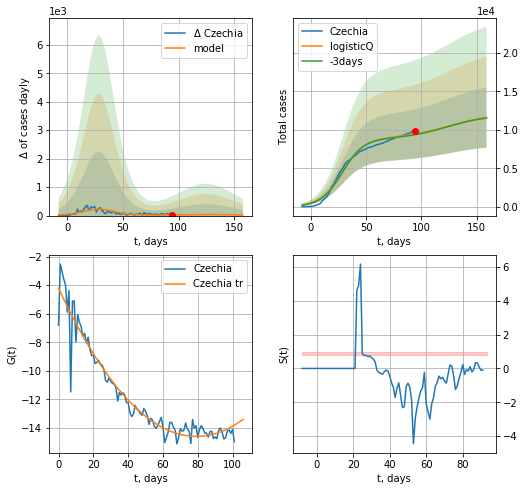

Czechia data at: 2020-06-11
+3 day model MAPE: 0.010243
model: logisticQ
coeffs: [ 8.92446145e+03  2.21876036e-07  2.86686246e+01 -4.56650949e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.338436
forecast at the end of period: +65 days
	 deltaDaycases: 20
	 total cases: 11611 ± 3929
	 total death: 386 ± 391
trend coefficient of determination: 0.931091
 intercept_: -4.218049544455828
 coeffs_: [ 0.         -0.26194891  0.00165383]


In [243]:
vL= 59
x = forecastRR('Czechia',dfCH[:vL],d1,20*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Czechia',dfCH[:],d1,20*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRRR('Czechia',dfCH[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

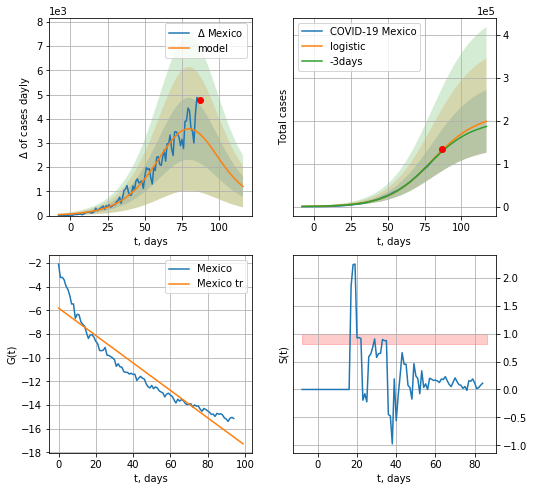

Mexico data at: 2020-06-11
+3 day model MAPE: 0.022724601842227046
model: logistic
coeffs:  [2.11843109e+05 6.73866605e-02 7.98773721e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.36865339382464823
forecast at the end of period: +30 days
	 deltaDaycases:  1202
	 total cases:  198608 ± 73217
	 total death:  23636 ± 26140
trend coefficient of determination: 0.900326
 intercept: -5.799390
 slope: -0.115997


In [244]:
x = forecast('Mexico',dfMX[:],d1,15*7-dT,addpred=True,xcoef=[.25,1.,2.])#

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


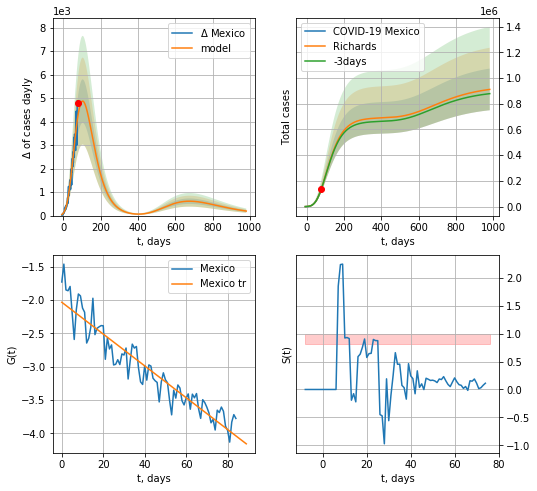

Mexico data at: 2020-06-11
+3 day model MAPE: 0.002853
model: Richards
coeffs: [ 6.91831977e+05  5.16048844e-01 -6.37545326e+01  3.77837584e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.177756
forecast at the end of period: +905 days
	 deltaDaycases: 192
	 total cases: 911742 ± 162067
	 total death: 108504 ± 57861
trend coefficient of determination: 0.893112
 intercept: -2.035730
 slope: -0.023839


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


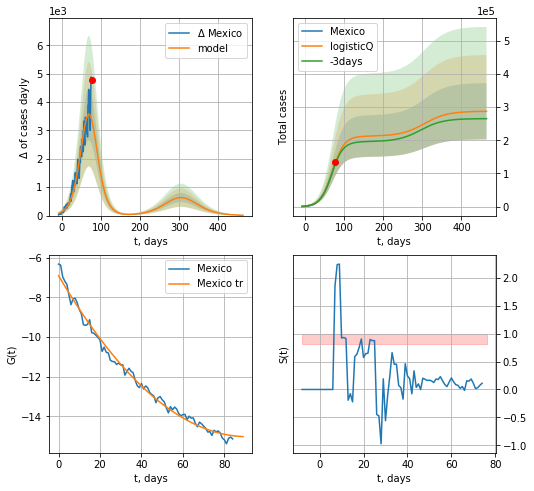

Mexico data at: 2020-06-11
+3 day model MAPE: 0.022831
model: logisticQ
coeffs: [ 2.12214369e+05  2.31308791e-06  6.99317923e+01 -2.90427471e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.295199
forecast at the end of period: +387 days
	 deltaDaycases: 11
	 total cases: 287031 ± 84731
	 total death: 34159 ± 30251
trend coefficient of determination: 0.991003
 intercept_: -6.902951525930239
 coeffs_: [ 0.         -0.17833663  0.000979  ]


In [245]:
x = forecastRR('Mexico',dfMX[10:],d1,140*7-dT,addpred=True,xcoef=RkoreaCoeffs)#
x = forecastRRR('Mexico',dfMX[10:],d1,66*7-dT,addpred=True,xcoef=koreaCoeffs)#

LT
          date   cases  active  death     tests
90 2020-06-07  1720.0     318   71.0  335686.0
91 2020-06-08  1727.0     317   71.0  340073.0
92 2020-06-09  1733.0     280   74.0  345392.0
93 2020-06-10  1752.0     296   74.0  350788.0
94 2020-06-11  1756.0     282   74.0  356062.0


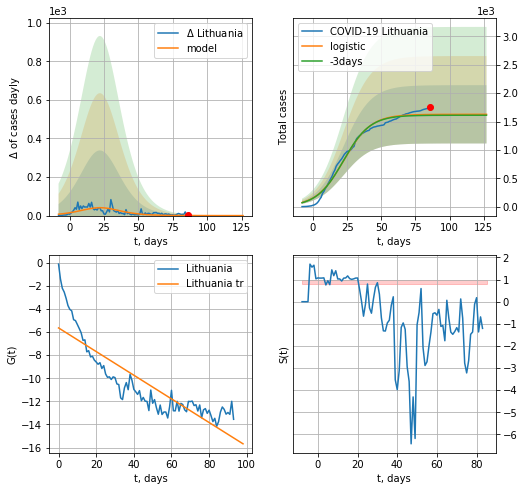

Lithuania data at: 2020-06-11
+3 day model MAPE: 0.009646580484293881
model: logistic
coeffs:  [1.62769710e+03 1.00704357e-01 2.25069931e+01]
rational stdev:  0.31568948285737203
forecast at the end of period: +41 days
	 deltaDaycases:  0
	 total cases:  1627 ± 513
	 total death:  68 ± 64
trend coefficient of determination: 0.750375
 intercept: -5.634734
 slope: -0.102488


In [352]:
vL = 17
dfLT = read_df(pd.DataFrame(),"LT")
try:
    x = forecast('Lithuania',dfLT[:],d1,6*7-1)
except:
    print("Exception occurs")
#xx = forecast2('Lithuania',dfLT[:],d1,8*7-1,x,shift=1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

In [353]:
#dfLT = read_df(pd.DataFrame(),"LT")
#plt.plot(range(len(dfLT[3:])),dfLT[3:].cases/dfLT[3:].tests)

#plt.grid()#

In [354]:
#np.diff(dfLT["cases"])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: divide by zero encountered in true_divide


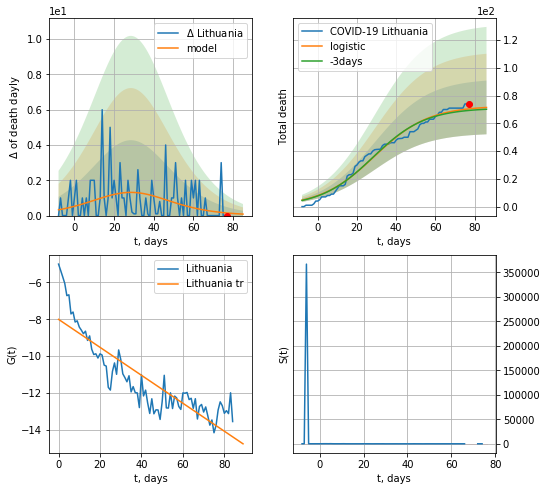

Lithuania data at: 2020-06-11
+3 day model MAPE: 0.016582323974140084
model: logistic
coeffs:  [7.26215313e+01 7.24116090e-02 2.89393975e+01]
rational stdev:  0.27081384104062506
forecast at the end of period: +9 days
	 total death:  71 ± 19
trend coefficient of determination: 0.756671
 intercept: -8.004347
 slope: -0.075963


In [355]:
x = forecast('Lithuania',dfLT[9:],d1,7*12-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


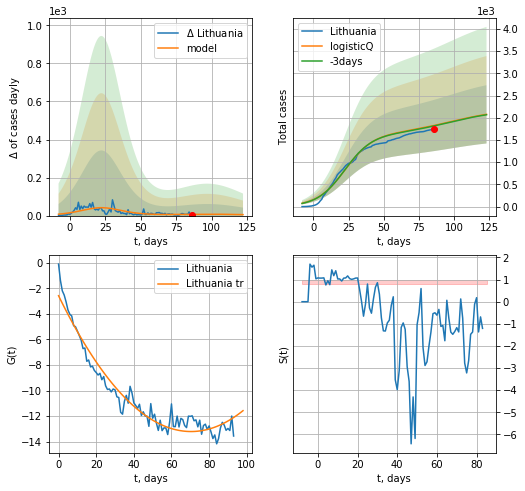

Lithuania data at: 2020-06-11
+3 day model MAPE: 0.005345
model: logisticQ
coeffs: [ 1.62769370e+03  2.68131282e-07  2.25078532e+01 -3.75439237e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.315719
forecast at the end of period: +37 days
	 deltaDaycases: 5
	 total cases: 2076 ± 655
	 total death: 87 ± 82
trend coefficient of determination: 0.943848
 intercept_: -2.5776063212553506
 coeffs_: [ 0.         -0.30187514  0.00214399]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


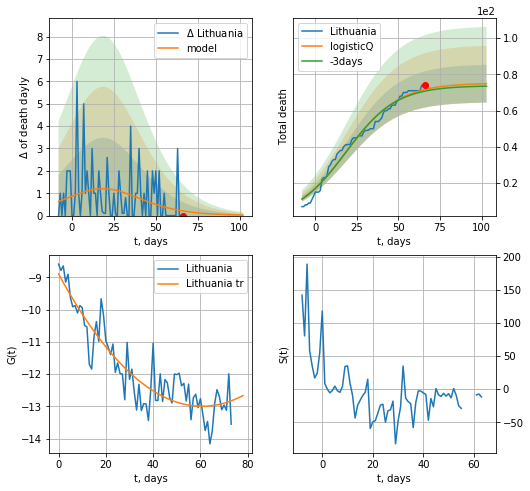

Lithuania data at: 2020-06-11
+3 day model MAPE: 0.013294
model: logisticQ
coeffs: [ 7.52366950e+01  4.54522457e-07  1.89986991e+01 -1.40653538e+05]
rational stdev: 0.139502
forecast at the end of period: +37 days
	 total death: 74 ± 10
trend coefficient of determination: 0.822453
 intercept_: -8.895899974750858
 coeffs_: [ 0.         -0.13522439  0.00111389]


In [356]:
#x = forecast('Lithuania',dfLT[10-4:],d1,6*7-1,cases='active')
x = forecastRRR('Lithuania',dfLT[:],d1,16*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Lithuania',dfLT[20:],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


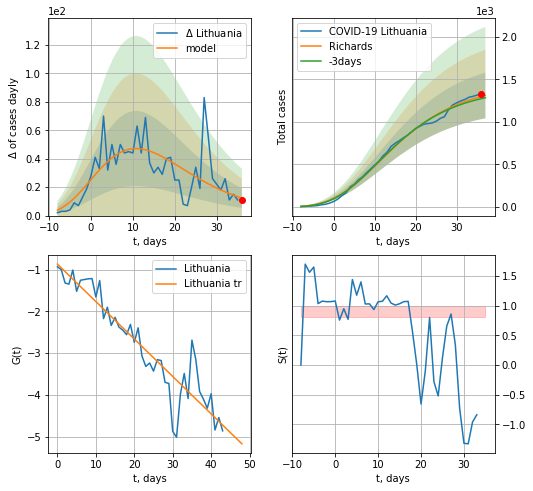

Lithuania data at: 2020-06-11
+3 day model MAPE: 0.021066
model: Richards
coeffs: [ 1.45212959e+03  9.67658542e+00 -4.16678055e+01  9.16998413e-03]
rational stdev: 0.205046
forecast at the end of period: +1 days
	 deltaDaycases: 12
	 total cases: 1312 ± 269
	 total death: 55 ± 33
trend coefficient of determination: 0.866665
 intercept: -0.867769
 slope: -0.089640


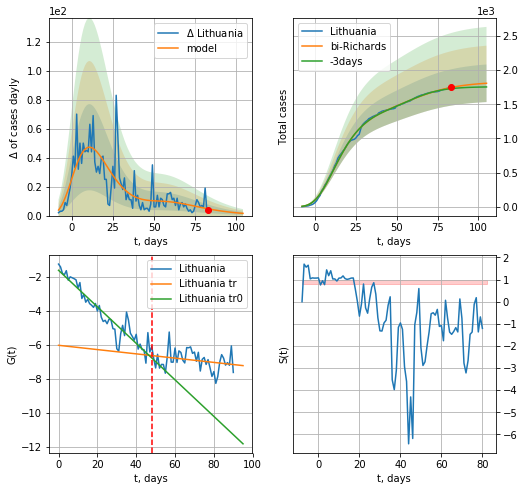

Lithuania data at: 2020-06-11
+3 day model MAPE: 0.010710
model: bi-Richards
coeffs: [3.81123372e+02 3.01344810e-01 3.55602076e+01 2.04818264e-01]
rational stdev: 0.152077
forecast at the end of period: +22 days
	 deltaDaycases: 1
	 total cases: 1808 ± 275
	 total death: 76 ± 34
bi-Richards approximation splitting point: 48
trend coefficient of determination: 0.898101
 intercept: -1.609495
 slope: -0.107375
trend coefficient of determination: 0.072194
 intercept: -6.018996
 slope: -0.012566


In [359]:
vL = 48
x = forecastRR('Lithuania',dfLT[3:vL],d1,11*7-1-dT,addpred=False,xcoef=RkoreaCoeffs)#
xx = forecast2RR('Lithuania',dfLT[3:],d1,14*7-1-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)#
#xx = forecast2R('Lithuania',dfLT[:],d1,2*7-1,x,shift=1.0,addpred=True,xcoef=[0.25,1.,1.5])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


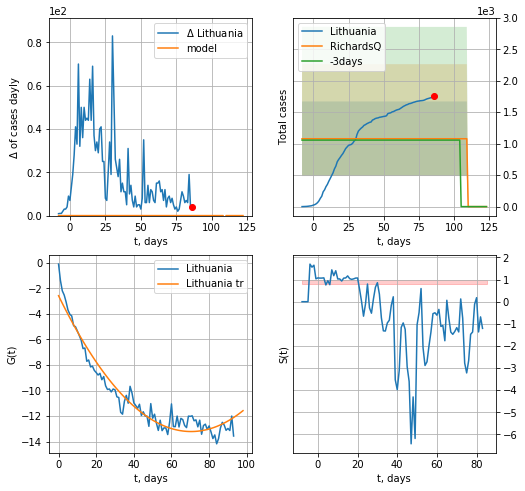

Lithuania data at: 2020-06-11
+3 day model MAPE: 0.020631
model: RichardsQ
coeffs: [ 1.07846421e+03 -1.93348837e+00 -1.39595503e+02  1.09854014e+02
  2.24553966e-01]
rational stdev: 0.549282
forecast at the end of period: +37 days
	 deltaDaycases: 0
	 total cases: 0 ± 0
	 total death: 0 ± 0
trend coefficient of determination: 0.943848
 intercept_: -2.5776063212553506
 coeffs_: [ 0.         -0.30187514  0.00214399]


In [360]:
x = forecastQR('Lithuania',dfLT[:],d1,16*7-dT,addpred=False,xcoef=[0.35,.52,4.,1.,1.])

LX
          date   cases  active  death
92 2020-06-07  4039.0      30  110.0
93 2020-06-08  4040.0      29  110.0
94 2020-06-09  4046.0      34  110.0
95 2020-06-10  4049.0      35  110.0
96 2020-06-11  4052.0      32  110.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


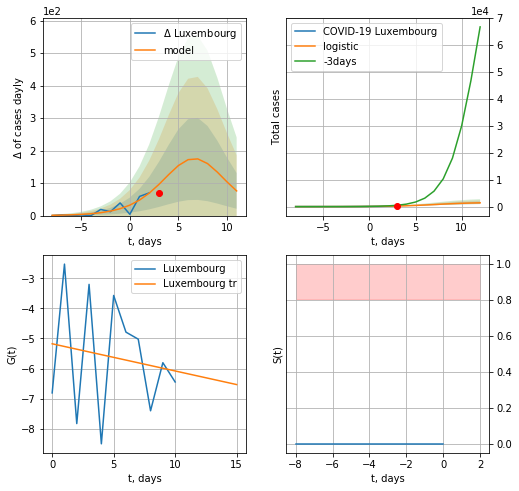

Luxembourg data at: 2020-06-11
model: logistic
coeffs:  [1.56298312e+03 4.51684200e-01 7.13428385e+00]
rational stdev:  0.3215238047871676
forecast at the end of period: +9 days
	 deltaDaycases:  75
	 total cases:  1406 ± 452
	 total death:  38 ± 36
trend coefficient of determination: 0.022967
 intercept: -5.176630
 slope: -0.090347


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


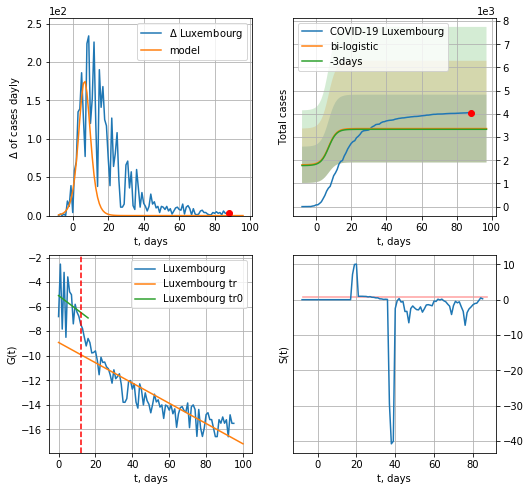

Luxembourg data at: 2020-06-11
+3 day model MAPE: 0.009513154422357572
model: bi-logistic
coeffs:  [1602.59515455   -6.32027795  237.96681805] [1.56298312e+03 4.51684200e-01 7.13428385e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.4338284328189722
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  3365 ± 1460
	 total death:  91 ± 118
bi-logistic approximation splitting point: 12
trend0 coefficient of determination: 0.045986
 intercept: -5.098250
 slope: -0.113861
trend coefficient of determination: 0.816108
 intercept: -8.919818
 slope: -0.082644


In [247]:
dfLX = read_df(pd.DataFrame(),"LX")
x = forecast("Luxembourg",dfLX[:12],d1,12*7-dT,pMAPE=False)
xx = forecast2("Luxembourg",dfLX[:],d1,12*7-dT,x,vL=12,addpred=True,xcoef=[0.25/2,1.,2.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


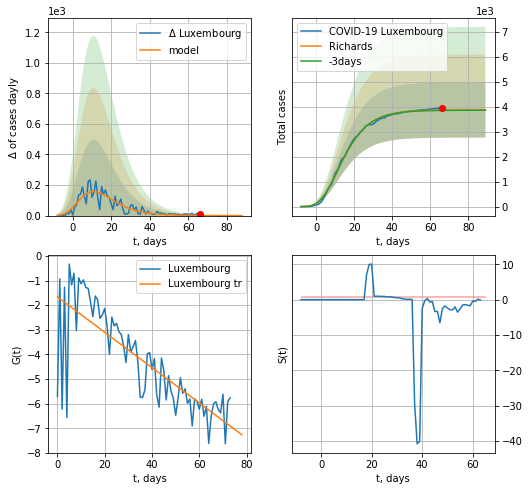

Luxembourg data at: 2020-06-11
+3 day model MAPE: 0.003345
model: Richards
coeffs: [ 3.88162927e+03  1.99569941e+01 -3.56216724e+01  5.55736951e-03]
rational stdev: 0.285969
forecast at the end of period: +23 days
	 deltaDaycases: 0
	 total cases: 3880 ± 1109
	 total death: 105 ± 90
trend coefficient of determination: 0.626779
 intercept: -1.663811
 slope: -0.071855


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


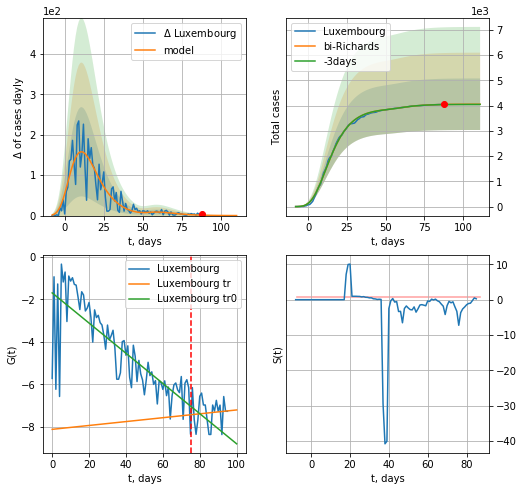

Luxembourg data at: 2020-06-11
+3 day model MAPE: 0.001204
model: bi-Richards
coeffs: [1.71259361e+02 1.68705130e+01 1.58249662e+01 6.49945186e-03]
rational stdev: 0.251650
forecast at the end of period: +23 days
	 deltaDaycases: 0
	 total cases: 4052 ± 1019
	 total death: 110 ± 83
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.629426
 intercept: -1.689990
 slope: -0.071028
trend coefficient of determination: 0.006517
 intercept: -8.111555
 slope: 0.009128


In [248]:
vL = 75
x = forecastRR("Luxembourg",dfLX[:vL],d1,14*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Luxembourg",dfLX[:],d1,14*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


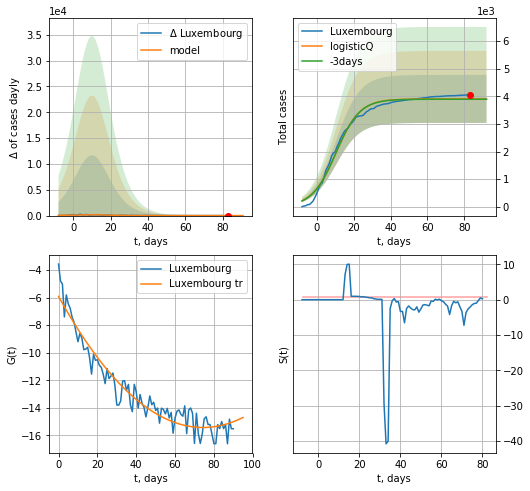

Luxembourg data at: 2020-06-11
+3 day model MAPE: 0.002605
model: logisticQ
coeffs: [ 3.90435977e+03  5.24374569e-07  1.04124771e+01 -2.93694555e+05]
rational stdev: 0.222530
forecast at the end of period: +9 days
	 deltaDaycases: 0
	 total cases: 3904 ± 868
	 total death: 105 ± 70
trend coefficient of determination: 0.926732
 intercept_: -5.913510812577864
 coeffs_: [ 0.         -0.25556811  0.00171692]


In [249]:
x = forecastRRR("Luxembourg",dfLX[5:],d1,12*7-dT,addpred=False,xcoef=koreaCoeffs)

ED
           date    cases   active   death
99  2020-06-07  43120.0  18479.0  3621.0
100 2020-06-08  43378.0  18716.0  3642.0
101 2020-06-09  43917.0  19207.0  3690.0
102 2020-06-10  44440.0  18858.0  3720.0
103 2020-06-11  44440.0  18858.0  3720.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

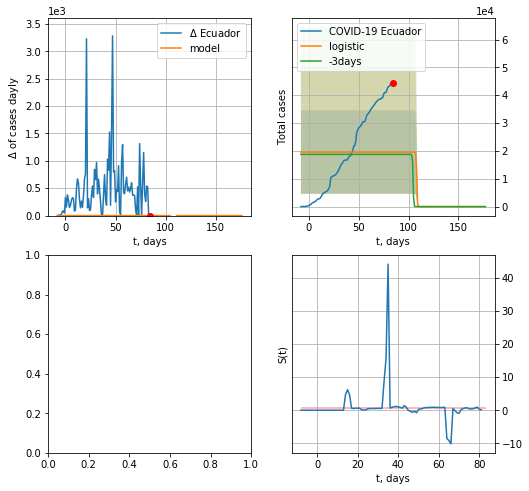

In [250]:
dfED = read_df(pd.DataFrame(),"ED")
x = forecast("Ecuador",dfED[11:],d1,24*7-dT)
#xx = forecast2(c,adf[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


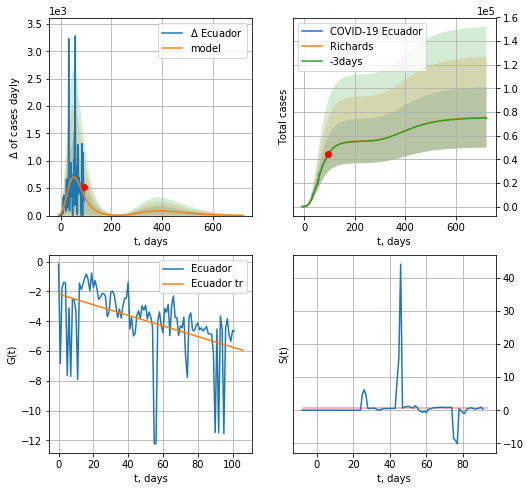

Ecuador data at: 2020-06-10
+3 day model MAPE: 0.002664
model: Richards
coeffs: [ 5.56370732e+04  1.71139239e+00 -5.90146633e+01  2.03969198e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.338321
forecast at the end of period: +626 days
	 deltaDaycases: 4
	 total cases: 75425 ± 25518
	 total death: 6313 ± 6407
trend coefficient of determination: 0.200982
 intercept: -2.176259
 slope: -0.035608


In [264]:
x = forecastRR("Ecuador",dfED[:],d1,100*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


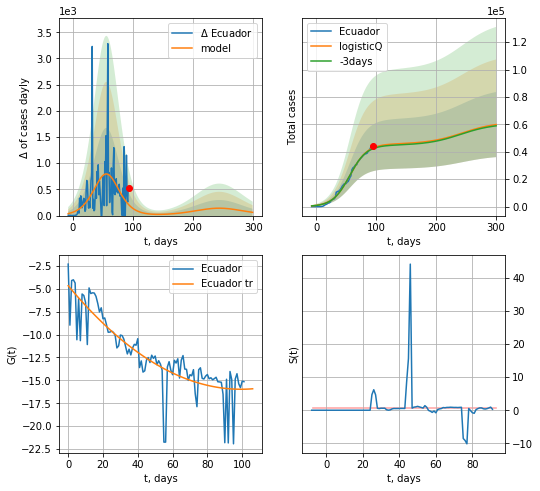

Ecuador data at: 2020-06-10
+3 day model MAPE: 0.013384
model: logisticQ
coeffs: [ 4.56914804e+04  6.77526320e-07  5.59348469e+01 -1.02607933e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.396788
forecast at the end of period: +206 days
	 deltaDaycases: 61
	 total cases: 59886 ± 23762
	 total death: 5013 ± 5967
trend coefficient of determination: 0.736212
 intercept_: -4.658098647204053
 coeffs_: [ 0.         -0.22775968  0.00114629]


In [265]:
x = forecastRRR("Ecuador",dfED[:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

FI
           date   cases  active  death
103 2020-06-07  6981.0     858  323.0
104 2020-06-08  7001.0     878  323.0
105 2020-06-09  7025.0     901  324.0
106 2020-06-10  7040.0     916  324.0
107 2020-06-11  7064.0     539  325.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


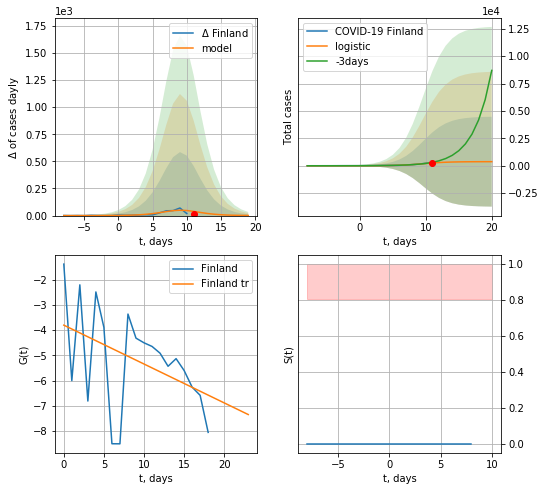

Finland data at: 2020-06-11
+3 day model MAPE: 0.3536794792474036
model: logistic
coeffs:  [373.20900186   0.53490302   9.59276199]
rational stdev:  11.028448708024662
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  371 ± 4100
	 total death:  17 ± 562
trend coefficient of determination: 0.182614
 intercept: -3.802910
 slope: -0.153962


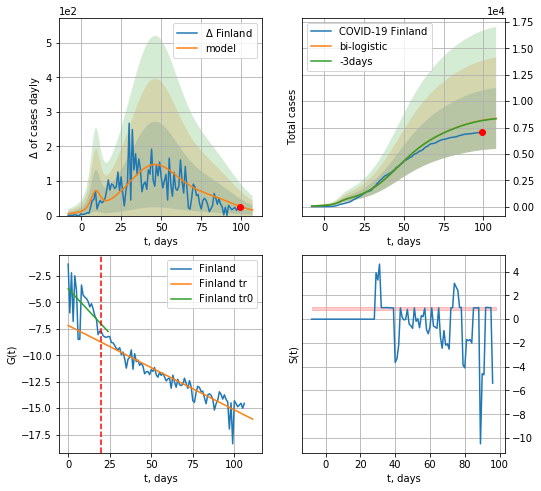

Finland data at: 2020-06-11
+3 day model MAPE: 0.003908982650050144
model: bi-logistic
coeffs:  [6.55432229e+03 8.67844906e-02 4.59223171e+01] [373.20900186   0.53490302   9.59276199]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.3452684460655798
forecast at the end of period: +9 days
	 deltaDaycases:  15
	 total cases:  8372 ± 2890
	 total death:  385 ± 398
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.234981
 intercept: -3.717136
 slope: -0.168257
trend coefficient of determination: 0.891169
 intercept: -7.184107
 slope: -0.079815


In [251]:
dfFI = read_df(pd.DataFrame(),"FI")
x = forecast("Finland",dfFI[:20],d1,7*12-dT)
xx = forecast2("Finland",dfFI[:],d1,12*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


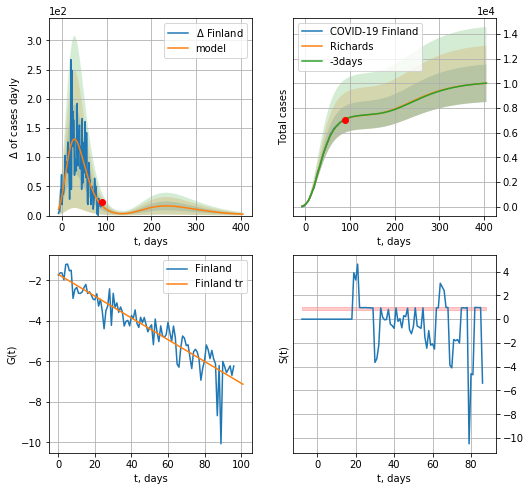

Finland data at: 2020-06-11
+3 day model MAPE: 0.001270
model: Richards
coeffs: [ 7.45639665e+03  8.00050215e-01 -2.83675541e+01  6.14641687e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.152038
forecast at the end of period: +317 days
	 deltaDaycases: 2
	 total cases: 10013 ± 1522
	 total death: 460 ± 209
trend coefficient of determination: 0.851620
 intercept: -1.708083
 slope: -0.053707


In [252]:
x = forecastRR("Finland",dfFI[10:],d1,56*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


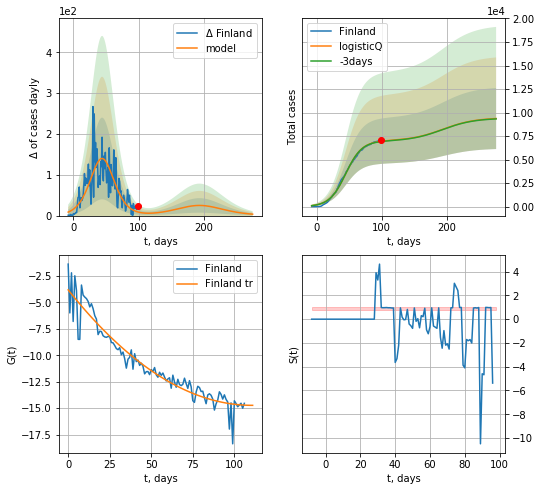

Finland data at: 2020-06-11
+3 day model MAPE: 0.004412
model: logisticQ
coeffs: [ 6.98058544e+03  4.46995905e-07  4.44612480e+01 -1.78948593e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.346595
forecast at the end of period: +177 days
	 deltaDaycases: 3
	 total cases: 9365 ± 3246
	 total death: 430 ± 447
trend coefficient of determination: 0.915225
 intercept_: -3.8224279098249427
 coeffs_: [ 0.         -0.19727493  0.00089149]


In [253]:
x = forecastRRR("Finland",dfFI[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

BL
          date  cases  active  death
89 2020-06-07   2727  1019.0  160.0
90 2020-06-08   2810  1059.0  164.0
91 2020-06-09   2889  1099.0  167.0
92 2020-06-10   2993  1162.0  167.0
93 2020-06-11   3086  1230.0  168.0


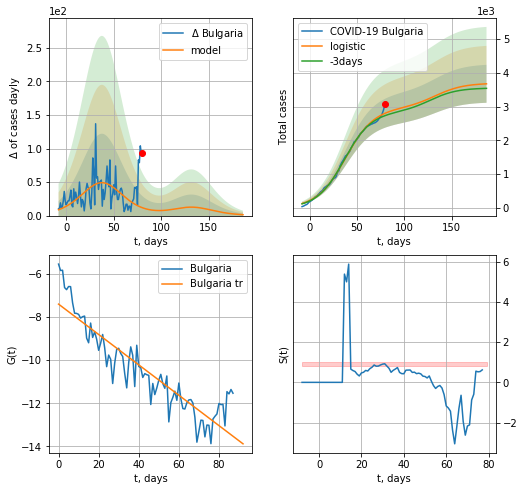

Bulgaria data at: 2020-06-11
+3 day model MAPE: 0.02621399117443659
model: logistic
coeffs:  [2.95401958e+03 6.63988153e-02 3.79872326e+01]
scenario coeffs:  [0.25, 1.0, 3.5]
rational stdev:  0.1527509851943037
forecast at the end of period: +107 days
	 deltaDaycases:  1
	 total cases:  3672 ± 560
	 total death:  199 ± 91
trend coefficient of determination: 0.822244
 intercept: -7.412677
 slope: -0.070272


In [254]:
dfBL = read_df(pd.DataFrame(),"BL").fillna(0)
try:
    x = forecast('Bulgaria',dfBL[5:],d1,26*7-dT,shift=1.0,addpred=True,xcoef=[0.25,1.,3.5])
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


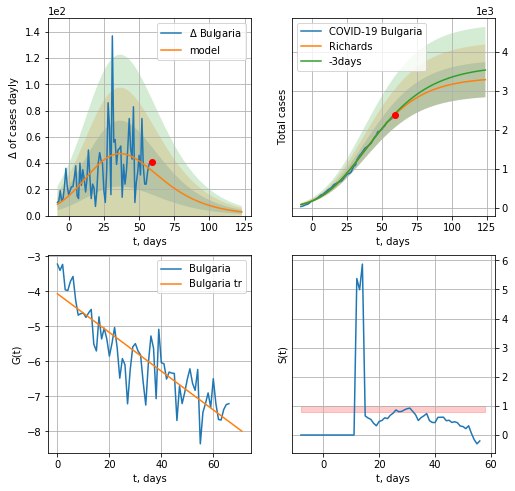

Bulgaria data at: 2020-06-11
+3 day model MAPE: 0.010908
model: Richards
coeffs: [3.34426454e+03 1.13426717e-01 1.73921226e+01 4.05383434e-01]
rational stdev: 0.136836
forecast at the end of period: +65 days
	 deltaDaycases: 2
	 total cases: 3283 ± 449
	 total death: 178 ± 73
trend coefficient of determination: 0.778364
 intercept: -4.070379
 slope: -0.055268


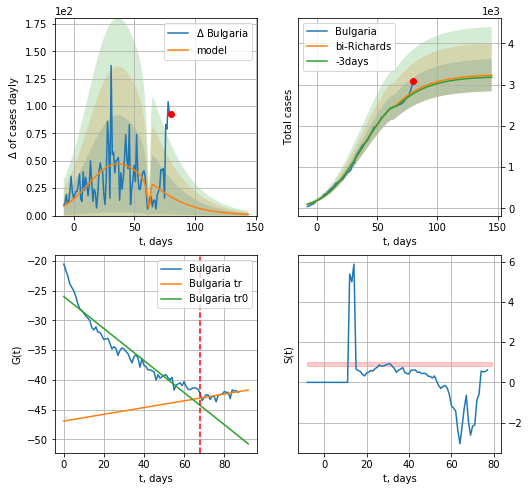

Bulgaria data at: 2020-06-11
+3 day model MAPE: 0.016768
model: bi-Richards
coeffs: [-93.68225521   0.47845709  63.55793941   4.80347087]
rational stdev: 0.121025
forecast at the end of period: +65 days
	 deltaDaycases: 1
	 total cases: 3227 ± 390
	 total death: 175 ± 63
bi-Richards approximation splitting point: 68
trend coefficient of determination: 0.911358
 intercept: -25.972302
 slope: -0.269278
trend coefficient of determination: 0.352116
 intercept: -46.917030
 slope: 0.056773


In [255]:
vL = 73
x = forecastRR('Bulgaria',dfBL[5:vL],d1,20*7-dT,shift=1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Bulgaria',dfBL[5:],d1,20*7-dT,x,shift=1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


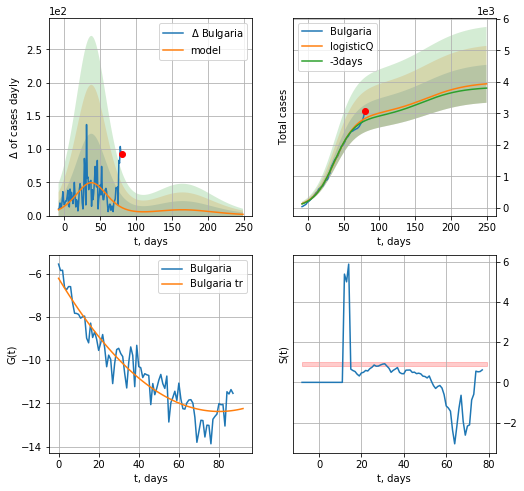

Bulgaria data at: 2020-06-11
+3 day model MAPE: 0.026323
model: logisticQ
coeffs: [ 2.95333147e+03  8.99978264e-07  3.79811840e+01 -7.37506257e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.152892
forecast at the end of period: +170 days
	 deltaDaycases: 1
	 total cases: 3940 ± 602
	 total death: 214 ± 98
trend coefficient of determination: 0.901318
 intercept_: -6.217065208524144
 coeffs_: [ 0.         -0.15369189  0.00095888]


In [256]:
x = forecastRRR('Bulgaria',dfBL[5:],d1,35*7-dT,shift=1.0,addpred=True,xcoef=koreaCoeffs)

TH
           date   cases  active  death
101 2020-06-07  3119.0    88.0   58.0
102 2020-06-08  3121.0    90.0   58.0
103 2020-06-09  3125.0    86.0   58.0
104 2020-06-10  3125.0    80.0   58.0
105 2020-06-11  3129.0    84.0   58.0
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


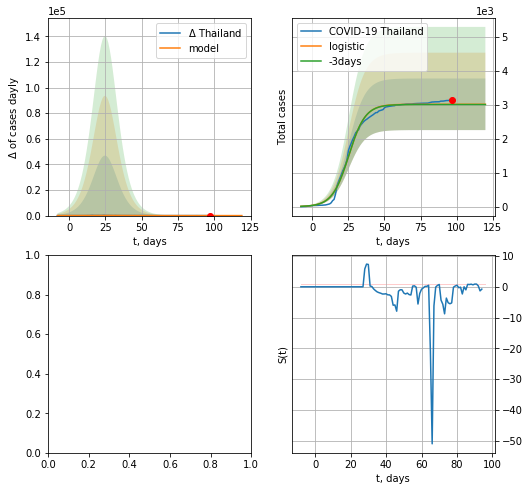

In [257]:
dfTH = read_df(pd.DataFrame(),"TH")
dfTH = dfTH.fillna(0)
try:
    x = forecast("Thailand",dfTH[:],d1,14*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])
except:
    print("Exception occurs")
#xx = forecast2("Thailand",dfTH[:],d1,8*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

In [278]:
#x = forecastRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


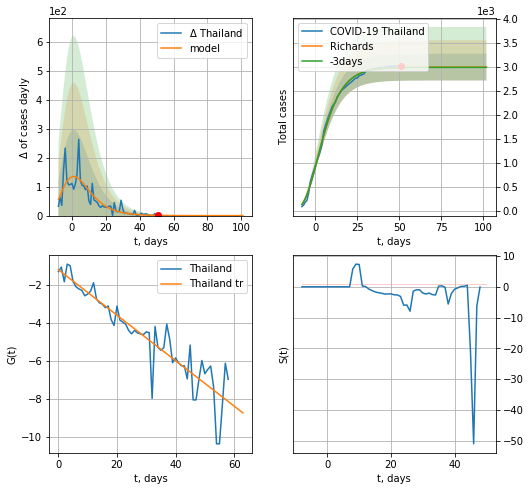

Thailand data at: 2020-06-11
+3 day model MAPE: 0.001961
model: Richards
coeffs: [ 2.99626186e+03  1.57389308e+01 -3.79335147e+01  7.82164356e-03]
rational stdev: 0.093313
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 2996 ± 279
	 total death: 55 ± 15
trend coefficient of determination: 0.845848
 intercept: -1.208266
 slope: -0.119672


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:647: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

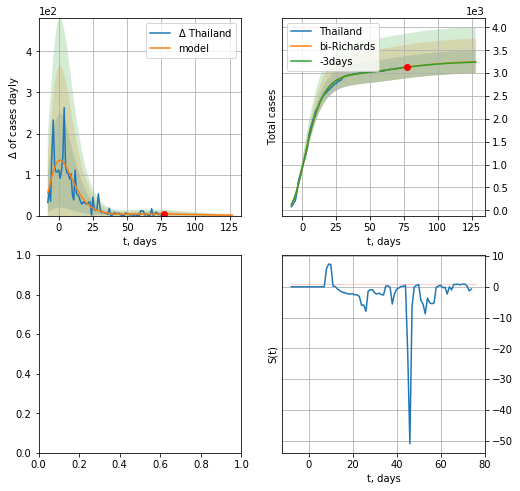

In [259]:
vL = 80
x = forecastRR("Thailand",dfTH[20:vL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Thailand",dfTH[20:],d1,18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:571: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

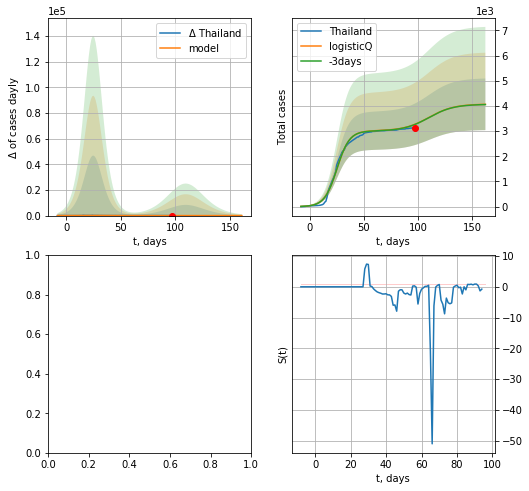

In [260]:
x = forecastRRR("Thailand",dfTH[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

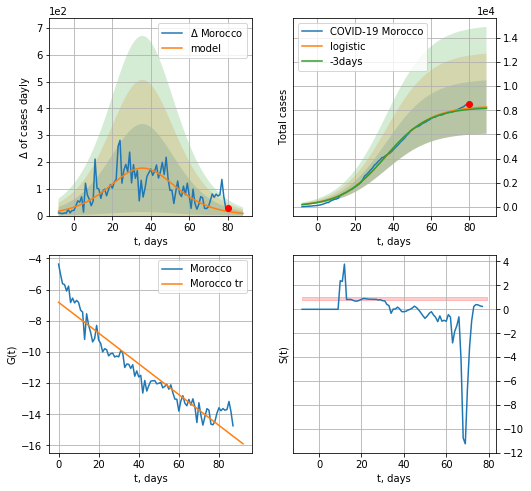

Morocco data at: 2020-06-11
+3 day model MAPE: 0.012070898293777032
model: logistic
coeffs:  [8.36030339e+03 8.48205733e-02 3.61275426e+01]
rational stdev:  0.2676277217484139
forecast at the end of period: +9 days
	 deltaDaycases:  8
	 total cases:  8267 ± 2212
	 total death:  204 ± 163
trend coefficient of determination: 0.901033
 intercept: -6.812629
 slope: -0.098704


In [261]:
x = forecast("Morocco",dfMR[5:],d1,12*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


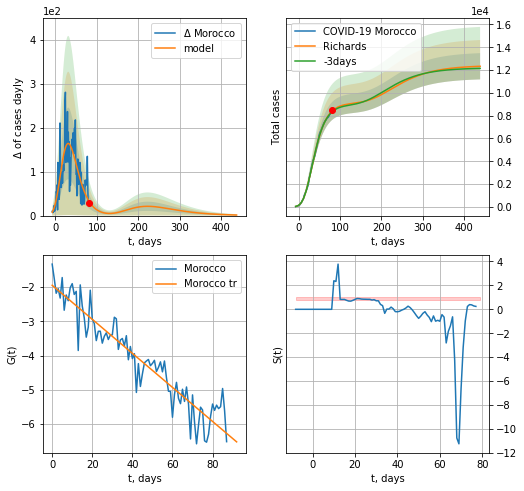

Morocco data at: 2020-06-11
+3 day model MAPE: 0.007990
model: Richards
coeffs: [ 9.10735131e+03  5.61214908e-01 -1.53926811e+01  9.14037098e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.093373
forecast at the end of period: +359 days
	 deltaDaycases: 1
	 total cases: 12333 ± 1151
	 total death: 304 ± 85
trend coefficient of determination: 0.886311
 intercept: -1.951656
 slope: -0.049634


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


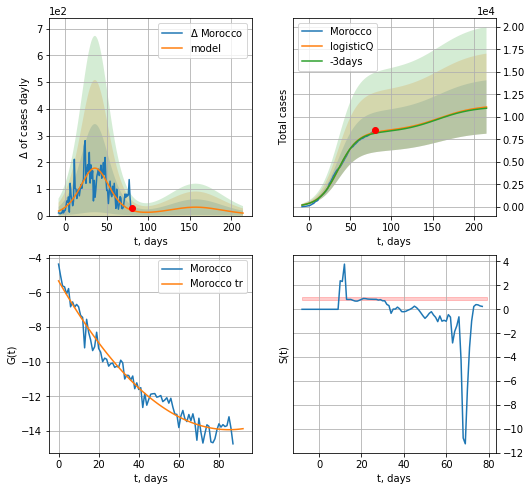

Morocco data at: 2020-06-11
+3 day model MAPE: 0.011875
model: logisticQ
coeffs: [ 8.35959841e+03  7.34814854e-07  3.61263511e+01 -1.15382340e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.267748
forecast at the end of period: +135 days
	 deltaDaycases: 9
	 total cases: 11086 ± 2968
	 total death: 274 ± 220
trend coefficient of determination: 0.968573
 intercept_: -5.330046233585431
 coeffs_: [ 0.         -0.20214696  0.00118904]


In [262]:
x = forecastRR("Morocco",dfMR[5:],d1,62*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRRR("Morocco",dfMR[5:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

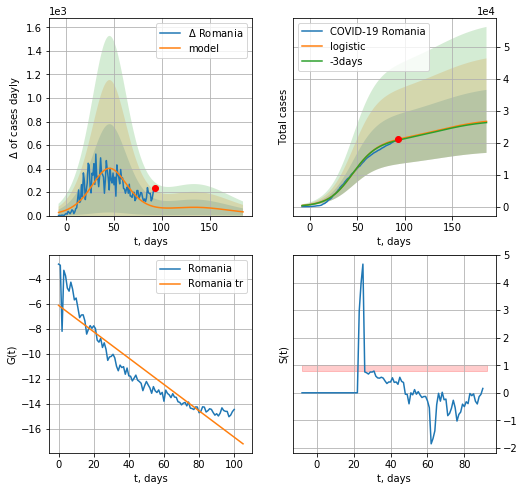

Romania data at: 2020-06-11
+3 day model MAPE: 0.013244499005521746
model: logistic
coeffs:  [2.04360442e+04 7.71740405e-02 4.55887416e+01]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.36944792934411474
forecast at the end of period: +93 days
	 deltaDaycases:  31
	 total cases:  26657 ± 9848
	 total death:  1722 ± 1908
trend coefficient of determination: 0.865987
 intercept: -6.110094
 slope: -0.105713


In [263]:
#dfRM = read_df(pd.DataFrame(),"RM")
x = forecast("Romania",dfRM[5:],d1,24*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


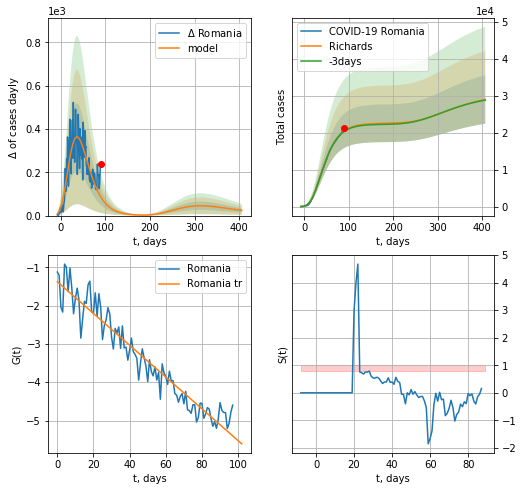

Romania data at: 2020-06-11
+3 day model MAPE: 0.007581
model: Richards
coeffs: [ 2.26219135e+04  4.14150752e+00 -6.68976922e+01  1.06035970e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.226016
forecast at the end of period: +317 days
	 deltaDaycases: 23
	 total cases: 29021 ± 6559
	 total death: 1875 ± 1271
trend coefficient of determination: 0.920414
 intercept: -1.376816
 slope: -0.041485


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


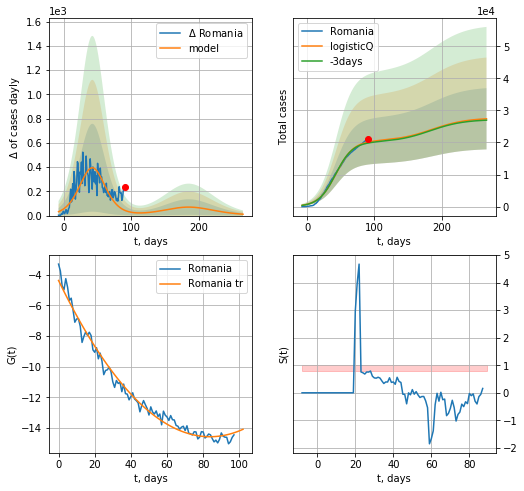

Romania data at: 2020-06-11
+3 day model MAPE: 0.014490
model: logisticQ
coeffs: [ 2.04469948e+04  3.86327045e-07  4.26069562e+01 -1.99232109e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.348618
forecast at the end of period: +177 days
	 deltaDaycases: 11
	 total cases: 27390 ± 9548
	 total death: 1770 ± 1851
trend coefficient of determination: 0.983582
 intercept_: -4.36871922792897
 coeffs_: [ 0.         -0.24377623  0.00145566]


In [264]:
x = forecastRR("Romania",dfRM[8:],d1,56*7-dT,addpred=True,xcoef=RkoreaCoeffs)
xx = forecastRRR("Romania",dfRM[8:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

In [265]:
#x = forecastRRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.35/4,.5,2.2,1])

EU
           date    cases  active     death
120 2020-06-07  1192778  169100  128225.0
121 2020-06-08  1195695  169546  128435.0
122 2020-06-09  1199205  167229  128757.0
123 2020-06-10  1202897  166613  129007.0
124 2020-06-11  1207023  164487  129158.0


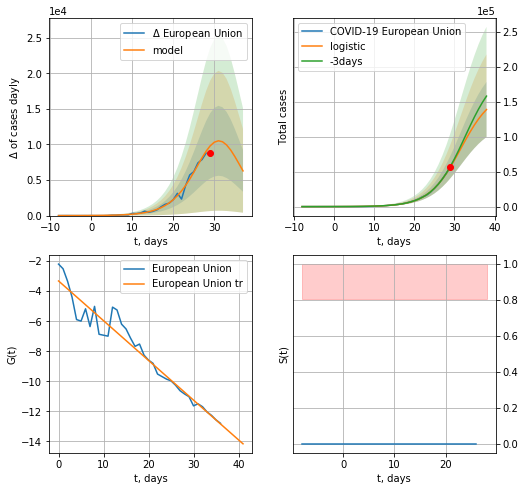

European Union data at: 2020-06-11
+3 day model MAPE: 0.026537291805373914
model: logistic
coeffs:  [1.65818576e+05 2.54045102e-01 3.15946527e+01]
rational stdev:  0.28380142507641165
forecast at the end of period: +9 days
	 deltaDaycases:  6283
	 total cases:  138589 ± 39332
	 total death:  14829 ± 12625
trend coefficient of determination: 0.942451
 intercept: -3.318380
 slope: -0.264437


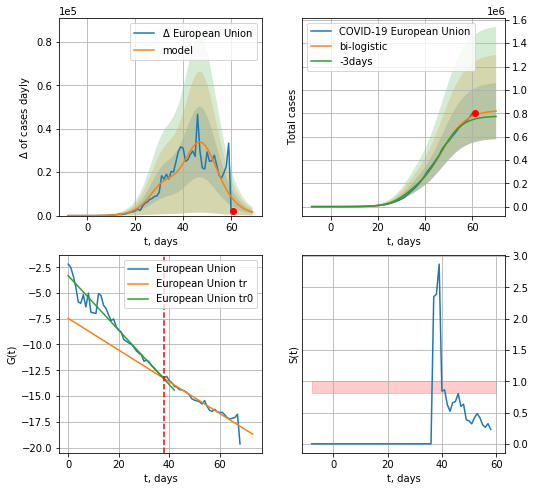

European Union data at: 2020-06-11
+3 day model MAPE: 0.046518861456193536
model: bi-logistic
coeffs:  [6.59401208e+05 2.01830792e-01 4.76685424e+01] [1.65818576e+05 2.54045102e-01 3.15946527e+01]
rational stdev:  0.2940888577461115
forecast at the end of period: +9 days
	 deltaDaycases:  1590
	 total cases:  818016 ± 240569
	 total death:  87532 ± 77226
bi-logistic approximation splitting point: 38
trend0 coefficient of determination: 0.946588
 intercept: -3.319965
 slope: -0.264305
trend coefficient of determination: 0.919570
 intercept: -7.459861
 slope: -0.154008


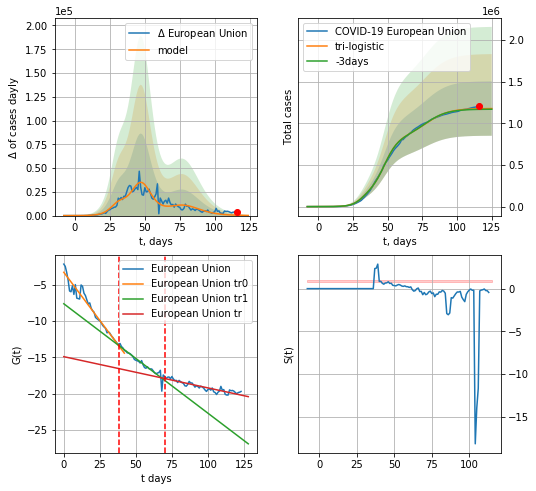

European Union data at: 2020-06-11
+3 day model MAPE: 0.006677328801054027
model: tri-logistic
coeffs:  [3.54739154e+05 1.21541331e-01 7.76476568e+01] [1.65818576e+05 2.54045102e-01 3.15946527e+01 6.59401208e+05
 2.01830792e-01 4.76685424e+01]
forecast rational stdev:  0.27740089541303636
forecast at the end of period: +9 days
	 deltaDaycases:  144
	 total cases:  1178839 ± 327011
	 total death:  126142 ± 104975
tri-logistic approximation splitting points: 38,70
trend0 coefficient of determination: 0.946588
 intercept: -3.319965
 slope: -0.264305
trend1 coefficient of determination: 0.917507
 intercept: -7.641441
 slope: -0.150225
trend coefficient of determination: 0.840772
 intercept: -14.903775
 slope: -0.042890


In [266]:
vL=38
vL1=70
dfEU = read_df(pd.DataFrame(),"EU")
x = forecast("European Union",dfEU[:vL],d1,12*7-dT)
xx = forecast2("European Union",dfEU[:vL1],d1,12*7-dT,x,vL=38,addpred=False,xcoef=[0.25,1.,1.5])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("European Union",dfEU,d1,12*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


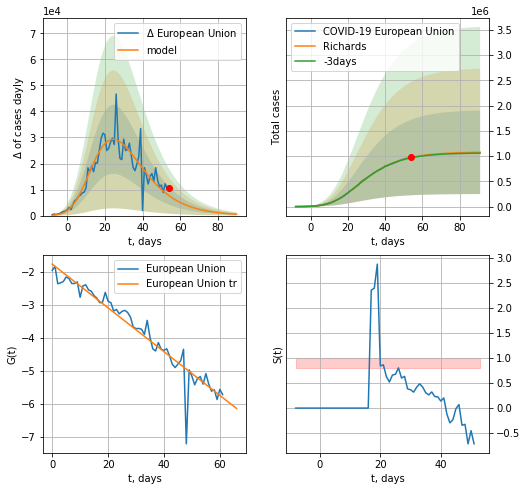

European Union data at: 2020-06-11
+3 day model MAPE: 0.007559
model: Richards
coeffs: [ 1.08235898e+06  8.91256786e-01 -6.99260106e+00  8.61059421e-02]
rational stdev: 0.768581
forecast at the end of period: +37 days
	 deltaDaycases: 539
	 total cases: 1075568 ± 826662
	 total death: 115091 ± 265370
trend coefficient of determination: 0.920526
 intercept: -1.769267
 slope: -0.066303


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


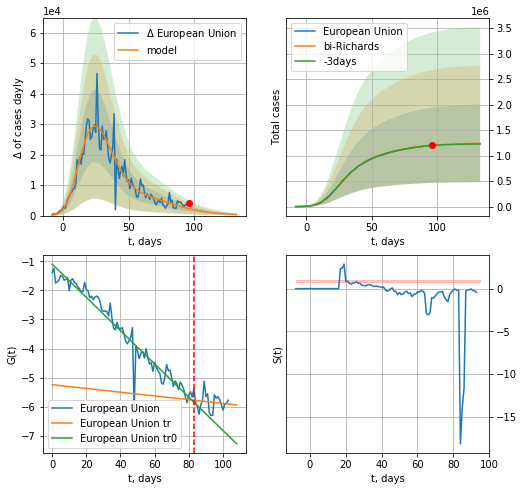

European Union data at: 2020-06-11
+3 day model MAPE: 0.003894
model: bi-Richards
coeffs: [ 1.64250457e+05  7.54581448e+00 -1.61904765e+01  7.28400245e-03]
rational stdev: 0.613088
forecast at the end of period: +37 days
	 deltaDaycases: 358
	 total cases: 1240261 ± 760389
	 total death: 132714 ± 244095
bi-Richards approximation splitting point: 83
trend coefficient of determination: 0.943065
 intercept: -1.093977
 slope: -0.057279
trend coefficient of determination: 0.017293
 intercept: -5.245463
 slope: -0.006438


In [267]:
vL = 83+20
x = forecastRR("European Union",dfEU[20:vL-20],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("European Union",dfEU[20:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


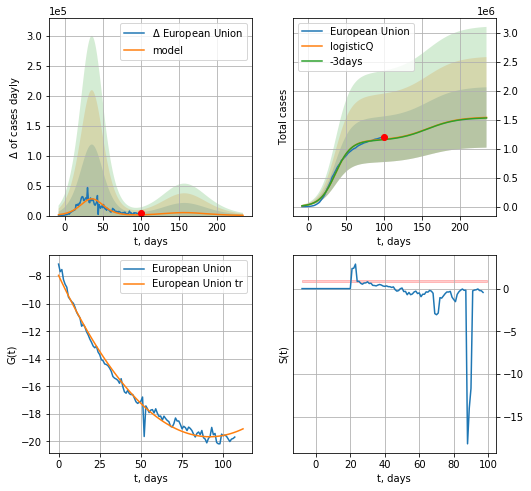

European Union data at: 2020-06-11
+3 day model MAPE: 0.006483
model: logisticQ
coeffs: [ 1.14479875e+06  3.28009563e-07  3.61030687e+01 -2.97096019e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.338464
forecast at the end of period: +135 days
	 deltaDaycases: 432
	 total cases: 1541439 ± 521721
	 total death: 164942 ± 167480
trend coefficient of determination: 0.988038
 intercept_: -7.939800744443287
 coeffs_: [ 0.         -0.25561976  0.00139378]


In [268]:
x = forecastRRR("European Union",dfEU[16:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/numpy/lib/function_base.py:1269: RuntimeWarning: invalid value encountered in subtract
  a = op(a[slice1], a[slice2])
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


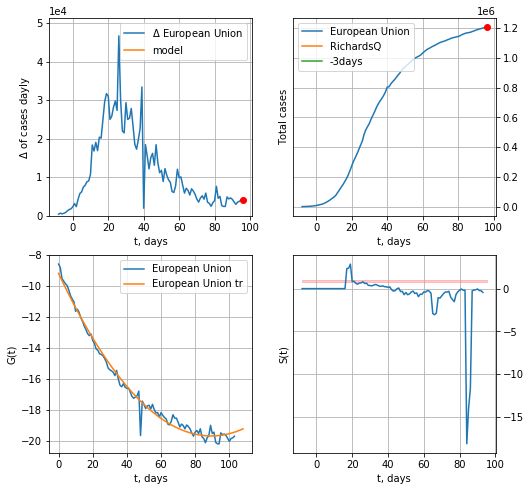

European Union data at: 2020-06-11
+3 day model MAPE: nan
model: RichardsQ
coeffs: [ 6.93582190e+05  4.76226347e+00 -1.34086860e+03  1.14116947e+03
 -2.36933149e+00]
S.Korea scenario coeffs: [ 3.69179628e-01  4.55901153e+01  3.02600169e-01 -6.49668395e+01
  2.33503320e-03]
rational stdev: 0.638999
forecast at the end of period: +23 days


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: invalid value encountered in double_scalars
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:115: RuntimeWarning: invalid value encountered in double_scalars


ValueError: cannot convert float NaN to integer

In [269]:
x = forecastQR("European Union",dfEU[20:],d1,14*7-dT,addpred=True,xcoef=QRkoreaCoeffs)

In [270]:
#x = forecastRR("Romania",dfRM[5:],d1,14*7-dT)

In [271]:
#x = forecastRRR("European Union",dfEU[:],d1,8*7-dT)

In [272]:
#x = forecastRRR("Romania",dfRM[5:],d1,18*7-dT,addpred=True,xcoef=[0.35,.5,3.,1.])

In [273]:
#dfIC[:]

IC
           date   cases  active  death
98  2020-06-07  1807.0       3   10.0
99  2020-06-08  1807.0       3   10.0
100 2020-06-09  1807.0       3   10.0
101 2020-06-10  1807.0       3   10.0
102 2020-06-11  1807.0       3   10.0


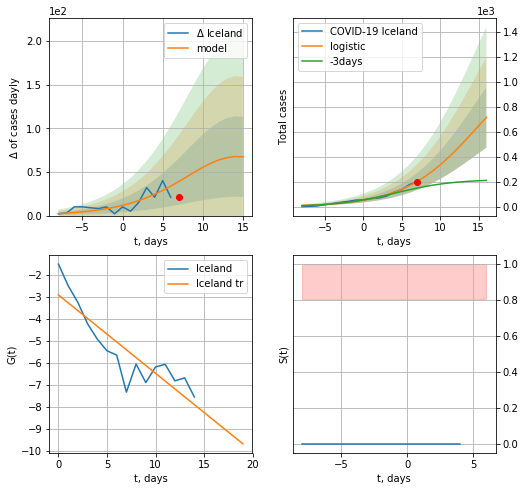

Iceland data at: 2020-06-11
+3 day model MAPE: 0.49229543132944575
model: logistic
coeffs:  [1.27194861e+03 2.12945173e-01 1.48141483e+01]
rational stdev:  0.3377978270267634
forecast at the end of period: +9 days
	 deltaDaycases:  67
	 total cases:  715 ± 241
	 total death:  3 ± 3
trend coefficient of determination: 0.778766
 intercept: -2.904405
 slope: -0.356109
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:245: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


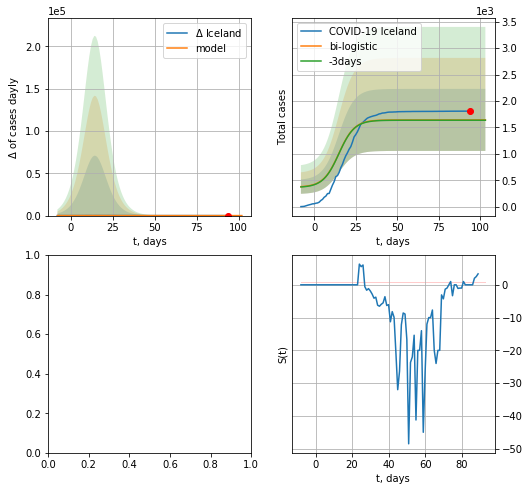

In [274]:
dfIC = read_df(pd.DataFrame(),"IC")
vL=16
try:
    x = forecast("Iceland",dfIC[:vL],d1,12*7-dT,addpred=False,xcoef=[0.25/2,1.,2])
    xx = forecast2("Iceland",dfIC[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25/4,1.,2],vL=vL)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


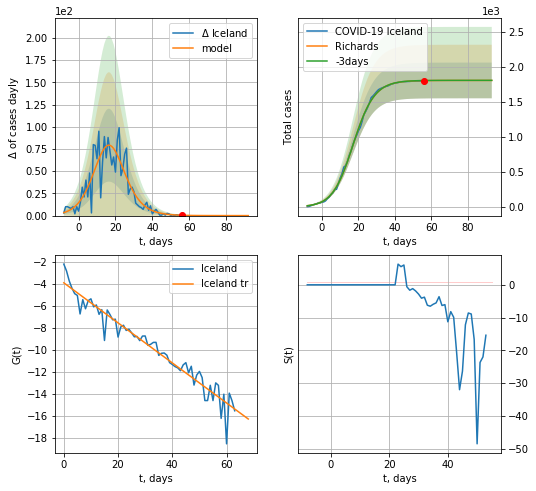

Iceland data at: 2020-06-11
+3 day model MAPE: 0.000574
model: Richards
coeffs: [1.80664071e+03 1.96329707e-01 1.60140797e+01 8.56236679e-01]
rational stdev: 0.141183
forecast at the end of period: +37 days
	 deltaDaycases: 0
	 total cases: 1806 ± 255
	 total death: 9 ± 3
trend coefficient of determination: 0.937183
 intercept: -3.923109
 slope: -0.181532


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:207: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:647: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

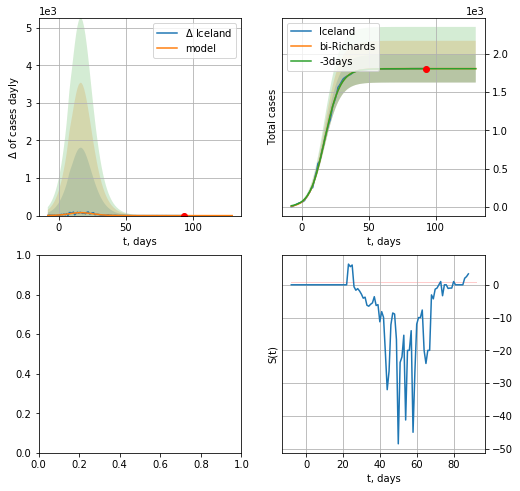

In [275]:
vL = 66
x = forecastRR("Iceland",dfIC[1:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Iceland",dfIC[1:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastRRR("Iceland",dfIC[:20],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:571: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

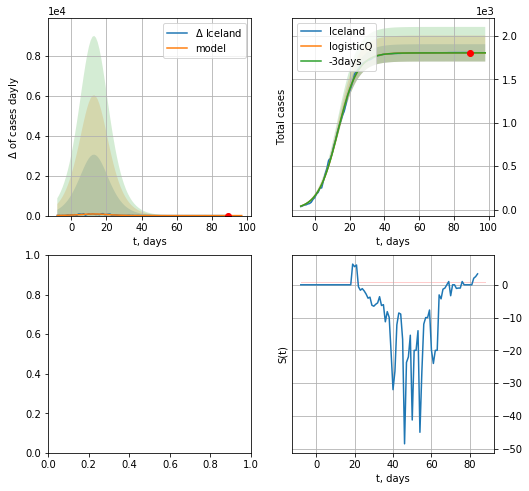

In [276]:
x = forecastRRR("Iceland",dfIC[5:],d1,12*7-dT,addpred=False,xcoef=[0.35/6,.5,4.,1.])

PM
          date  cases  active  death
89 2020-06-07  16425  5814.0  393.0
90 2020-06-08  16854  6055.0  398.0
91 2020-06-09  17233  6269.0  403.0
92 2020-06-10  17889  6499.0  413.0
93 2020-06-11  18586  7191.0  418.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


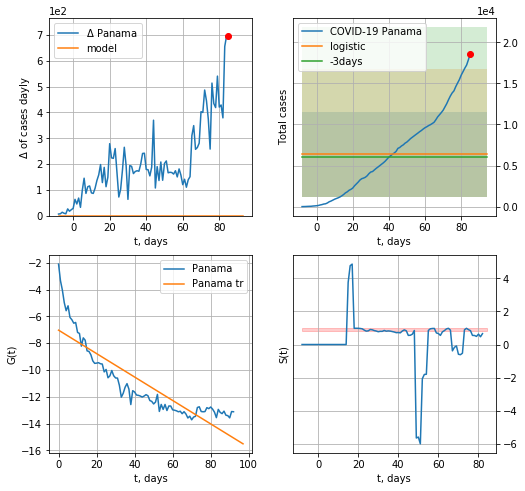

Panama data at: 2020-06-11
+3 day model MAPE: 0.0636035084540065
model: logistic
coeffs:  [ 6.36214894e+03 -4.82177321e+00  1.43772680e+02]
rational stdev:  0.8130716306322545
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  6362 ± 5172
	 total death:  143 ± 348
trend coefficient of determination: 0.770660
 intercept: -7.026652
 slope: -0.087410


In [277]:
dfPM = read_df(pd.DataFrame(),"PM").fillna(0)
x = forecast("Panama",dfPM[:],d1,12*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


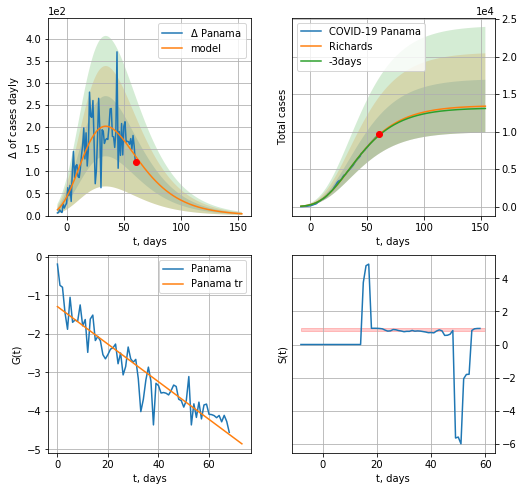

Panama data at: 2020-06-11
+3 day model MAPE: 0.008184
model: Richards
coeffs: [ 1.34885246e+04  2.34173945e+00 -6.38327516e+01  1.75366113e-02]
rational stdev: 0.263123
forecast at the end of period: +93 days
	 deltaDaycases: 4
	 total cases: 13388 ± 3522
	 total death: 301 ± 237
trend coefficient of determination: 0.871686
 intercept: -1.291480
 slope: -0.048815


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


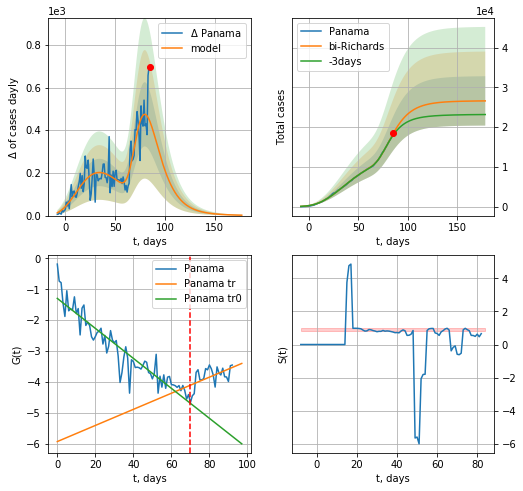

Panama data at: 2020-06-11
+3 day model MAPE: 0.025758
model: bi-Richards
coeffs: [1.31660960e+04 4.94583358e+00 3.24527940e+01 1.69591253e-02]
rational stdev: 0.233332
forecast at the end of period: +93 days
	 deltaDaycases: 1
	 total cases: 26613 ± 6209
	 total death: 598 ± 418
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.874351
 intercept: -1.295560
 slope: -0.048467
trend coefficient of determination: 0.285127
 intercept: -5.924006
 slope: 0.026034


In [278]:
vL = 70
x = forecastRR("Panama",dfPM[:vL],d1,24*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Panama",dfPM[:],d1,24*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


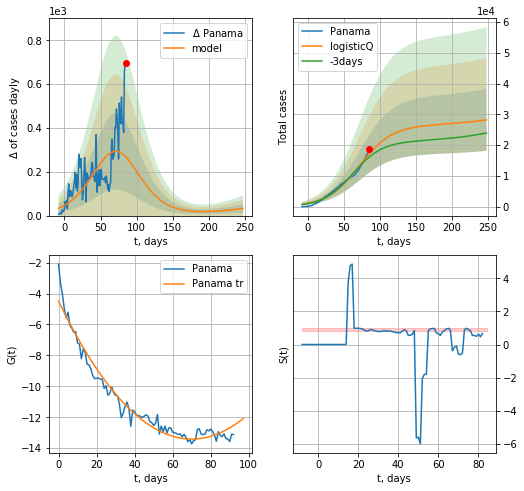

Panama data at: 2020-06-11
+3 day model MAPE: 0.066966
model: logisticQ
coeffs: [ 2.63988599e+04  4.14426691e-07  7.15436582e+01 -1.06932024e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.357225
forecast at the end of period: +163 days
	 deltaDaycases: 32
	 total cases: 28203 ± 10075
	 total death: 634 ± 679
trend coefficient of determination: 0.962643
 intercept_: -4.491942541165874
 coeffs_: [ 0.         -0.2545416   0.00181669]


In [279]:
x = forecastRRR("Panama",dfPM[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

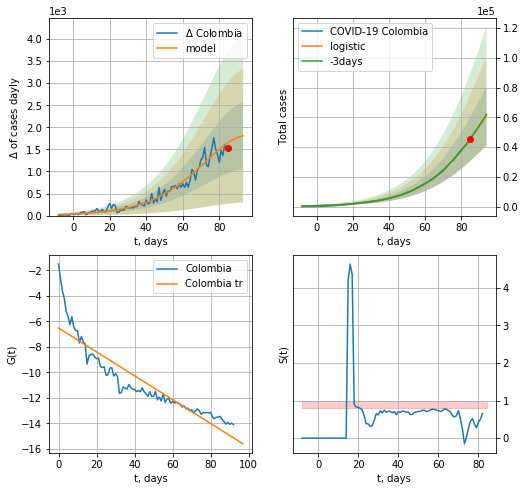

Colombia data at: 2020-06-11
+3 day model MAPE: 0.006921103035096315
model: logistic
coeffs:  [1.31743785e+05 5.52259602e-02 9.66289001e+01]
rational stdev:  0.32558017670409733
forecast at the end of period: +9 days
	 deltaDaycases:  1805
	 total cases:  61098 ± 19892
	 total death:  2010 ± 1963
trend coefficient of determination: 0.830374
 intercept: -6.524712
 slope: -0.093696


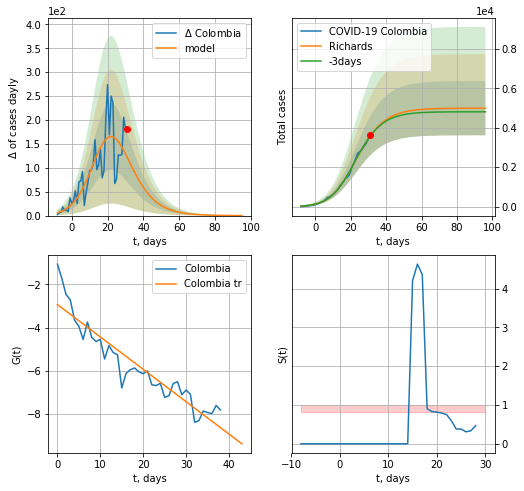

Colombia data at: 2020-06-11
+3 day model MAPE: 0.003507
model: Richards
coeffs: [4.99315067e+03 1.95979830e-01 1.78374870e+01 5.90307623e-01]
rational stdev: 0.275146
forecast at the end of period: +65 days
	 deltaDaycases: 0
	 total cases: 4992 ± 1373
	 total death: 164 ± 135
trend coefficient of determination: 0.874880
 intercept: -2.931794
 slope: -0.150492


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


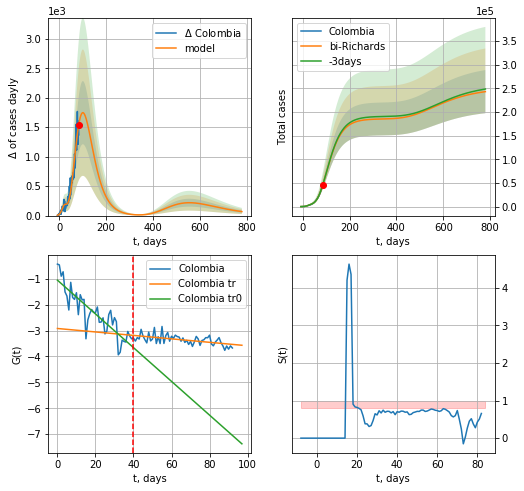

Colombia data at: 2020-06-11
+3 day model MAPE: 0.001342
model: bi-Richards
coeffs: [ 1.80512308e+05  9.96917629e-01 -3.49407025e+01  2.67280530e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.187673
forecast at the end of period: +695 days
	 deltaDaycases: 67
	 total cases: 242999 ± 45604
	 total death: 7997 ± 4502
bi-Richards approximation splitting point: 40
trend coefficient of determination: 0.752703
 intercept: -1.054194
 slope: -0.065124
trend coefficient of determination: 0.279320
 intercept: -2.919677
 slope: -0.006670


In [280]:
dfCB = dfCB.fillna(0)
x = forecast("Colombia",dfCB[:],d1,12*7-dT)
x = forecastRR("Colombia",dfCB[:40],d1,20*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Colombia",dfCB[:],d1,110*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=40)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


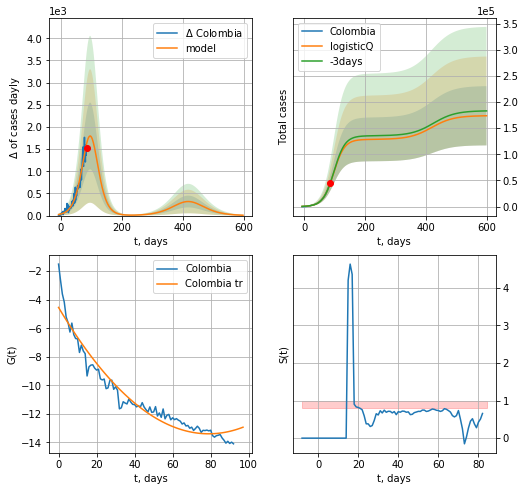

Colombia data at: 2020-06-11
+3 day model MAPE: 0.006432
model: logisticQ
coeffs: [ 1.28563429e+05  6.06235962e-06  9.58389592e+01 -9.12309540e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.326038
forecast at the end of period: +513 days
	 deltaDaycases: 8
	 total cases: 173801 ± 56666
	 total death: 5720 ± 5594
trend coefficient of determination: 0.940573
 intercept_: -4.541740234119644
 coeffs_: [ 0.         -0.22444826  0.00142126]


In [281]:
x = forecastRRR("Colombia",dfCB[:],d1,84*7-dT,addpred=True,xcoef=koreaCoeffs)

AR
          date    cases  active  death
95 2020-06-07  10154.0  2730.0  707.0
96 2020-06-08  10265.0  2751.0  715.0
97 2020-06-09  10382.0  2707.0  724.0
98 2020-06-10  10484.0  2678.0  732.0
99 2020-06-11  10589.0  2593.0  741.0


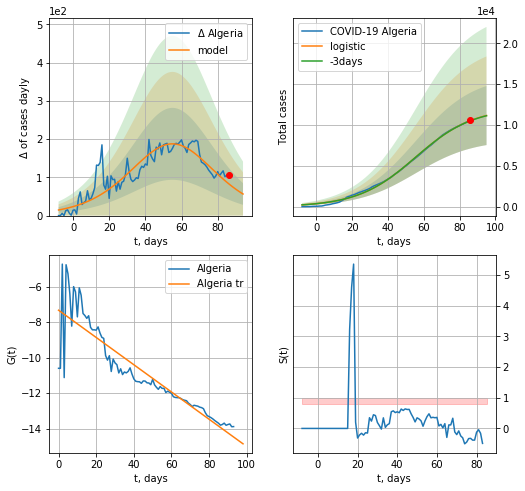

Algeria data at: 2020-06-11
+3 day model MAPE: 0.0019255003062071672
model: logistic
coeffs:  [1.21282806e+04 6.18868285e-02 5.54508202e+01]
rational stdev:  0.3237085863720043
forecast at the end of period: +9 days
	 deltaDaycases:  56
	 total cases:  11162 ± 3613
	 total death:  781 ± 758
trend coefficient of determination: 0.816520
 intercept: -7.324147
 slope: -0.076813


In [282]:
dfAR = read_df(pd.DataFrame(),"AR")
dfAR = dfAR.fillna(0)
x = forecast("Algeria",dfAR[5:],d1,12*7-dT)
#dfAG

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


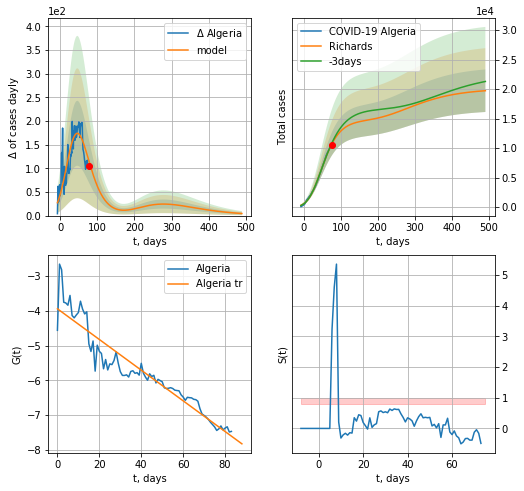

Algeria data at: 2020-06-11
+3 day model MAPE: 0.015512
model: Richards
coeffs: [1.47466616e+04 1.19503999e-01 1.42982871e+01 3.08820613e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.182727
forecast at the end of period: +415 days
	 deltaDaycases: 4
	 total cases: 19731 ± 3605
	 total death: 1380 ± 756
trend coefficient of determination: 0.892570
 intercept: -3.940103
 slope: -0.044233


In [283]:
x = forecastRR("Algeria",dfAR[15:],d1,70*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


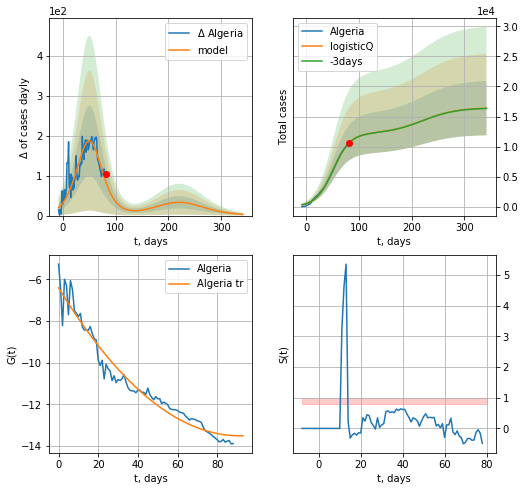

Algeria data at: 2020-06-11
+3 day model MAPE: 0.001354
model: logisticQ
coeffs: [ 1.21796795e+04  1.32399576e-06  5.06206559e+01 -4.63347794e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.274650
forecast at the end of period: +261 days
	 deltaDaycases: 3
	 total cases: 16393 ± 4502
	 total death: 1147 ± 945
trend coefficient of determination: 0.955689
 intercept_: -6.4066566521620185
 coeffs_: [ 0.         -0.15554733  0.00085224]


In [284]:
x = forecastRRR("Algeria",dfAR[10:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

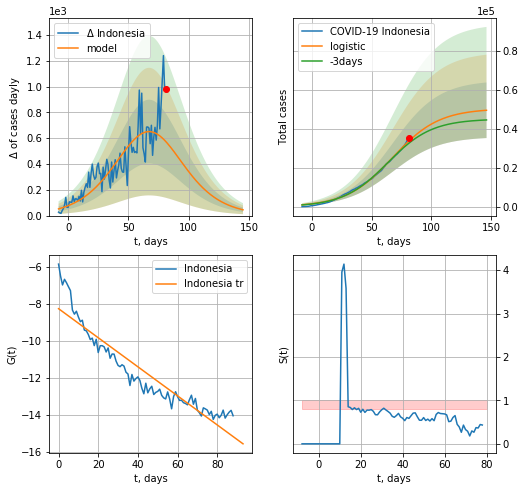

Indonesia data at: 2020-06-11
+3 day model MAPE: 0.0354974339296274
model: logistic
coeffs:  [5.04538942e+04 5.16220069e-02 6.75541220e+01]
rational stdev:  0.28802506897458197
forecast at the end of period: +65 days
	 deltaDaycases:  44
	 total cases:  49589 ± 14283
	 total death:  2810 ± 2428
trend coefficient of determination: 0.876483
 intercept: -8.249556
 slope: -0.078813


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


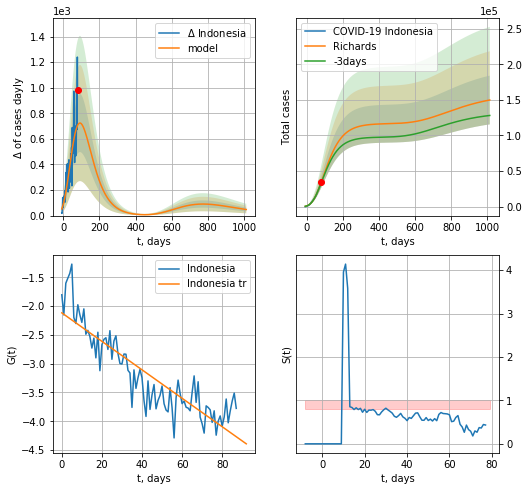

Indonesia data at: 2020-06-11
+3 day model MAPE: 0.020900
model: Richards
coeffs: [ 1.16771877e+05  9.30003846e-01 -1.42339436e+02  1.82911605e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.228459
forecast at the end of period: +933 days
	 deltaDaycases: 47
	 total cases: 149807 ± 34224
	 total death: 8488 ± 5817
trend coefficient of determination: 0.778054
 intercept: -2.118594
 slope: -0.024708


In [285]:
x = forecast("Indonesia",dfIE[5:],d1,20*7-dT)
x = forecastRR("Indonesia",dfIE[6:],d1,144*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


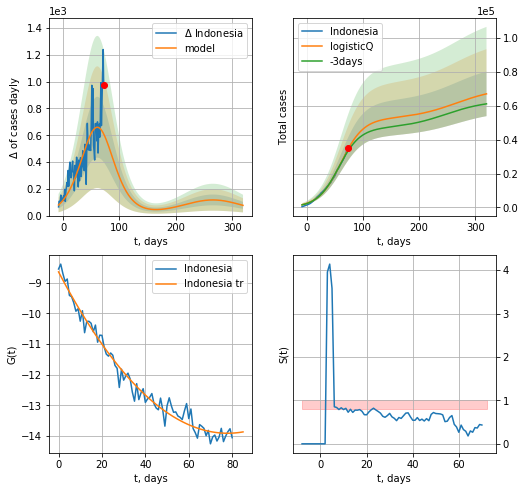

Indonesia data at: 2020-06-11
+3 day model MAPE: 0.032530
model: logisticQ
coeffs: [ 5.22910118e+04  2.63574302e-06  6.10480563e+01 -1.90212964e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.196322
forecast at the end of period: +247 days
	 deltaDaycases: 76
	 total cases: 67031 ± 13159
	 total death: 3798 ± 2236
trend coefficient of determination: 0.977296
 intercept_: -8.643444203335845
 coeffs_: [ 0.         -0.13527794  0.00086845]


In [286]:
x = forecastRRR("Indonesia",dfIE[13:],d1,46*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


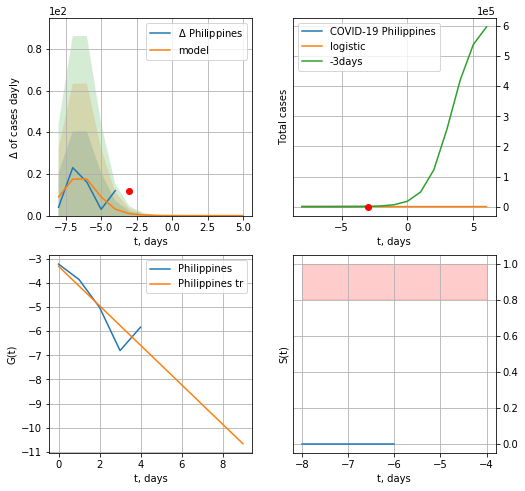

Philippines data at: 2020-06-11
+3 day model MAPE: 0.9724006736169737
model: logistic
coeffs:  [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.19348550855350297
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  61 ± 11
	 total death:  2 ± 1
trend coefficient of determination: 0.794507
 intercept: -3.309972
 slope: -0.817432


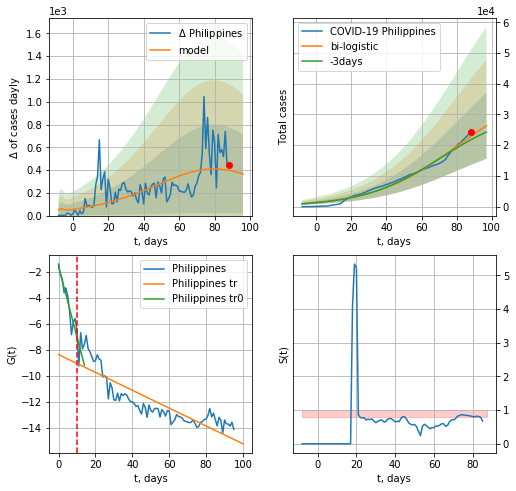

Philippines data at: 2020-06-11
+3 day model MAPE: 0.05563193158872693
model: bi-logistic
coeffs:  [3.91764178e+04 4.18998924e-02 8.01380900e+01] [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.4080794657734052
forecast at the end of period: +9 days
	 deltaDaycases:  365
	 total cases:  26295 ± 10730
	 total death:  1126 ± 1378
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend coefficient of determination: 0.751106
 intercept: -8.335876
 slope: -0.068633


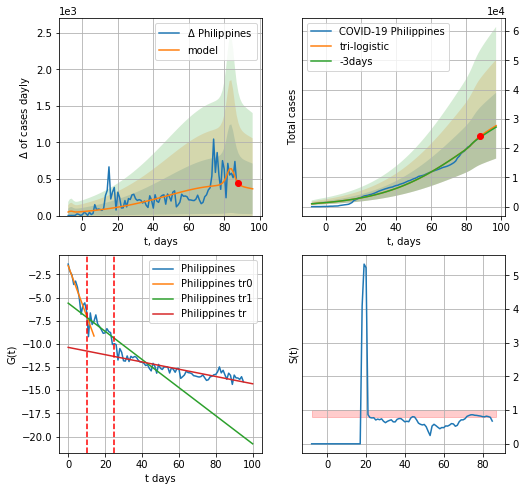

Philippines data at: 2020-06-11
+3 day model MAPE: 0.01849734917254134
model: tri-logistic
coeffs:  [1.36805558e+03 7.05337961e-01 8.41104000e+01] [ 6.15169203e+01  1.29195530e+00 -5.99802409e+00  3.91764178e+04
  4.18998924e-02  8.01380900e+01]
forecast rational stdev:  0.4067101790576672
forecast at the end of period: +9 days
	 deltaDaycases:  365
	 total cases:  27663 ± 11250
	 total death:  1185 ± 1445
tri-logistic approximation splitting points: 10,25
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend1 coefficient of determination: 0.474240
 intercept: -5.600607
 slope: -0.151865
trend coefficient of determination: 0.738745
 intercept: -10.375223
 slope: -0.039293


In [287]:
vL=10
vL1=25
x = forecast("Philippines",dfPH[4:vL],d1,12*7-dT,addpred=False,xcoef=[0.25,1.,2.3])
xx = forecast2("Philippines",dfPH[:],d1,12*7-dT,x,vL=vL,addpred=False,xcoef=[0.25,1.,1.8])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Philippines",dfPH,d1,12*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


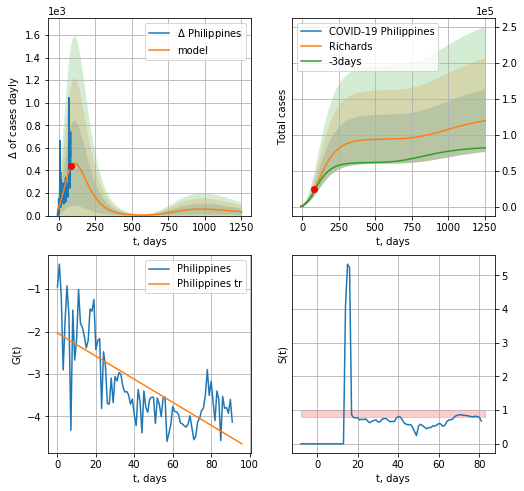

Philippines data at: 2020-06-11
+3 day model MAPE: 0.044255
model: Richards
coeffs: [ 9.38230531e+04  1.00650005e+00 -2.08147335e+02  1.34455380e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.363718
forecast at the end of period: +1171 days
	 deltaDaycases: 33
	 total cases: 119375 ± 43419
	 total death: 5115 ± 5581
trend coefficient of determination: 0.538183
 intercept: -2.035683
 slope: -0.027217


In [288]:
x = forecastRR("Philippines",dfPH[4:],d1,178*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


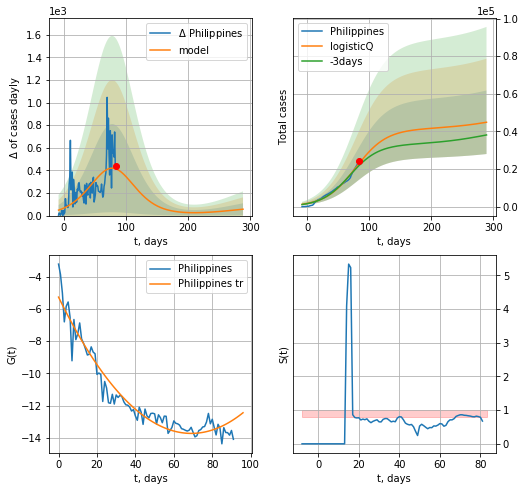

Philippines data at: 2020-06-11
+3 day model MAPE: 0.052274
model: logisticQ
coeffs: [ 4.11713442e+04  8.20908522e-07  7.83767371e+01 -4.94466056e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.376640
forecast at the end of period: +205 days
	 deltaDaycases: 56
	 total cases: 44874 ± 16901
	 total death: 1923 ± 2172
trend coefficient of determination: 0.935870
 intercept_: -5.268151309836691
 coeffs_: [ 0.         -0.24477575  0.0017711 ]


In [289]:
x = forecastRRR("Philippines",dfPH[4:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

GC
           date   cases  active  death
99  2020-06-07  2997.0    1443  180.0
100 2020-06-08  3049.0    1493  182.0
101 2020-06-09  3058.0    1501  183.0
102 2020-06-10  3068.0    1511  183.0
103 2020-06-11  3088.0    1531  183.0


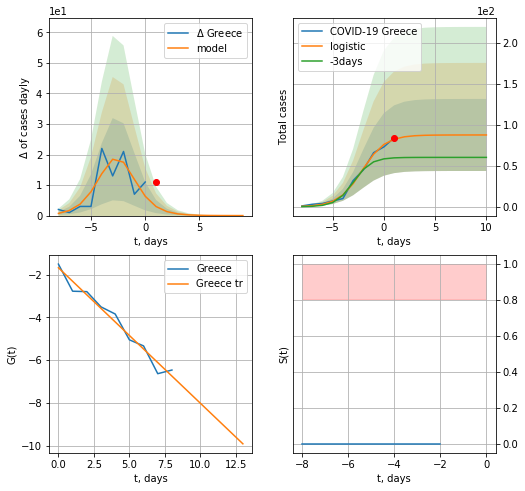

Greece data at: 2020-06-11
+3 day model MAPE: 0.42128754754463943
model: logistic
coeffs:  [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.5018417290456435
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  87 ± 43
	 total death:  5 ± 7
trend coefficient of determination: 0.966991
 intercept: -1.674249
 slope: -0.634181


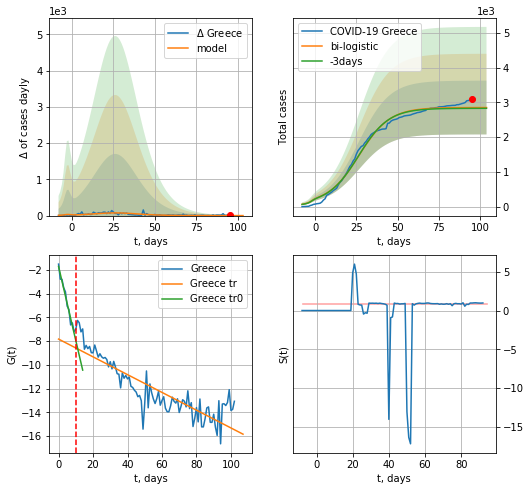

Greece data at: 2020-06-11
+3 day model MAPE: 0.007775995299008349
model: bi-logistic
coeffs:  [2.76770529e+03 1.06916578e-01 2.65200776e+01] [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.27122767724984476
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  2854 ± 774
	 total death:  169 ± 137
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.974467
 intercept: -1.699561
 slope: -0.624689
trend coefficient of determination: 0.752262
 intercept: -7.828100
 slope: -0.074971


In [290]:
dfGC = read_df(pd.DataFrame(),"GC")
x = forecast("Greece",dfGC[:10],d1,12*7-dT)
xx = forecast2("Greece",dfGC[:],d1,12*7-dT,x,addpred=False,xcoef=[.25/2,1.,2.3],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


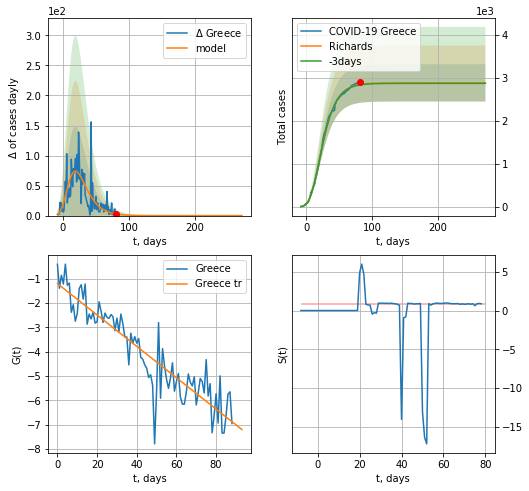

Greece data at: 2020-06-11
+3 day model MAPE: 0.003716
model: Richards
coeffs: [ 2.88621480e+03  7.21651977e+00 -4.66145013e+01  9.69412199e-03]
rational stdev: 0.150576
forecast at the end of period: +191 days
	 deltaDaycases: 0
	 total cases: 2886 ± 434
	 total death: 171 ± 77
trend coefficient of determination: 0.832984
 intercept: -1.208411
 slope: -0.064431


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


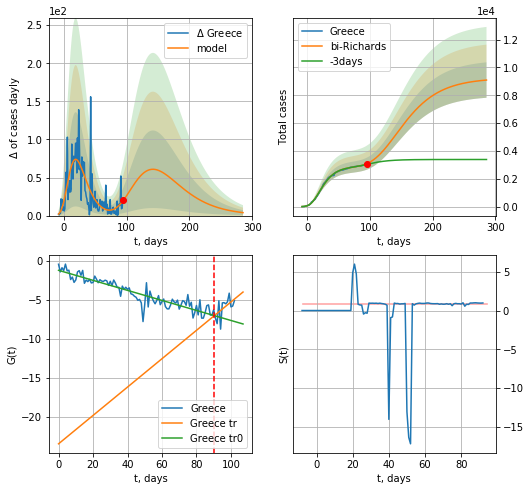

Greece data at: 2020-06-11
+3 day model MAPE: 0.017708
model: bi-Richards
coeffs: [ 6.35802623e+03  4.68683363e+00 -5.67736693e+01  5.56140502e-03]
rational stdev: 0.139967
forecast at the end of period: +191 days
	 deltaDaycases: 3
	 total cases: 9095 ± 1273
	 total death: 539 ± 226
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.837017
 intercept: -1.188566
 slope: -0.064238
trend coefficient of determination: 0.295288
 intercept: -23.415058
 slope: 0.181709


In [291]:
vL = 90
x = forecastRR("Greece",dfGC[:vL],d1,38*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Greece",dfGC[:],d1,38*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


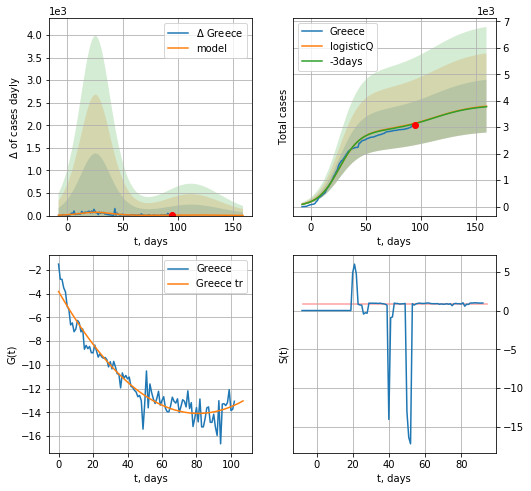

Greece data at: 2020-06-11
+3 day model MAPE: 0.004994
model: logisticQ
coeffs: [ 2.86230617e+03  3.20694631e-07  2.58428961e+01 -3.19055320e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.262868
forecast at the end of period: +65 days
	 deltaDaycases: 3
	 total cases: 3794 ± 997
	 total death: 224 ± 176
trend coefficient of determination: 0.924087
 intercept_: -3.8088454219515313
 coeffs_: [ 0.         -0.25376964  0.00156508]


In [292]:
x = forecastRRR("Greece",dfGC[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

HG
          date  cases  active  death
93 2020-06-07   4014    1182  548.0
94 2020-06-08   4017    1143  550.0
95 2020-06-09   4027    1121  551.0
96 2020-06-10   4039    1095  553.0
97 2020-06-11   4053    1051  555.0


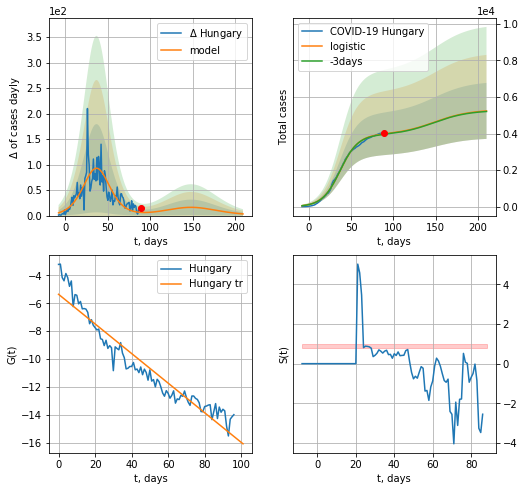

Hungary data at: 2020-06-11
+3 day model MAPE: 0.006512423866152581
model: logistic
coeffs:  [3.93563962e+03 9.41139245e-02 3.70795127e+01]
scenario coeffs:  [0.35, 0.5, 4, 1]
rational stdev:  0.29232887330692475
forecast at the end of period: +121 days
	 deltaDaycases:  3
	 total cases:  5241 ± 1532
	 total death:  717 ± 628
trend coefficient of determination: 0.918255
 intercept: -5.359469
 slope: -0.105956


In [364]:
dfHG = read_df(pd.DataFrame(),"HG")
try:
    x = forecast("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=[.35,.5,4,1])
except:
    print("Exception occurs")
#xx = forecast2("Hungary",dfHG[:],d1,4*7-dT,x,vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


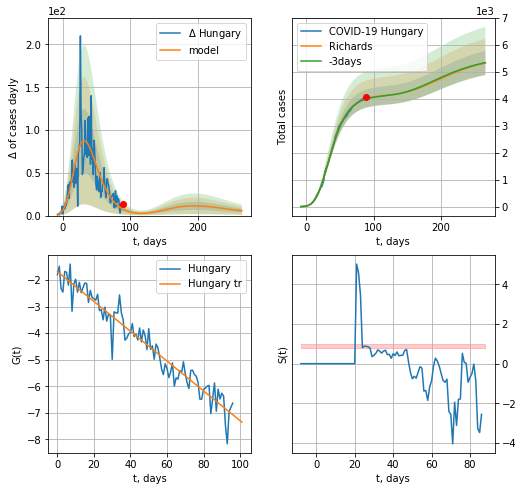

Hungary data at: 2020-06-11
+3 day model MAPE: 0.002920
model: Richards
coeffs: [ 4.13901393e+03  5.21763876e-01 -3.16798681e+00  1.16636054e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.083512
forecast at the end of period: +177 days
	 deltaDaycases: 5
	 total cases: 5335 ± 445
	 total death: 730 ± 182
trend coefficient of determination: 0.934400
 intercept: -1.685121
 slope: -0.056104


In [365]:
x = forecastRR("Hungary",dfHG[:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


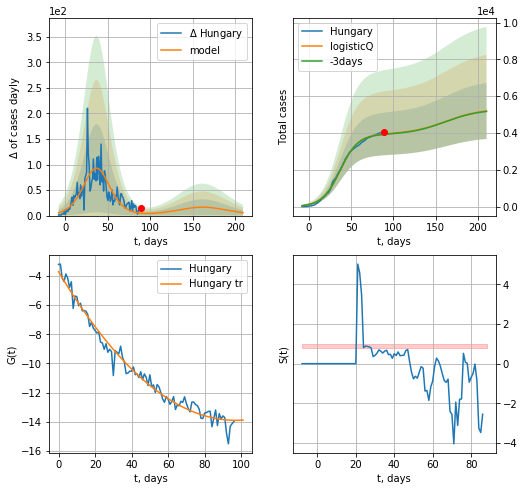

Hungary data at: 2020-06-11
+3 day model MAPE: 0.006609
model: logisticQ
coeffs: [ 3.93551635e+03  5.40192528e-07  3.70795675e+01 -1.74149554e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.292437
forecast at the end of period: +121 days
	 deltaDaycases: 5
	 total cases: 5201 ± 1521
	 total death: 712 ± 624
trend coefficient of determination: 0.978151
 intercept_: -3.717561405111044
 coeffs_: [ 0.         -0.20966104  0.00108029]


In [366]:
x = forecastRRR("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='cases')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


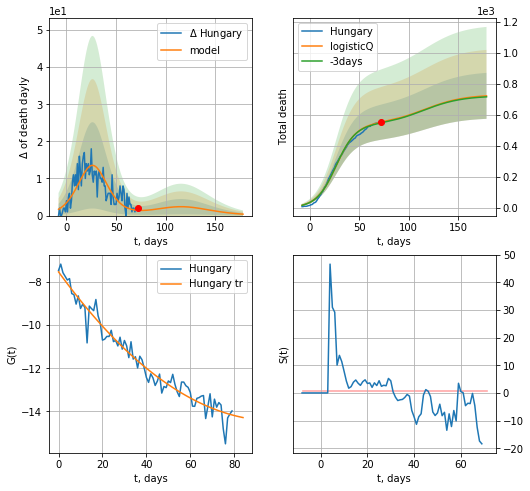

Hungary data at: 2020-06-11
+3 day model MAPE: 0.008331
model: logisticQ
coeffs: [ 5.39531543e+02  6.20181235e-07  2.66506296e+01 -1.60552200e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.205186
forecast at the end of period: +107 days
	 total death: 722 ± 148
trend coefficient of determination: 0.956953
 intercept_: -7.5384047383890485
 coeffs_: [ 0.         -0.1398217   0.00070883]


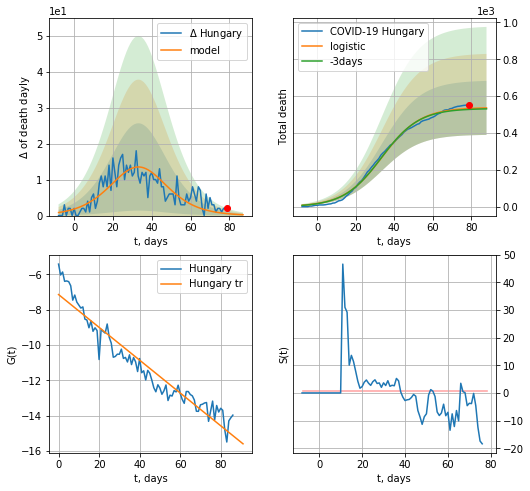

Hungary data at: 2020-06-11
+3 day model MAPE: 0.00919864627003083
model: logistic
coeffs:  [5.38852114e+02 1.00288101e-01 3.36215819e+01]
rational stdev:  0.2730604351281934
forecast at the end of period: +9 days
	 total death:  536 ± 146
trend coefficient of determination: 0.923936
 intercept: -7.149353
 slope: -0.092860


In [367]:
x = forecastRRR("Hungary",dfHG[17:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')
x = forecast("Hungary",dfHG[10:],d1,12*7-dT,cases='death')

MT
          date  cases  active  death
91 2020-06-07  629.0      24    9.0
92 2020-06-08  630.0      25    9.0
93 2020-06-09  632.0      26    9.0
94 2020-06-10  635.0      29    9.0
95 2020-06-11  640.0      31    9.0


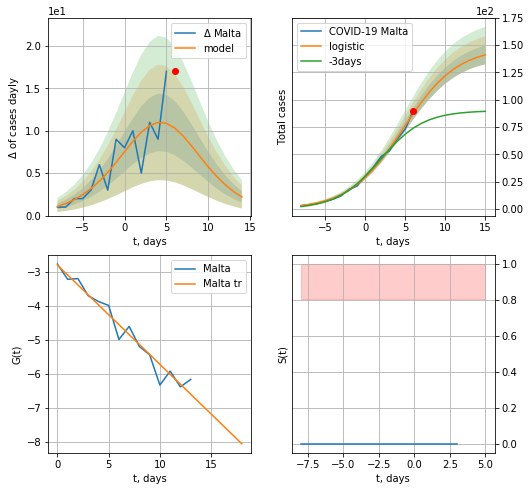

Malta data at: 2020-06-11
model: logistic
coeffs:  [147.79636191   0.29837112   4.7799048 ]
rational stdev:  0.06036954020755974
forecast at the end of period: +9 days
	 deltaDaycases:  2
	 total cases:  141 ± 8
	 total death:  1 ± 0
trend coefficient of determination: 0.952854
 intercept: -2.800130
 slope: -0.292111


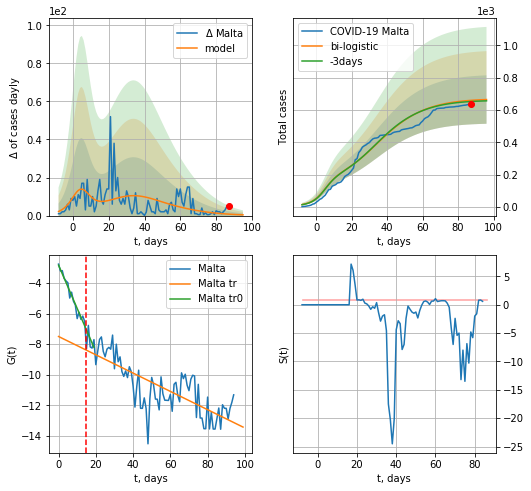

Malta data at: 2020-06-11
+3 day model MAPE: 0.011100091443279659
model: bi-logistic
coeffs:  [4.63470871e+02 8.66957283e-02 3.35392418e+01] [147.79636191   0.29837112   4.7799048 ]
scenario coeffs:  [0.125, 1.0, 1.8]
rational stdev:  0.22516279420011104
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  664 ± 149
	 total death:  9 ± 6
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.954424
 intercept: -2.840997
 slope: -0.282680
trend coefficient of determination: 0.605558
 intercept: -7.501432
 slope: -0.059774


In [294]:
dfMT = read_df(pd.DataFrame(),"MT")
x = forecast("Malta",dfMT[:15],d1,7*12-dT,pMAPE=False)
xx = forecast2("Malta",dfMT[:],d1,7*12-dT,x,vL=15,addpred=True,xcoef=[0.25/2,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


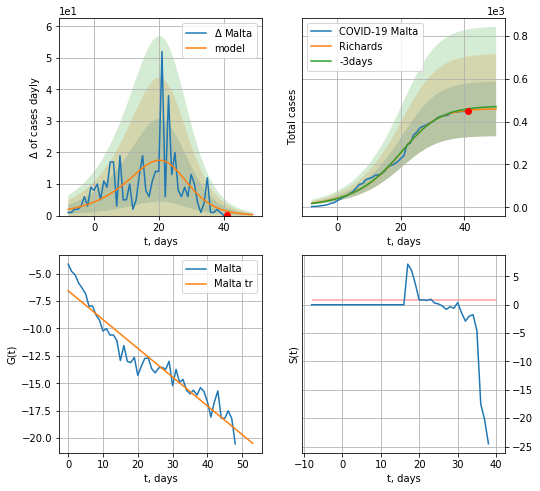

Malta data at: 2020-06-11
+3 day model MAPE: 0.016229
model: Richards
coeffs: [4.60753453e+02 9.94315746e-02 2.41437164e+01 1.98427317e+00]
rational stdev: 0.277865
forecast at the end of period: +9 days
	 deltaDaycases: 0
	 total cases: 459 ± 127
	 total death: 6 ± 5
trend coefficient of determination: 0.914701
 intercept: -6.567936
 slope: -0.262394


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


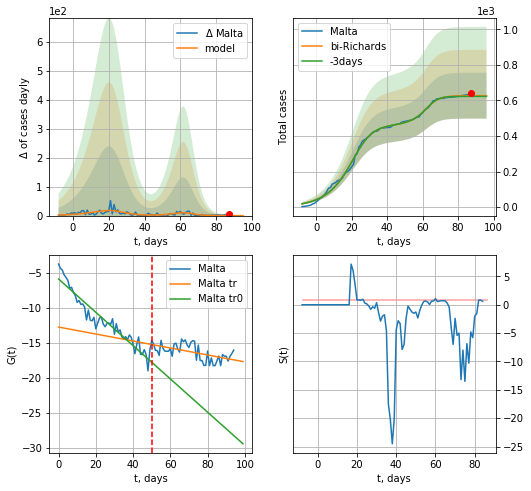

Malta data at: 2020-06-11
+3 day model MAPE: 0.006328
model: bi-Richards
coeffs: [1.66178240e+02 1.64549769e-01 6.40009265e+01 1.73297519e+00]
rational stdev: 0.205616
forecast at the end of period: +9 days
	 deltaDaycases: 0
	 total cases: 626 ± 128
	 total death: 8 ± 4
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.913297
 intercept: -5.912754
 slope: -0.237272
trend coefficient of determination: 0.305117
 intercept: -12.760213
 slope: -0.049690


In [295]:
vL = 50
x = forecastRR("Malta",dfMT[:vL],d1,12*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Malta",dfMT[:],d1,12*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


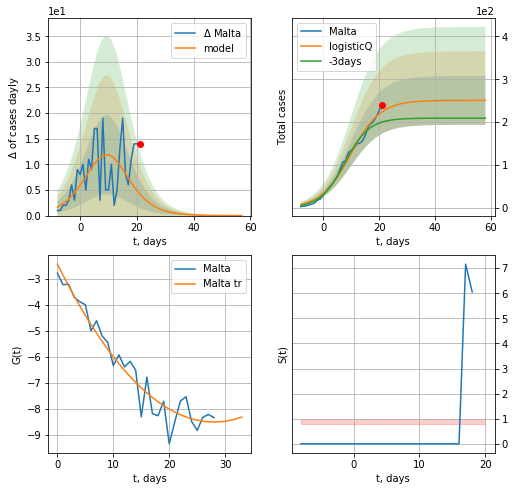

Malta data at: 2020-06-11
+3 day model MAPE: 0.130140
model: logisticQ
coeffs: [ 2.50920068e+02  3.54275509e-06  9.84690922e+00 -5.35768463e+04]
rational stdev: 0.227624
forecast at the end of period: +37 days
	 deltaDaycases: 0
	 total cases: 250 ± 57
	 total death: 3 ± 2
trend coefficient of determination: 0.935484
 intercept_: -2.4264251666881744
 coeffs_: [ 0.         -0.43368994  0.00773877]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


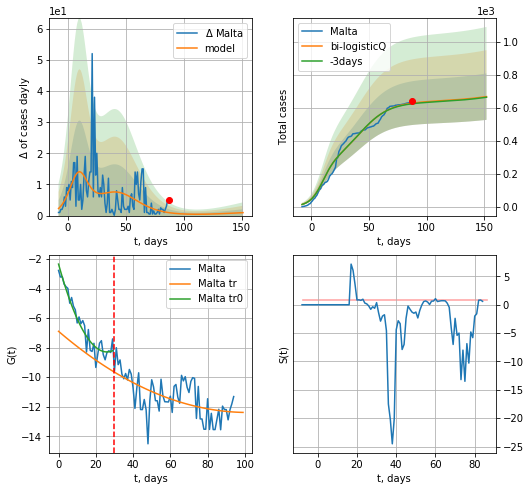

Malta data at: 2020-06-11
+3 day model MAPE: 0.005916
model: bi-logisticQ
coeffs: [ 3.85622037e+02  2.12245198e-07  4.18918388e+01 -3.64354676e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.210319
forecast at the end of period: +65 days
	 deltaDaycases: 0
	 total cases: 668 ± 140
	 total death: 9 ± 5
bi-logisticQ approximation splitting point: 30
trend coefficient of determination: 0.928360
 intercept_: -2.3445378489560733
 coeffs_: [ 0.         -0.45826686  0.00882824]
trend coefficient of determination: 0.360036
 intercept_: -6.895704595676867
 coeffs_: [ 0.         -0.10812056  0.00053192]


In [296]:
x = forecastRRR("Malta",dfMT[:30],d1,16*7-dT,addpred=False,xcoef=[0.35/4,.5,3,1.])
xx = forecast2RRR("Malta",dfMT[:],d1,20*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=30)

SL
          date   cases  active  death
89 2020-06-07  1530.0   106.0   28.0
90 2020-06-08  1531.0   101.0   28.0
91 2020-06-09  1533.0   101.0   28.0
92 2020-06-10  1533.1   101.0   28.0
93 2020-06-11  1541.0   104.0   28.0


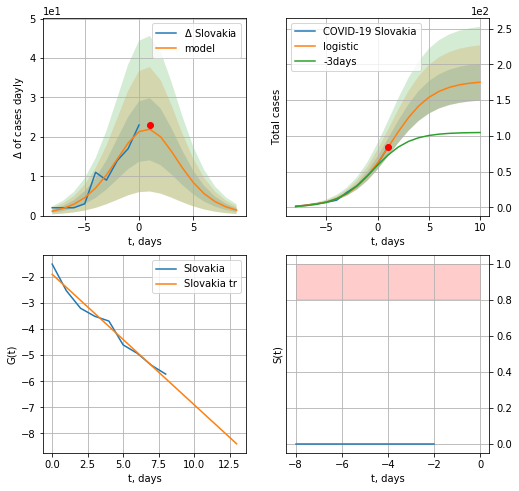

Slovakia data at: 2020-06-11
model: logistic
coeffs:  [177.28786794   0.4996723    1.23158092]
rational stdev:  0.14723856172050678
forecast at the end of period: +9 days
	 deltaDaycases:  1
	 total cases:  175 ± 25
	 total death:  3 ± 1
trend coefficient of determination: 0.974721
 intercept: -1.894823
 slope: -0.500610


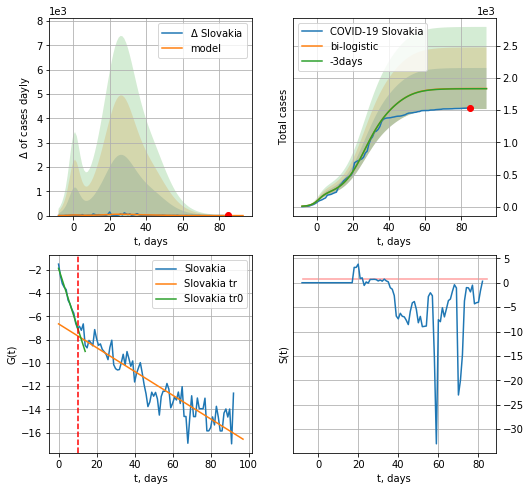

Slovakia data at: 2020-06-11
+3 day model MAPE: 0.0018309443726507188
model: bi-logistic
coeffs:  [1.32848182e+03 1.59935173e-01 2.62056129e+01] [177.28786794   0.4996723    1.23158092]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.1737409212025702
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  1837 ± 319
	 total death:  33 ± 17
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.981202
 intercept: -1.868036
 slope: -0.510655
trend coefficient of determination: 0.844161
 intercept: -6.648637
 slope: -0.102301


In [298]:
dfSL = read_df(pd.DataFrame(),"SL")
dfSL = dfSL.fillna(0)
try:
    x = forecast("Slovakia",dfSL[:10],d1,12*7-dT,pMAPE=False)
    xx = forecast2("Slovakia",dfSL[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=10)
except:
    print("Exception ocurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


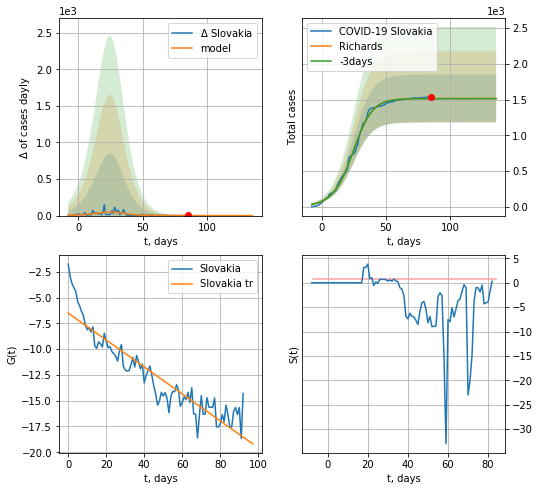

Slovakia data at: 2020-06-11
+3 day model MAPE: 0.001793
model: Richards
coeffs: [1.51427677e+03 1.13274650e-01 2.62224936e+01 1.22976305e+00]
rational stdev: 0.220614
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 1514 ± 334
	 total death: 27 ± 17
trend coefficient of determination: 0.853244
 intercept: -6.502290
 slope: -0.130694


In [299]:
x = forecastRR("Slovakia",dfSL[:],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


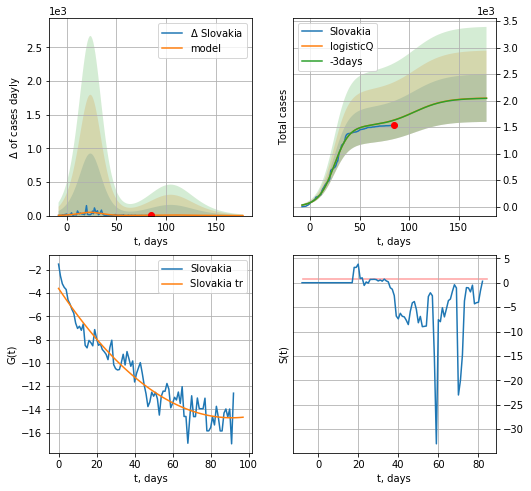

Slovakia data at: 2020-06-11
+3 day model MAPE: 0.001403
model: logisticQ
coeffs: [ 1.51530300e+03  1.93504157e-04  2.40281425e+01 -6.42337892e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.218806
forecast at the end of period: +93 days
	 deltaDaycases: 0
	 total cases: 2046 ± 447
	 total death: 37 ± 24
trend coefficient of determination: 0.920998
 intercept_: -3.595904180290157
 coeffs_: [ 0.         -0.2446535   0.00134381]


In [300]:
x = forecastRRR("Slovakia",dfSL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

SV
          date   cases  active  death
94 2020-06-07  1485.0    17.0  109.0
95 2020-06-08  1485.5    17.0  109.0
96 2020-06-09  1486.0    18.0  109.0
97 2020-06-10  1488.0    20.0  109.0
98 2020-06-11  1488.0    20.0  109.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


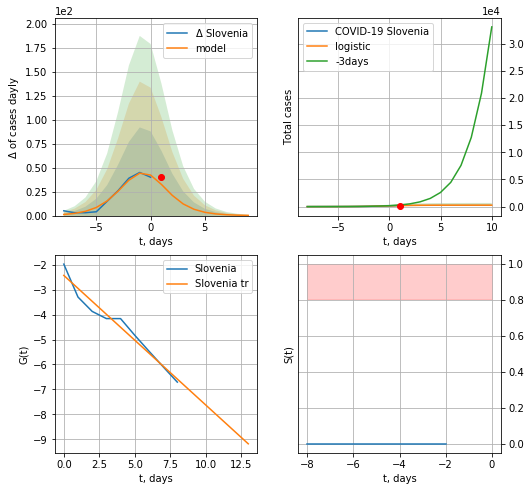

Slovenia data at: 2020-06-11
model: logistic
coeffs:  [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
rational stdev:  0.5312441686508605
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  260 ± 138
	 total death:  19 ± 30
trend coefficient of determination: 0.958485
 intercept: -2.427236
 slope: -0.519636
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


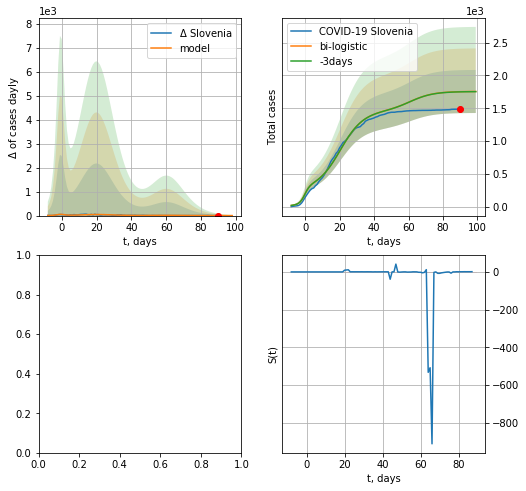

In [301]:
dfSV = read_df(pd.DataFrame(),"SV").fillna(0)
try:
    x = forecast("Slovenia",dfSV[:10],d1,7*12-dT,pMAPE=False)
    xx = forecast2("Slovenia",dfSV[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,3.],vL=10)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


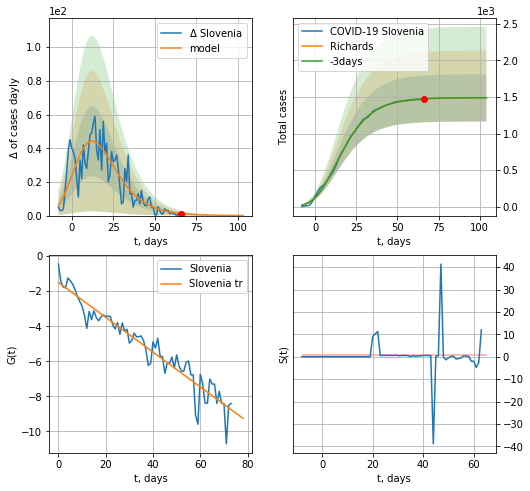

Slovenia data at: 2020-06-10
+3 day model MAPE: 0.001211
model: Richards
coeffs: [ 1.48860897e+03  5.69202399e-01 -8.90072420e+00  1.52510532e-01]
rational stdev: 0.217393
forecast at the end of period: +38 days
	 deltaDaycases: 0
	 total cases: 1488 ± 323
	 total death: 109 ± 71
trend coefficient of determination: 0.915958
 intercept: -1.505070
 slope: -0.099296


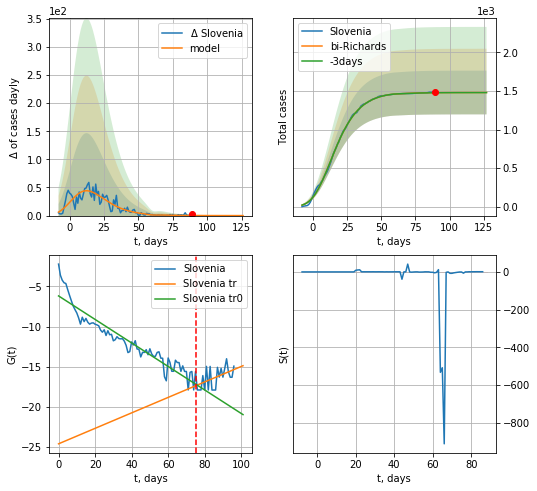

Slovenia data at: 2020-06-10
+3 day model MAPE: 0.000810
model: bi-Richards
coeffs: [-7.51257629  0.43617952 60.96529616  1.14010389]
rational stdev: 0.191483
forecast at the end of period: +38 days
	 deltaDaycases: 0
	 total cases: 1481 ± 283
	 total death: 108 ± 62
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.894163
 intercept: -6.188263
 slope: -0.146446
trend coefficient of determination: 0.228192
 intercept: -24.617291
 slope: 0.096364


In [319]:
vL = 75
x = forecastRR("Slovenia",dfSV[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Slovenia",dfSV[:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

[0.35416971, 0.02606324, 4.35859408, 19.30413219]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


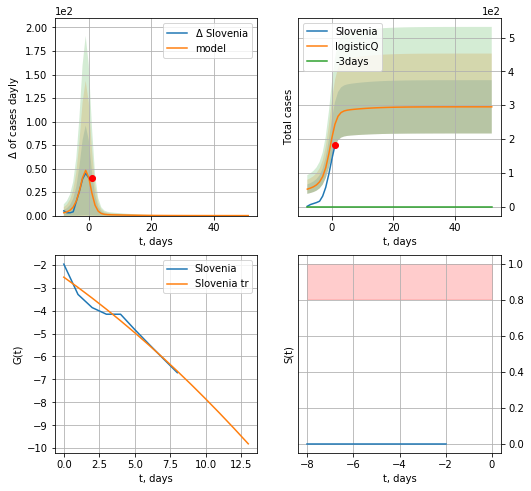

Slovenia data at: 2020-06-11
+3 day model MAPE: inf
model: logisticQ
coeffs: [ 2.17965799e+02  4.01733228e-02 -2.21208435e+01 -7.00287194e-01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.266979
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 295 ± 78
	 total death: 21 ± 16
trend coefficient of determination: 0.956027
 intercept_: -2.543480478113449
 coeffs_: [ 0.         -0.43771568 -0.00932819]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:234: RuntimeWarning: divide by zero encountered in double_scalars
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:571: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

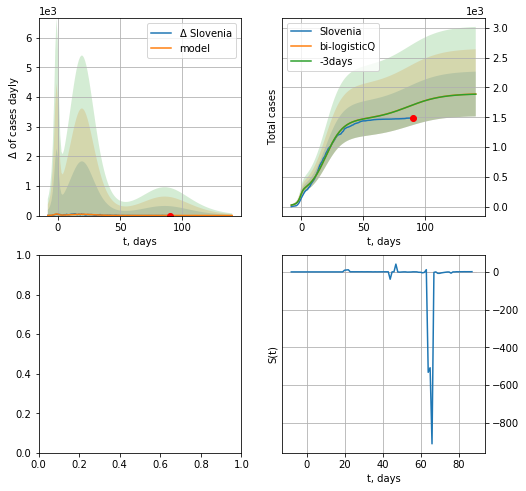

In [302]:
print(koreaCoeffs)
x = forecastRRR("Slovenia",dfSV[:10],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
xx = forecast2RRR("Slovenia",dfSV[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=10)

SB
          date  cases  active  death
89 2020-06-07  11823   226.0  249.0
90 2020-06-08  11896   298.0  250.0
91 2020-06-09  11965   367.0  250.0
92 2020-06-10  12031   432.0  251.0
93 2020-06-11  12102   502.0  252.0


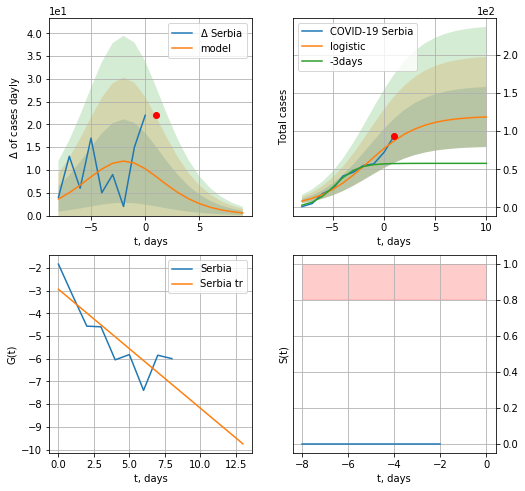

Serbia data at: 2020-06-11
model: logistic
coeffs:  [119.86809018   0.40041874  -1.48148467]
rational stdev:  0.3321032925412913
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  118 ± 39
	 total death:  2 ± 1
trend coefficient of determination: 0.723021
 intercept: -2.939233
 slope: -0.523684


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


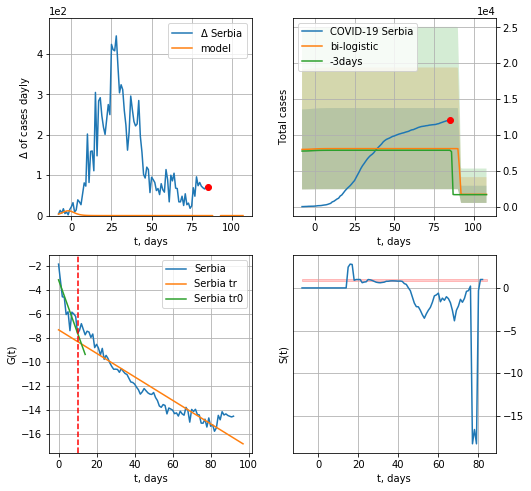

Serbia data at: 2020-06-11
+3 day model MAPE: 0.05535891197802169
model: bi-logistic
coeffs:  [ 6.37139450e+03 -6.24790530e+00  9.10415531e+01] [119.86809018   0.40041874  -1.48148467]
scenario coeffs:  [0.25, 1.0, 2.2]
rational stdev:  0.6995655675506406
forecast at the end of period: +23 days
	 deltaDaycases:  0
	 total cases:  1712 ± 1198
	 total death:  35 ± 73
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.680312
 intercept: -3.149496
 slope: -0.444835
trend coefficient of determination: 0.887188
 intercept: -7.322549
 slope: -0.098196


In [303]:
dfSB = read_df(pd.DataFrame(),"SB")
dfSB = dfSB.fillna(0)
x = forecast("Serbia",dfSB[:10],d1,12*7-dT,pMAPE=False)
xx = forecast2("Serbia",dfSB[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,2.2],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


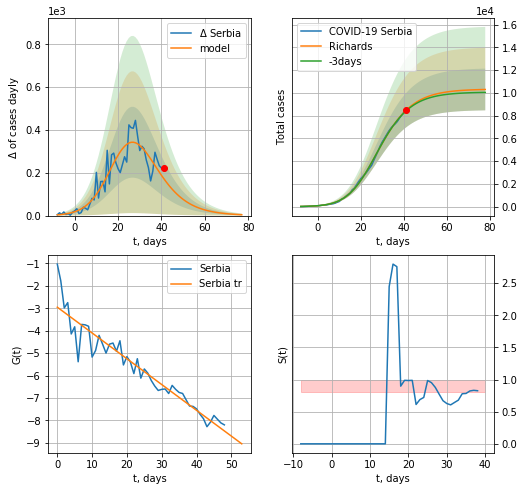

Serbia data at: 2020-06-11
+3 day model MAPE: 0.007628
model: Richards
coeffs: [1.03310156e+04 2.23147111e-01 2.10152369e+01 5.03005273e-01]
rational stdev: 0.178090
forecast at the end of period: +37 days
	 deltaDaycases: 4
	 total cases: 10296 ± 1833
	 total death: 214 ± 114
trend coefficient of determination: 0.905867
 intercept: -2.952078
 slope: -0.114857


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


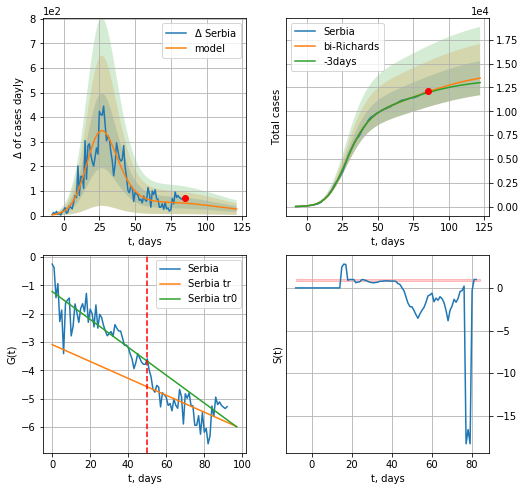

Serbia data at: 2020-06-11
+3 day model MAPE: 0.006985
model: bi-Richards
coeffs: [ 4.03579208e+03  2.16523379e+00 -4.28872603e+01  1.55655107e-02]
rational stdev: 0.132777
forecast at the end of period: +37 days
	 deltaDaycases: 26
	 total cases: 13481 ± 1790
	 total death: 280 ± 111
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.685857
 intercept: -1.217818
 slope: -0.049274
trend coefficient of determination: 0.379308
 intercept: -3.093184
 slope: -0.029849


In [304]:
vL=50
x = forecastRR("Serbia",dfSB[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Serbia",dfSB[:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


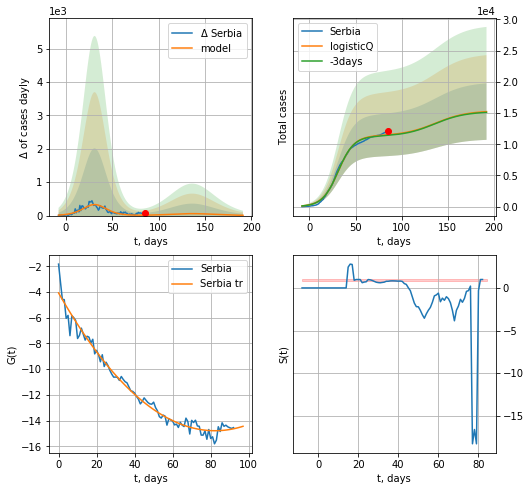

Serbia data at: 2020-06-11
+3 day model MAPE: 0.009047
model: logisticQ
coeffs: [ 1.13573714e+04  5.10178164e-07  3.13384447e+01 -2.27609824e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.297264
forecast at the end of period: +107 days
	 deltaDaycases: 8
	 total cases: 15227 ± 4526
	 total death: 317 ± 282
trend coefficient of determination: 0.978467
 intercept_: -4.068817922180697
 coeffs_: [ 0.         -0.26044628  0.00158312]


In [305]:
x = forecastRRR("Serbia",dfSB[:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

CT
           date   cases  active  death
99  2020-06-07  2247.3    17.0  104.0
100 2020-06-08  2247.4    15.0  104.0
101 2020-06-09  2247.5    11.0  106.0
102 2020-06-10  2249.0    13.0  106.0
103 2020-06-11  2249.0    11.0  106.0


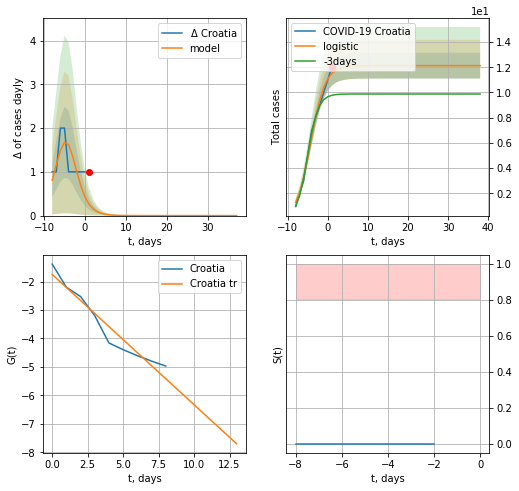

Croatia data at: 2020-06-11
model: logistic
coeffs:  [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.08430442468045289
forecast at the end of period: +37 days
	 deltaDaycases:  0
	 total cases:  12 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.936719
 intercept: -1.749041
 slope: -0.458074


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

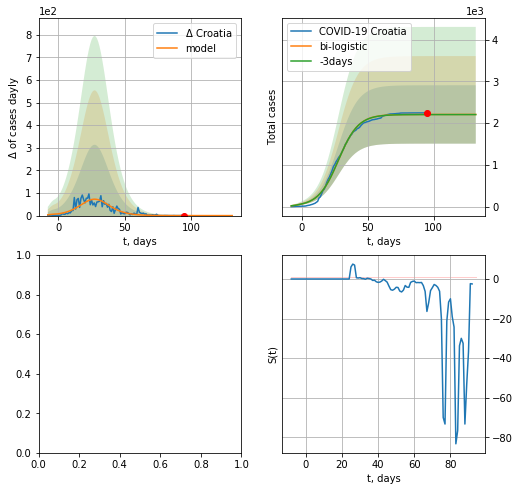

In [306]:
dfCT = read_df(pd.DataFrame(),"CT")
dfCT = dfCT.fillna(0)
x = forecast("Croatia",dfCT[:10],d1,16*7-dT,pMAPE=False)
xx = forecast2("Croatia",dfCT[:],d1,16*7-dT,x,addpred=False,xcoef=[0.25/2,1.,2.],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


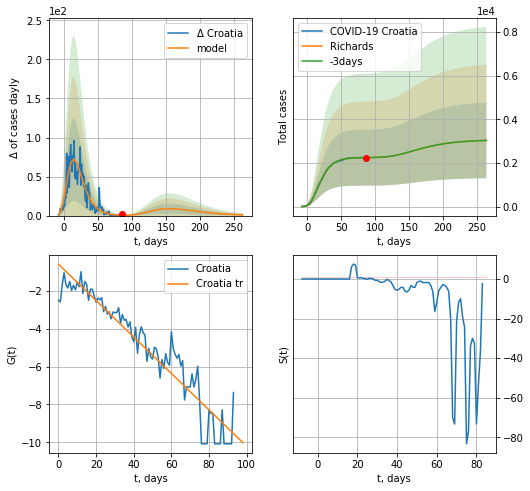

Croatia data at: 2020-06-10
+3 day model MAPE: 0.000022
model: Richards
coeffs: [ 2.25238039e+03  1.09214076e+01 -4.08204161e+01  7.95186630e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.571566
forecast at the end of period: +178 days
	 deltaDaycases: 0
	 total cases: 3036 ± 1735
	 total death: 143 ± 245
trend coefficient of determination: 0.898974
 intercept: -0.587901
 slope: -0.096254


In [330]:
x = forecastRR("Croatia",dfCT[8:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


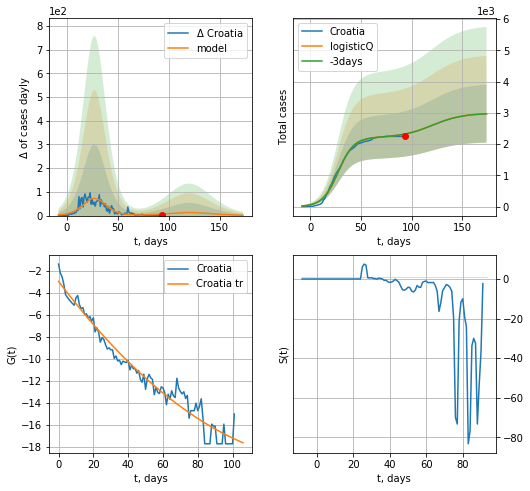

Croatia data at: 2020-06-10
+3 day model MAPE: 0.001290
model: logisticQ
coeffs: [ 2.21019518e+03  5.65426082e-07  2.76254666e+01 -2.31682372e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.311391
forecast at the end of period: +80 days
	 deltaDaycases: 1
	 total cases: 2970 ± 925
	 total death: 140 ± 130
trend coefficient of determination: 0.961854
 intercept_: -2.957971883721793
 coeffs_: [ 0.         -0.20923019  0.00066683]


In [331]:
x = forecastRRR("Croatia",dfCT[:],d1,22*7-dT,addpred=True,xcoef=koreaCoeffs)

EG
          date  cases  active   death
93 2020-06-07  34079   23881  1237.0
94 2020-06-08  35444   24798  1271.0
95 2020-06-09  36829   25737  1306.0
96 2020-06-10  38284   26653  1342.0
97 2020-06-11  39726   27658  1377.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


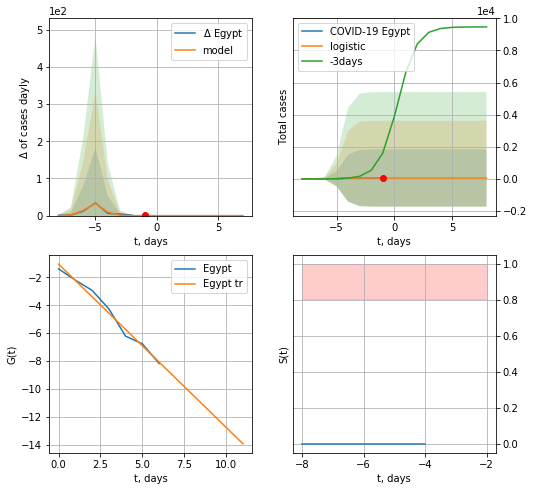

Egypt data at: 2020-06-11
+3 day model MAPE: 0.9848657964650105
model: logistic
coeffs:  [58.57021122  2.53530653 -4.60228222]
rational stdev:  30.428321363178444
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  58 ± 1782
	 total death:  2 ± 182
trend coefficient of determination: 0.982412
 intercept: -1.045837
 slope: -1.172929


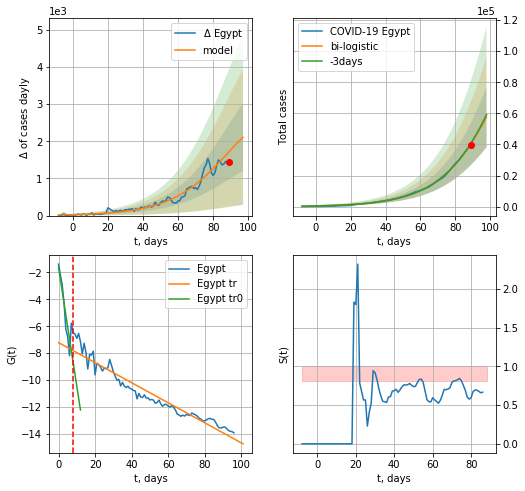

Egypt data at: 2020-06-11
+3 day model MAPE: 0.012525627420206287
model: bi-logistic
coeffs:  [1.83394769e+05 5.37260793e-02 1.12732996e+02] [58.57021122  2.53530653 -4.60228222]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.33616556102160366
forecast at the end of period: +9 days
	 deltaDaycases:  2108
	 total cases:  57545 ± 19344
	 total death:  1994 ± 2010
bi-logistic approximation splitting point: 8
trend0 coefficient of determination: 0.807637
 intercept: -1.627174
 slope: -0.882261
trend coefficient of determination: 0.931951
 intercept: -7.213001
 slope: -0.074377


In [307]:
dfEG = read_df(pd.DataFrame(),"EG")
x = forecast("Egypt",dfEG[:8],d1,7*12-dT)
xx = forecast2("Egypt",dfEG[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=8)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


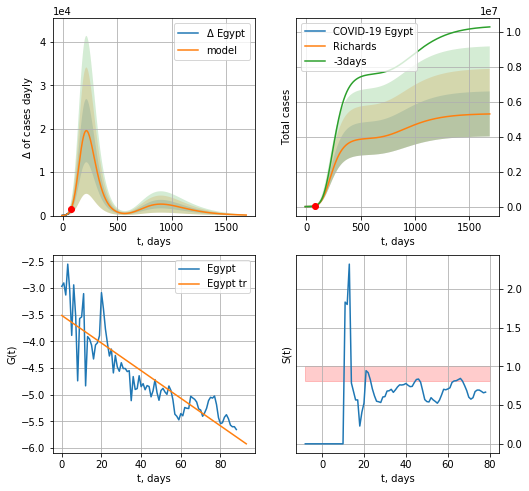

Egypt data at: 2020-06-11
+3 day model MAPE: 0.011796
model: Richards
coeffs: [3.90348299e+06 6.83942598e-02 1.17962156e+02 2.20943782e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.243002
forecast at the end of period: +1605 days
	 deltaDaycases: 125
	 total cases: 5293722 ± 1286386
	 total death: 183493 ± 133767
trend coefficient of determination: 0.778900
 intercept: -3.515945
 slope: -0.025887


In [308]:
x = forecastRR("Egypt",dfEG[8:],d1,240*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


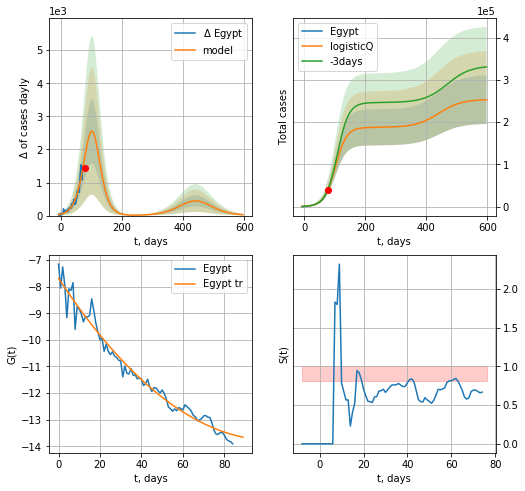

Egypt data at: 2020-06-11
+3 day model MAPE: 0.015701
model: logisticQ
coeffs: [ 1.87647412e+05  1.28330050e-05  1.01055862e+02 -4.13683985e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.226917
forecast at the end of period: +520 days
	 deltaDaycases: 26
	 total cases: 253136 ± 57440
	 total death: 8774 ± 5972
trend coefficient of determination: 0.971593
 intercept_: -7.6919205416209895
 coeffs_: [ 0.         -0.11783964  0.00057099]


In [309]:
x = forecastRRR("Egypt",dfEG[12:],d1,85*7-dT,addpred=True,xcoef=koreaCoeffs)

IQ
           date  cases  active  death
96  2020-06-07  12366  6834.0  346.0
97  2020-06-08  13481  7539.0  370.0
98  2020-06-09  14268  8045.0  392.0
99  2020-06-10  15414  8774.0  426.0
100 2020-06-11  16675  9650.0  457.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


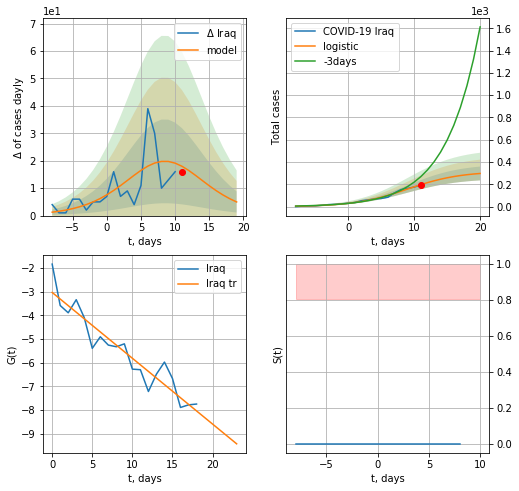

Iraq data at: 2020-06-11
+3 day model MAPE: 0.3447403684117319
model: logistic
coeffs:  [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.20777406895257303
forecast at the end of period: +9 days
	 deltaDaycases:  4
	 total cases:  298 ± 61
	 total death:  8 ± 4
trend coefficient of determination: 0.889033
 intercept: -3.031672
 slope: -0.278416


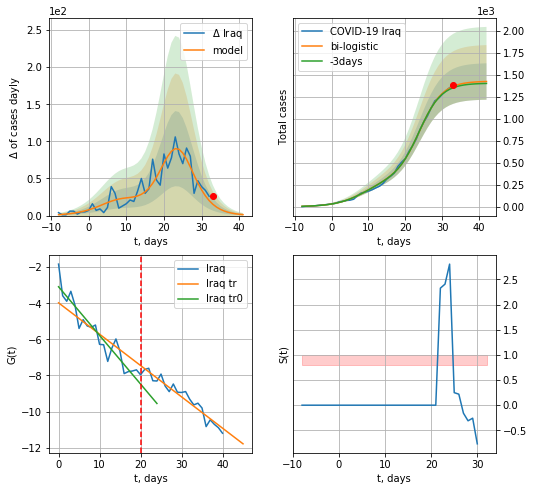

Iraq data at: 2020-06-11
+3 day model MAPE: 0.012548655608678476
model: bi-logistic
coeffs:  [1.10877596e+03 3.20225975e-01 2.39035989e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.14537179336300032
forecast at the end of period: +9 days
	 deltaDaycases:  1
	 total cases:  1422 ± 206
	 total death:  38 ± 16
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend coefficient of determination: 0.928562
 intercept: -3.976586
 slope: -0.173518


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


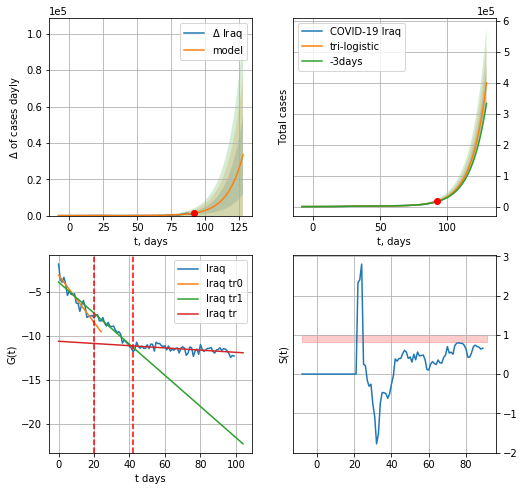

Iraq data at: 2020-06-11
+3 day model MAPE: 0.046117263294319095
model: tri-logistic
coeffs:  [3.81128981e+07 8.89548641e-02 1.80148179e+02] [3.17081296e+02 2.50431387e-01 8.98163530e+00 1.10877596e+03
 3.20225975e-01 2.39035989e+01]
forecast rational stdev:  0.15060238572449822
forecast at the end of period: +37 days
	 deltaDaycases:  33599
	 total cases:  400008 ± 60242
	 total death:  10962 ± 4952
tri-logistic approximation splitting points: 20,42
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend1 coefficient of determination: 0.937217
 intercept: -3.879636
 slope: -0.177153
trend coefficient of determination: 0.284121
 intercept: -10.620966
 slope: -0.012608


In [310]:
vL=20
vL1=42
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIQ = dfIQ.fillna(0)
x = forecast("Iraq",dfIQ[:vL],d1,12*7-dT)
xx = forecast2("Iraq",dfIQ[:vL1],d1,12*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Iraq",dfIQ[:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:62: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


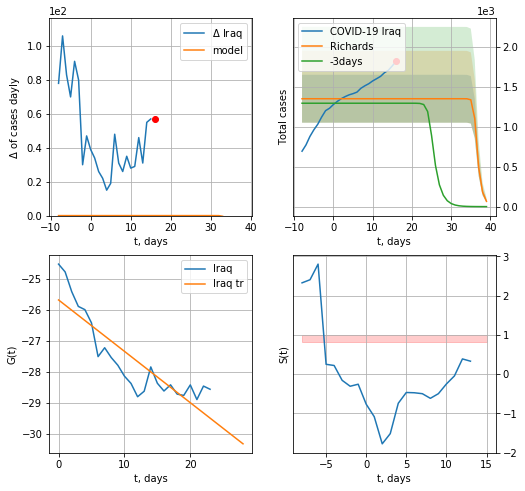

Iraq data at: 2020-06-11
+3 day model MAPE: 0.043452
model: Richards
coeffs: [ 1.35108000e+03 -1.00828093e+00  3.60107691e+01  3.34480114e+00]
rational stdev: 0.221927
forecast at the end of period: +23 days
	 deltaDaycases: -115
	 total cases: 66 ± 14
	 total death: 1 ± 0
trend coefficient of determination: 0.758800
 intercept: -25.688358
 slope: -0.165871


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


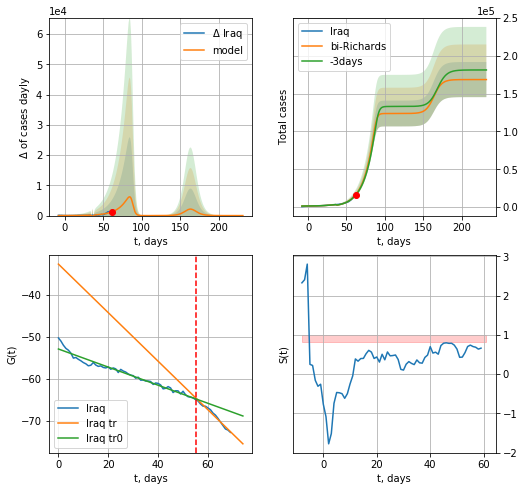

Iraq data at: 2020-06-11
+3 day model MAPE: 0.032353
model: bi-Richards
coeffs: [1.23770937e+05 7.68480748e-02 8.83377442e+01 7.20957009e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.137632
forecast at the end of period: +170 days
	 deltaDaycases: 0
	 total cases: 168628 ± 23208
	 total death: 4621 ± 1907
bi-Richards approximation splitting point: 55
trend coefficient of determination: 0.960102
 intercept: -52.860811
 slope: -0.215103
trend coefficient of determination: 0.979946
 intercept: -32.686291
 slope: -0.577102


In [312]:
vL=85#25+10
x = forecastRR("Iraq",dfIQ[30:vL-30],d1,14*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Iraq",dfIQ[30:],d1,35*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL-30)

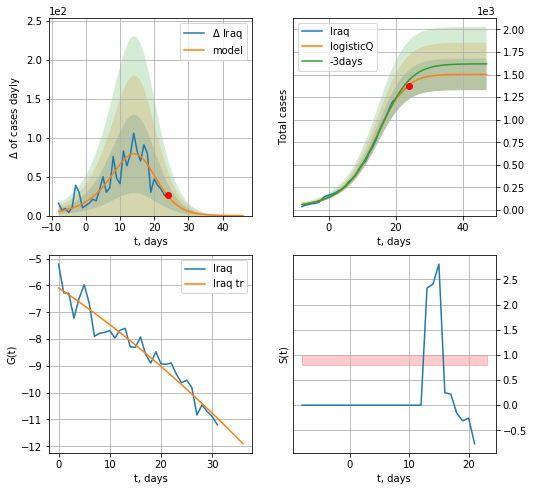

Iraq data at: 2020-06-11
+3 day model MAPE: 0.041008
model: logisticQ
coeffs: [ 1.50291916e+03  2.94853860e-03  1.34415511e+01 -5.72228334e+01]
rational stdev: 0.116469
forecast at the end of period: +23 days
	 deltaDaycases: 0
	 total cases: 1502 ± 175
	 total death: 41 ± 14
trend coefficient of determination: 0.930646
 intercept_: -6.090644942877015
 coeffs_: [ 0.         -0.12791486 -0.00093535]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


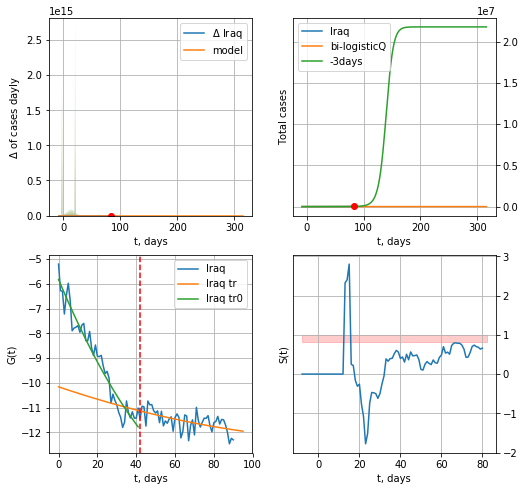

Iraq data at: 2020-06-11
+3 day model MAPE: 0.782087
model: bi-logisticQ
coeffs: [ 2.56084317e+03  6.02414558e+00  2.13729074e+01 -1.65403834e+00]
rational stdev: 0.799653
forecast at the end of period: +233 days
	 deltaDaycases: 0
	 total cases: 4063 ± 3249
	 total death: 111 ± 266
bi-logisticQ approximation splitting point: 42
trend coefficient of determination: 0.941003
 intercept_: -5.824005146615983
 coeffs_: [ 0.         -0.18682641  0.00101526]
trend coefficient of determination: 0.314057
 intercept_: -10.160557899657814
 coeffs_: [ 0.00000000e+00 -2.66586174e-02  8.20070064e-05]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [313]:
x = forecastRRR("Iraq",dfIQ[9:42],d1,14*7-dT,addpred=False,xcoef=[0.35,.5,4.,1])
xx = forecast2RRR("Iraq",dfIQ[9:],d1,44*7-dT,x,addpred=False,xcoef=koreaCoeffs,vL=42)

In [314]:
#len(dfAR)

AR
          date    cases  active  death
95 2020-06-07  10154.0  2730.0  707.0
96 2020-06-08  10265.0  2751.0  715.0
97 2020-06-09  10382.0  2707.0  724.0
98 2020-06-10  10484.0  2678.0  732.0
99 2020-06-11  10589.0  2593.0  741.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


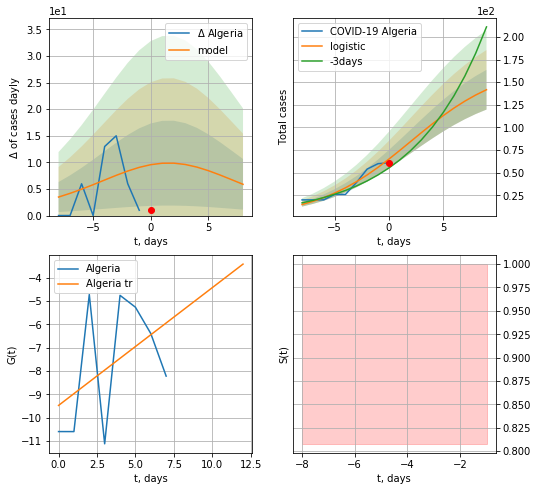

Algeria data at: 2020-06-11
+3 day model MAPE: 0.16392556519478307
model: logistic
coeffs:  [169.67177645   0.23328983   2.04237406]
rational stdev:  0.15467845008978148
forecast at the end of period: +9 days
	 deltaDaycases:  5
	 total cases:  141 ± 21
	 total death:  9 ± 4
trend coefficient of determination: 0.198482
 intercept: -9.477734
 slope: 0.504434


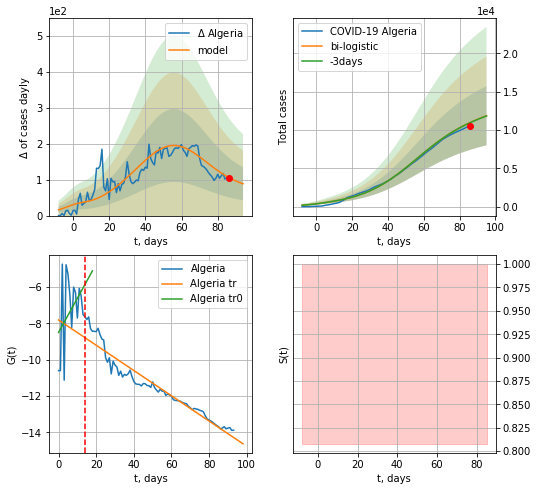

Algeria data at: 2020-06-11
+3 day model MAPE: 0.0024718449607719836
model: bi-logistic
coeffs:  [1.17758457e+04 6.46141281e-02 5.54348747e+01] [169.67177645   0.23328983   2.04237406]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.32487306560881707
forecast at the end of period: +9 days
	 deltaDaycases:  88
	 total cases:  11874 ± 3857
	 total death:  830 ± 808
bi-logistic approximation splitting point: 14
trend0 coefficient of determination: 0.134003
 intercept: -8.492024
 slope: 0.188486
trend coefficient of determination: 0.927286
 intercept: -7.805131
 slope: -0.069643


In [315]:
dfAR = read_df(pd.DataFrame(),"AR")
x = forecast("Algeria",dfAR[5:14],d1,7*12-dT)
xx = forecast2("Algeria",dfAR[5:],d1,7*12-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=14)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


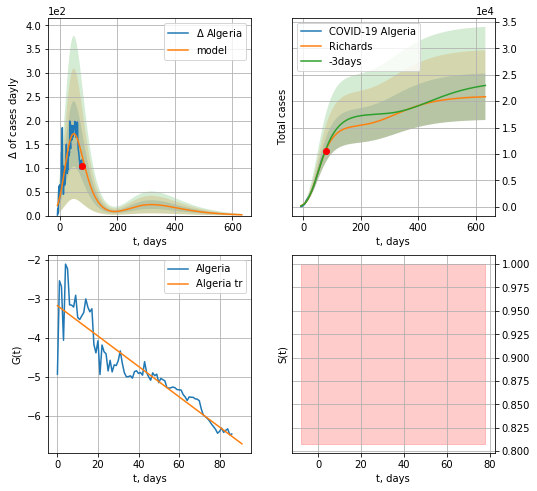

Algeria data at: 2020-06-11
+3 day model MAPE: 0.015914
model: Richards
coeffs: [1.54069844e+04 1.66813723e-01 1.07302529e+00 2.00096864e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.211225
forecast at the end of period: +555 days
	 deltaDaycases: 1
	 total cases: 20837 ± 4401
	 total death: 1458 ± 923
trend coefficient of determination: 0.853340
 intercept: -3.180308
 slope: -0.038891


In [316]:
x = forecastRR("Algeria",dfAR[12:],d1,90*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


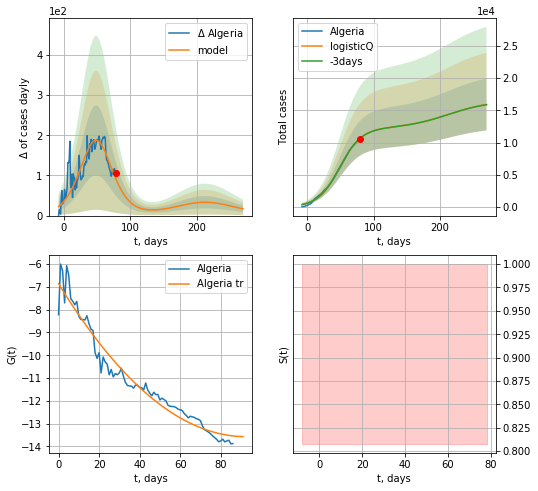

Algeria data at: 2020-06-11
+3 day model MAPE: 0.000999
model: logisticQ
coeffs: [ 1.22114872e+04  1.55788748e-06  4.87234558e+01 -3.91970710e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.252508
forecast at the end of period: +191 days
	 deltaDaycases: 16
	 total cases: 15907 ± 4016
	 total death: 1113 ± 843
trend coefficient of determination: 0.953046
 intercept_: -6.854216970604625
 coeffs_: [ 0.         -0.14548605  0.00078726]


In [317]:
x = forecastRRR("Algeria",dfAR[12:],d1,38*7-dT,addpred=True,xcoef=koreaCoeffs)

CP
          date  cases  active  death
87 2020-06-07  964.0   139.0   18.0
88 2020-06-08  970.0   145.0   18.0
89 2020-06-09  972.0   147.0   18.0
90 2020-06-10  974.0   149.0   18.0
91 2020-06-11  975.0   150.0   18.0


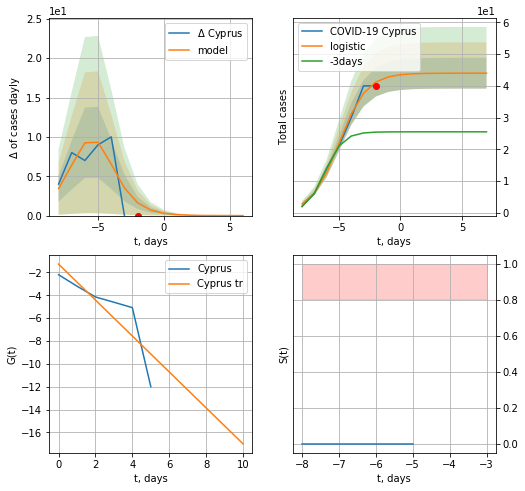

Cyprus data at: 2020-06-11
+3 day model MAPE: 0.6804910041763989
model: logistic
coeffs:  [44.00930084  0.89972657 -4.98223467]
rational stdev:  0.11057143078785021
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  44 ± 4
	 total death:  0 ± 0
trend coefficient of determination: 0.714597
 intercept: -1.270285
 slope: -1.572073


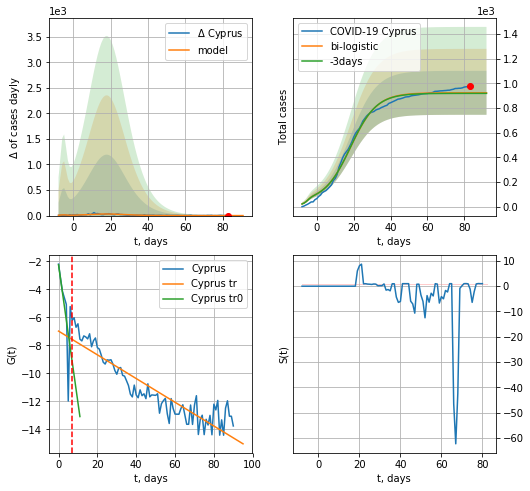

Cyprus data at: 2020-06-11
+3 day model MAPE: 0.0049029658600492215
model: bi-logistic
coeffs:  [8.79247690e+02 1.40535392e-01 1.83159409e+01] [44.00930084  0.89972657 -4.98223467]
rational stdev:  0.1926522977293364
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  923 ± 177
	 total death:  17 ± 9
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.449603
 intercept: -2.247366
 slope: -0.985825
trend coefficient of determination: 0.839425
 intercept: -6.985155
 slope: -0.084793


In [318]:
dfCP = read_df(pd.DataFrame(),"CP")
dfCP = dfCP.fillna(0)
x = forecast("Cyprus",dfCP[:7],d1,7*12-dT)
xx = forecast2("Cyprus",dfCP[:],d1,12*7-dT,x,addpred=False,xcoef=[0.25,1.,2.3],vL=7)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


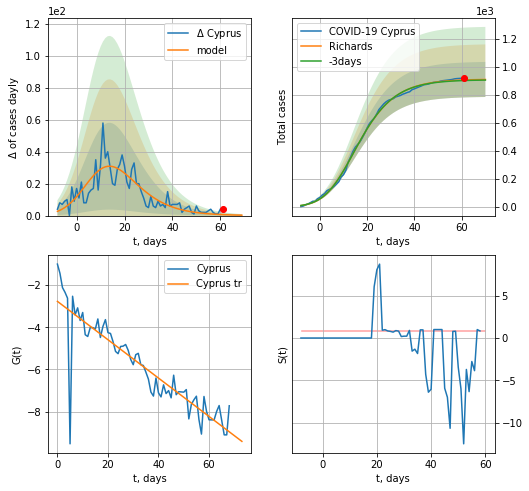

Cyprus data at: 2020-06-11
+3 day model MAPE: 0.004368
model: Richards
coeffs: [9.11933822e+02 3.20830854e-01 3.99756256e+00 3.34642778e-01]
rational stdev: 0.137523
forecast at the end of period: +9 days
	 deltaDaycases: 0
	 total cases: 909 ± 125
	 total death: 16 ± 6
trend coefficient of determination: 0.787995
 intercept: -2.772129
 slope: -0.090979


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


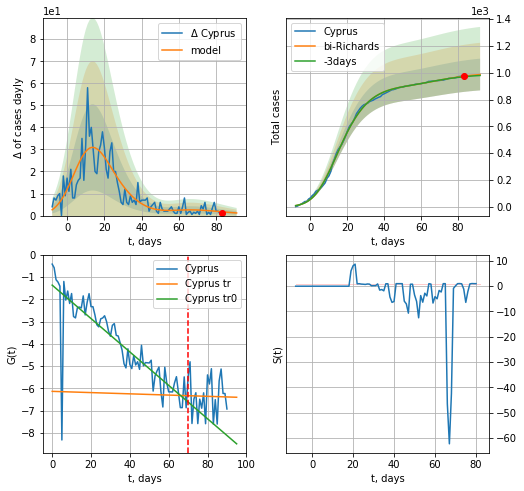

Cyprus data at: 2020-06-11
+3 day model MAPE: 0.004142
model: bi-Richards
coeffs: [ 9.38407845e+01  1.09228857e+01 -6.35124271e+00  6.11782870e-03]
rational stdev: 0.119905
forecast at the end of period: +9 days
	 deltaDaycases: 1
	 total cases: 986 ± 118
	 total death: 18 ± 6
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.728078
 intercept: -1.360560
 slope: -0.075038
trend coefficient of determination: 0.000368
 intercept: -6.132326
 slope: -0.002790


In [319]:
vL=70
x = forecastRR("Cyprus",dfCP[:vL],d1,12*7-dT,addpred=False,xcoef=RkoreaCoeffs)
x = forecast2RR("Cyprus",dfCP[:],d1,12*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


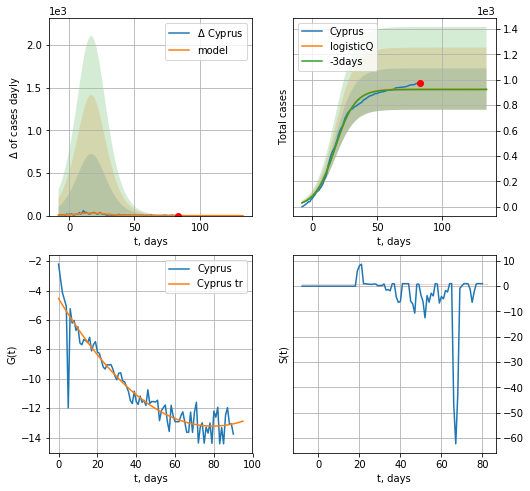

Cyprus data at: 2020-06-11
+3 day model MAPE: 0.004686
model: logisticQ
coeffs: [ 9.26437953e+02  5.84604469e-07  1.74729212e+01 -2.22622344e+05]
rational stdev: 0.175703
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 926 ± 162
	 total death: 17 ± 8
trend coefficient of determination: 0.888874
 intercept_: -4.542146387561239
 coeffs_: [ 0.         -0.21875355  0.00137817]


In [320]:
vL=33
x = forecastRRR("Cyprus",dfCP[:],d1,18*7-dT,addpred=False,xcoef=koreaCoeffs)
#xx = forecast2RRR("Cyprus",dfCP[:],d1,20*7-dT,x,addpred=True,xcoef=[0.35,.5,4,1],vL=vL)

PU
          date   cases    active   death
92 2020-06-07  196515  104831.0  5465.0
93 2020-06-08  199696  104569.0  5571.0
94 2020-06-09  203736  105069.0  5738.0
95 2020-06-10  208823  104889.0  5903.0
96 2020-06-11  214788  106250.0  6109.0


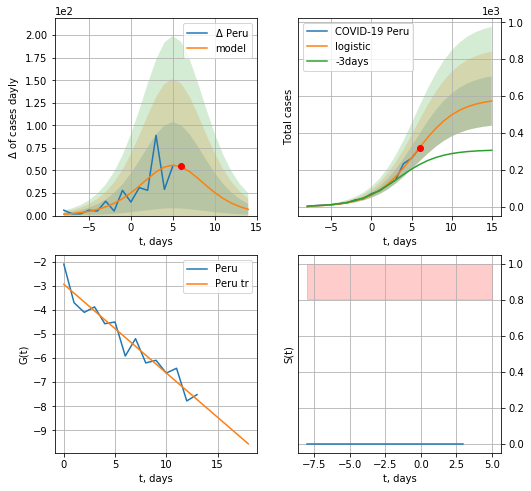

Peru data at: 2020-06-11
+3 day model MAPE: 0.4976759510371563
model: logistic
coeffs:  [5.88914141e+02 3.80777382e-01 5.52424877e+00]
rational stdev:  0.23355774891059702
forecast at the end of period: +9 days
	 deltaDaycases:  6
	 total cases:  573 ± 133
	 total death:  16 ± 11
trend coefficient of determination: 0.924015
 intercept: -2.937528
 slope: -0.367722


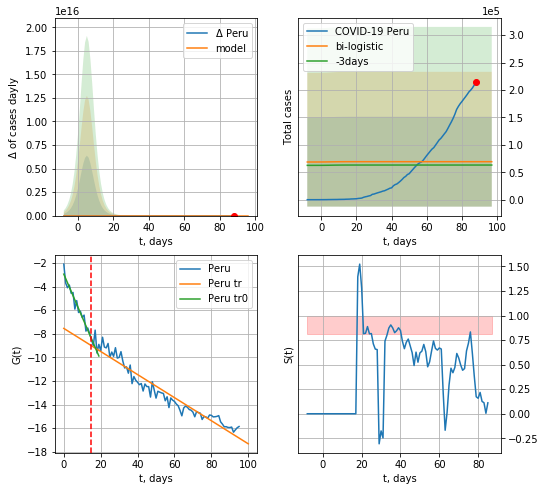

Peru data at: 2020-06-11
+3 day model MAPE: 0.09696239194257085
model: bi-logistic
coeffs:  [ 5.49717502e+04 -7.58867851e+00  1.94297811e+02] [5.88914141e+02 3.80777382e-01 5.52424877e+00]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  1.1817195609989528
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  69303 ± 81897
	 total death:  1971 ± 6987
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.936345
 intercept: -2.948740
 slope: -0.365135
trend coefficient of determination: 0.938228
 intercept: -7.547926
 slope: -0.097789


In [321]:
dfPU = read_df(pd.DataFrame(),"PU")
dfPU = dfPU.fillna(0)
x = forecast("Peru",dfPU[:15],d1,7*12-dT)
xx = forecast2("Peru",dfPU[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


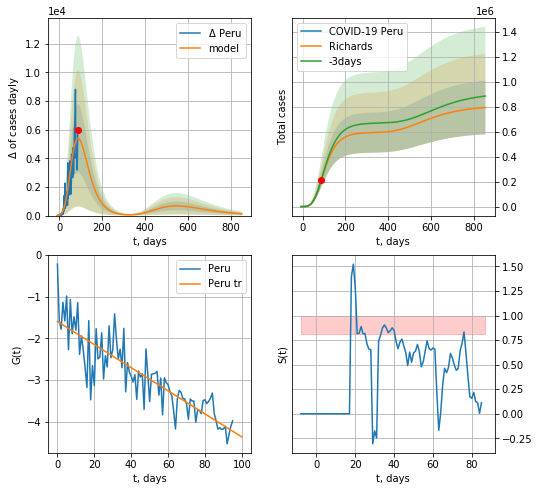

Peru data at: 2020-06-11
+3 day model MAPE: 0.014728
model: Richards
coeffs: [ 5.93537220e+05  7.77612173e-01 -4.78405646e+01  3.22985008e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.270958
forecast at the end of period: +765 days
	 deltaDaycases: 124
	 total cases: 793619 ± 215037
	 total death: 22572 ± 18348
trend coefficient of determination: 0.746613
 intercept: -1.594808
 slope: -0.027750


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


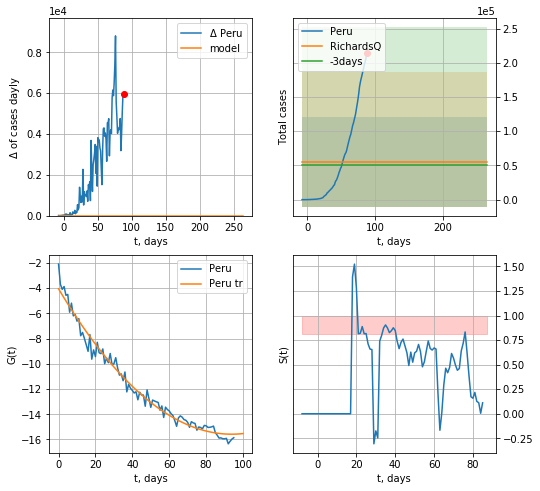

Peru data at: 2020-06-11
+3 day model MAPE: 0.096959
model: RichardsQ
coeffs: [ 5.54754434e+04  2.05554408e+01 -3.00049740e+03  2.57225727e+03
 -7.05558349e+00]
rational stdev: 1.183538
forecast at the end of period: +177 days
	 deltaDaycases: 0
	 total cases: 55475 ± 65657
	 total death: 1577 ± 5599
trend coefficient of determination: 0.977861
 intercept_: -4.058127254595998
 coeffs_: [ 0.        -0.2456057  0.0013087]


In [322]:
x = forecastRR("Peru",dfPU[:],d1,120*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR("Peru",dfPU[:],d1,36*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


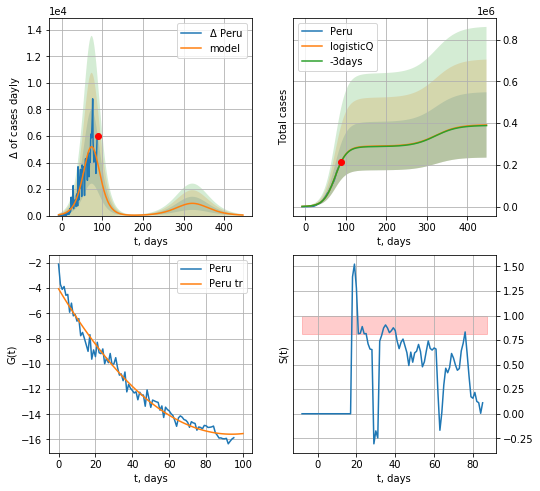

Peru data at: 2020-06-11
+3 day model MAPE: 0.002821
model: logisticQ
coeffs: [ 2.89872143e+05  1.48572701e-06  7.38155630e+01 -4.81694413e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.400307
forecast at the end of period: +359 days
	 deltaDaycases: 40
	 total cases: 391422 ± 156688
	 total death: 11132 ± 13368
trend coefficient of determination: 0.977861
 intercept_: -4.058127254595998
 coeffs_: [ 0.        -0.2456057  0.0013087]


In [323]:
x = forecastRRR("Peru",dfPU[:].fillna(0),d1,62*7-dT,addpred=True,xcoef=koreaCoeffs)

ID
           date   cases    active   death
99  2020-06-07  258090  126788.0  7207.0
100 2020-06-08  267046  130358.0  7473.0
101 2020-06-09  275413  133529.0  7719.0
102 2020-06-10  287155  138069.0  8107.0
103 2020-06-11  298283  142587.0  8501.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


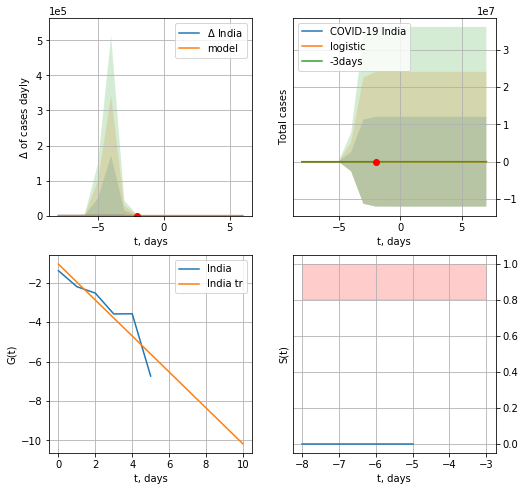

India data at: 2020-06-11
+3 day model MAPE: 0.19485949734745373
model: logistic
coeffs:  [29.40035511  4.01433678 -3.67575724]
rational stdev:  409363.3184161478
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  29 ± 12035426
	 total death:  0 ± 0
trend coefficient of determination: 0.835838
 intercept: -1.052904
 slope: -0.912220


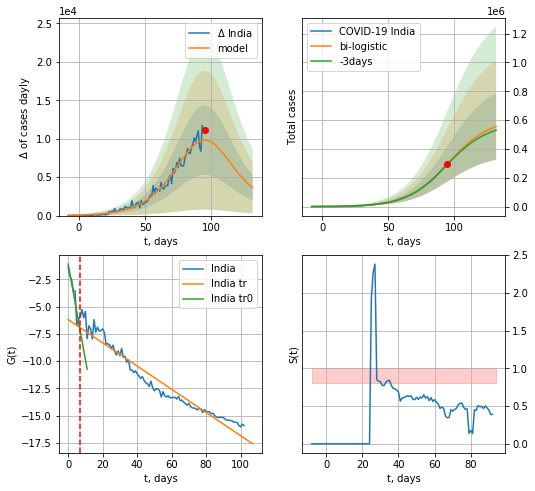

India data at: 2020-06-11
+3 day model MAPE: 0.011834590231595827
model: bi-logistic
coeffs:  [5.94567441e+05 6.56613439e-02 9.52157107e+01] [29.40035511  4.01433678 -3.67575724]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.41389233458637303
forecast at the end of period: +37 days
	 deltaDaycases:  3638
	 total cases:  556243 ± 230224
	 total death:  15852 ± 19683
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.879788
 intercept: -1.115653
 slope: -0.874570
trend coefficient of determination: 0.940630
 intercept: -6.195149
 slope: -0.106276


In [324]:
dfID = read_df(pd.DataFrame(),"ID")
dfID = dfID.fillna(0)
x = forecast("India",dfID[:7],d1,7*12-dT)
xx = forecast2("India",dfID[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=7)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


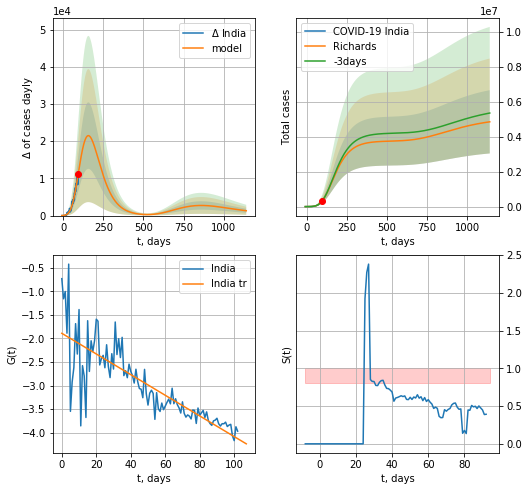

India data at: 2020-06-11
+3 day model MAPE: 0.003793
model: Richards
coeffs: [ 3.76029693e+06  2.94946098e-01 -2.52621554e+01  5.40878022e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.373053
forecast at the end of period: +1045 days
	 deltaDaycases: 1294
	 total cases: 4858245 ± 1812384
	 total death: 138458 ± 154956
trend coefficient of determination: 0.671828
 intercept: -1.891187
 slope: -0.021940


In [325]:
x = forecastRR("India",dfID[:],d1,160*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


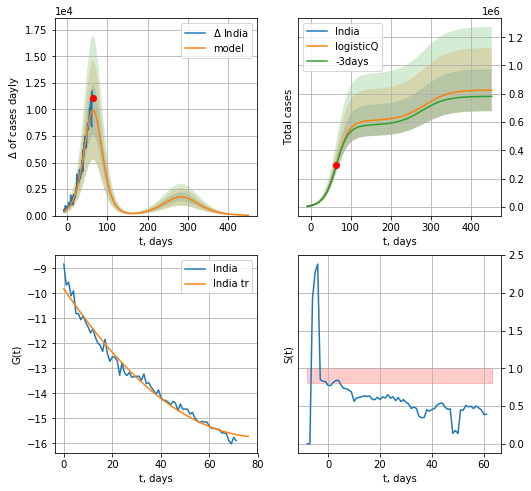

India data at: 2020-06-11
+3 day model MAPE: 0.009693
model: logisticQ
coeffs: [ 6.10494259e+05  5.24513690e-06  6.49555906e+01 -1.23422436e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.180514
forecast at the end of period: +387 days
	 deltaDaycases: 29
	 total cases: 825813 ± 149071
	 total death: 23535 ± 12745
trend coefficient of determination: 0.979963
 intercept_: -9.804075519175901
 coeffs_: [ 0.         -0.14534004  0.0008878 ]


In [326]:
x = forecastRRR("India",dfID[31:].fillna(0),d1,66*7-dT,addpred=True,xcoef=koreaCoeffs)

AG
          date    cases   active  death
95 2020-06-07  22794.0  15221.0  664.0
96 2020-06-08  23620.0  15622.0  693.0
97 2020-06-09  24761.0  16476.0  717.0
98 2020-06-10  25987.0  17261.0  735.0
99 2020-06-11  27373.0  18276.0  765.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


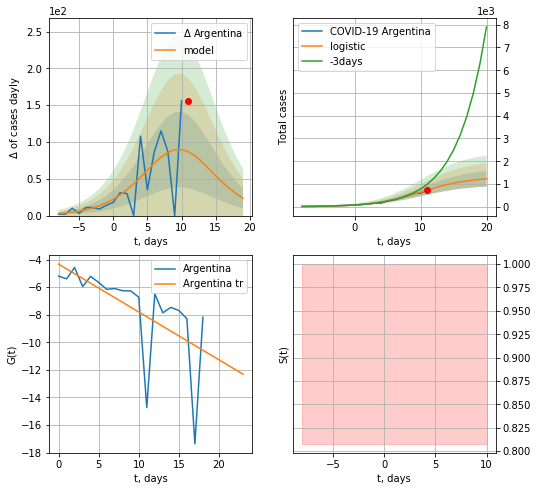

Argentina data at: 2020-06-11
+3 day model MAPE: 0.3427791439688051
model: logistic
coeffs:  [1.30607344e+03 2.75914265e-01 1.01155997e+01]
rational stdev:  0.2777261346981541
forecast at the end of period: +9 days
	 deltaDaycases:  23
	 total cases:  1225 ± 340
	 total death:  34 ± 28
trend coefficient of determination: 0.364190
 intercept: -4.325611
 slope: -0.347113


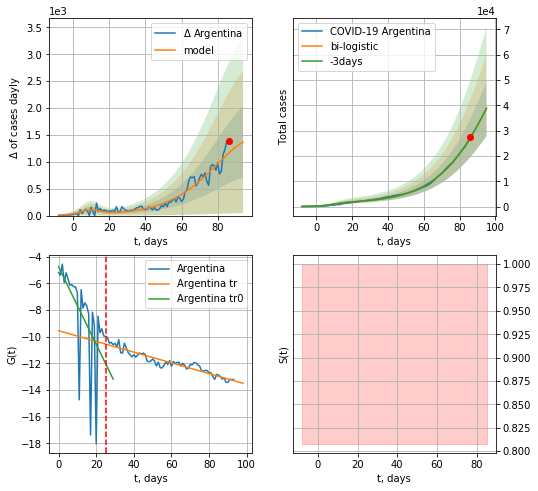

Argentina data at: 2020-06-11
+3 day model MAPE: 0.003899151647837085
model: bi-logistic
coeffs:  [9.43593822e+04 6.08337681e-02 1.01964849e+02] [1.30607344e+03 2.75914265e-01 1.01155997e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.278908574445884
forecast at the end of period: +9 days
	 deltaDaycases:  1365
	 total cases:  38668 ± 10785
	 total death:  1080 ± 903
bi-logistic approximation splitting point: 25
trend0 coefficient of determination: 0.360462
 intercept: -4.766843
 slope: -0.290012
trend coefficient of determination: 0.892052
 intercept: -9.550394
 slope: -0.040201


In [327]:
vL = 25
#vL1 = 40
dfAG = read_df(pd.DataFrame(),"AG")
x = forecast('Argentina',dfAG[5:vL],d1,7*12-dT,1.0)
xx = forecast2('Argentina',dfAG[5:],d1,12*7-dT,x,1.0,vL=vL,addpred=True,xcoef=[.25,1.,2.0])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Argentina",dfAG[5:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


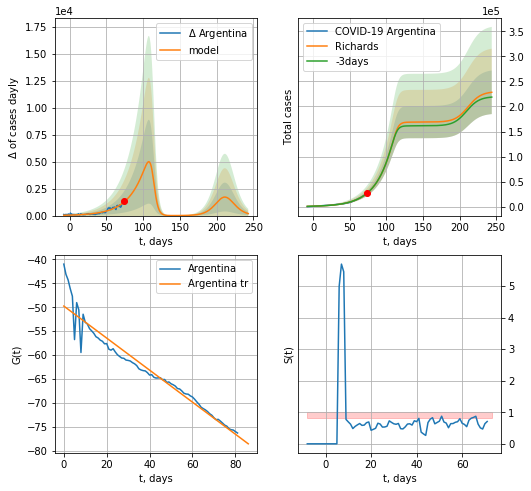

Argentina data at: 2020-06-11
+3 day model MAPE: 0.000947
model: Richards
coeffs: [1.68787801e+05 4.53197819e-02 1.14222766e+02 7.17617043e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.190491
forecast at the end of period: +170 days
	 deltaDaycases: 185
	 total cases: 228330 ± 43494
	 total death: 6381 ± 3646
trend coefficient of determination: 0.936140
 intercept: -49.745528
 slope: -0.335096


In [328]:
x = forecastRR('Argentina',dfAG[17:].fillna(0),d1,35*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


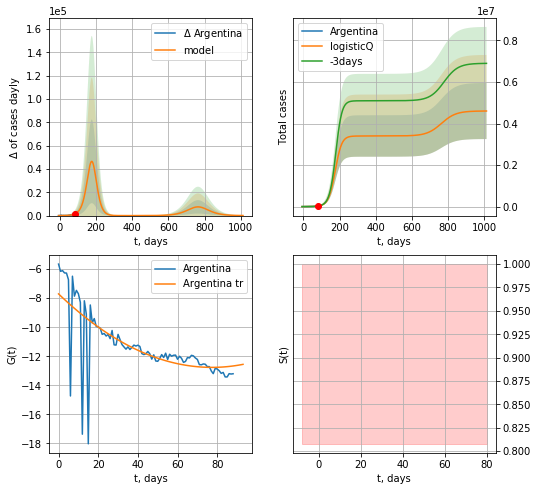

Argentina data at: 2020-06-11
+3 day model MAPE: 0.012738
model: logisticQ
coeffs: [ 3.40046015e+06  3.93889424e-05  1.75286788e+02 -1.21388973e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.293303
forecast at the end of period: +933 days
	 deltaDaycases: 58
	 total cases: 4602535 ± 1349938
	 total death: 128628 ± 113180
trend coefficient of determination: 0.486553
 intercept_: -7.703386979746153
 coeffs_: [ 0.         -0.13084357  0.00084616]


In [329]:
x = forecastRRR('Argentina',dfAG[10:],d1,144*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


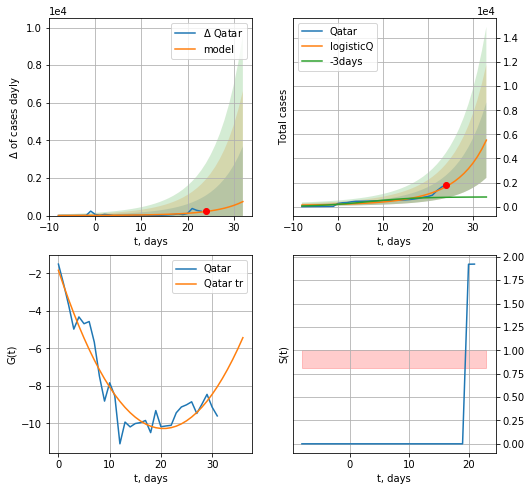

Qatar data at: 2020-06-11
+3 day model MAPE: 1.403655
model: logisticQ
coeffs: [ 4.67633524e+06  1.32940266e-03  6.79779167e+01 -1.11960120e+02]
rational stdev: 0.567221
forecast at the end of period: +9 days
	 deltaDaycases: 743
	 total cases: 5520 ± 3131
	 total death: 5 ± 8
trend coefficient of determination: 0.904406
 intercept_: -1.8341916285683908
 coeffs_: [ 0.         -0.82373816  0.02011068]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:294: RuntimeWarning: overflow encountered in exp


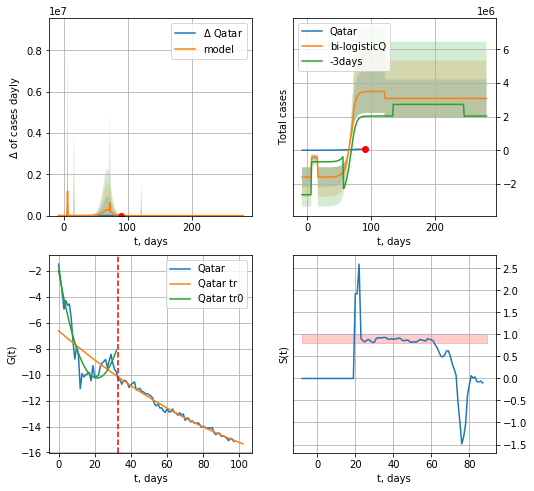

Qatar data at: 2020-06-11
+3 day model MAPE: 0.722703
model: bi-logisticQ
coeffs: [-1.17988513e+06  7.50067063e+01  1.66087178e+01  6.31741149e+00]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.365423
forecast at the end of period: +191 days
	 deltaDaycases: 0
	 total cases: 3078570 ± 1124980
	 total death: 2829 ± 3101
bi-logisticQ approximation splitting point: 33
trend coefficient of determination: 0.887233
 intercept_: -1.9921673153050232
 coeffs_: [ 0.         -0.78114612  0.01840466]
trend coefficient of determination: 0.985583
 intercept_: -6.632037459545731
 coeffs_: [ 0.         -0.11899083  0.00033034]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [330]:
vL=33
x = forecastRRR('Qatar',dfQR[:vL].fillna(0),d1,7*12-dT,1.0,addpred=False,xcoef=[.35,.5,4.0,1])
xx = forecast2RRR('Qatar',dfQR[:].fillna(0),d1,38*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


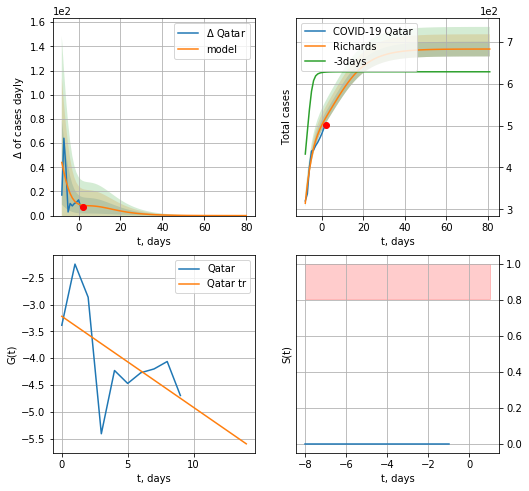

Qatar data at: 2020-06-11
+3 day model MAPE: 0.158936
model: Richards
coeffs: [ 5.01317281e+02  4.80174609e+00 -1.84019810e+01  6.85383715e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.025817
forecast at the end of period: +79 days
	 deltaDaycases: 0
	 total cases: 682 ± 17
	 total death: 0 ± 0
trend coefficient of determination: 0.312842
 intercept: -3.219590
 slope: -0.169880


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


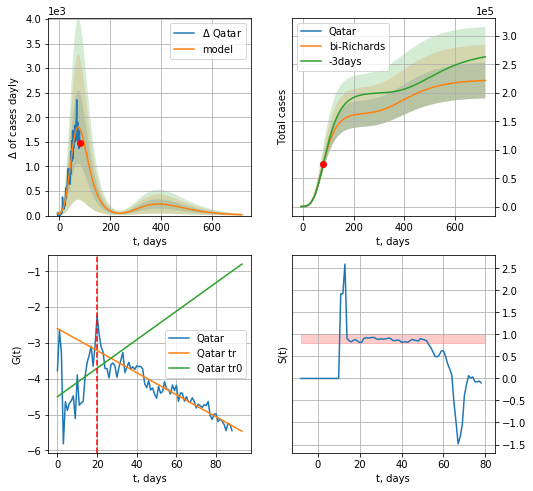

Qatar data at: 2020-06-11
+3 day model MAPE: 0.013960
model: bi-Richards
coeffs: [1.63694235e+05 2.35909457e-01 1.21561777e+01 1.35479886e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.141250
forecast at the end of period: +639 days
	 deltaDaycases: 17
	 total cases: 221919 ± 31346
	 total death: 203 ± 86
bi-Richards approximation splitting point: 20
trend coefficient of determination: 0.082249
 intercept: -4.500799
 slope: 0.039835
trend coefficient of determination: 0.879289
 intercept: -2.595238
 slope: -0.030867


In [335]:
vL = 29
x = forecastRR('Qatar',dfQR[9:vL-9].fillna(0),d1,22*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
xx = forecast2RR('Qatar',dfQR[9:].fillna(0),d1,102*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-9)

In [336]:
#x = forecast('Qatar',dfQR[:],d1,18*7-dT,1.0,addpred=True,xcoef=[.35,.5,4.0,1])

UAE
           date    cases  active  death
113 2020-06-07  38808.0   16726  276.0
114 2020-06-08  39376.0   16820  281.0
115 2020-06-09  39904.0   16881  283.0
116 2020-06-10  40507.0   16206  284.0
117 2020-06-11  40986.0   15466  286.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


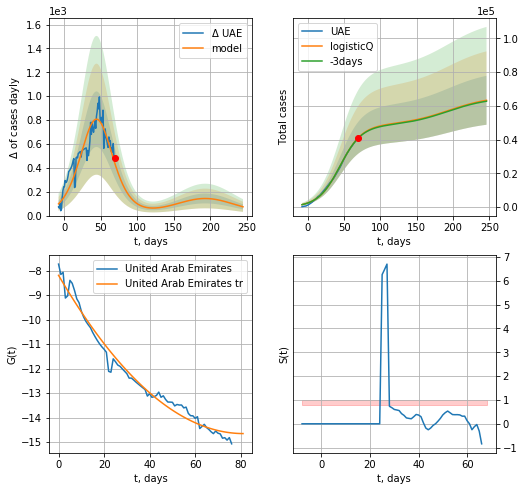

UAE data at: 2020-06-11
+3 day model MAPE: 0.005105
model: logisticQ
coeffs: [ 4.86447885e+04  1.24032940e-06  4.44269663e+01 -5.32313303e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.228825
forecast at the end of period: +177 days
	 deltaDaycases: 73
	 total cases: 63300 ± 14484
	 total death: 441 ± 302
trend coefficient of determination: 0.979116
 intercept_: -8.189793724482387
 coeffs_: [ 0.         -0.15907187  0.00097889]


In [337]:
dfUAE = read_df(pd.DataFrame(),"UAE")
x = forecastRRR('UAE',dfUAE[40:],d1,36*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


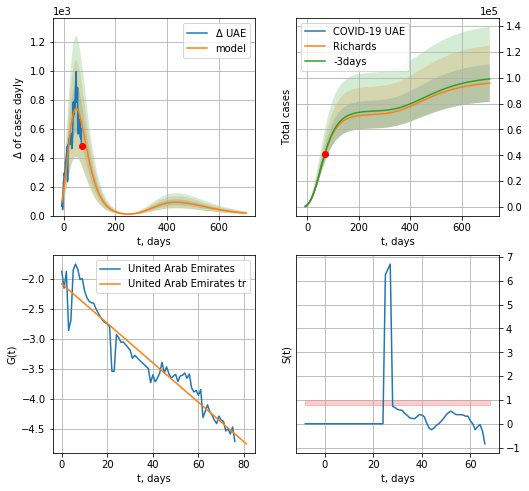

UAE data at: 2020-06-11
+3 day model MAPE: 0.008166
model: Richards
coeffs: [ 7.16254206e+04  1.14725211e+00 -8.23529911e+01  2.47670933e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.151205
forecast at the end of period: +639 days
	 deltaDaycases: 16
	 total cases: 95782 ± 14482
	 total death: 668 ± 303
trend coefficient of determination: 0.910241
 intercept: -2.085614
 slope: -0.032904


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


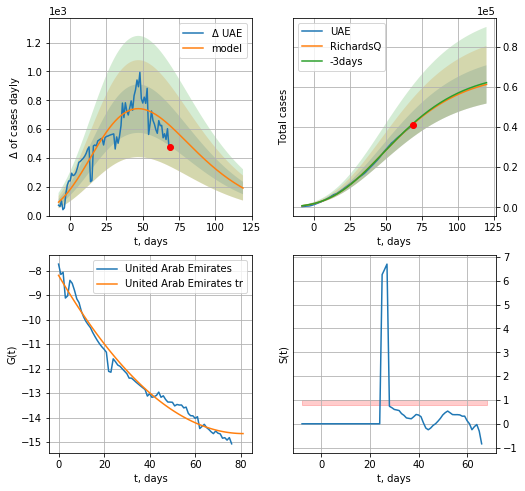

UAE data at: 2020-06-11
+3 day model MAPE: 0.006647
model: RichardsQ
coeffs: [ 6.70355707e+04  4.67671054e-03 -1.66995909e+02 -7.73147590e+02
  6.25050704e-03]
rational stdev: 0.156011
forecast at the end of period: +51 days
	 deltaDaycases: 191
	 total cases: 61322 ± 9566
	 total death: 427 ± 199
trend coefficient of determination: 0.979116
 intercept_: -8.189793724482387
 coeffs_: [ 0.         -0.15907187  0.00097889]


In [338]:
x = forecastRR('UAE',dfUAE[40:],d1,102*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [339]:
#plt.plot(range(len(dfUAE[45:])-1),np.log(np.log(np.log(np.diff(dfUAE[45:].cases)))))

SA
           date     cases  active  death
96  2020-06-07  101914.0   28385  712.0
97  2020-06-08  105283.0   30013  746.0
98  2020-06-09  108571.0   31449  783.0
99  2020-06-10  112288.0   33515  819.0
100 2020-06-11  116021.0   35145  857.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


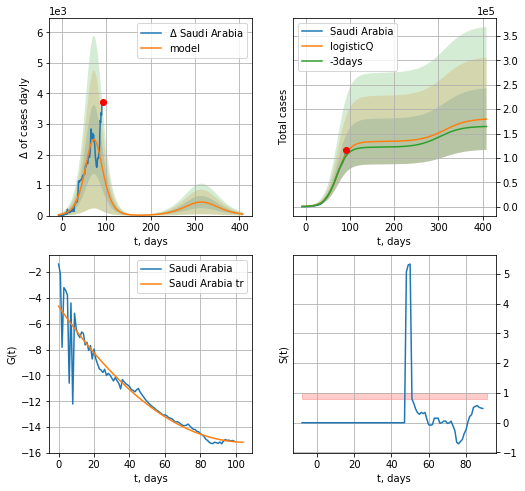

Saudi Arabia data at: 2020-06-11
+3 day model MAPE: 0.044724
model: logisticQ
coeffs: [ 1.33562147e+05  1.18473446e-06  7.21151557e+01 -6.30128543e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.351358
forecast at the end of period: +317 days
	 deltaDaycases: 48
	 total cases: 179554 ± 63087
	 total death: 1326 ± 1397
trend coefficient of determination: 0.899970
 intercept_: -4.642997065944145
 coeffs_: [ 0.         -0.19904274  0.00094029]


In [340]:
dfSA = read_df(pd.DataFrame(),"SA")
x = forecastRRR('Saudi Arabia',dfSA[:],d1,56*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


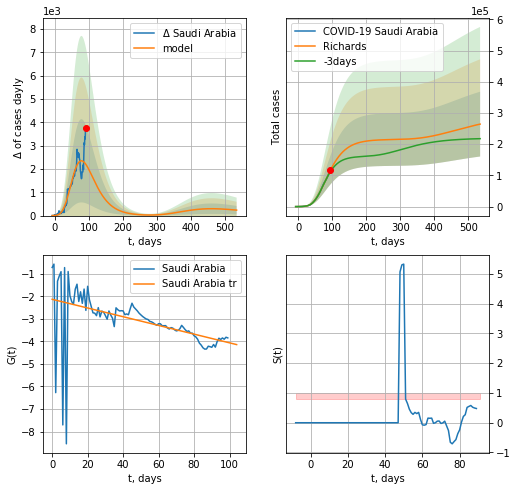

Saudi Arabia data at: 2020-06-11
+3 day model MAPE: 0.037023
model: Richards
coeffs: [ 2.15310024e+05  8.65603954e-01 -3.28986804e+01  3.48547983e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.392750
forecast at the end of period: +443 days
	 deltaDaycases: 235
	 total cases: 264348 ± 103822
	 total death: 1952 ± 2299
trend coefficient of determination: 0.225439
 intercept: -2.128931
 slope: -0.019333


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


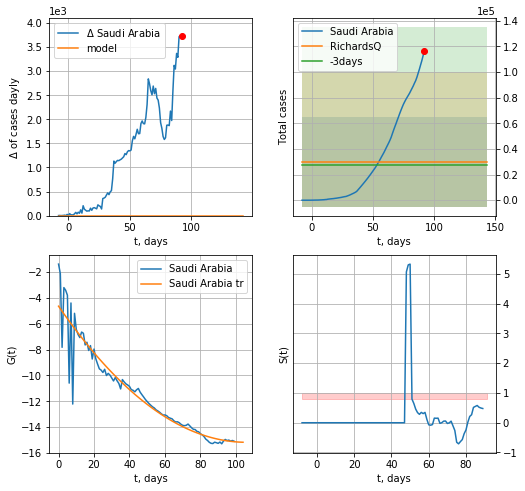

Saudi Arabia data at: 2020-06-11
+3 day model MAPE: 0.091493
model: RichardsQ
coeffs: [ 3.00389705e+04  1.12437469e+01 -1.57265883e+03  1.35783223e+03
 -3.71215848e+00]
rational stdev: 1.165860
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 30038 ± 35021
	 total death: 221 ± 772
trend coefficient of determination: 0.899970
 intercept_: -4.642997065944145
 coeffs_: [ 0.         -0.19904274  0.00094029]


In [341]:
x = forecastRR('Saudi Arabia',dfSA[:],d1,74*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Saudi Arabia',dfSA[:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

Sri
          date   cases  active  death
89 2020-06-07  1835.0     834   11.0
90 2020-06-08  1857.0     856   11.0
91 2020-06-09  1859.0     791   11.0
92 2020-06-10  1869.0     736   11.0
93 2020-06-11  1877.0     716   11.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


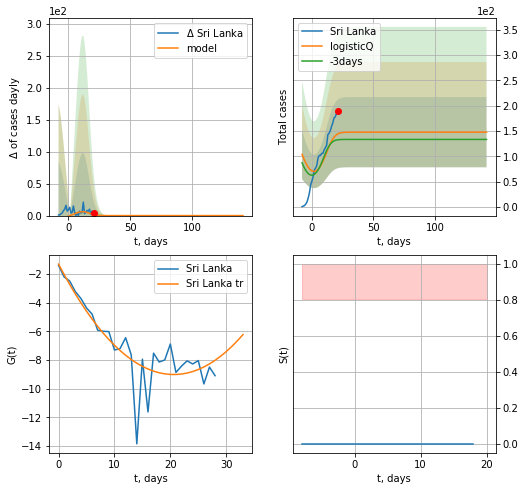

Sri Lanka data at: 2020-06-11
+3 day model MAPE: 0.092819
model: logisticQ
coeffs: [ 1.47873470e+02  1.02179685e-02  4.75701897e+00 -1.32324113e+00]
rational stdev: 0.468203
forecast at the end of period: +121 days
	 deltaDaycases: 0
	 total cases: 147 ± 69
	 total death: 0 ± 0
trend coefficient of determination: 0.737116
 intercept_: -1.300425972375204
 coeffs_: [ 0.         -0.74879164  0.01816974]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


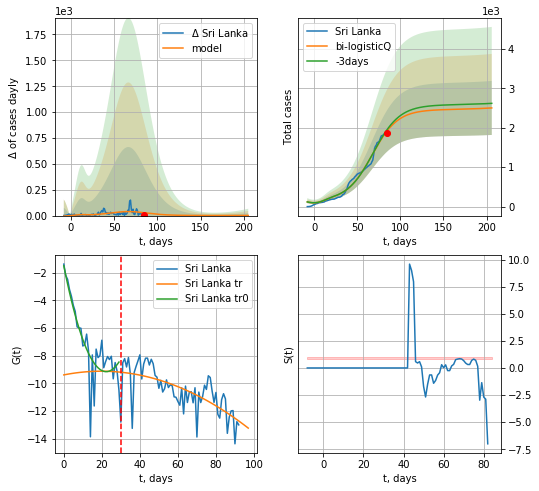

Sri Lanka data at: 2020-06-11
+3 day model MAPE: 0.018378
model: bi-logisticQ
coeffs: [ 2.31237661e+03  7.31350959e-07  6.69727864e+01 -9.19499728e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.273612
forecast at the end of period: +121 days
	 deltaDaycases: 1
	 total cases: 2502 ± 684
	 total death: 14 ± 11
bi-logisticQ approximation splitting point: 30
trend coefficient of determination: 0.725855
 intercept_: -1.5084890363019623
 coeffs_: [ 0.         -0.68634546  0.01540158]
trend coefficient of determination: 0.458211
 intercept_: -9.386833025737204
 coeffs_: [ 0.          0.02714032 -0.00068798]


In [342]:
dfSri = read_df(pd.DataFrame(),"Sri")
vL= 30
x = forecastRRR('Sri Lanka',dfSri[:vL],d1,28*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Sri Lanka',dfSri[:],d1,28*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


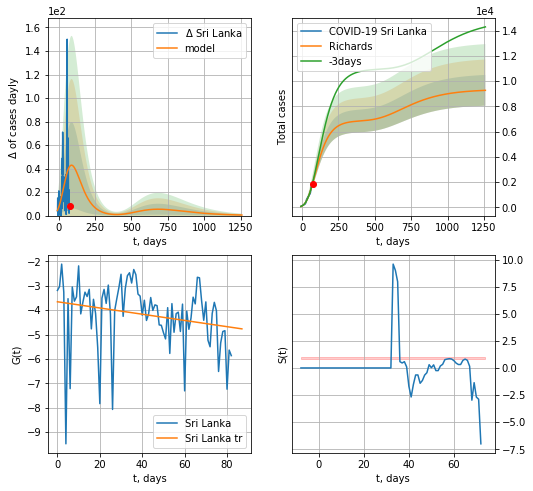

Sri Lanka data at: 2020-06-11
+3 day model MAPE: 0.034434
model: Richards
coeffs: [ 6.86583582e+03  3.22015223e-01 -7.79732304e+01  5.41355566e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.131795
forecast at the end of period: +1185 days
	 deltaDaycases: 0
	 total cases: 9274 ± 1222
	 total death: 54 ± 21
trend coefficient of determination: 0.049588
 intercept: -3.657420
 slope: -0.012769


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


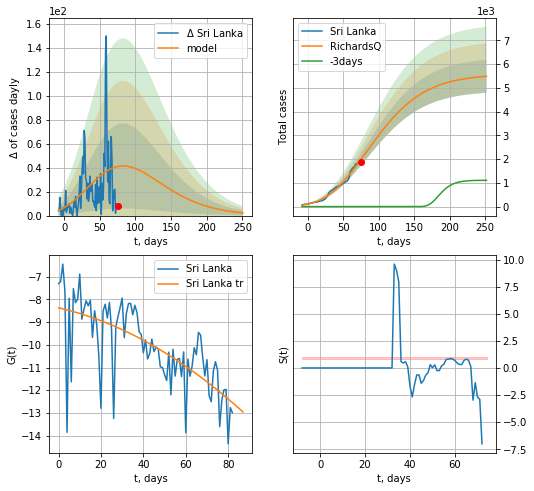

Sri Lanka data at: 2020-06-11
+3 day model MAPE: 4868766730100110690306735803542251869749715694785906409067126165480338941556976941396527448229484664157186746124563299371327538208576660581557859660059489468052866420703232.000000
model: RichardsQ
coeffs: [ 5.56257386e+03  1.40396434e-03 -2.48394993e+02 -4.49058334e+02
  1.69649803e-02]
rational stdev: 0.126406
forecast at the end of period: +177 days
	 deltaDaycases: 2
	 total cases: 5486 ± 693
	 total death: 32 ± 12
trend coefficient of determination: 0.477122
 intercept_: -8.369211081800847
 coeffs_: [ 0.         -0.02117986 -0.00036302]


In [343]:
vL=52
x = forecastRR('Sri Lanka',dfSri[10:],d1,180*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Sri Lanka',dfSri[10:],d1,30*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastQR('Sri Lanka',dfSri[10:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

PS
           date     cases  active   death
101 2020-06-07  103671.0   67249  2067.0
102 2020-06-08  108317.0   71127  2172.0
103 2020-06-09  113702.0   75139  2255.0
104 2020-06-10  119536.0   78789  2356.0
105 2020-06-11  125933.0   83223  2463.0


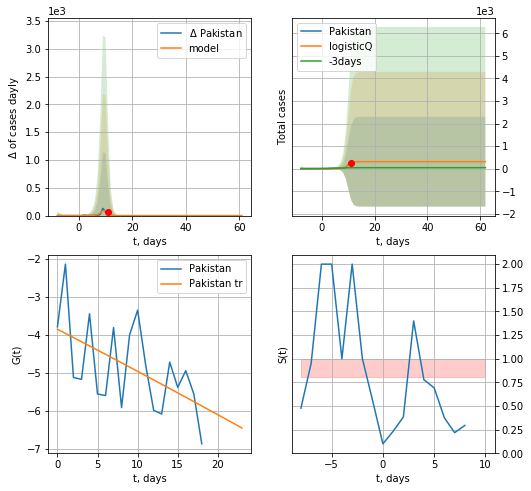

Pakistan data at: 2020-06-11
+3 day model MAPE: 5.954391
model: logisticQ
coeffs: [ 3.10300107e+02  5.80299152e-02  9.88962591e+00 -1.18245381e+01]
rational stdev: 6.420495
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 310 ± 1992
	 total death: 6 ± 115
trend coefficient of determination: 0.293073
 intercept_: -3.8498114630651457
 coeffs_: [ 0.         -0.10964083 -0.00016191]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


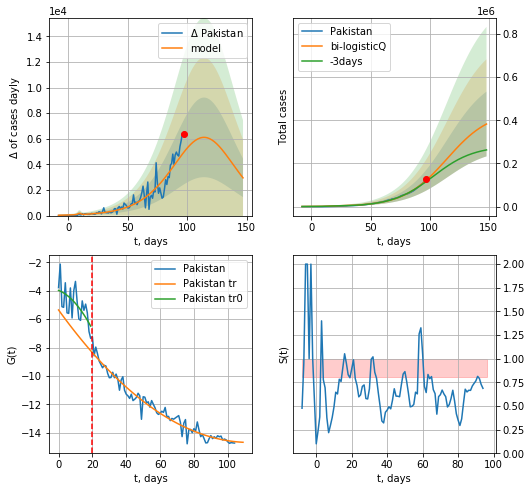

Pakistan data at: 2020-06-11
+3 day model MAPE: 0.055269
model: bi-logisticQ
coeffs: [ 4.42729600e+05  4.53894121e-06  1.14600446e+02 -1.20437803e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.391907
forecast at the end of period: +51 days
	 deltaDaycases: 2946
	 total cases: 382804 ± 150023
	 total death: 7486 ± 8801
bi-logisticQ approximation splitting point: 20
trend coefficient of determination: 0.391568
 intercept_: -3.9808806978581046
 coeffs_: [ 0.         -0.04620278 -0.00453428]
trend coefficient of determination: 0.960586
 intercept_: -5.357027355070301
 coeffs_: [ 0.         -0.16489846  0.00072914]


In [344]:
dfPS = read_df(pd.DataFrame(),"PS")
vL= 20
x = forecastRRR('Pakistan',dfPS[:vL],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Pakistan',dfPS[:],d1,18*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


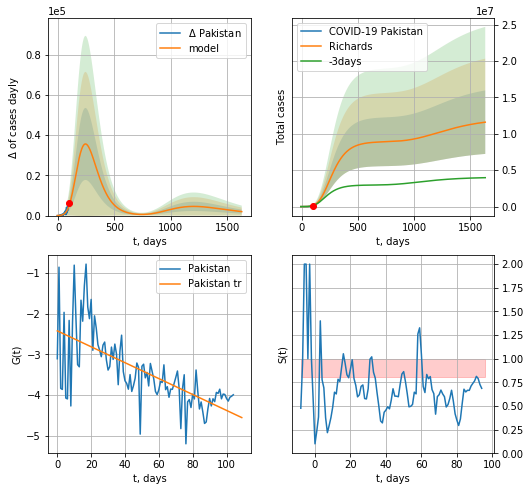

Pakistan data at: 2020-06-11
+3 day model MAPE: 0.039568
model: Richards
coeffs: [8.92498218e+06 1.31338453e-01 2.59827952e+01 8.61367514e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.376044
forecast at the end of period: +1535 days
	 deltaDaycases: 1977
	 total cases: 11595452 ± 4360399
	 total death: 226784 ± 255842
trend coefficient of determination: 0.464076
 intercept: -2.425368
 slope: -0.019501


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


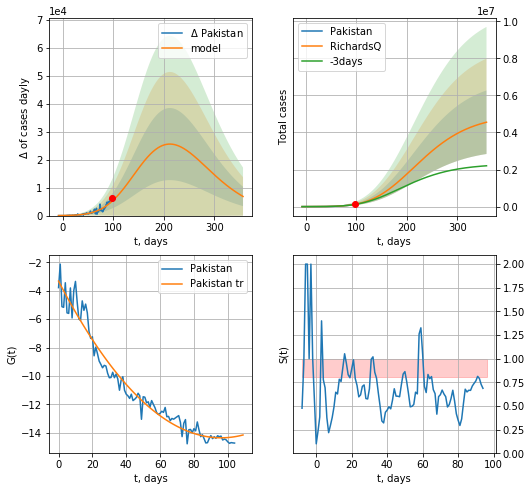

Pakistan data at: 2020-06-11
+3 day model MAPE: 0.037647
model: RichardsQ
coeffs: [ 4.94539642e+06  6.00405721e-04 -3.41791320e+02 -3.40436156e+02
  2.15720036e-02]
rational stdev: 0.376476
forecast at the end of period: +261 days
	 deltaDaycases: 6849
	 total cases: 4553764 ± 1714382
	 total death: 89062 ± 100589
trend coefficient of determination: 0.961799
 intercept_: -3.330223438639501
 coeffs_: [ 0.         -0.22951263  0.0011946 ]


In [345]:
x = forecastRR('Pakistan',dfPS[:],d1,230*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Pakistan',dfPS[:],d1,48*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

BN
          date    cases  active   death
91 2020-06-07  65769.0   50978   888.0
92 2020-06-08  68504.0   53014   930.0
93 2020-06-09  71675.0   55363   975.0
94 2020-06-10  74865.0   57953  1012.0
95 2020-06-11  78052.0   60256  1049.0


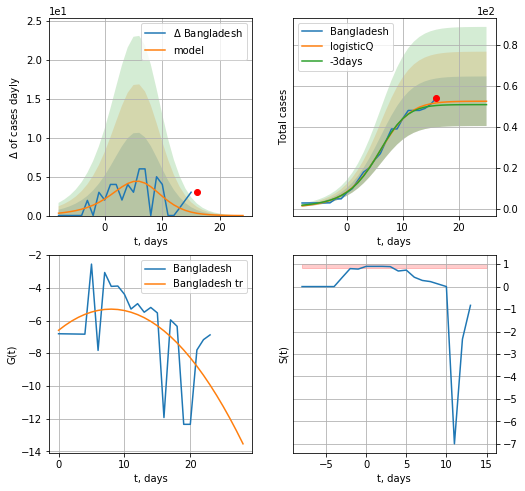

Bangladesh data at: 2020-06-11
+3 day model MAPE: 0.027574
model: logisticQ
coeffs: [ 5.24923176e+01  5.83632898e-03  5.49442770e+00 -5.18799455e+01]
rational stdev: 0.229670
forecast at the end of period: +9 days
	 deltaDaycases: 0
	 total cases: 52 ± 12
	 total death: 0 ± 0
trend coefficient of determination: 0.276192
 intercept_: -6.599187027141191
 coeffs_: [ 0.          0.32583568 -0.02049035]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


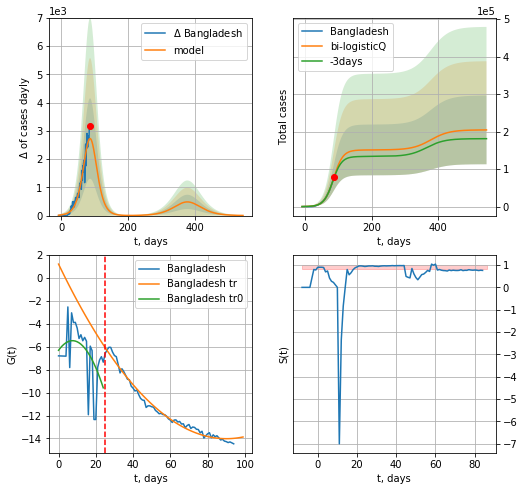

Bangladesh data at: 2020-06-11
+3 day model MAPE: 0.027419
model: bi-logisticQ
coeffs: [ 1.51031116e+05  3.20098616e-06  8.65499951e+01 -2.24993092e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.447754
forecast at the end of period: +457 days
	 deltaDaycases: 4
	 total cases: 204448 ± 91542
	 total death: 2747 ± 3689
bi-logisticQ approximation splitting point: 25
trend coefficient of determination: 0.232653
 intercept_: -6.325425729788838
 coeffs_: [ 0.          0.22449345 -0.0150245 ]
trend coefficient of determination: 0.983531
 intercept_: 1.1757508246127077
 coeffs_: [ 0.         -0.33722841  0.00187131]


In [346]:
dfBN = read_df(pd.DataFrame(),"BN")
vL= 25
x = forecastRRR('Bangladesh',dfBN[:vL],d1,12*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Bangladesh',dfBN[:],d1,76*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


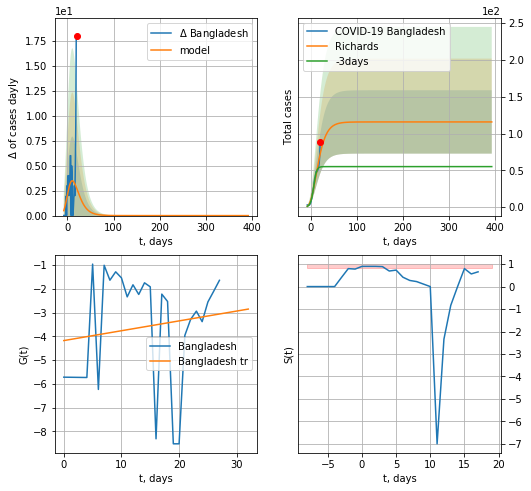

Bangladesh data at: 2020-06-11
+3 day model MAPE: 0.373626
model: Richards
coeffs: [ 1.15736925e+02  6.45824667e+00 -4.20178539e+01  1.27654554e-02]
rational stdev: 0.371727
forecast at the end of period: +373 days
	 deltaDaycases: 0
	 total cases: 115 ± 43
	 total death: 1 ± 1
trend coefficient of determination: 0.020746
 intercept: -4.180817
 slope: 0.041430


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


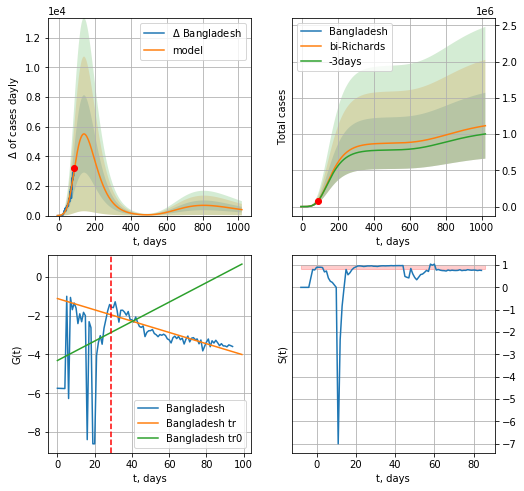

Bangladesh data at: 2020-06-11
+3 day model MAPE: 0.007644
model: bi-Richards
coeffs: [ 8.75964074e+05  5.02482716e-01 -5.28666507e+01  3.46384026e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.407159
forecast at the end of period: +933 days
	 deltaDaycases: 402
	 total cases: 1115466 ± 454172
	 total death: 14991 ± 18311
bi-Richards approximation splitting point: 29
trend coefficient of determination: 0.032969
 intercept: -4.311810
 slope: 0.050247
trend coefficient of determination: 0.807937
 intercept: -1.114188
 slope: -0.029162


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


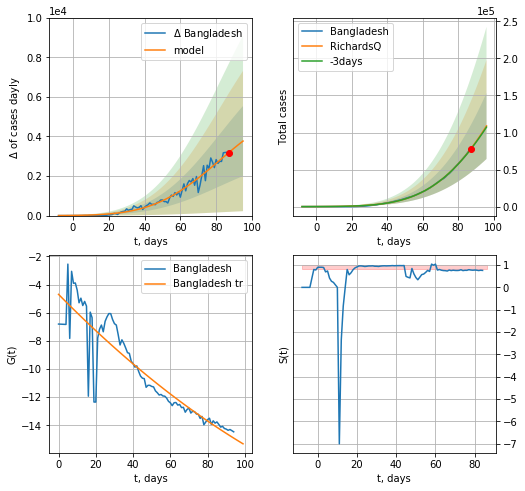

Bangladesh data at: 2020-06-11
+3 day model MAPE: 0.008089
model: RichardsQ
coeffs: [ 6.72184868e+05  2.62542182e-03 -3.22471099e+02 -3.46577828e+02
  8.54619837e-03]
rational stdev: 0.409197
forecast at the end of period: +9 days
	 deltaDaycases: 3764
	 total cases: 108890 ± 44557
	 total death: 1463 ± 1795
trend coefficient of determination: 0.831436
 intercept_: -4.699094533759436
 coeffs_: [ 0.         -0.13447896  0.00027523]


In [347]:
vL=29
x = forecastRR('Bangladesh',dfBN[:vL],d1,64*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Bangladesh',dfBN[:],d1,144*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastQR('Bangladesh',dfBN[:],d1,12*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

KW
           date    cases  active  death
104 2020-06-07  31848.0   11379  264.0
105 2020-06-08  32510.0   10999  269.0
106 2020-06-09  33140.0   10705  273.0
107 2020-06-10  33823.0   10260  275.0
108 2020-06-11  34432.0   10016  279.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


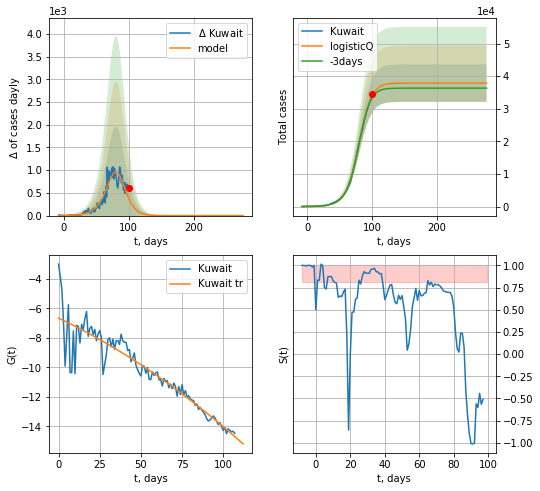

Kuwait data at: 2020-06-11
+3 day model MAPE: 0.019150
model: logisticQ
coeffs: [ 3.78796172e+04  2.30530058e-04  7.99094164e+01 -3.58729426e+02]
rational stdev: 0.151657
forecast at the end of period: +177 days
	 deltaDaycases: 0
	 total cases: 37879 ± 5744
	 total death: 306 ± 139
trend coefficient of determination: 0.864152
 intercept_: -6.664803476403785
 coeffs_: [ 0.         -0.05284428 -0.0002073 ]


In [348]:
dfKW = read_df(pd.DataFrame(),"KW")
x = forecastRRR('Kuwait',dfKW[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


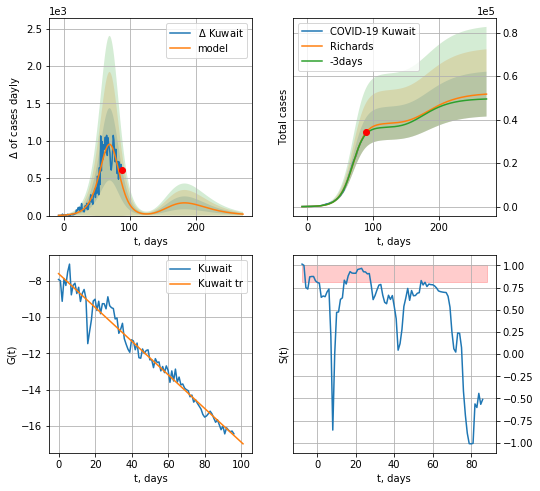

Kuwait data at: 2020-06-11
+3 day model MAPE: 0.020360
model: Richards
coeffs: [3.83988698e+04 8.84302892e-02 7.15318529e+01 1.18801880e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.199073
forecast at the end of period: +184 days
	 deltaDaycases: 19
	 total cases: 51764 ± 10304
	 total death: 419 ± 250
trend coefficient of determination: 0.964799
 intercept: -7.605648
 slope: -0.092979


In [349]:
iL= 11
vL = 24 + iL
x = forecastRR('Kuwait',dfKW[iL:],d1,37*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Kuwait',dfKW[iL:],d1,37*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-iL)

DM
           date    cases  active  death
98  2020-06-07  19600.0    7055  538.0
99  2020-06-08  20126.0    7429  539.0
100 2020-06-09  20415.0    7663  544.0
101 2020-06-10  20808.0    7940  550.0
102 2020-06-11  21437.0    8335  561.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


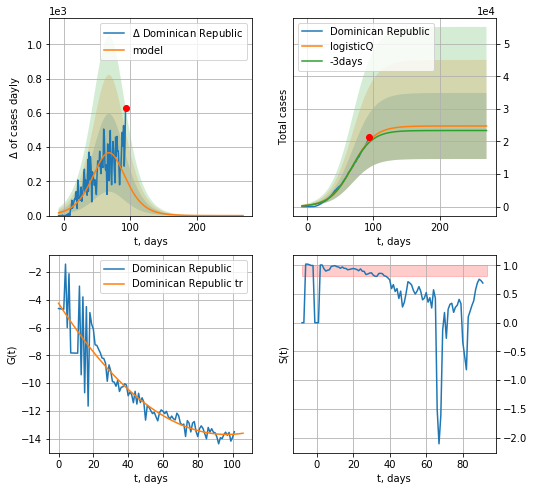

Dominican Republic data at: 2020-06-11
+3 day model MAPE: 0.027476
model: logisticQ
coeffs: [ 2.47455711e+04  5.44602025e-07  6.83735306e+01 -1.09023022e+05]
rational stdev: 0.409580
forecast at the end of period: +177 days
	 deltaDaycases: 0
	 total cases: 24745 ± 10135
	 total death: 647 ± 794
trend coefficient of determination: 0.858833
 intercept_: -4.24779470243392
 coeffs_: [ 0.         -0.1954941   0.00101081]


In [350]:
dfDM = read_df(pd.DataFrame(),"DM")
x = forecastRRR('Dominican Republic',dfDM[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


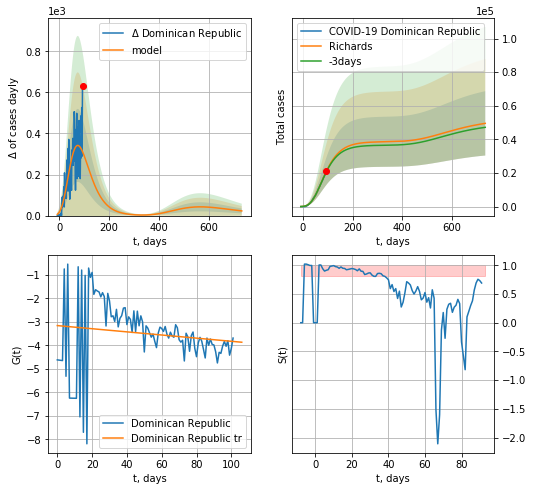

Dominican Republic data at: 2020-06-11
+3 day model MAPE: 0.012303
model: Richards
coeffs: [ 3.86585502e+04  1.52359313e+00 -9.66093618e+01  1.58940203e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.386183
forecast at the end of period: +639 days
	 deltaDaycases: 22
	 total cases: 49553 ± 19136
	 total death: 1296 ± 1501
trend coefficient of determination: 0.019218
 intercept: -3.155935
 slope: -0.006683


In [351]:
x = forecastRR('Dominican Republic',dfDM[:],d1,102*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)

In [ ]:
cD = {
    "Romania": ["RM",5,4*7],
    #"Finland":"FI",
    "India":["ID",5,6*7],
    "Ecuador":["ED",5,4*7],
    "Philippines":["PH",5,4*7],
    #"Pakistan":"PK",
#    "Luxembourg":"LX",
#    "Saudi Arabia":["SA",5,4*7],
    "Thailand":["TH",5,4*7],
    "Indonesia":["IE",5,16*7],
    "Mexico":["MX",5,8*7],
    "Panama":["PM",12,12*7],
    "Peru":["PU",5,4*7],
    "Serbia":["SB",5,4*7],
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":["UAE",5,8*7],
    "Argentina":["AG",5,8*7],
    "Iceland":["IC",5,4*7],
    "Colombia":["CB",10,16*7],
    "Qatar":["QR",5,6*7],
    "Algeria":["AR",5,16*7],
    "Croatia":["CT",0,12*7],
    "Egypt":["EG",5,4*7],
    "Slovenia":["SV",12,6*7],
    "Morocco":["MR",5,4*7],
    "Iraq":["IQ",2,8*7]
#    "Hong Kong":"HK"
}

dfArray = [dfRM,dfID,dfED,dfPH,dfTH,dfIE,dfMX,dfPM,dfPU,dfSB,dfAG,dfIC,dfCB,dfQR,dfAG,dfCT,dfEG,dfSV,dfMR,dfIQ]
for c,adf in zip(cD,dfArray):
    if c in ["Qatar","Peru","Argentina","Iraq","India","Philippines","Indonesia","Finland","Luxembourg","Ecuador","Thailand","Morocco","Romania","Iceland","Panama","Colombia","Mexico","Algeria", "Croatia","Slovenia","Egypt","Serbia"]:
        continue
    print (c)
    idS = cD[c][1]
    ipd = cD[c][2]
    x = forecast(c,adf[idS:],d1,ipd-dT)
    #xx = forecast2(c,adf[:],d1,ipd-dT,x)

In [4]:
import requests
import lxml.html as lh
#url='https://www.worldometers.info/coronavirus/#countries'#Create a handle, page, to handle the contents of the website
url='https://www.worldometers.info/coronavirus/#nav-today'
page = requests.get(url)#Store the contents of the website under doc
doc = lh.fromstring(page.content)#Parse data that are stored between <tr>..</tr> of HTML
tr_elements = doc.xpath('//tr')
#Check the length of the first 12 rows
print ([len(T) for T in tr_elements[:12]])
tr_elements = doc.xpath('//tr')#Create empty list
col=[]
i=0#For each row, store each first element (header) and an empty list
for t in tr_elements[0]:
    i+=1
    name=t.text_content()
    print ('%d:"%s"'%(i,name))
    col.append((name,[]))
    
#Since out first row is the header, data is stored on the second row onwards
for j in range(1,len(tr_elements)):
    #T is our j'th row
    T=tr_elements[j]
    #print (len(T))
    #If row is not of size 10, the //tr data is not from our table 
    if len(T)!=19:
        break
    
    #i is the index of our column
    i=0
    
    #Iterate through each element of the row
    for t in T.iterchildren():
        data=t.text_content() 
        #Check if row is empty
        if i>0:
        #Convert any numerical value to integers
            try:
                data=int(data)
            except:
                pass
        #Append the data to the empty list of the i'th column
        col[i][1].append(data)
        #Increment i for the next column
        i+=1
    
print ([len(C) for (title,C) in col])
Dict={title:column for (title,column) in col}
df=pd.DataFrame(Dict)

[19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19]
1:"#"
2:"Country,Other"
3:"TotalCases"
4:"NewCases"
5:"TotalDeaths"
6:"NewDeaths"
7:"TotalRecovered"
8:"NewRecovered"
9:"ActiveCases"
10:"Serious,Critical"
11:"Tot Cases/1M pop"
12:"Deaths/1M pop"
13:"TotalTests"
14:"Tests/
1M pop
"
15:"Population"
16:"Continent"
17:"1 Caseevery X ppl"
18:"1 Deathevery X ppl"
19:"1 Testevery X ppl"
[695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695]


In [5]:
df.head(10)
#df.columns[18]

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,"Country,Other",Deaths/1M pop,NewCases,NewDeaths,NewRecovered,Population,"Serious,Critical",Tests/ 1M pop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,Tot Cases/1M pop
0,,\n,,,"1,245,760",North America,\nNorth America\n,,"+5,714",620,"+4,321",,"19,423",,"2,392,187","141,967","1,004,460",,
1,,\n,,,"579,092",South America,\nSouth America\n,,884,21,111,,"11,988",,"1,313,866","56,394","678,380",,
2,,\n,,,"840,039",Europe,\nEurope\n,,683,16,826,,"6,745",,"2,156,829","181,474","1,135,316",,
3,,\n,,,"553,822",Asia,\nAsia\n,,"+8,292",130,"+3,202",,"15,239",,"1,507,628","38,030","915,776",,
4,,\n,,,"112,834",Africa,\nAfrica\n,,148,12,76,,511,,"219,502","5,881","100,787",,
5,,\n,,,407,Australia/Oceania,\nOceania\n,,4,,20,,2,,"8,900",124,"8,369",,
6,,\n,,,55,,\n\n,,,,,,4,,721,15,651,,
7,,\n,,,"3,332,009",All,World,54.4,"+15,725",799,"+8,556",,"53,912",,"7,599,633","423,885","3,843,739",,975
8,1,158,"2,852",14,"1,157,616",North America,USA,351,124,1,88,"330,901,704","16,827","69,737","2,089,825","116,035","816,174","23,076,038","6,316"
9,2,264,"5,175",156,"367,899",South America,Brazil,193,,,,"212,479,860","8,318","6,421","805,649","41,058","396,692","1,364,423","3,792"


In [6]:
#df.rename(columns={"Country,Other":"Country",df.columns[9]:"TotDeathsper1Mpop"})
df=df.rename(columns={"Country,Other":"Country",'Deaths/1M pop':"Deathsper1Mpop","Serious,Critical":"Serious_Critical",'Tests/\n1M pop\n':"Testsper1Mpop",'Tot\xa0Cases/1M pop':"TotCasesper1Mpop"})
df.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,"1,245,760",North America,\nNorth America\n,,"+5,714",620,"+4,321",,"19,423",,"2,392,187","141,967","1,004,460",,
1,,\n,,,"579,092",South America,\nSouth America\n,,884,21,111,,"11,988",,"1,313,866","56,394","678,380",,
2,,\n,,,"840,039",Europe,\nEurope\n,,683,16,826,,"6,745",,"2,156,829","181,474","1,135,316",,
3,,\n,,,"553,822",Asia,\nAsia\n,,"+8,292",130,"+3,202",,"15,239",,"1,507,628","38,030","915,776",,
4,,\n,,,"112,834",Africa,\nAfrica\n,,148,12,76,,511,,"219,502","5,881","100,787",,


In [7]:
df[df["Country"]=="Lithuania"]

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
108,101,"1,555","36,809",8,306,Europe,Lithuania,27,,,,"2,723,889",17,"128,782","1,752",74,"1,372","350,788",643
341,102,"1,555","36,809",8,306,Europe,Lithuania,27,19,,3,"2,723,889",17,"128,782","1,752",74,"1,372","350,788",643
573,102,"1,572","36,809",8,290,Europe,Lithuania,27,6,2,31,"2,723,889",17,"126,801","1,733",74,"1,369","345,392",636


In [8]:
totIdx = np.where(df['ActiveCases']=='ActiveCases')[0][0]
print(totIdx)

231


In [9]:
df.head(32)

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,"1,245,760",North America,\nNorth America\n,,"+5,714",620,"+4,321",,"19,423",,"2,392,187","141,967","1,004,460",,
1,,\n,,,"579,092",South America,\nSouth America\n,,884,21,111,,"11,988",,"1,313,866","56,394","678,380",,
2,,\n,,,"840,039",Europe,\nEurope\n,,683,16,826,,"6,745",,"2,156,829","181,474","1,135,316",,
3,,\n,,,"553,822",Asia,\nAsia\n,,"+8,292",130,"+3,202",,"15,239",,"1,507,628","38,030","915,776",,
4,,\n,,,"112,834",Africa,\nAfrica\n,,148,12,76,,511,,"219,502","5,881","100,787",,
5,,\n,,,407,Australia/Oceania,\nOceania\n,,4,,20,,2,,"8,900",124,"8,369",,
6,,\n,,,55,,\n\n,,,,,,4,,721,15,651,,
7,,\n,,,"3,332,009",All,World,54.4,"+15,725",799,"+8,556",,"53,912",,"7,599,633","423,885","3,843,739",,975
8,1,158,"2,852",14,"1,157,616",North America,USA,351,124,1,88,"330,901,704","16,827","69,737","2,089,825","116,035","816,174","23,076,038","6,316"
9,2,264,"5,175",156,"367,899",South America,Brazil,193,,,,"212,479,860","8,318","6,421","805,649","41,058","396,692","1,364,423","3,792"


In [10]:
df.at[13, 'TotalRecovered'] = 0
df.at[12, 'TotalRecovered'] = 0
df.at[30, 'TotalRecovered'] = 0
df.at[31, 'TotalRecovered'] = 0
df.at[13,"ActiveCases"] = 0
df.at[12,"ActiveCases"] = 0
df.at[30,"ActiveCases"] = 0
df.at[31,"ActiveCases"] = 0
#df.at[12, 'TotalRecovered'] = 0
df = df.fillna(0)

In [11]:
import lxml
def sanitize(data):
    #print (type(data))
    if type(data) == lxml.etree._ElementUnicodeResult:
        data=str(data).strip()
    if str(data).find(',') != -1:
        data = data.replace(',','')
    #print(str(data).find(',') != -1)
    return data
df=df[df.index<totIdx-1]
df["ActiveCases"] = pd.to_numeric(df["ActiveCases"].apply(sanitize))
df["Deathsper1Mpop"] = pd.to_numeric(df["Deathsper1Mpop"].apply(sanitize))
df["NewCases"] = pd.to_numeric(df["NewCases"].apply(sanitize))
df["NewDeaths"] = pd.to_numeric(df["NewDeaths"].apply(sanitize))
df["Serious_Critical"] = pd.to_numeric(df["Serious_Critical"].apply(sanitize))
df["TotalCases"] = pd.to_numeric(df["TotalCases"].apply(sanitize))
df["TotalDeaths"] = pd.to_numeric(df["TotalDeaths"].apply(sanitize))
df["TotalRecovered"] = pd.to_numeric(df["TotalRecovered"].apply(sanitize))
df["TotCasesper1Mpop"] = pd.to_numeric(df["TotCasesper1Mpop"].apply(sanitize))
df["TotalTests"] = pd.to_numeric(df["TotalTests"].apply(sanitize))
df["Testsper1Mpop"] = pd.to_numeric(df["Testsper1Mpop"].apply(sanitize))
df.head(15)

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,1245760,North America,\nNorth America\n,NaN,5714.0,620.0,"+4,321",,19423.0,NaN,2392187,141967.0,1004460.0,NaN,NaN
1,,\n,,,579092,South America,\nSouth America\n,NaN,884.0,21.0,111,,11988.0,NaN,1313866,56394.0,678380.0,NaN,NaN
2,,\n,,,840039,Europe,\nEurope\n,NaN,683.0,16.0,826,,6745.0,NaN,2156829,181474.0,1135316.0,NaN,NaN
3,,\n,,,553822,Asia,\nAsia\n,NaN,8292.0,130.0,"+3,202",,15239.0,NaN,1507628,38030.0,915776.0,NaN,NaN
4,,\n,,,112834,Africa,\nAfrica\n,NaN,148.0,12.0,76,,511.0,NaN,219502,5881.0,100787.0,NaN,NaN
5,,\n,,,407,Australia/Oceania,\nOceania\n,NaN,4.0,NaN,20,,2.0,NaN,8900,124.0,8369.0,NaN,NaN
6,,\n,,,55,,\n\n,NaN,NaN,NaN,,,4.0,NaN,721,15.0,651.0,NaN,NaN
7,,\n,,,3332009,All,World,54.4,15725.0,799.0,"+8,556",,53912.0,NaN,7599633,423885.0,3843739.0,NaN,975.0
8,1,158,"2,852",14,1157616,North America,USA,351.0,124.0,1.0,88,"330,901,704",16827.0,69737.0,2089825,116035.0,816174.0,23076038.0,6316.0
9,2,264,"5,175",156,367899,South America,Brazil,193.0,NaN,NaN,,"212,479,860",8318.0,6421.0,805649,41058.0,396692.0,1364423.0,3792.0


In [12]:
cLst = countriesEU
ActiveCasesEU = sum([ w for w in df[df['Country'].isin(cLst)].ActiveCases if w>0])
CountryEU = "European Union" 
Deathsper1MpopEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])/445.250514
NewCasesEU = sum([w for w in df[df['Country'].isin(cLst)].NewCases if w>0 ])
NewDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].NewDeaths if w>0])
Serious_CriticalEU = sum([w for w in df[df['Country'].isin(cLst)].Serious_Critical if w>0])
Testsper1MpopEU = sum([ w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])/445.250514
TotalCasesEu = sum([w for w in df[df['Country'].isin(cLst)].TotalCases if w>0])
TotalDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])
TotalRecoveredEU = sum([w for w in df[df['Country'].isin(cLst)].TotalRecovered if w>0] )
TotalTestsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])
TotCasesper1MpopEU = TotalCasesEu/445.250514

rowEU = {"ActiveCases":ActiveCasesEU,"Continent":"Europe","Country": CountryEU,"Deathsper1Mpop": Deathsper1MpopEU,"NewCases": NewCasesEU,"NewDeaths": NewDeathsEU,"Serious_Critical": Serious_CriticalEU,"Testsper1Mpop": Testsper1MpopEU,"TotalCases": TotalCasesEu,"TotalDeaths": TotalDeathsEU,"TotalRecovered": TotalRecoveredEU,"TotalTests": TotalTestsEU,"TotCasesper1Mpop": TotCasesper1MpopEU }
df = df.append(rowEU, ignore_index=True)
df.tail()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
226,,,,,553822,Asia,Total:,NaN,8292.0,130.0,"+3,202",,15239.0,NaN,1507628,38030.0,915776.0,NaN,NaN
227,,,,,112834,Africa,Total:,NaN,148.0,12.0,76,,511.0,NaN,219502,5881.0,100787.0,NaN,NaN
228,,,,,407,Australia/Oceania,Total:,NaN,4.0,NaN,,,2.0,NaN,8900,124.0,8369.0,NaN,NaN
229,,,,,55,,Total:,NaN,NaN,NaN,,,4.0,NaN,721,15.0,651.0,NaN,NaN
230,NaN,NaN,NaN,NaN,164487,Europe,European Union,290.079396,0.0,0.0,NaN,NaN,3106.0,52715.954866,1207023,129158.0,565046.0,23471806.0,2710.885136


In [13]:
#df['Reported1st case'] = df['Reported1st case'].map(lambda x: x.lstrip('\n'))
df["Country"] = df["Country"].str.strip('\n')
df.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,1245760,North America,North America,NaN,5714.0,620.0,"+4,321",,19423.0,NaN,2392187,141967.0,1004460.0,NaN,NaN
1,,\n,,,579092,South America,South America,NaN,884.0,21.0,111,,11988.0,NaN,1313866,56394.0,678380.0,NaN,NaN
2,,\n,,,840039,Europe,Europe,NaN,683.0,16.0,826,,6745.0,NaN,2156829,181474.0,1135316.0,NaN,NaN
3,,\n,,,553822,Asia,Asia,NaN,8292.0,130.0,"+3,202",,15239.0,NaN,1507628,38030.0,915776.0,NaN,NaN
4,,\n,,,112834,Africa,Africa,NaN,148.0,12.0,76,,511.0,NaN,219502,5881.0,100787.0,NaN,NaN


In [14]:
#totIdx0 = np.where(df['Country']=='Total:')[0][0]
#df.at[totIdx0,'Country'] = 'World'

In [15]:
#df

In [16]:
#df[df['Country'].isnull()]
#df['Country']=df['Country'].dropna()
##for idx in df['Country'].isnull():
##    #print(idx)
##    if idx == True:
##        ind = df[df['Country'].isnull()].index[0]
##        df = df.drop(df.index[ind])
df = df.drop(df.index[6])
df.head(10)

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,1245760,North America,North America,NaN,5714.0,620.0,"+4,321",,19423.0,NaN,2392187,141967.0,1004460.0,NaN,NaN
1,,\n,,,579092,South America,South America,NaN,884.0,21.0,111,,11988.0,NaN,1313866,56394.0,678380.0,NaN,NaN
2,,\n,,,840039,Europe,Europe,NaN,683.0,16.0,826,,6745.0,NaN,2156829,181474.0,1135316.0,NaN,NaN
3,,\n,,,553822,Asia,Asia,NaN,8292.0,130.0,"+3,202",,15239.0,NaN,1507628,38030.0,915776.0,NaN,NaN
4,,\n,,,112834,Africa,Africa,NaN,148.0,12.0,76,,511.0,NaN,219502,5881.0,100787.0,NaN,NaN
5,,\n,,,407,Australia/Oceania,Oceania,NaN,4.0,NaN,20,,2.0,NaN,8900,124.0,8369.0,NaN,NaN
7,,\n,,,3332009,All,World,54.4,15725.0,799.0,"+8,556",,53912.0,NaN,7599633,423885.0,3843739.0,NaN,975.0
8,1,158,"2,852",14,1157616,North America,USA,351.0,124.0,1.0,88,"330,901,704",16827.0,69737.0,2089825,116035.0,816174.0,23076038.0,6316.0
9,2,264,"5,175",156,367899,South America,Brazil,193.0,NaN,NaN,,"212,479,860",8318.0,6421.0,805649,41058.0,396692.0,1364423.0,3792.0
10,3,290,"22,341",11,234754,Europe,Russia,45.0,NaN,NaN,,"145,931,382",2300.0,95080.0,502436,6532.0,261150.0,13875097.0,3443.0


In [17]:
df.to_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)), index=False)

In [18]:
countryDic = {
  "USA": "US",
"Italy":"IT",
"Spain":"SP",
"Germany":"GR",
"France":"FR",
"Iran":"IN",
"UK":"GB",
"Switzerland":"SZ",
"S. Korea":"KR",
"Norway":"NG",
"Sweden":"SW",
"Israel":"IS",
"Denmark":"DK",
"Poland":"PL",
"Estonia":"ES",
"Ukraine":"Ukr",
"Latvia":"LV",
    "Lithuania":"LT",
    "China":"CN",
    "USA":"US",
    "Russia":"RS",
    "Japan":"JP",
    "Netherlands":"NL",
    "Belgium":"BG",
    "Singapore":"SG",
    "Austria":"AT",
    "Turkey":"TR",
    "Canada":"CA",
    "Portugal":"PT",
    "World":"World",
    "Australia":"AS",
    "Brazil":"BZ",
    "Malaysia":"ML",
    "New Zealand":"ZL",
    "Belarus":"BR",
    "Ireland":"IR",
    "Chile":"CL",
    "Czechia":"CH",
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
#    "Pakistan":"PK",
    "Luxembourg":"LX",
    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "European Union":"EU",
    "Bulgaria":"BL",
    "Hungary":"HG",
    "Malta":"MT",
    "Slovakia":"SL",
    "Cyprus":"CP",
    "Greece":"GC",
    "Dominican Republic":"DM",
    "Kuwait":"KW",
    "Bangladesh":"BN",
    "Sri Lanka":"Sri",
    "Pakistan":"PS"
#    "Hong Kong":"HK"
}
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)

for c in countryDic:
    print (c,countryDic[c])

Finland FI
Romania RM
Thailand TH
Greece GC
Australia AS
Philippines PH
Slovakia SL
Portugal PT
Luxembourg LX
Italy IT
UK GB
Pakistan PS
Panama PM
Latvia LV
Malaysia ML
Dominican Republic DM
New Zealand ZL
Belarus BR
Croatia CT
Austria AT
Belgium BG
Slovenia SV
India ID
Singapore SG
Saudi Arabia SA
Sweden SW
Serbia SB
Malta MT
Iraq IQ
Cyprus CP
Chile CL
Bulgaria BL
Egypt EG
Indonesia IE
Poland PL
Algeria AR
Brazil BZ
Ireland IR
European Union EU
Japan JP
Peru PU
Turkey TR
Spain SP
Czechia CH
Estonia ES
Kuwait KW
Canada CA
Israel IS
S. Korea KR
Switzerland SZ
Mexico MX
Bangladesh BN
Denmark DK
China CN
World World
Hungary HG
Sri Lanka Sri
Germany GR
France FR
Lithuania LT
Qatar QR
Ecuador ED
Norway NG
Ukraine Ukr
Russia RS
Argentina AG
Iceland IC
Netherlands NL
Morocco MR
Colombia CB
Iran IN
UAE UAE
USA US


In [19]:
len(countryDic)

73

In [20]:
df = pd.read_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)),',')
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)
from datetime import date, timedelta
for c in df.Country: 
    #if c!='European Union':
    #    continue
    f = open("data/tmp/corona%sOneRaw.csv"%(c),'w')
    #print ("corona%sOneRaw.csv"%(c),date.today()- timedelta(days=1),c,df[df.Country == c].TotalCases.values[0])
    print(c)
    if c!='World':
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    else:
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    f.close()

North America
North America 2020-06-11,2392187,1245760,141967.0
South America
South America 2020-06-11,1313866,579092,56394.0
Europe
Europe 2020-06-11,2156829,840039,181474.0
Asia
Asia 2020-06-11,1507628,553822,38030.0
Africa
Africa 2020-06-11,219502,112834,5881.0
Oceania
Oceania 2020-06-11,8900,407,124.0
World
World 2020-06-11,7599633,3332009,423885.0
USA
USA 2020-06-11,2089825,1157616,116035.0
Brazil
Brazil 2020-06-11,805649,367899,41058.0
Russia
Russia 2020-06-11,502436,234754,6532.0
India
India 2020-06-11,298283,142587,8501.0
UK
UK 2020-06-11,291409,0,41279.0
Spain
Spain 2020-06-11,289787,0,27136.0
Italy
Italy 2020-06-11,236142,30637,34167.0
Peru
Peru 2020-06-11,214788,106250,6109.0
Germany
Germany 2020-06-11,186795,6344,8851.0
Iran
Iran 2020-06-11,180156,28909,8584.0
Turkey
Turkey 2020-06-11,174023,21400,4763.0
France
France 2020-06-11,155561,54066,29346.0
Chile
Chile 2020-06-11,154092,25000,2648.0
Mexico
Mexico 2020-06-11,133974,19966,15944.0
Pakistan
Pakistan 2020-06-11,125933,8

Turks and Caicos
Turks and Caicos 2020-06-11,12,0,1.0
Vatican City
Vatican City 2020-06-11,12,0,nan
Montserrat
Montserrat 2020-06-11,11,0,1.0
Seychelles
Seychelles 2020-06-11,11,0,nan
MS Zaandam
MS Zaandam 2020-06-11,9,7,2.0
Western Sahara
Western Sahara 2020-06-11,9,2,1.0
British Virgin Islands
British Virgin Islands 2020-06-11,8,0,1.0
Papua New Guinea
Papua New Guinea 2020-06-11,8,0,nan
Caribbean Netherlands
Caribbean Netherlands 2020-06-11,7,0,nan
St. Barth
St. Barth 2020-06-11,6,0,nan
Lesotho
Lesotho 2020-06-11,4,2,nan
Anguilla
Anguilla 2020-06-11,3,0,nan
Saint Pierre Miquelon
Saint Pierre Miquelon 2020-06-11,1,0,nan
China
China 2020-06-11,83064,65,4634.0
Total:
Total: 2020-06-11,2392187,1245760,141967.0
Total:
Total: 2020-06-11,2392187,1245760,141967.0
Total:
Total: 2020-06-11,2392187,1245760,141967.0
Total:
Total: 2020-06-11,2392187,1245760,141967.0
Total:
Total: 2020-06-11,2392187,1245760,141967.0
Total:
Total: 2020-06-11,2392187,1245760,141967.0
Total:
Total: 2020-06-11,2392187

In [21]:
#c='World'
#print(c,"%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0]))

In [22]:
for c in countryDic: 
    #if c not in ['European Union']:
    #    continue
    ff = open("data/tmp/corona%sOneRaw.csv"%(c),'r')
    fff = open("data/corona%s.csv"%(countryDic[c]),'a')
    for l in ff:
        #print(c,l)
        print("append data/corona%s.csv"%(countryDic[c]),"%s"%(l))
        fff.write(l)
    ff.close()
    fff.close()

append data/coronaFI.csv 2020-06-11,7064,539,325.0

append data/coronaRM.csv 2020-06-11,21182,4530,1369.0

append data/coronaTH.csv 2020-06-11,3129,84,58.0

append data/coronaGC.csv 2020-06-11,3088,1531,183.0

append data/coronaAS.csv 2020-06-11,7289,406,102.0

append data/coronaPH.csv 2020-06-11,24175,17974,1036.0

append data/coronaSL.csv 2020-06-11,1541,104,28.0

append data/coronaPT.csv 2020-06-11,35910,12404,1504.0

append data/coronaLX.csv 2020-06-11,4052,32,110.0

append data/coronaIT.csv 2020-06-11,236142,30637,34167.0

append data/coronaGB.csv 2020-06-11,291409,0,41279.0

append data/coronaPS.csv 2020-06-11,125933,83223,2463.0

append data/coronaPM.csv 2020-06-11,18586,7191,418.0

append data/coronaLV.csv 2020-06-11,1094,250,26.0

append data/coronaML.csv 2020-06-11,8369,1186,118.0

append data/coronaDM.csv 2020-06-11,21437,8335,561.0

append data/coronaZL.csv 2020-06-11,1504,0,22.0

append data/coronaBR.csv 2020-06-11,51816,24880,293.0

append data/coronaCT.csv 2020-06-11,224

In [21]:
import pandas as pd
import io
import requests
url="https://opendata.ecdc.europa.eu/covid19/casedistribution/csv"
s=requests.get(url).content
#print (s)
dfc=pd.read_csv(io.StringIO(s.decode(encoding='windows-1252')))
dfc.to_csv("data/europa_corona.csv", index=False)

In [22]:
countryDic1 = {
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
#    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "Bulgaria":"BL"
#    "Hong Kong":"HK"
}
countryDic2 = {
    "Austria":"AT",
    "Italy":"IT",
    "Belgium":"BG",
    "Latvia":"LV",
    "Bulgaria":"BL",
    "Lithuania":"LT",
    "Croatia":"CT",
    "Luxembourg":"LX",
    "Cyprus":"CP",
    "Malta":"MT",
    "Czechia":"CH",
    "Netherlands":"NL",
    "Denmark":"DK",
    "Poland":"PL",
    "Estonia":"ES",
    "Portugal":"PT",
    "Finland":"FI",
    "Romania":"RM",
    "France":"FR",
    "Slovakia":"SL",
    "Germany":"GR",
    "Slovenia":"SV",
    "Greece":"GC",
    "Spain":"SP",
    "Hungary":"HG",
    "Sweden":"SW",
    "Ireland":"IR"      
}
cD3 = {"Malta":"MT","Slovakia":"SL","Greece":"GC","Hungary":"HG","Cyprus":"CP","South Africa":"SAF"}
    
for  c in cD3:#countryDic1:
    if c != "South Africa":
        continue
    dfc = pd.read_csv("europa_corona.csv",",")
    dfc = dfc[dfc['countriesAndTerritories']==c].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
    print(c,sum(dfc["cases"].values))
    dfc=dfc.rename(columns={"dateRep":"date"})
    dfc = dfc[dfc["cases"]>0]
    dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
    #dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
    dfc["cases"]=np.cumsum(dfc["cases"].values)
    dfc[['date', 'cases']].to_csv('data/corona%s.csv'%(cD3[c]), index=False)#countryDic1

FileNotFoundError: [Errno 2] File b'europa_corona.csv' does not exist: b'europa_corona.csv'

In [ ]:
#dfRM = read_df(pd.DataFrame(),"RM")

In [ ]:
dfc.head()#[['date', 'cases']]

In [ ]:
date(2012, 3, 16)

In [ ]:
len(countriesEU)

In [ ]:
dfc = pd.read_csv("europa_corona.csv",",")
cLst = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania","Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands","Denmark","Poland","Estonia","Portugal","Finland","Romania","France","Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
dfc = dfc[dfc['countriesAndTerritories'].isin(cLst)].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
print(c,sum(dfc["cases"].values))
dfc=dfc.rename(columns={"dateRep":"date"})
dfc = dfc[dfc["cases"]>0]
dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
#dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
dfc["cases"]=np.cumsum(dfc["cases"].values)
dfc[['date', 'cases']].to_csv('/home/algiz/Desktop/corona%s.csv'%("EU"), index=False)

In [ ]:
#subsetDataFrame = dfObj[dfObj['Product'].isin(['Mangos', 'Grapes']) ]

#dfD = dfAll[dfAll['Country'].isin(cLst)].TotalTests


In [ ]:
#dfD

In [ ]:
#dfAll[dfAll['Country'].isin(cLst)]

In [122]:
TT = sum(dfAll[dfAll.TotalTests>0].TotalTests) - dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]
print(TT,TT/7.7776e3)

87759686.0 11283.646111911128


In [123]:
TT/7.7776e3

11283.646111911128

In [124]:
dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]/(popEU/1e6)

46659.02305954441

In [367]:
sum(dfp.Population)/1e6

16014.157998

In [ ]:
dfAll[dfAll.TotalTests>0]

In [ ]:
cDicEU = {
    "Austria":["AT",dfAT],
    "Italy":["IT",dfIT],
    "Belgium":["BG",dfBG],
    "Latvia":["LV",dfLV],
    "Bulgaria":["BL",dfBL],
    "Lithuania":["LT",dfLT],
    "Croatia":["CT",dfCT],
    "Luxembourg":["LX",dfLX],
    "Cyprus":["CP",dfCP],
    "Malta":["MT",dfMT],
    "Czechia":["CH",dfCH],
    "Netherlands":["NL",dfNL],
    "Denmark":["DK",dfDK],
    "Poland":["PL",dfPL],
    "Estonia":["ES",dfES],
    "Portugal":["PT",dfPT],
    "Finland":["FI",dfFI],
    "Romania":["RM",dfRM],
    "France":["FR",dfFR],
    "Slovakia":["SL",dfSL],
    "Germany":["GR",dfGR],
    "Slovenia":["SV",dfSV],
    "Greece":["GC",dfGC],
    "Spain":["SP",dfSP],
    "Hungary":["HG",dfHG],
    "Sweden":["SW",dfSW],
    "Ireland":["IR",dfIR],
}

In [ ]:
def addDataFrames(f_arg, *argv):
    dfTotal = f_arg
    for arg in argv:
        dfTotal = dfTotal.set_index('date').add(arg.set_index('date'), fill_value = 0)
        dfTotal['date'] = dfTotal.index
    return dfTotal
dfTot = cDicEU["Austria"][1]
for cD in cDicEU:
    if cD == "Austria":
        continue
    dfTot = addDataFrames(dfTot, cDicEU[cD][1])
    
dfTot.to_csv("~/Documents/coronaEU1.csv")

In [ ]:
#cDicEU["Ireland"][1]

In [367]:
dfAll[df["Country"]=="European Union"].TotalTests.values[0]/445.250514

41042.88131153061

In [368]:
dfAll[df["Country"]=="Total:"].TotalTests.values[0]/445

0.0

In [369]:
#dfAll

In [370]:
(sum(dfAll.TotalTests)-dfAll[df["Country"]=="European Union"].TotalTests.values[0])/(7.777e3-445.250514)

9765.488323996455

In [371]:
CList = ["USA",
"Spain", "Italy", "UK", "France", "Germany", "Turkey", "Russia", "Iran", "Brazil", "Canada", "Belgium",
"Peru", "Netherlands", "India", "Switzerland", "Ecuador", "Portugal", "Saudi Arabia", "Sweden", "Ireland",
"Mexico", "Pakistan", "Singapore", "Chile", "Israel", "Austria", "Belarus", "Japan", "Qatar", "Poland",
"UAE", "Romania", "Ukraine", "South_Korea", "Indonesia", "Denmark", "Serbia", "Philippines", "Norway", "Czechia",
"Colombia", "Australia", "Malaysia", "Egypt", "Finland", "Morocco", "Argentina", "Algeria", "Moldova", 
"Luxembourg", "Thailand", "Hungary", "Greece", "Iraq", "Croatia", "Iceland", "Estonia", "Bulgaria",
"New_Zealand", "Slovenia", "Slovakia", "Lithuania", "Latvia", "Cyprus", "Malta","Bangladesh","Kuwait","Dominican Republic"
]

In [372]:
len(CList)

69

In [373]:
popModelled = sum(dfp[dfp["Country (or dependency)"].isin(CList) ].Population)
popModelled

4078403521

In [ ]:
for CItem in CList:
    a = """
    %s
    <br />
    <img src="pictures/covidcases%s35_Q.png" alt="hi" class="inline"/><br /> 

      {%% include_relative _includes/covidcases%s35_Q.txt %%}
          <br /> 
    """%(CItem,CItem,CItem)
    print (a)

In [ ]:
R = (dfLT[:].cases.values/0.9240855762594893).astype(int)+1 -dfLT[:].active.values+dfLT[:].death.values
I = dfLT[:].active.values
S = 1700-R[:]-I
plt.plot(range(len(dfLT)),R,label="R")
plt.plot(range(len(dfLT)),I,label="I")
plt.plot(range(len(dfLT)),S,label="S")
plt.legend()
plt.grid()

In [ ]:
plt.plot(np.multiply(I,S)[1:]/1700,-np.diff(S[:]))
plt.grid()

In [ ]:
plt.plot(np.diff(R[:]),I[1:]/950)
plt.grid()

In [ ]:
plt.plot(np.diff(R[:])+np.diff(I)+np.diff(S))
plt.grid()

In [ ]:
def fS(x0,u):
    return x0*u
def fI(gamma,beta,x0,C1,u):
    return gamma*np.log(u)/beta-x0*u-C1/beta
def fR(gamma,beta,u):
    return -gamma*np.log(u)/beta
def fT(C1,gamma,x0,beta,u,u0):
    from scipy.integrate import quad
    def integrand(x, C1,gamma,x0,beta):
        return 1/(beta*x*(C1/beta-gamma*np.log(x)/beta+x0*x)) 
    return quad(integrand, u0, u, args=(C1,gamma,x0,beta),epsrel=1e-12)
vfS = np.vectorize(fS)
vfI = np.vectorize(fI)
vfR = np.vectorize(fR)
vfT = np.vectorize(fT)

In [ ]:
import scipy.optimize as optimize

T = np.linspace(.00001, 55., num=len(dfLT))
#U = np.linspace(1.0, 10*len(dfLT), num=len(dfLT))

def f(params):
    # print(params)  # <-- you'll see that params is a NumPy array
    gamma, norm = params # <-- for readability you may wish to assign names to the component variables
    C1 = -N*beta
    minT = np.min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
    sumT = np.sum((T[:]-(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm)**2)
    sumS = np.sum((S[:]-vfS(x0,U[:]))**2)
    sumI = np.sum((I[:]-vfI(gamma,beta,x0,C1,U[:]))**2)
    sumR = np.sum((R[:]-vfR(gamma,beta,U[:]))**2)
    return sumR+sumI+sumS+sumT
N = 1700
x0 = N*0.98
gamma = 4.18201705e+01
beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
norma = 55*2
initial_guess = [gamma, norma]
result = optimize.minimize(f, initial_guess)
if result.success:
    fitted_params = result.x
    print(fitted_params)
else:
    fitted_params = result.x
    print(fitted_params)
    raise ValueError(result.message)

In [ ]:
55*19

In [ ]:
N = 1700
#x0 = N*0.995
gamma =  fitted_params[0]
#beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02*0.13
norm = fitted_params[1]
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
minT = min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
plt.plot(U[:-1],(np.diff(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT))*norm)
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfS(x0,U[:]))
plt.plot(range(len(dfLT)),S,label="S")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfI(gamma,beta,x0,C1,U[:]))
plt.plot(range(len(dfLT)),I,label="I")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfR(gamma,beta,U[:]))
plt.plot(range(len(dfLT)),R,label="R")
plt.grid()

In [ ]:
#T = np.linspace(1.0, len(dfLT), num=len(dfLT))

In [ ]:
#u0 = [1,0.01]
#vfS(x0,u0),vfI(gamma,beta,x0,C1,u0),vfR(gamma,beta,u0)

In [ ]:
gamma/(beta*x0)*55*4

In [ ]:
np.logspace(0.1,0.9,num=9-2+1,dtype='float64')/10

In [ ]:
10**0.1

In [ ]:
np.multiply(I,S)[1:].shape

In [ ]:
np.diff(S).shape

In [ ]:
50./400